## Import libraries

In [1]:
# Python libraries
import os
import sys
import pandas as pd # for data manipulation
import numpy as np # for data manipulation
import tensorflow as tf
from sklearn.model_selection import train_test_split
from datetime import datetime
import time

# Plotting
import matplotlib.pyplot as plt

# To enable LaTeX and select a font
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "sans-serif",
    "font.sans-serif": "Helvetica",
})

# Using ipynb import functions defined in other nb
sys.path.append("myfun/")
from ipynb.fs.defs.myfun_load_dataset import *
from ipynb.fs.full.myfun_model_nn import *
from ipynb.fs.defs.myfun_plot import *

2024-02-10 00:56:38.117484: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-10 00:56:38.117544: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-10 00:56:38.147633: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-10 00:56:38.223485: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-10 00:56:39.329731: W tensorflow/compiler/tf2

## Data Acquisition

In [2]:
# Load the dataset
par_dir = os.path.dirname(os.getcwd()) # parent dir
dir_name = par_dir + "/NN-interaction"

In [3]:
processed_flag = 'pre'
# load the data
_, dflist = load_dataset(dir_name, processed_flag)
dataset = dflist

print(f"In this dataset we have {np.sum([d.shape[0] for d in dataset])} scenes")

In this dataset we have 671 scenes


## Params

In [4]:
DOE =[1,2,2,2,1] #Design of experiment

In [5]:
v0 = 30
NUM_ITER = 500
LEARNING_RATE_v0 = 0.5
test = 0.4

plot_flag = True
flag_save = True

----------------------------------------------------------------------------------------------------
Analyzing 10 dfs. NN structure: 1-2-2-2-1
****************************************************************************************************
Analyzing 1/10 dfs.
In DataFrame n.1 we have 109 scenes.
    To train the model we use 73 scenes, the remaining 36 to test the model.

Training step. (73 scenes)
DataFrame n.1. Scene n.1/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [239.44,240.24]


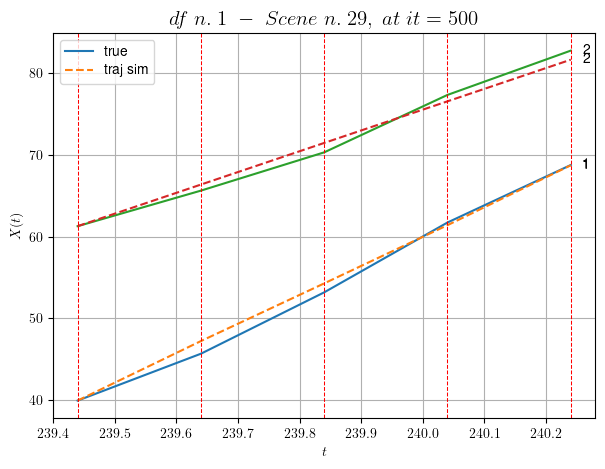

----------------------------------------------------------------------------------------------------
        For scene 1/73:
        * After LR finder: LR_NN=0.0005 with mse=3.3341338534732805 at it=24
        * v0 = 25.426381424530224
        * MSE = 0.7057623768810716
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [310.84,311.24]


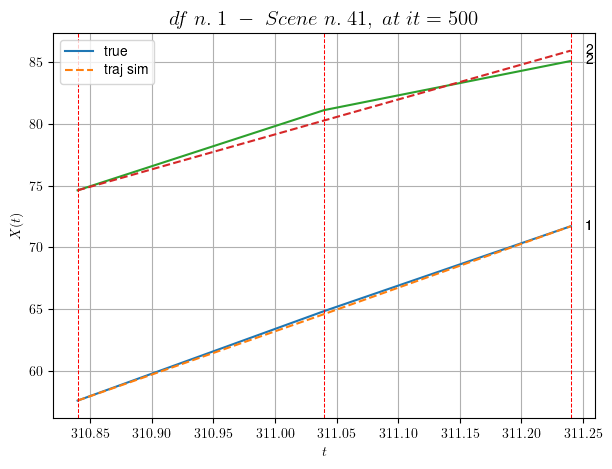

----------------------------------------------------------------------------------------------------
        For scene 2/73:
        * After LR finder: LR_NN=0.001 with mse=0.4328381136926733 at it=24
        * v0 = 28.33987446305917
        * MSE = 0.24503270843723013
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [52.84,53.84]


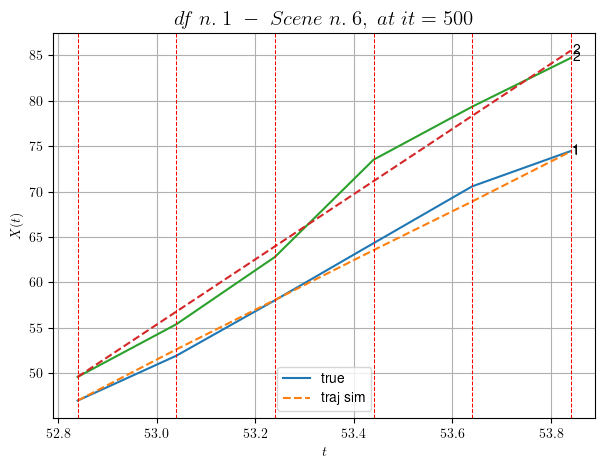

----------------------------------------------------------------------------------------------------
        For scene 3/73:
        * After LR finder: LR_NN=0.001 with mse=8.339196736844166 at it=24
        * v0 = 35.9128223540259
        * MSE = 1.1751818509738194
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/73
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [362.84,364.04]


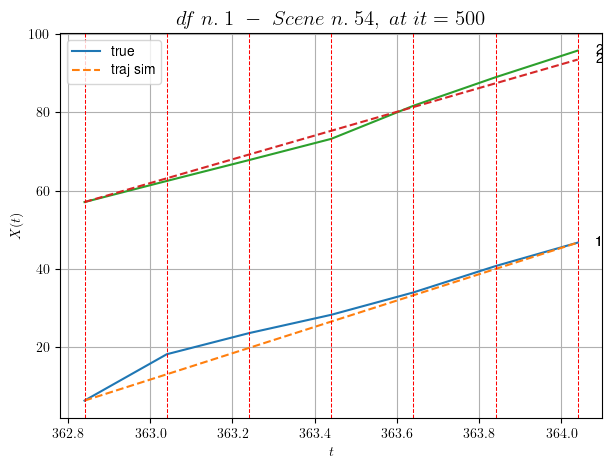

----------------------------------------------------------------------------------------------------
        For scene 4/73:
        * After LR finder: LR_NN=1e-05 with mse=3.7462416836668426 at it=24
        * v0 = 30.31397642834201
        * MSE = 4.208661268740561
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [444.24,445.24]


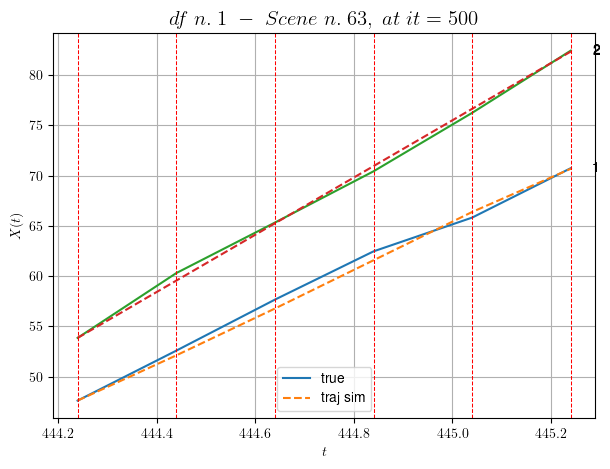

----------------------------------------------------------------------------------------------------
        For scene 5/73:
        * After LR finder: LR_NN=0.01 with mse=0.7520551226050102 at it=24
        * v0 = 28.49497309557513
        * MSE = 0.24999267425926125
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [307.24,307.64]


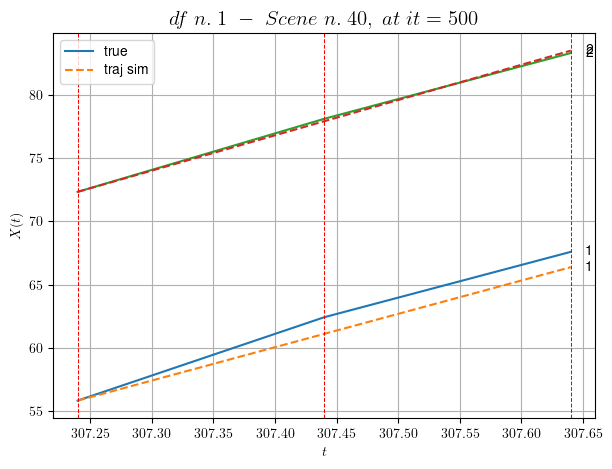

----------------------------------------------------------------------------------------------------
        For scene 6/73:
        * After LR finder: LR_NN=1e-05 with mse=27.138979956337792 at it=24
        * v0 = 27.873164065567302
        * MSE = 0.5433144517039611
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [294.64,295.24]


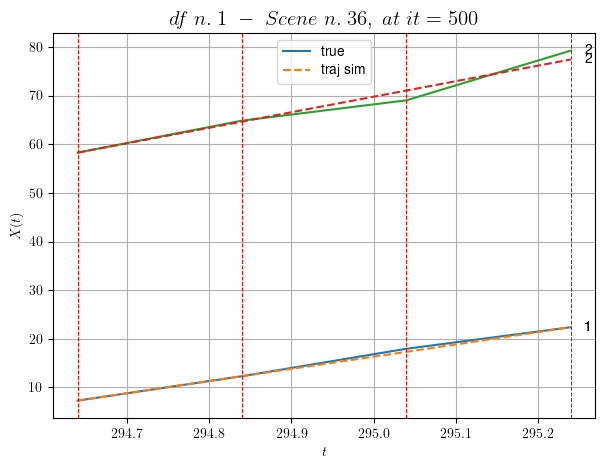

----------------------------------------------------------------------------------------------------
        For scene 7/73:
        * After LR finder: LR_NN=0.001 with mse=1.4145154567577771 at it=24
        * v0 = 31.912591419187137
        * MSE = 0.9733446401020637
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [130.64,131.44]


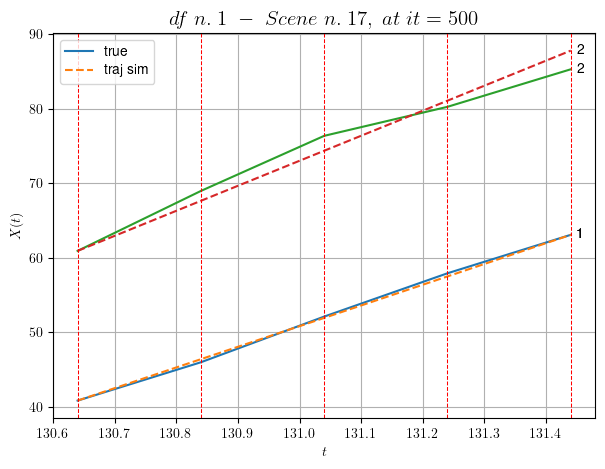

----------------------------------------------------------------------------------------------------
        For scene 8/73:
        * After LR finder: LR_NN=0.001 with mse=1.8684451457805396 at it=24
        * v0 = 33.619245904294544
        * MSE = 1.1437924527377068
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [496.84,497.64]


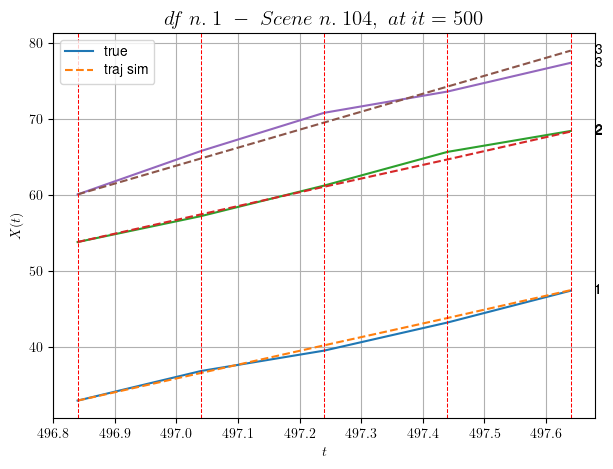

----------------------------------------------------------------------------------------------------
        For scene 9/73:
        * After LR finder: LR_NN=0.005 with mse=4.537494207777252 at it=24
        * v0 = 23.671022130116903
        * MSE = 0.5058155068276701
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [291.64,292.64]


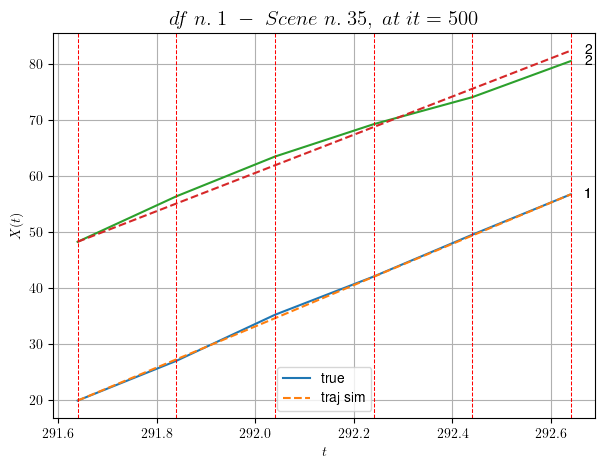

----------------------------------------------------------------------------------------------------
        For scene 10/73:
        * After LR finder: LR_NN=0.001 with mse=2.7398222105866243 at it=24
        * v0 = 34.11909568875068
        * MSE = 0.7477677251034089
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.11/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [472.24,473.24]


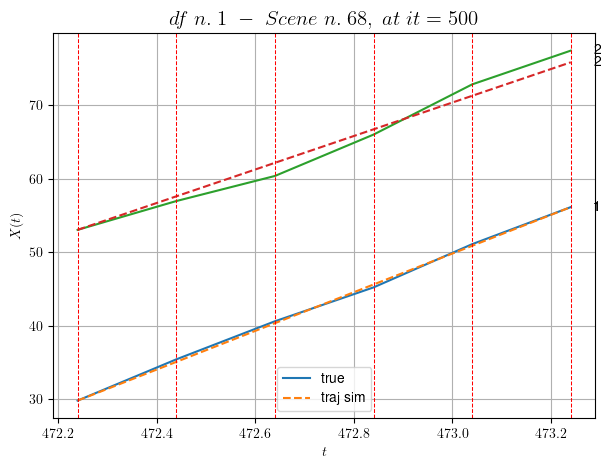

----------------------------------------------------------------------------------------------------
        For scene 11/73:
        * After LR finder: LR_NN=0.0001 with mse=8.513551835774937 at it=24
        * v0 = 22.76470215605672
        * MSE = 0.7358857032765962
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.12/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [56.84,57.64]


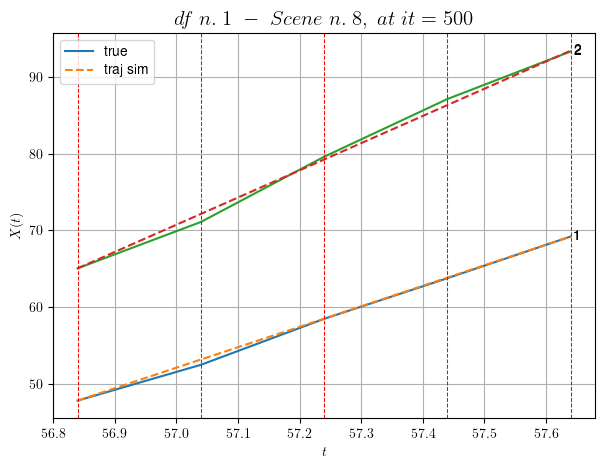

----------------------------------------------------------------------------------------------------
        For scene 12/73:
        * After LR finder: LR_NN=0.001 with mse=4.227663981912472 at it=24
        * v0 = 35.49695649017765
        * MSE = 0.23505108113966847
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.13/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [320.44,321.24]


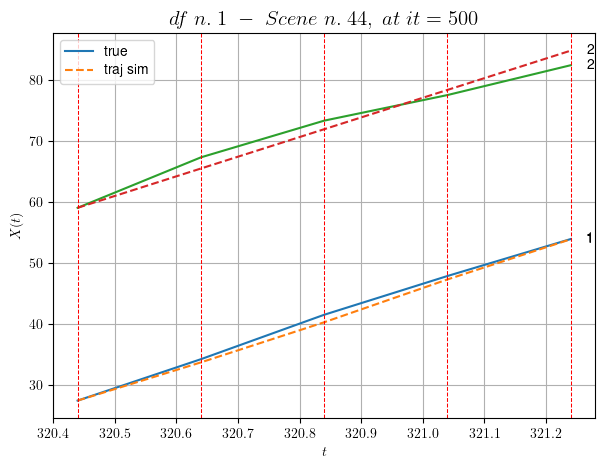

----------------------------------------------------------------------------------------------------
        For scene 13/73:
        * After LR finder: LR_NN=0.01 with mse=1.236879699244628 at it=24
        * v0 = 32.19336724924497
        * MSE = 1.1468916903706252
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.14/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [463.04,463.64]


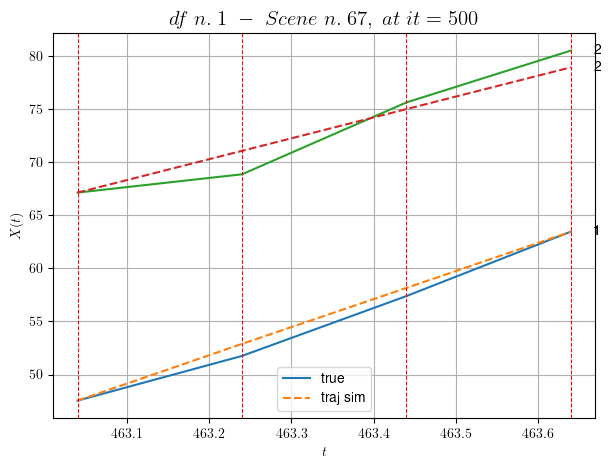

----------------------------------------------------------------------------------------------------
        For scene 14/73:
        * After LR finder: LR_NN=0.001 with mse=6.7187264395951525 at it=24
        * v0 = 19.66200604765411
        * MSE = 1.0850997482459313
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.15/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [529.64,530.64]


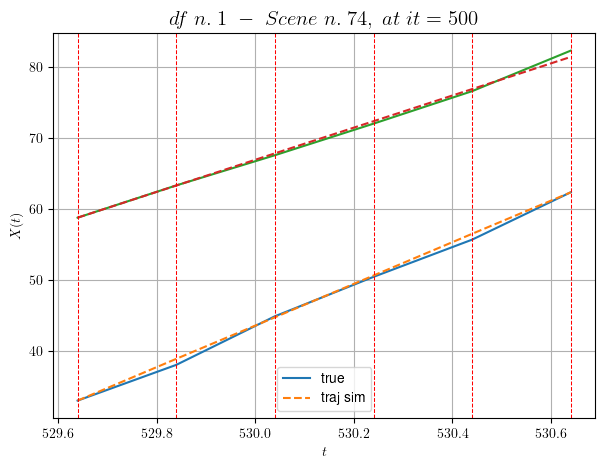

----------------------------------------------------------------------------------------------------
        For scene 15/73:
        * After LR finder: LR_NN=0.001 with mse=9.72952988870018 at it=24
        * v0 = 22.628998285035873
        * MSE = 0.20789156918221718
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.16/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [230.04,230.64]


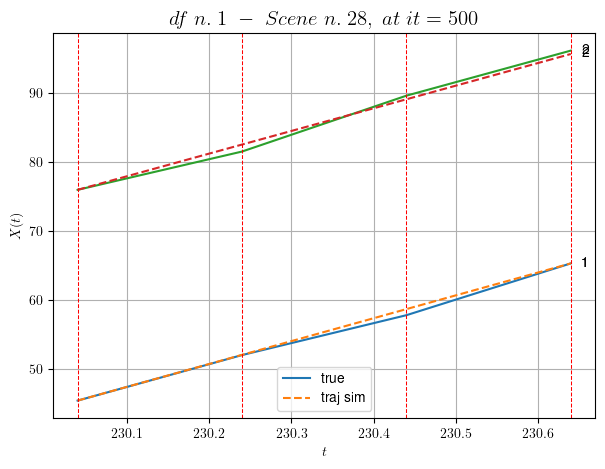

----------------------------------------------------------------------------------------------------
        For scene 16/73:
        * After LR finder: LR_NN=0.0001 with mse=1.1600320858886608 at it=24
        * v0 = 32.807102314918545
        * MSE = 0.2765014662472684
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.17/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [146.24,146.64]


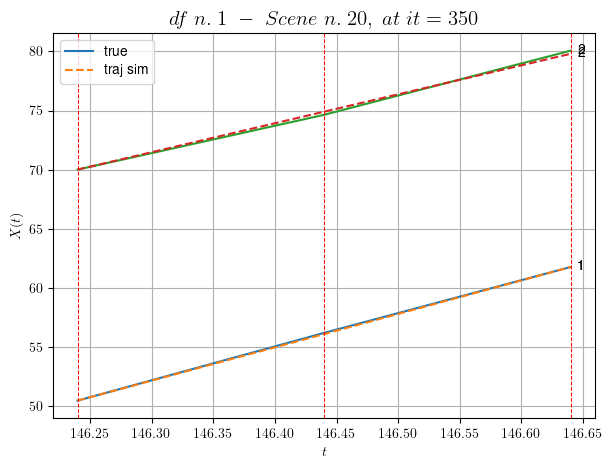

----------------------------------------------------------------------------------------------------
        For scene 17/73:
        * After LR finder: LR_NN=0.005 with mse=0.9432647698628107 at it=24
        * v0 = 24.481033392773558
        * MSE = 0.022956385692588788
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.18/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [164.04,164.64]


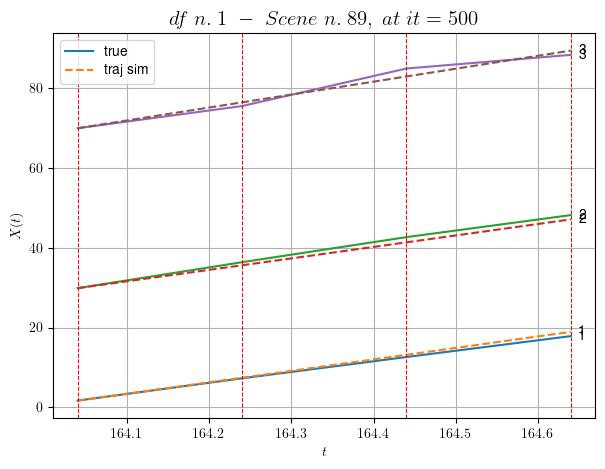

----------------------------------------------------------------------------------------------------
        For scene 18/73:
        * After LR finder: LR_NN=0.001 with mse=1.1851345182302688 at it=24
        * v0 = 32.432850946242915
        * MSE = 0.9086771752930751
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.19/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [262.64,263.64]


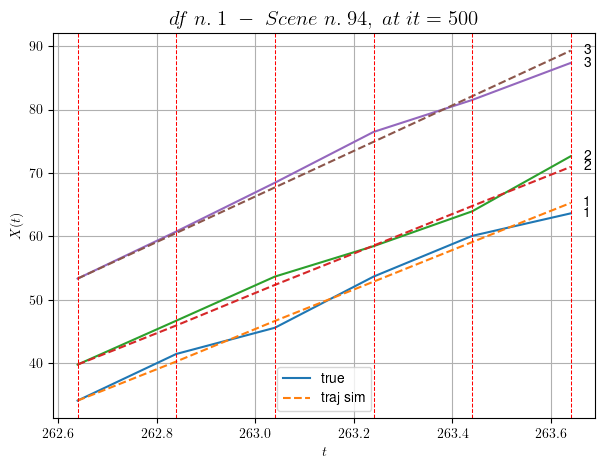

----------------------------------------------------------------------------------------------------
        For scene 19/73:
        * After LR finder: LR_NN=0.005 with mse=4.644274702667864 at it=24
        * v0 = 35.93109742746357
        * MSE = 1.0757431330633462
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.20/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [209.64,210.24]


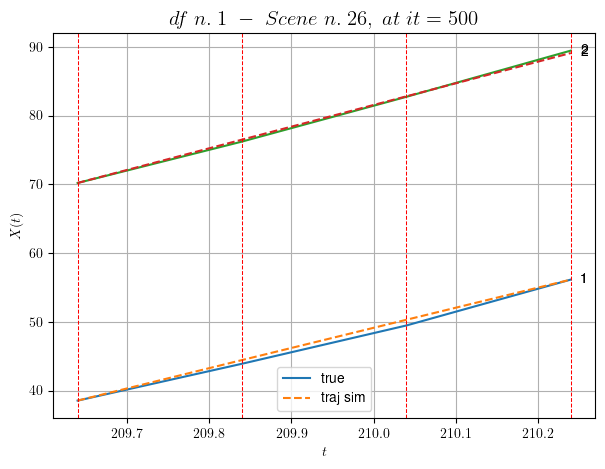

----------------------------------------------------------------------------------------------------
        For scene 20/73:
        * After LR finder: LR_NN=0.001 with mse=0.4216771538560348 at it=24
        * v0 = 31.507071372238986
        * MSE = 0.14720450745911667
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.21/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [60.04,60.84]


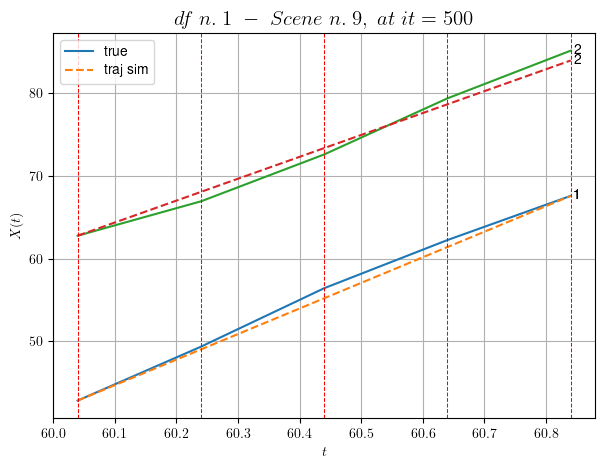

----------------------------------------------------------------------------------------------------
        For scene 21/73:
        * After LR finder: LR_NN=0.0001 with mse=1.4806657828216687 at it=24
        * v0 = 26.521619591085866
        * MSE = 0.609255678007092
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.22/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [447.44,448.04]


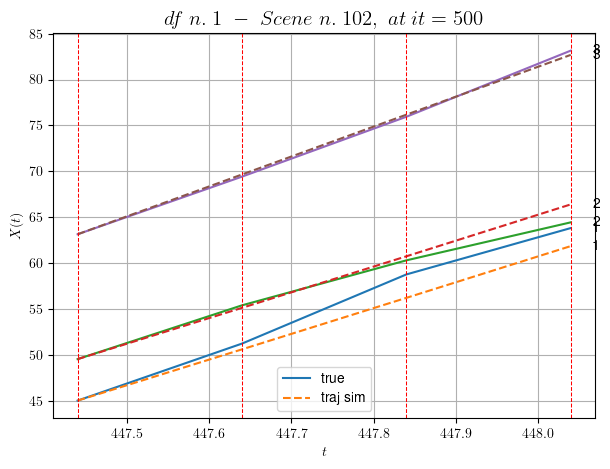

----------------------------------------------------------------------------------------------------
        For scene 22/73:
        * After LR finder: LR_NN=0.001 with mse=1.8532111306201573 at it=24
        * v0 = 32.58486004517705
        * MSE = 1.2635826495649072
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.23/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [351.64,352.24]


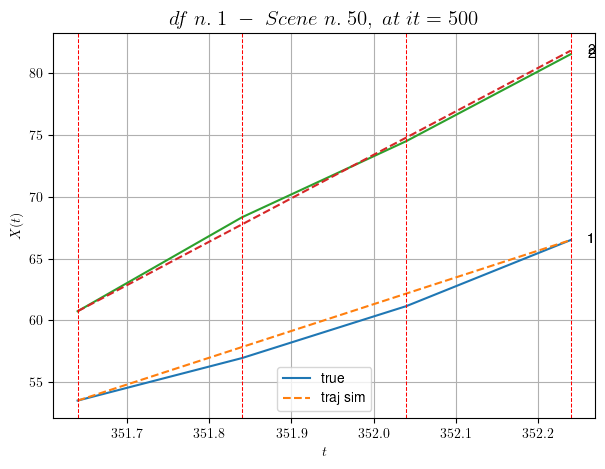

----------------------------------------------------------------------------------------------------
        For scene 23/73:
        * After LR finder: LR_NN=0.0001 with mse=1.7506860537535345 at it=24
        * v0 = 35.128237730719775
        * MSE = 0.29079437797523083
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.24/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [109.24,109.84]


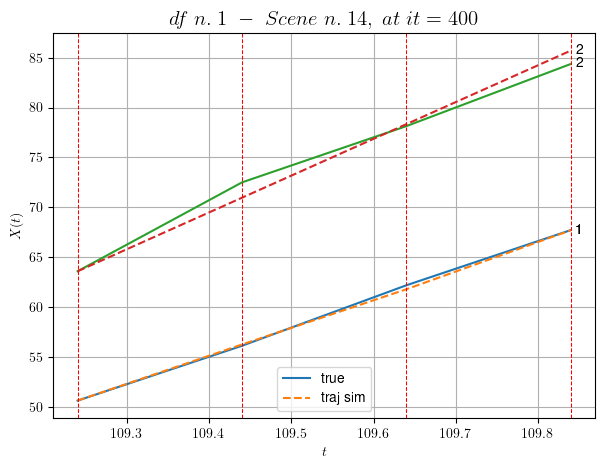

----------------------------------------------------------------------------------------------------
        For scene 24/73:
        * After LR finder: LR_NN=0.01 with mse=2.9139552383088345 at it=24
        * v0 = 36.870360259119316
        * MSE = 0.4998166771366262
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.25/73
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [571.04,572.64]


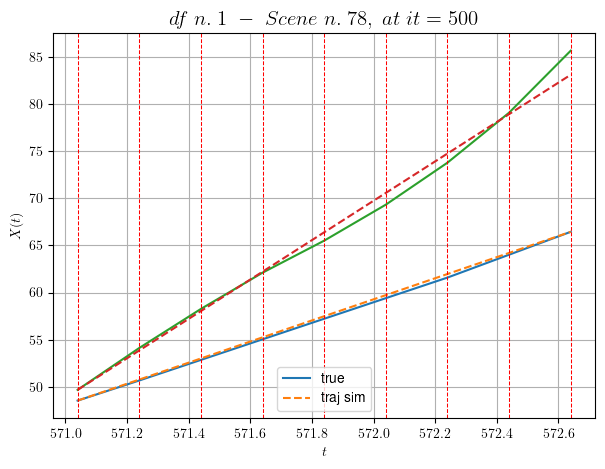

----------------------------------------------------------------------------------------------------
        For scene 25/73:
        * After LR finder: LR_NN=0.001 with mse=37.01365894022215 at it=24
        * v0 = 20.877122500554435
        * MSE = 0.567397064886644
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.26/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [200.44,201.24]


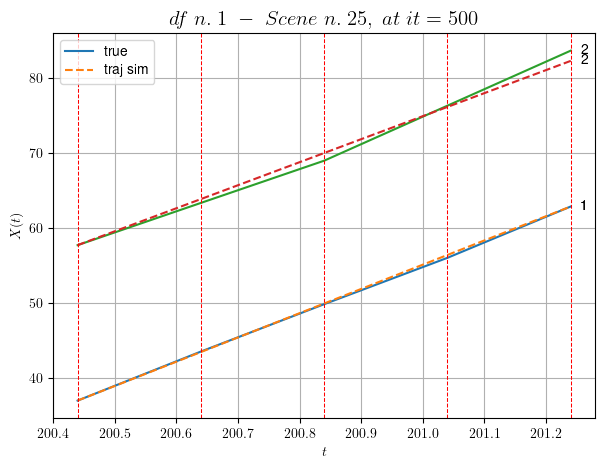

----------------------------------------------------------------------------------------------------
        For scene 26/73:
        * After LR finder: LR_NN=0.0005 with mse=0.49919215391333677 at it=24
        * v0 = 30.710273891218527
        * MSE = 0.335673826581907
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.27/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [37.44,38.24]


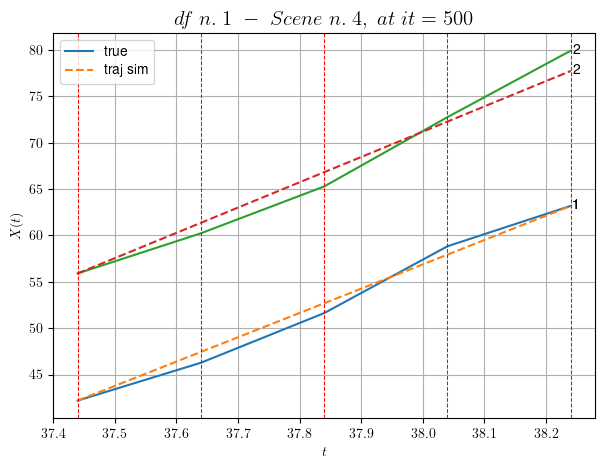

----------------------------------------------------------------------------------------------------
        For scene 27/73:
        * After LR finder: LR_NN=0.0001 with mse=1.5795538823844897 at it=24
        * v0 = 27.295254165821042
        * MSE = 1.1977551414122491
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.28/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [140.64,141.24]


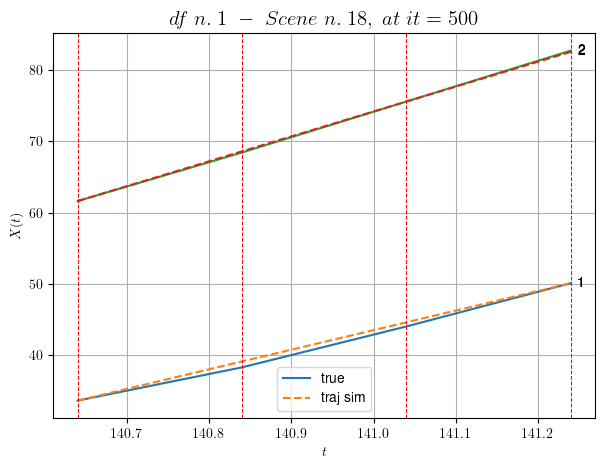

----------------------------------------------------------------------------------------------------
        For scene 28/73:
        * After LR finder: LR_NN=0.0001 with mse=1.8532175223735246 at it=24
        * v0 = 34.92834910020631
        * MSE = 0.12641395097218508
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.29/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [301.44,302.44]


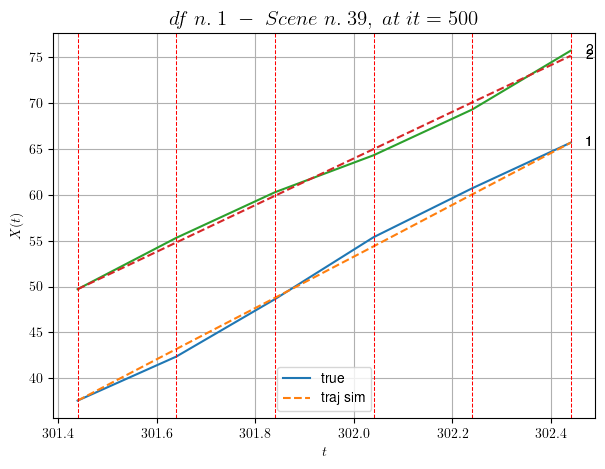

----------------------------------------------------------------------------------------------------
        For scene 29/73:
        * After LR finder: LR_NN=0.001 with mse=4.432071347502605 at it=24
        * v0 = 25.446081747008098
        * MSE = 0.32352895859596176
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.30/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [131.64,132.04]


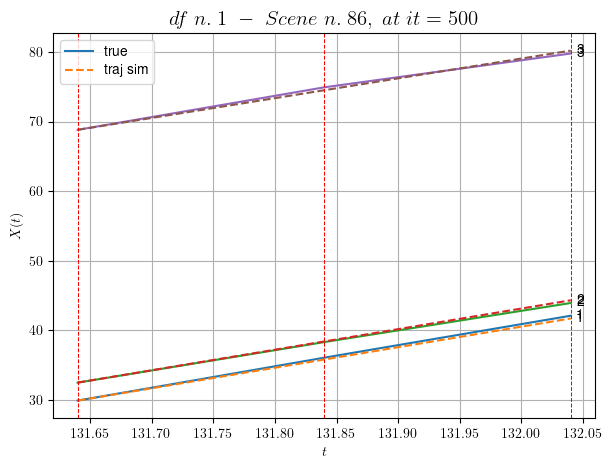

----------------------------------------------------------------------------------------------------
        For scene 30/73:
        * After LR finder: LR_NN=0.001 with mse=0.13680166069303934 at it=24
        * v0 = 28.44289270224775
        * MSE = 0.08093644566763171
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.31/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [54.84,55.24]


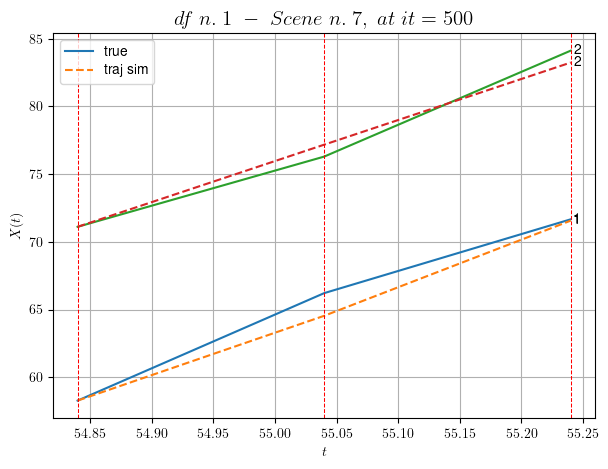

----------------------------------------------------------------------------------------------------
        For scene 31/73:
        * After LR finder: LR_NN=0.005 with mse=0.914635362795677 at it=24
        * v0 = 30.333444658289157
        * MSE = 0.7154944915399594
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.32/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [499.04,499.44]


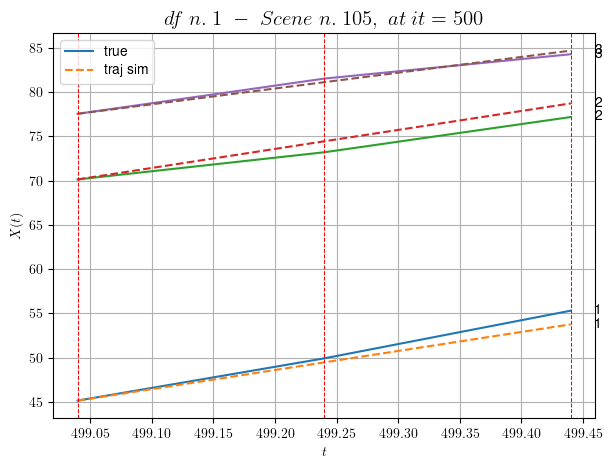

----------------------------------------------------------------------------------------------------
        For scene 32/73:
        * After LR finder: LR_NN=0.001 with mse=4.30003479830727 at it=24
        * v0 = 17.832163517130923
        * MSE = 0.7567072561817767
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.33/73
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [325.24,326.44]


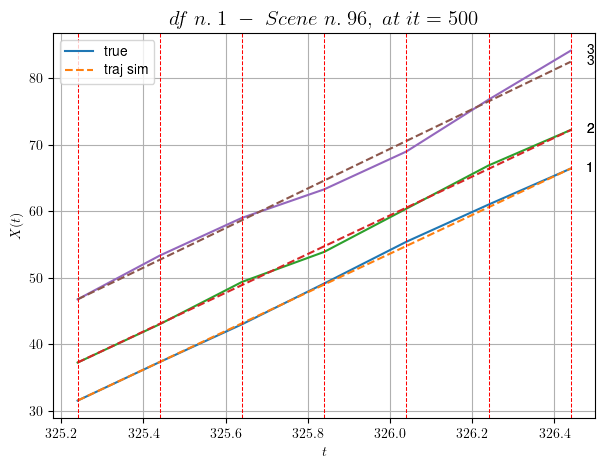

----------------------------------------------------------------------------------------------------
        For scene 33/73:
        * After LR finder: LR_NN=0.001 with mse=0.4788629066067301 at it=24
        * v0 = 29.804033810069342
        * MSE = 0.4527472823948231
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.34/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [240.64,241.04]


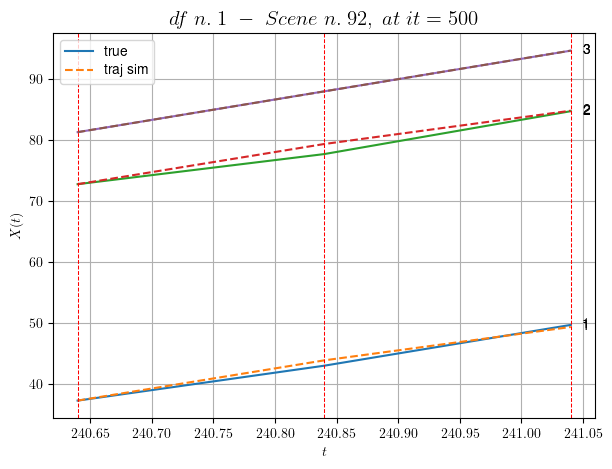

----------------------------------------------------------------------------------------------------
        For scene 34/73:
        * After LR finder: LR_NN=0.01 with mse=0.89920670495687 at it=24
        * v0 = 33.34476984108596
        * MSE = 0.37527851435449106
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.35/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [380.24,380.64]


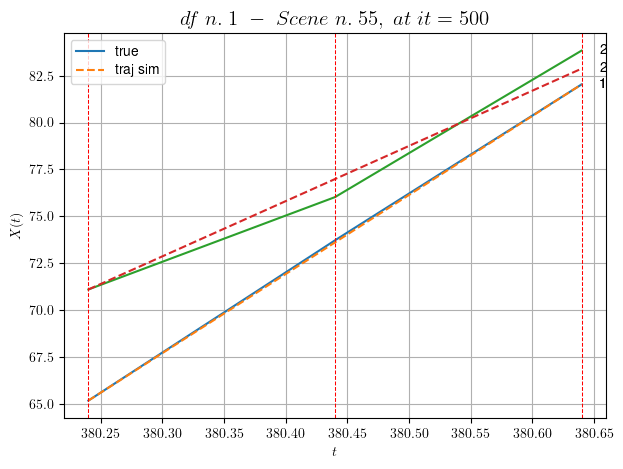

----------------------------------------------------------------------------------------------------
        For scene 35/73:
        * After LR finder: LR_NN=0.001 with mse=0.2869514437717462 at it=24
        * v0 = 29.441226265332276
        * MSE = 0.2968300357866642
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.36/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [352.84,353.84]


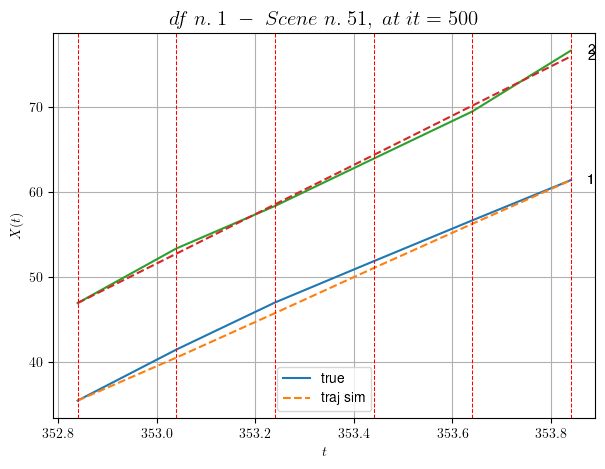

----------------------------------------------------------------------------------------------------
        For scene 36/73:
        * After LR finder: LR_NN=0.005 with mse=0.4985671821378055 at it=24
        * v0 = 29.02856357779854
        * MSE = 0.39733244026671455
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.37/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [386.64,387.44]


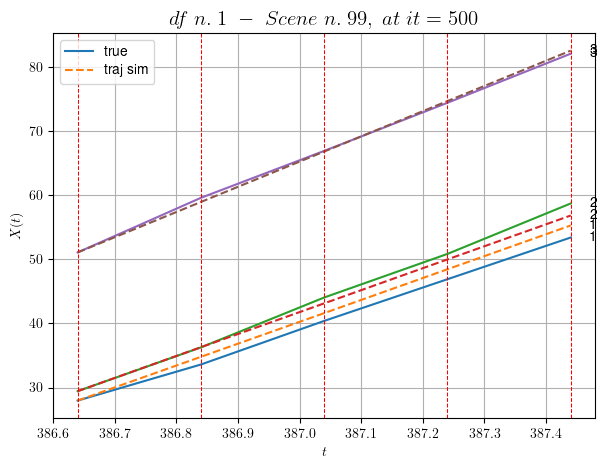

----------------------------------------------------------------------------------------------------
        For scene 37/73:
        * After LR finder: LR_NN=0.0005 with mse=7.489160655888551 at it=24
        * v0 = 39.34610016762202
        * MSE = 0.9720555765092637
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.38/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [335.24,335.84]


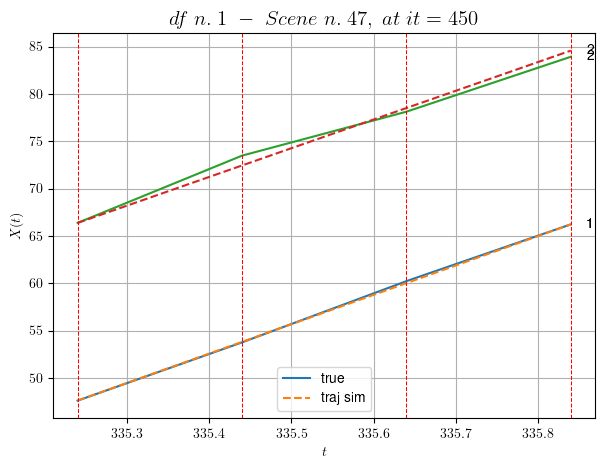

----------------------------------------------------------------------------------------------------
        For scene 38/73:
        * After LR finder: LR_NN=0.0001 with mse=0.18859280223799516 at it=24
        * v0 = 30.337239387417167
        * MSE = 0.21073440347261507
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.39/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [72.44,73.44]


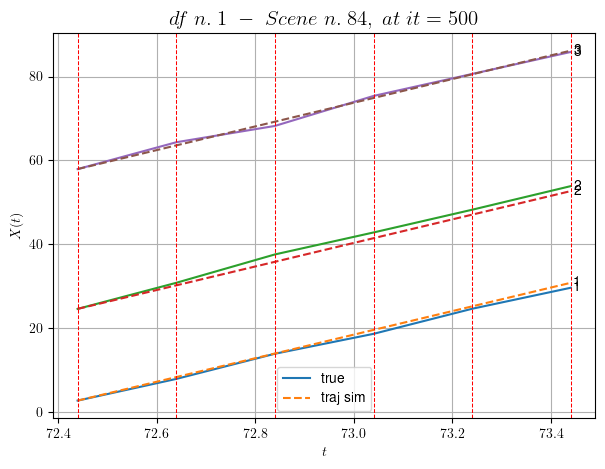

----------------------------------------------------------------------------------------------------
        For scene 39/73:
        * After LR finder: LR_NN=0.0005 with mse=1.1416921683923729 at it=24
        * v0 = 28.25092057390808
        * MSE = 0.7122775131941199
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.40/73
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [431.04,432.24]


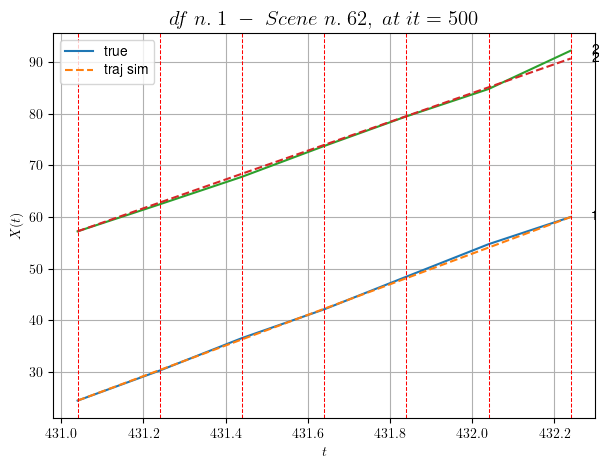

----------------------------------------------------------------------------------------------------
        For scene 40/73:
        * After LR finder: LR_NN=5e-05 with mse=1.0768916548903666 at it=24
        * v0 = 27.914827173163562
        * MSE = 0.2541024527149886
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.41/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [500.64,501.04]


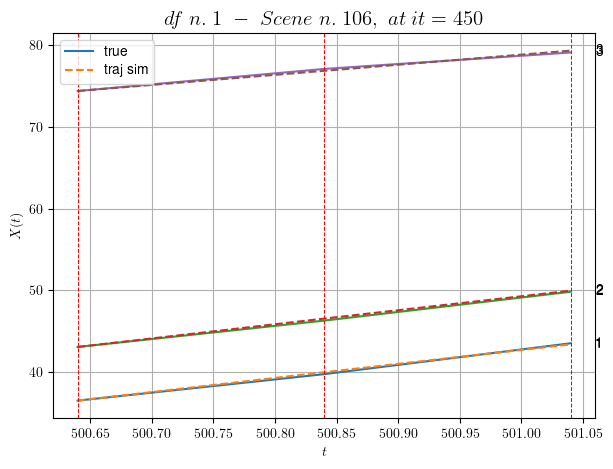

----------------------------------------------------------------------------------------------------
        For scene 41/73:
        * After LR finder: LR_NN=0.005 with mse=7.121357806709374 at it=24
        * v0 = 12.361373747546395
        * MSE = 0.028149044800256772
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.42/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [446.24,446.84]


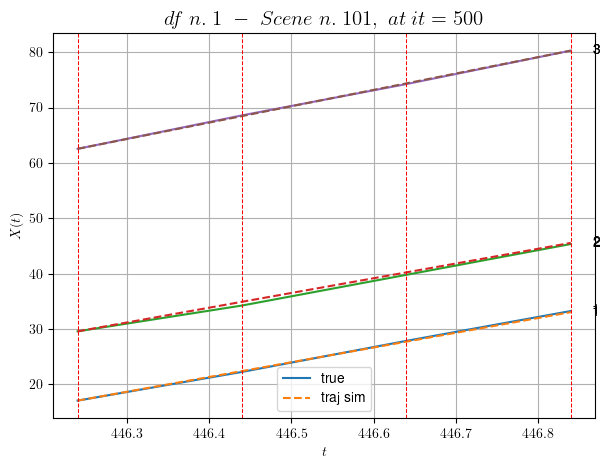

----------------------------------------------------------------------------------------------------
        For scene 42/73:
        * After LR finder: LR_NN=0.001 with mse=0.08755042818609197 at it=24
        * v0 = 29.55442920912675
        * MSE = 0.06731823439160085
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.43/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [316.44,317.04]


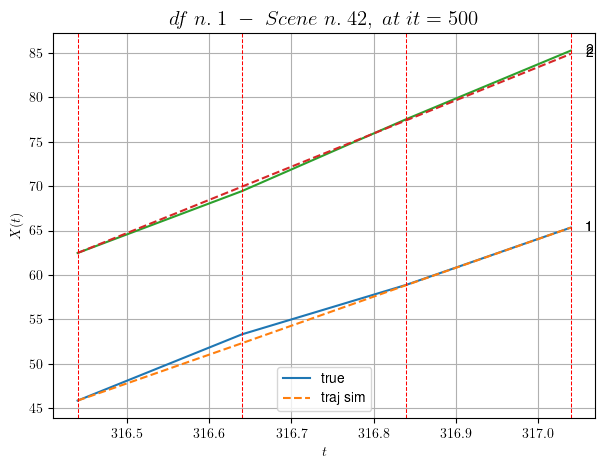

----------------------------------------------------------------------------------------------------
        For scene 43/73:
        * After LR finder: LR_NN=0.001 with mse=4.305569982272714 at it=24
        * v0 = 37.33434122714424
        * MSE = 0.17402806596692744
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.44/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [403.64,404.64]


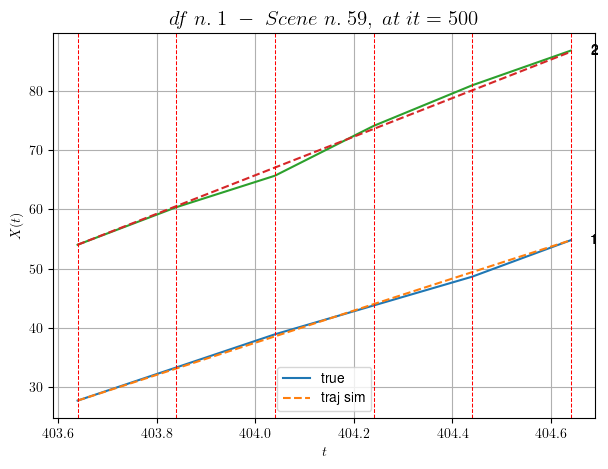

----------------------------------------------------------------------------------------------------
        For scene 44/73:
        * After LR finder: LR_NN=0.001 with mse=1.818970833133138 at it=24
        * v0 = 32.57978285326547
        * MSE = 0.3111333828847751
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.45/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [349.64,350.44]


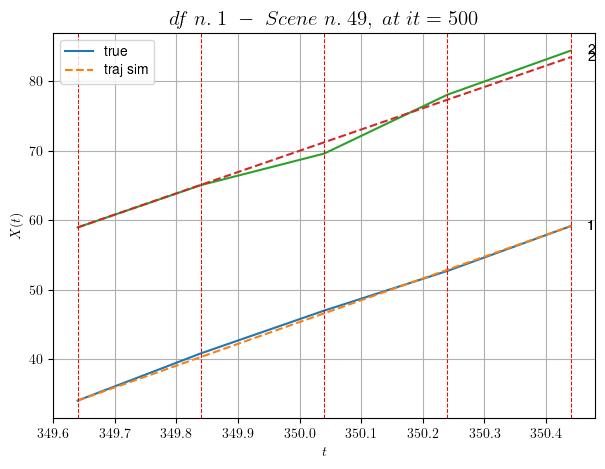

----------------------------------------------------------------------------------------------------
        For scene 45/73:
        * After LR finder: LR_NN=5e-05 with mse=0.5506292461275237 at it=24
        * v0 = 30.663808885196026
        * MSE = 0.45070188300217284
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.46/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [314.84,315.64]


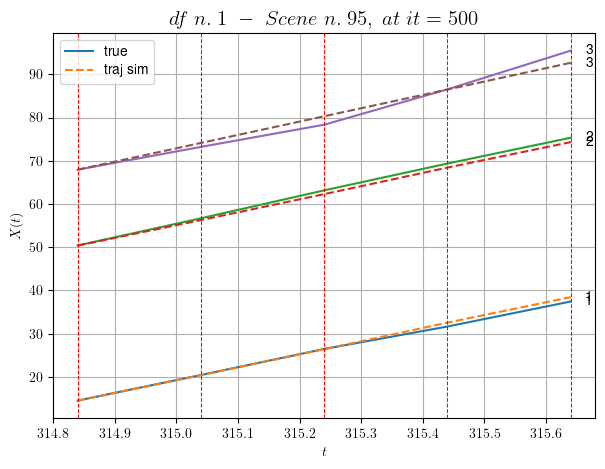

----------------------------------------------------------------------------------------------------
        For scene 46/73:
        * After LR finder: LR_NN=0.01 with mse=1.3763467956365332 at it=24
        * v0 = 30.926247858928914
        * MSE = 1.1472688709504426
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.47/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [402.04,402.84]


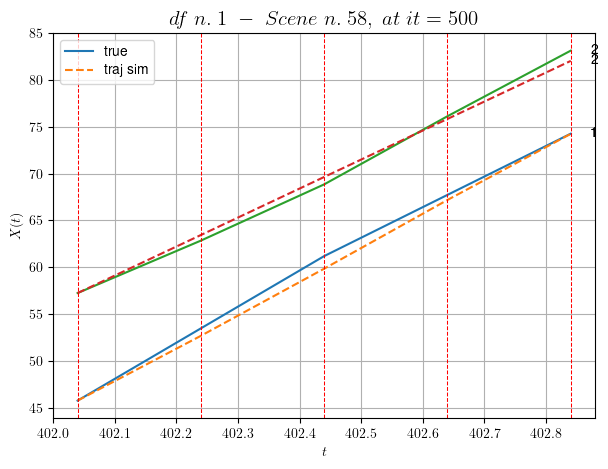

----------------------------------------------------------------------------------------------------
        For scene 47/73:
        * After LR finder: LR_NN=0.005 with mse=0.6208420992316583 at it=24
        * v0 = 31.006759212236418
        * MSE = 0.49976673254613857
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.48/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [561.44,561.84]


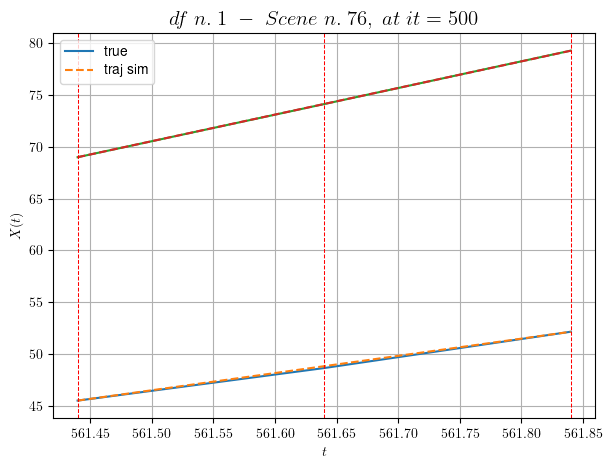

----------------------------------------------------------------------------------------------------
        For scene 48/73:
        * After LR finder: LR_NN=0.0005 with mse=0.6091871171308636 at it=24
        * v0 = 25.727722160465976
        * MSE = 0.005446385414817336
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.49/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [271.04,271.64]


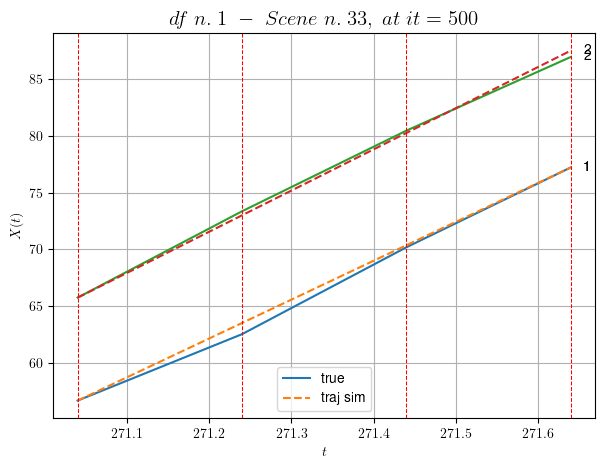

----------------------------------------------------------------------------------------------------
        For scene 49/73:
        * After LR finder: LR_NN=0.0001 with mse=2.564317684683116 at it=24
        * v0 = 36.29888466501552
        * MSE = 0.17003321830084075
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.50/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [573.84,574.44]


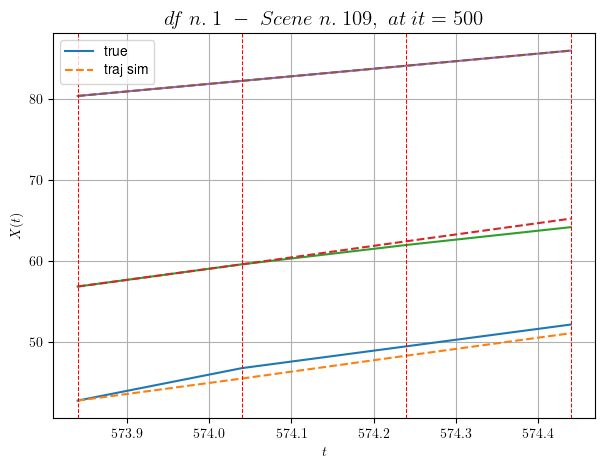

----------------------------------------------------------------------------------------------------
        For scene 50/73:
        * After LR finder: LR_NN=0.005 with mse=20.40425319211967 at it=24
        * v0 = 9.338719660906982
        * MSE = 0.45265151898514083
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.51/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [411.64,412.64]


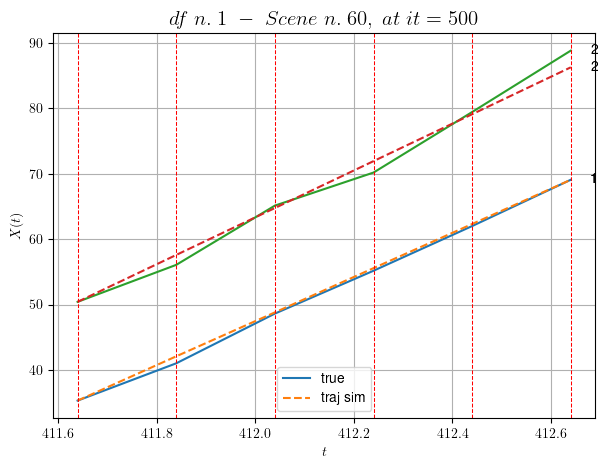

----------------------------------------------------------------------------------------------------
        For scene 51/73:
        * After LR finder: LR_NN=0.001 with mse=8.998193018569763 at it=24
        * v0 = 35.85294111711206
        * MSE = 1.1283068549676878
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.52/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [454.24,454.64]


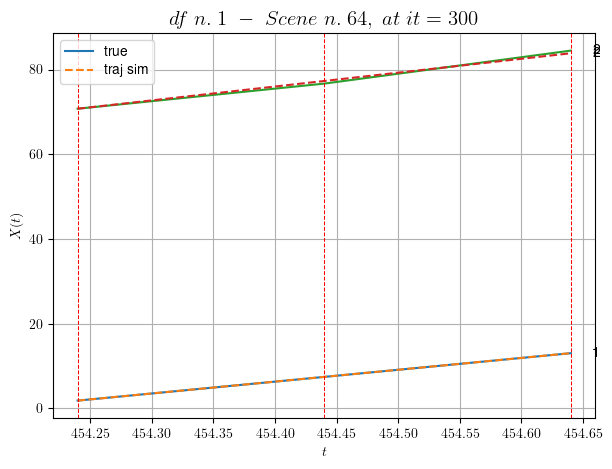

----------------------------------------------------------------------------------------------------
        For scene 52/73:
        * After LR finder: LR_NN=0.005 with mse=0.4982062654634075 at it=24
        * v0 = 32.767095328183245
        * MSE = 0.12846019548521567
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.53/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [502.24,503.04]


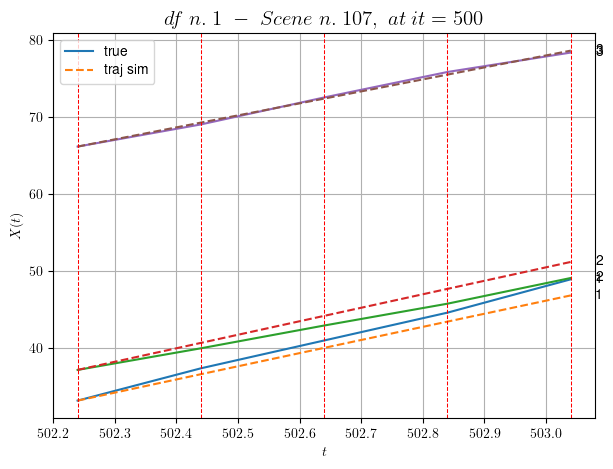

----------------------------------------------------------------------------------------------------
        For scene 53/73:
        * After LR finder: LR_NN=0.001 with mse=17.409169188808836 at it=24
        * v0 = 15.581016722934208
        * MSE = 1.1745332891115787
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.54/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [298.04,298.84]


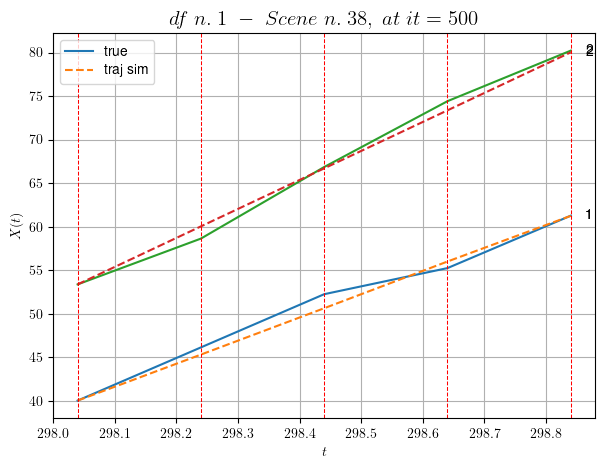

----------------------------------------------------------------------------------------------------
        For scene 54/73:
        * After LR finder: LR_NN=0.001 with mse=2.554080513774126 at it=24
        * v0 = 33.34266245905038
        * MSE = 0.698998947707238
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.55/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [249.84,250.44]


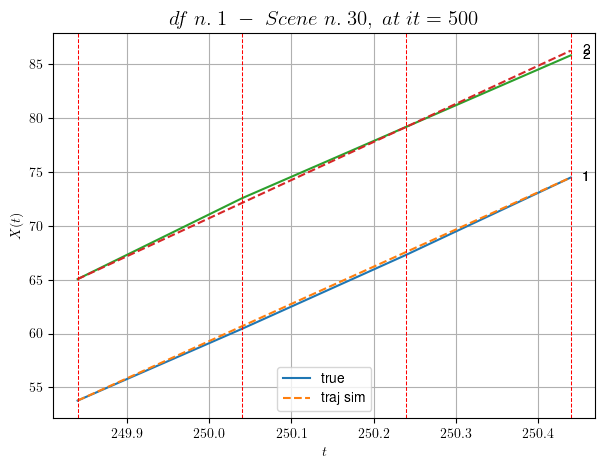

----------------------------------------------------------------------------------------------------
        For scene 55/73:
        * After LR finder: LR_NN=0.0001 with mse=1.8403894059774724 at it=24
        * v0 = 35.36623656084827
        * MSE = 0.056066531921103904
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.56/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [363.44,364.04]


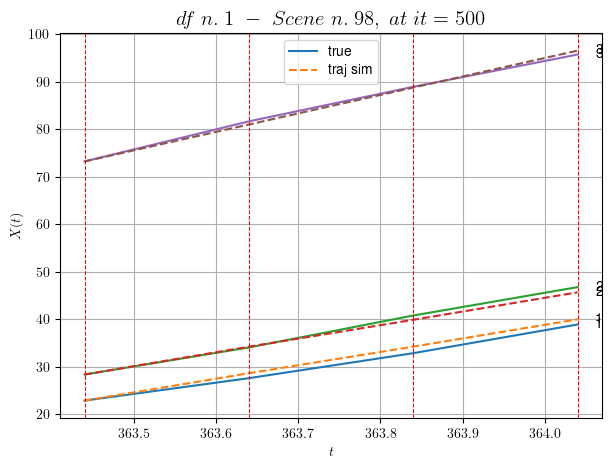

----------------------------------------------------------------------------------------------------
        For scene 56/73:
        * After LR finder: LR_NN=0.005 with mse=3.940655920827742 at it=24
        * v0 = 38.92349444301498
        * MSE = 0.6117191674907528
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.57/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [16.44,16.84]


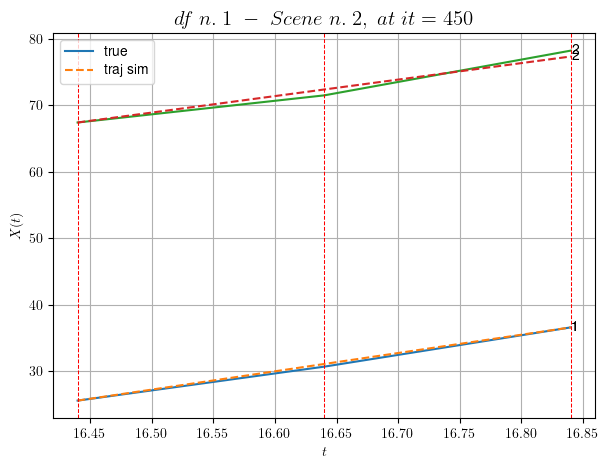

----------------------------------------------------------------------------------------------------
        For scene 57/73:
        * After LR finder: LR_NN=0.0001 with mse=0.9410636863852585 at it=24
        * v0 = 24.81916984057336
        * MSE = 0.28703485309806676
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.58/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [361.24,361.64]


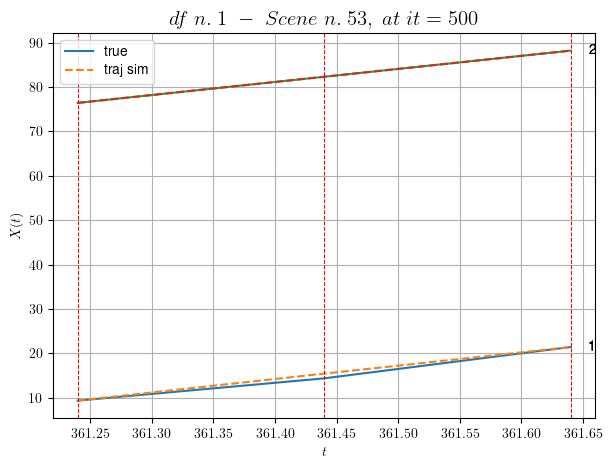

----------------------------------------------------------------------------------------------------
        For scene 58/73:
        * After LR finder: LR_NN=0.001 with mse=0.2135898761272594 at it=24
        * v0 = 29.45386090861989
        * MSE = 0.15956130268414587
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.59/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [193.24,193.64]


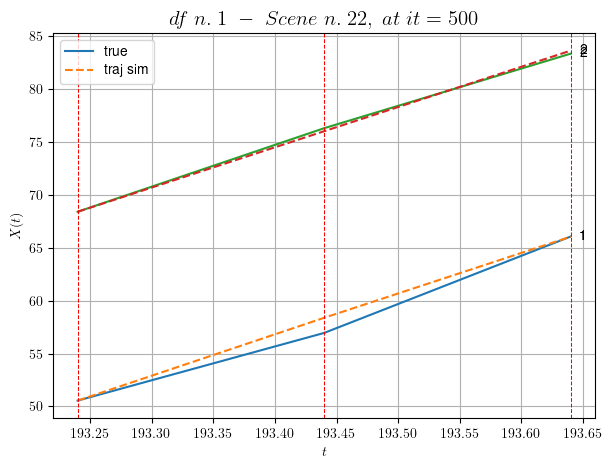

----------------------------------------------------------------------------------------------------
        For scene 59/73:
        * After LR finder: LR_NN=0.001 with mse=2.613961796439189 at it=24
        * v0 = 38.08399937691374
        * MSE = 0.3638895427592615
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.60/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [33.44,34.04]


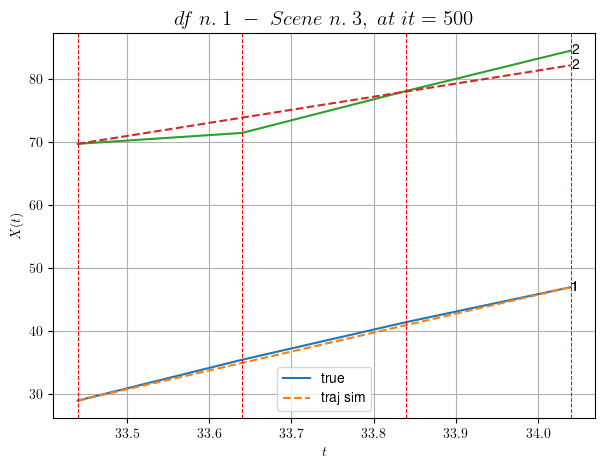

----------------------------------------------------------------------------------------------------
        For scene 60/73:
        * After LR finder: LR_NN=0.001 with mse=5.310811783238772 at it=24
        * v0 = 20.735623985237975
        * MSE = 1.2717170041670058
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.61/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [199.44,199.84]


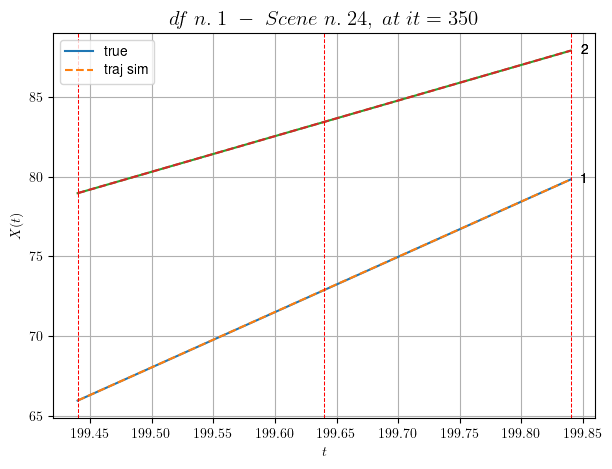

----------------------------------------------------------------------------------------------------
        For scene 61/73:
        * After LR finder: LR_NN=0.01 with mse=1.9238245105722438 at it=24
        * v0 = 22.403012857499277
        * MSE = 1.8462660109767626e-05
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.62/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [161.64,162.04]


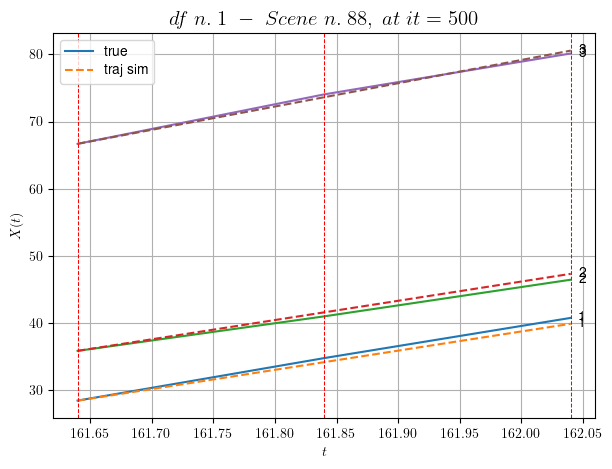

----------------------------------------------------------------------------------------------------
        For scene 62/73:
        * After LR finder: LR_NN=0.005 with mse=0.6669005975915727 at it=24
        * v0 = 34.71181519803638
        * MSE = 0.2906546706707713
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.63/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [431.84,432.24]


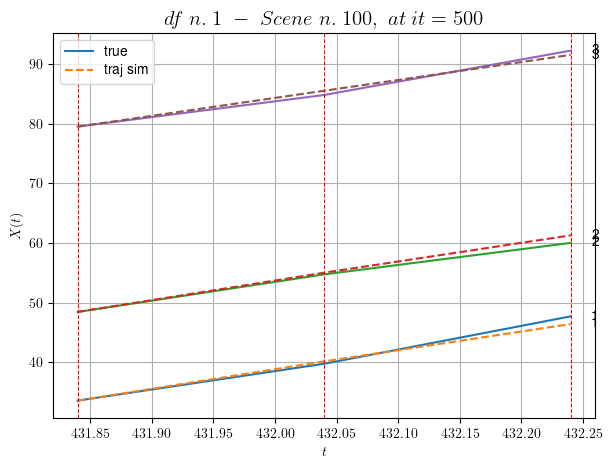

----------------------------------------------------------------------------------------------------
        For scene 63/73:
        * After LR finder: LR_NN=0.01 with mse=0.5321453620510539 at it=24
        * v0 = 30.084161636187044
        * MSE = 0.49962044090256713
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.64/73
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [531.64,533.24]


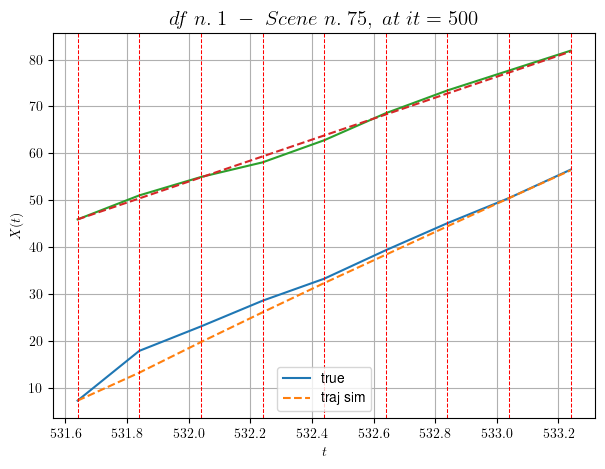

----------------------------------------------------------------------------------------------------
        For scene 64/73:
        * After LR finder: LR_NN=0.005 with mse=27.525060731154053 at it=24
        * v0 = 22.382648405903463
        * MSE = 1.75366819611909
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.65/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [148.04,148.44]


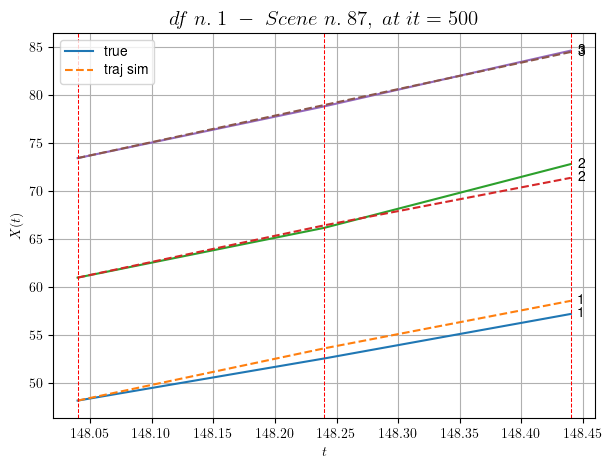

----------------------------------------------------------------------------------------------------
        For scene 65/73:
        * After LR finder: LR_NN=0.01 with mse=0.7427083543760146 at it=24
        * v0 = 27.621656721216297
        * MSE = 0.5657415476787542
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.66/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [23.64,24.64]


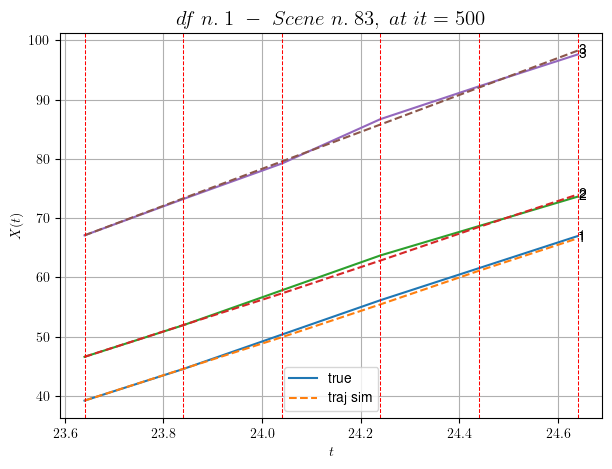

----------------------------------------------------------------------------------------------------
        For scene 66/73:
        * After LR finder: LR_NN=0.01 with mse=0.338822994379401 at it=24
        * v0 = 31.184420565840195
        * MSE = 0.19796560341003303
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.67/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [159.84,160.64]


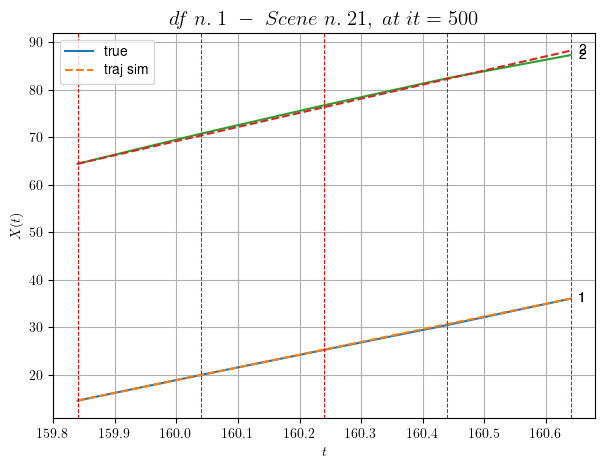

----------------------------------------------------------------------------------------------------
        For scene 67/73:
        * After LR finder: LR_NN=0.001 with mse=0.15004927315388455 at it=24
        * v0 = 29.799065415673457
        * MSE = 0.1255140169787832
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.68/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [429.24,429.84]


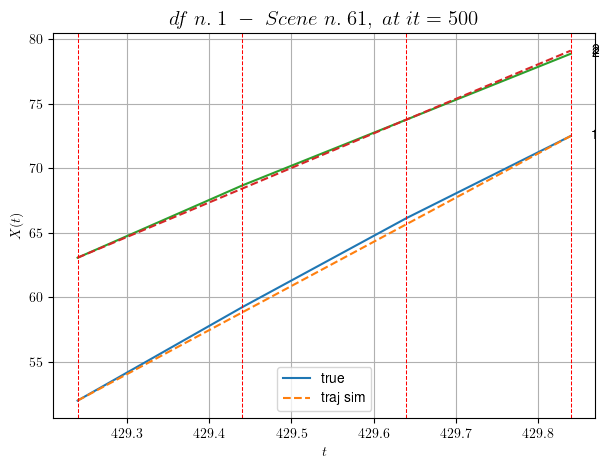

----------------------------------------------------------------------------------------------------
        For scene 68/73:
        * After LR finder: LR_NN=0.0005 with mse=0.8879068305020318 at it=24
        * v0 = 26.76492351473009
        * MSE = 0.06296381484742727
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.69/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [489.04,489.84]


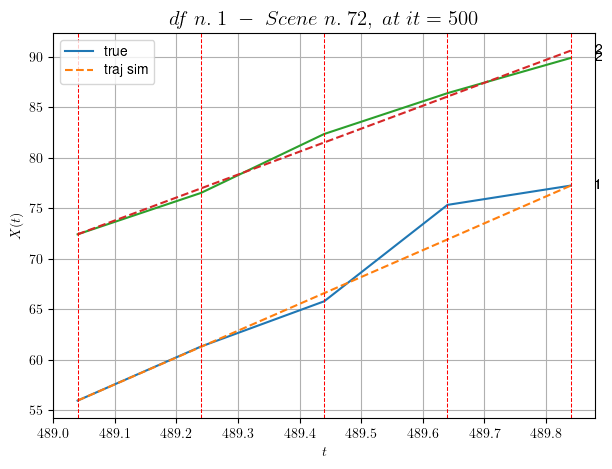

----------------------------------------------------------------------------------------------------
        For scene 69/73:
        * After LR finder: LR_NN=5e-05 with mse=7.533347885624433 at it=24
        * v0 = 22.729734196720074
        * MSE = 1.1475975423713005
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.70/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [116.04,117.04]


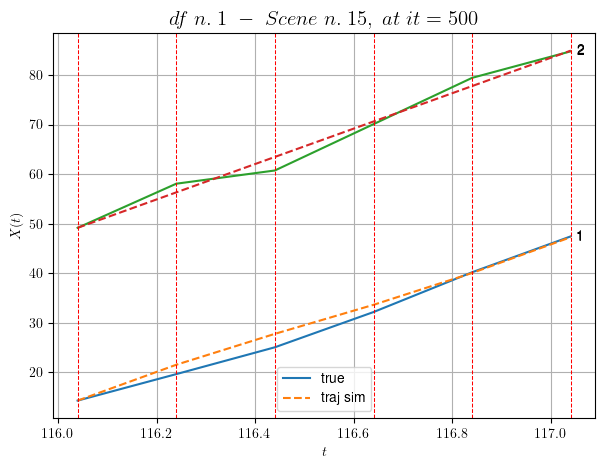

----------------------------------------------------------------------------------------------------
        For scene 70/73:
        * After LR finder: LR_NN=0.01 with mse=7.7462159077872705 at it=24
        * v0 = 35.75445949476121
        * MSE = 1.6204819083219417
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.71/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [253.64,254.04]


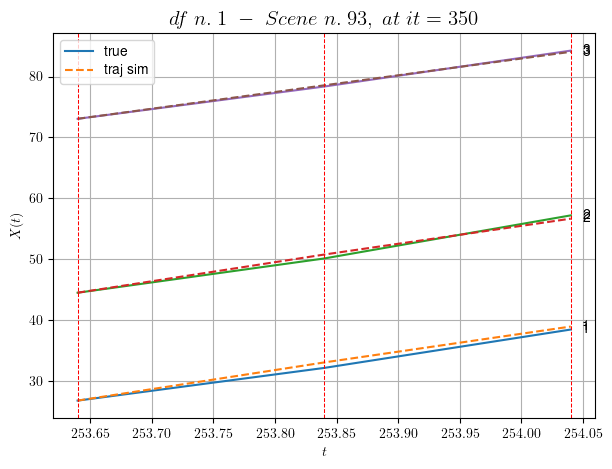

----------------------------------------------------------------------------------------------------
        For scene 71/73:
        * After LR finder: LR_NN=0.005 with mse=0.3489331405218878 at it=24
        * v0 = 27.474897828444135
        * MSE = 0.20379843252312702
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.72/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [358.84,359.64]


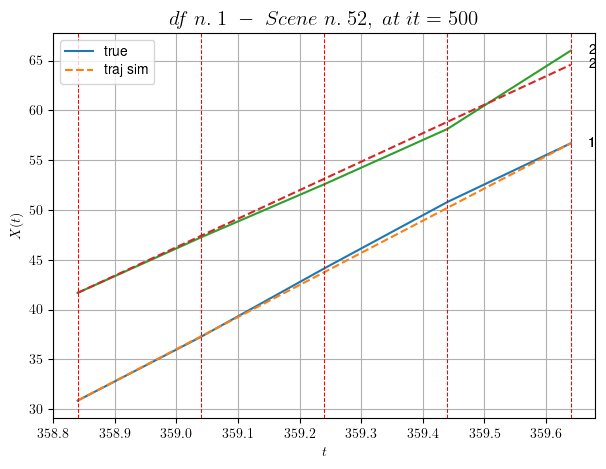

----------------------------------------------------------------------------------------------------
        For scene 72/73:
        * After LR finder: LR_NN=0.001 with mse=0.4962941343528552 at it=24
        * v0 = 28.62644197692017
        * MSE = 0.32350977270315817
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.73/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [495.84,496.24]


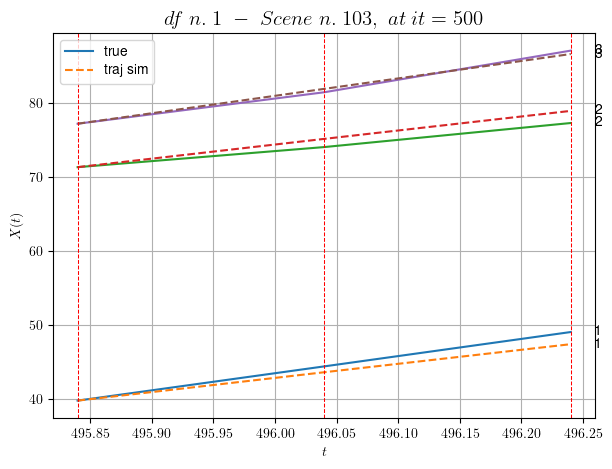

----------------------------------------------------------------------------------------------------
        For scene 73/73:
        * After LR finder: LR_NN=0.005 with mse=1.6523820612470435 at it=24
        * v0 = 23.563093490872365
        * MSE = 0.8482680301122709
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.5973406892998294
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (36 scenes)
DataFrame n.1. Scene n.1/36


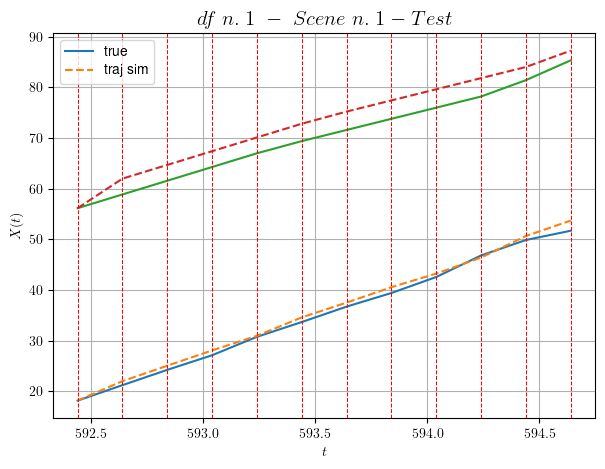

        For scene 1/36:
        * MSE = 5.171704726172599
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/36


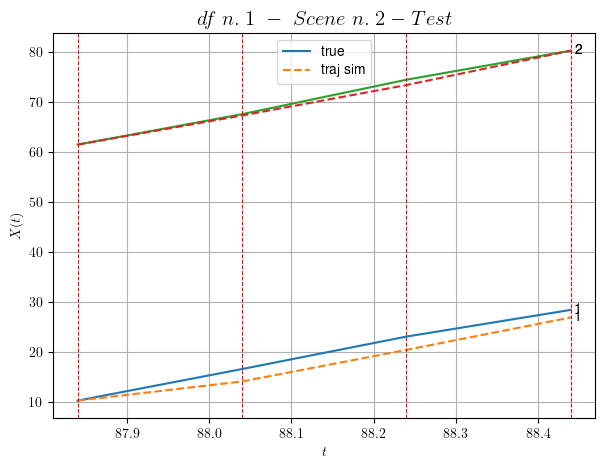

        For scene 2/36:
        * MSE = 2.0972962790451626
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/36


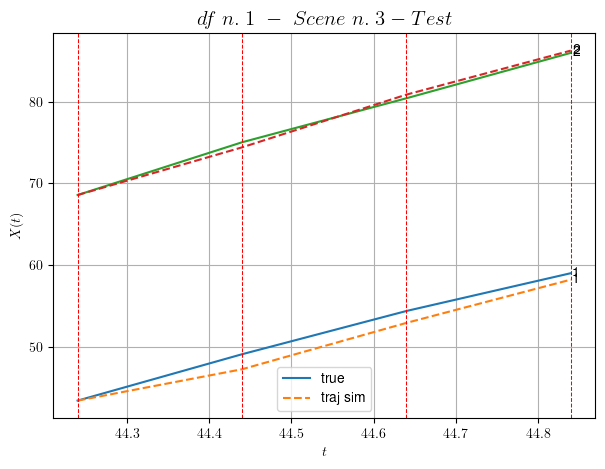

        For scene 3/36:
        * MSE = 0.8466993330521699
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/36


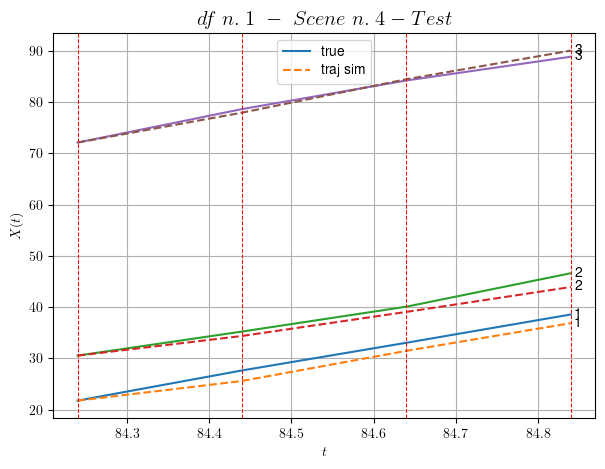

        For scene 4/36:
        * MSE = 1.7157291150139073
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/36


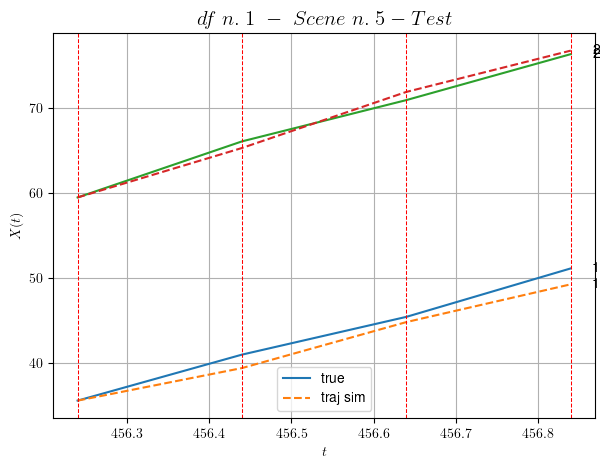

        For scene 5/36:
        * MSE = 1.013616495648852
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/36


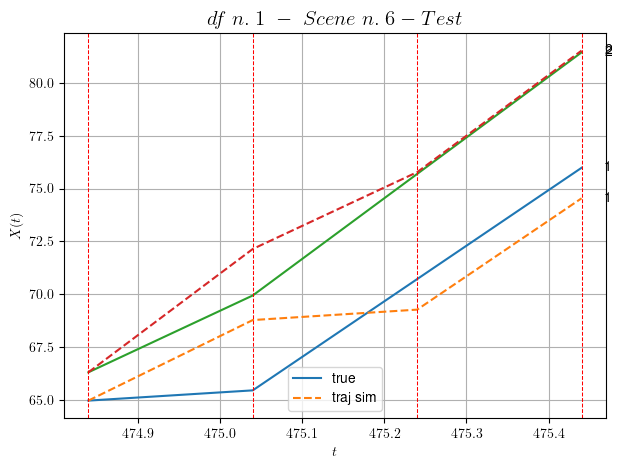

        For scene 6/36:
        * MSE = 2.506713277121037
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/36


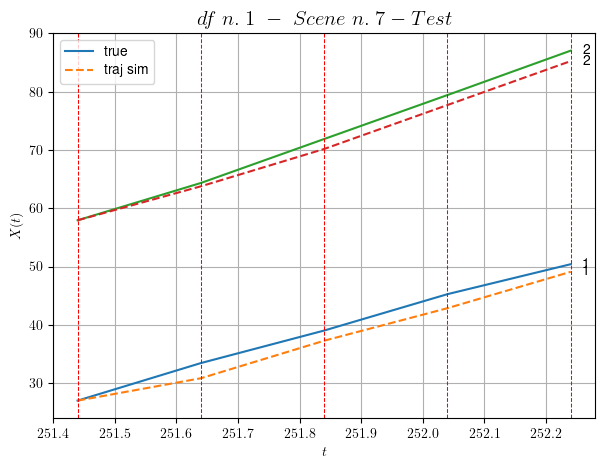

        For scene 7/36:
        * MSE = 2.6699829200277763
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/36


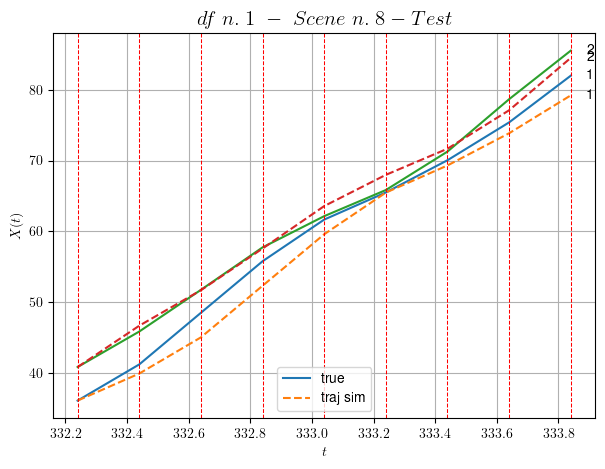

        For scene 8/36:
        * MSE = 2.8616162289686944
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/36


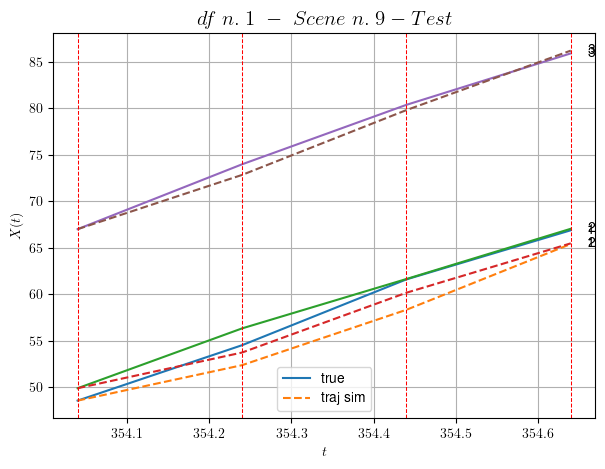

        For scene 9/36:
        * MSE = 2.544015805329389
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/36


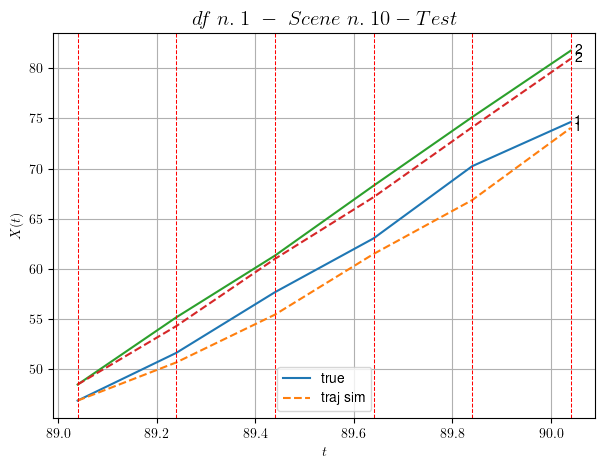

        For scene 10/36:
        * MSE = 1.997359365158866
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.11/36


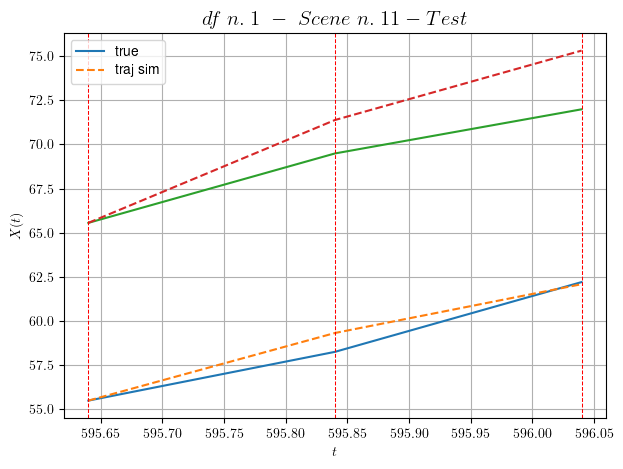

        For scene 11/36:
        * MSE = 2.637019895180913
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.12/36


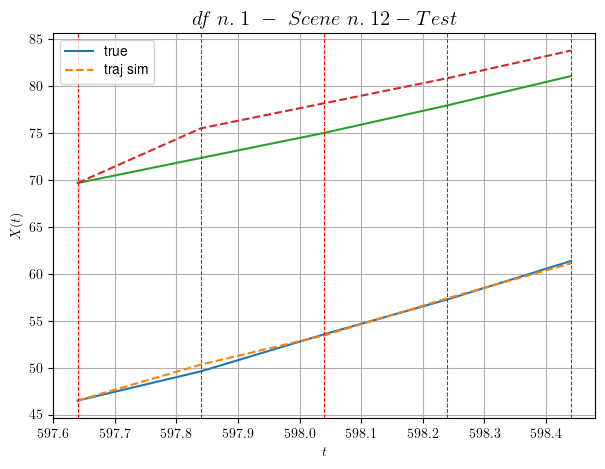

        For scene 12/36:
        * MSE = 3.630333170259381
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.13/36


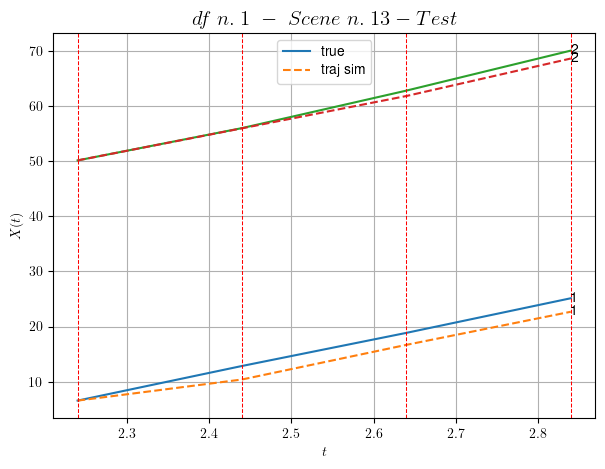

        For scene 13/36:
        * MSE = 2.477324701898289
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.14/36


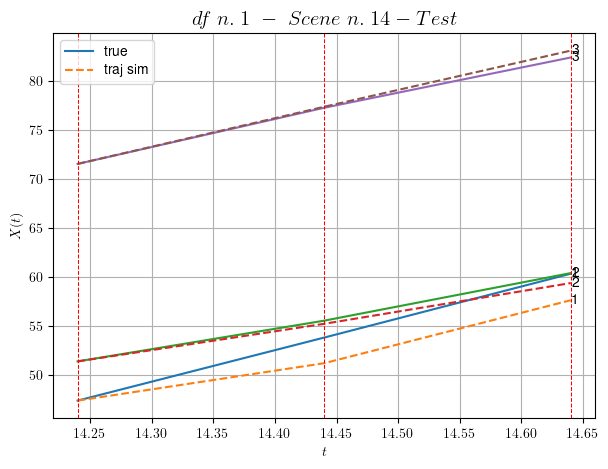

        For scene 14/36:
        * MSE = 1.7549559539327255
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.15/36


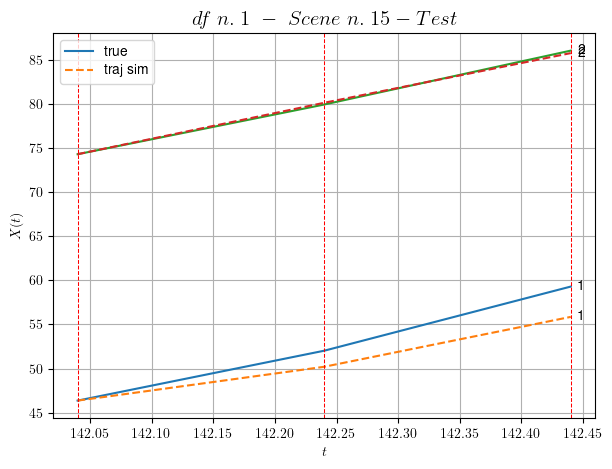

        For scene 15/36:
        * MSE = 2.540564722969682
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.16/36


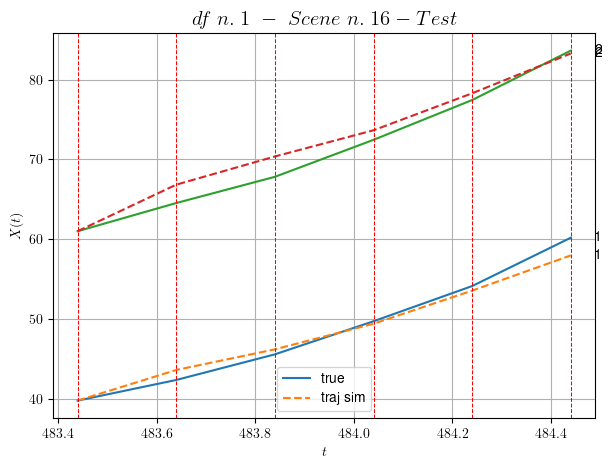

        For scene 16/36:
        * MSE = 1.779670143511602
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.17/36


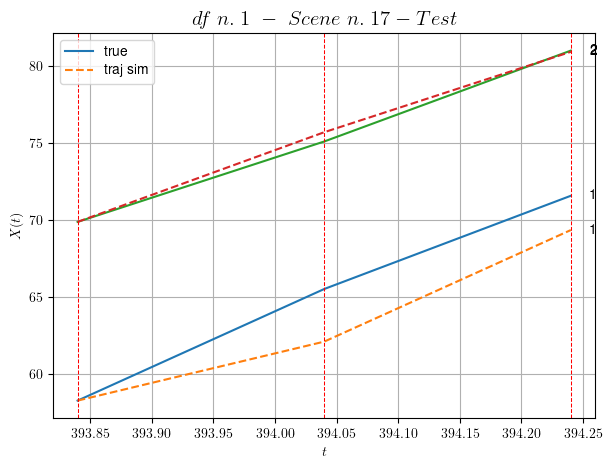

        For scene 17/36:
        * MSE = 2.838901105187825
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.18/36


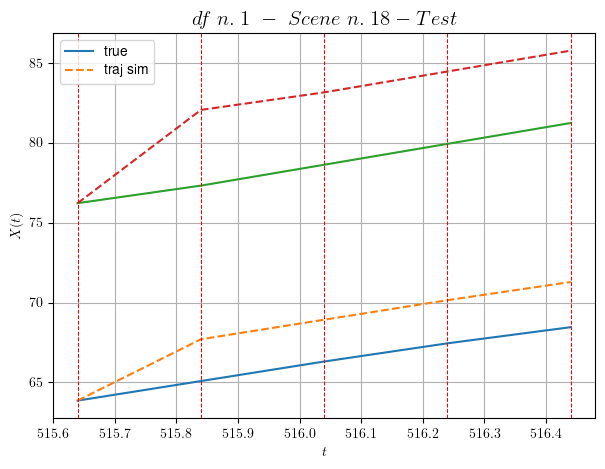

        For scene 18/36:
        * MSE = 11.272300620622156
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.19/36


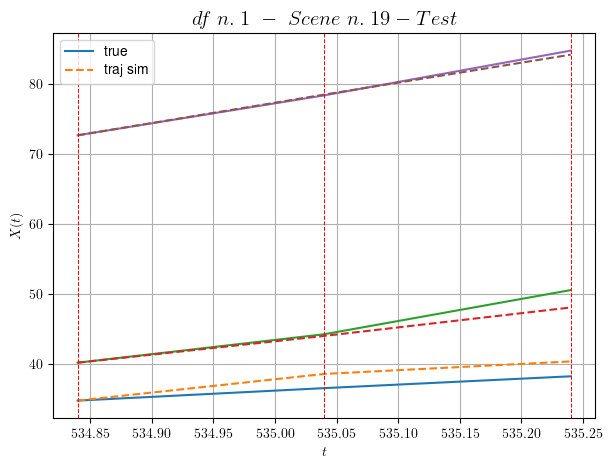

        For scene 19/36:
        * MSE = 1.7010792315284242
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.20/36


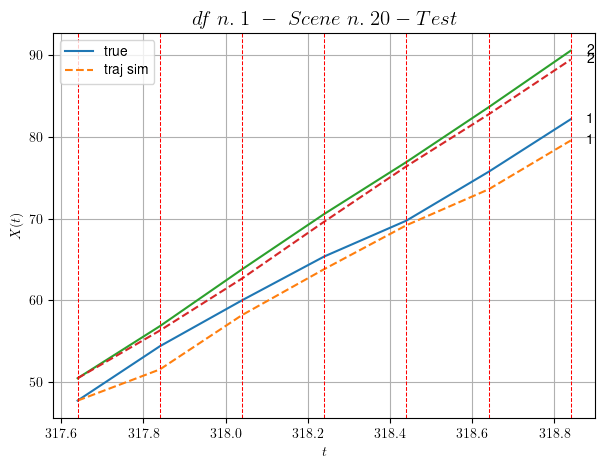

        For scene 20/36:
        * MSE = 2.1458831515946777
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.21/36


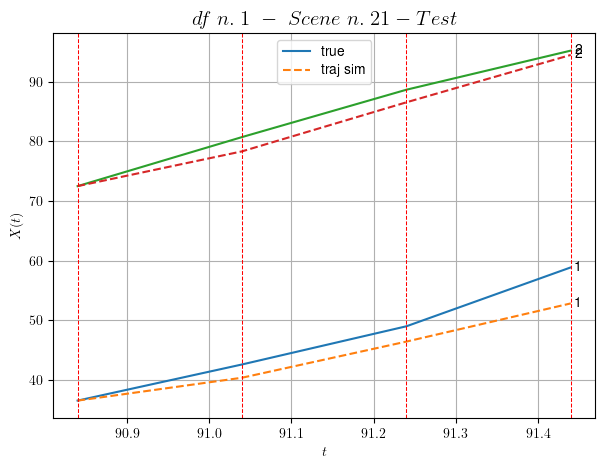

        For scene 21/36:
        * MSE = 7.341014745679306
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.22/36


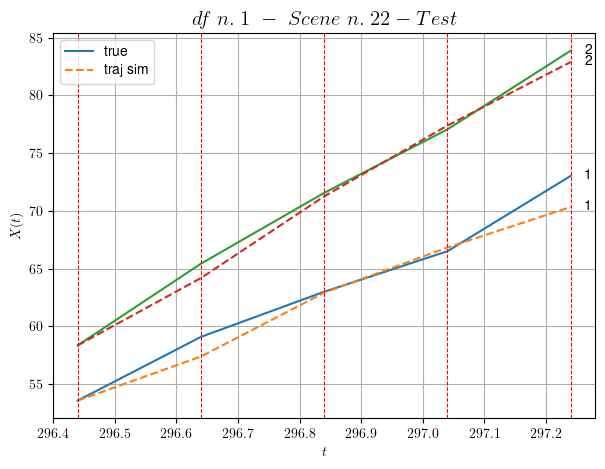

        For scene 22/36:
        * MSE = 1.2958970818987363
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.23/36


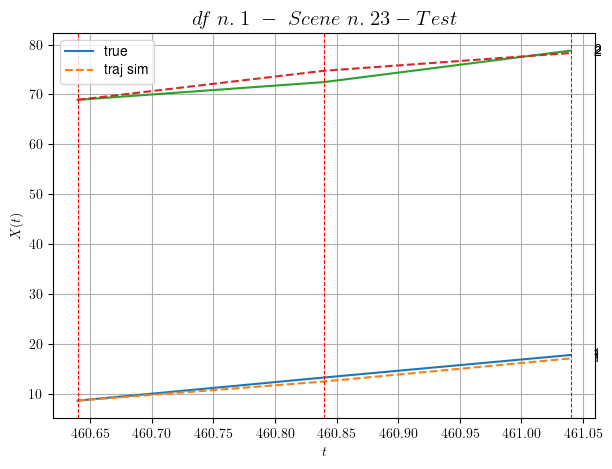

        For scene 23/36:
        * MSE = 1.0765937090626538
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.24/36


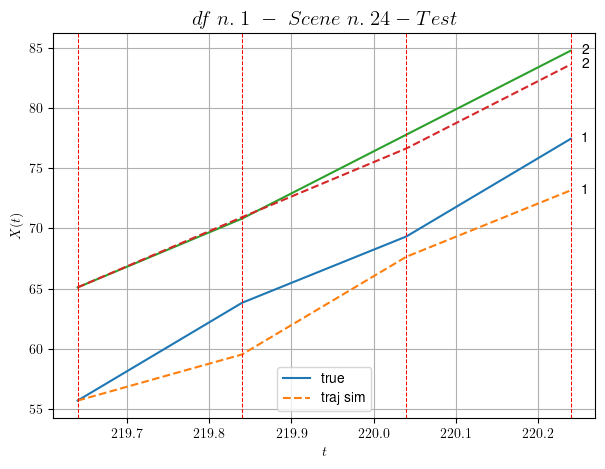

        For scene 24/36:
        * MSE = 5.27280415272517
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.25/36


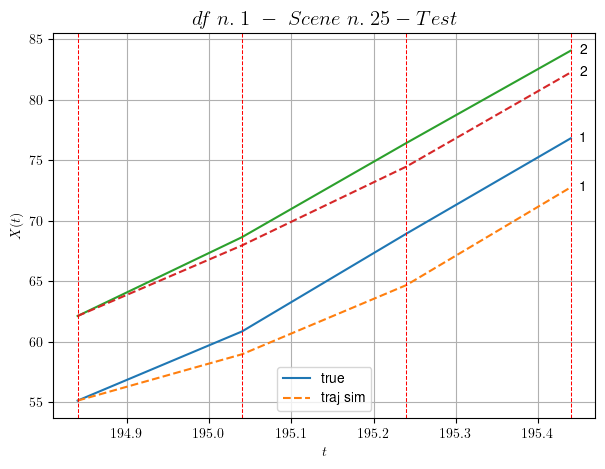

        For scene 25/36:
        * MSE = 5.680413497578197
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.26/36


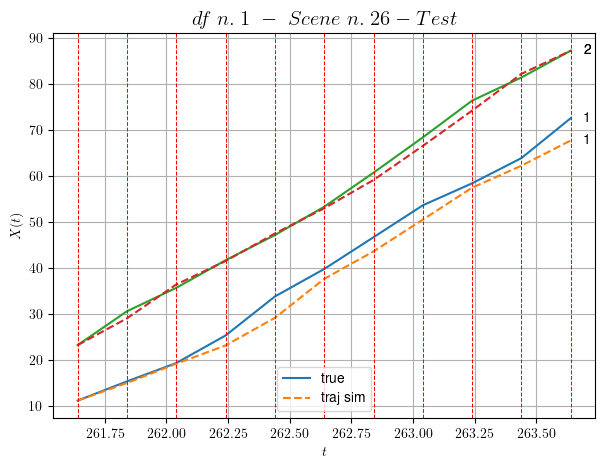

        For scene 26/36:
        * MSE = 4.18522870060233
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.27/36


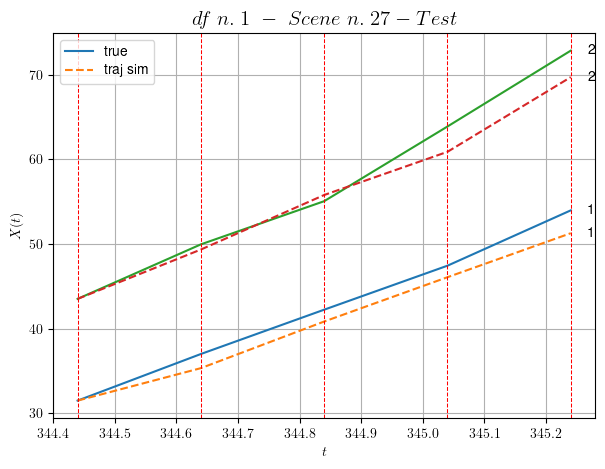

        For scene 27/36:
        * MSE = 3.354319977673881
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.28/36


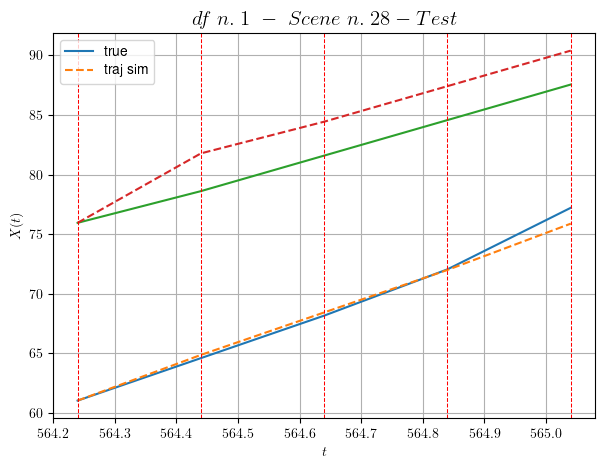

        For scene 28/36:
        * MSE = 3.6278491908888104
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.29/36


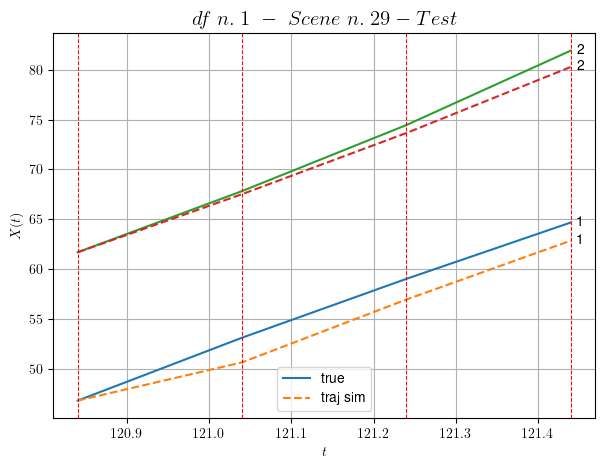

        For scene 29/36:
        * MSE = 2.1453579483360197
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.30/36


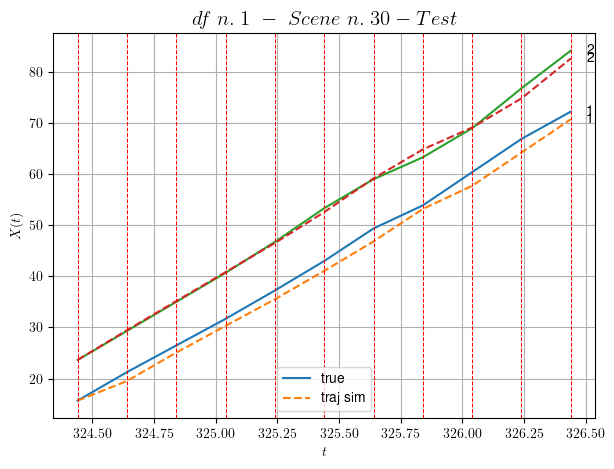

        For scene 30/36:
        * MSE = 2.109736618893707
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.31/36


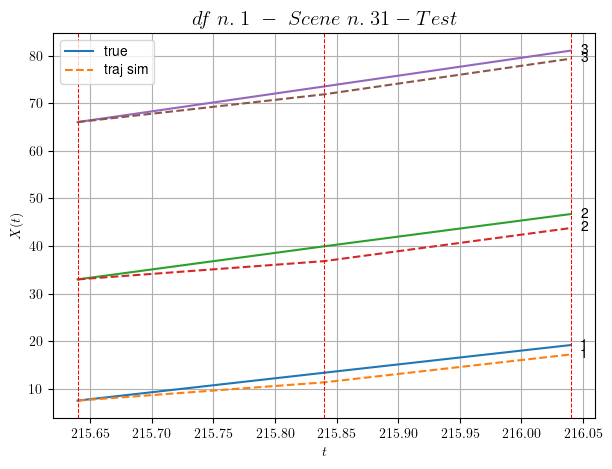

        For scene 31/36:
        * MSE = 3.544643885395866
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.32/36


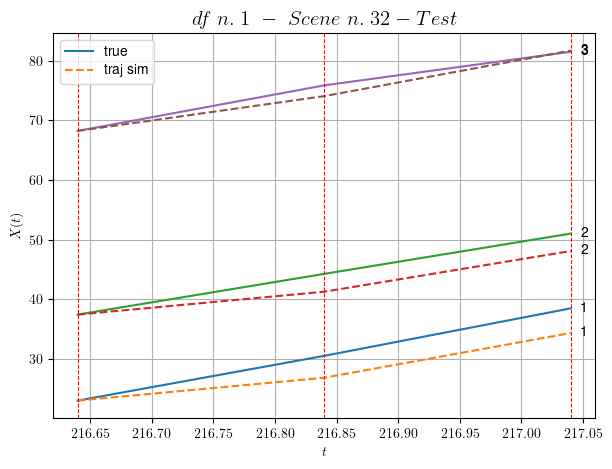

        For scene 32/36:
        * MSE = 5.703299921703736
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.33/36


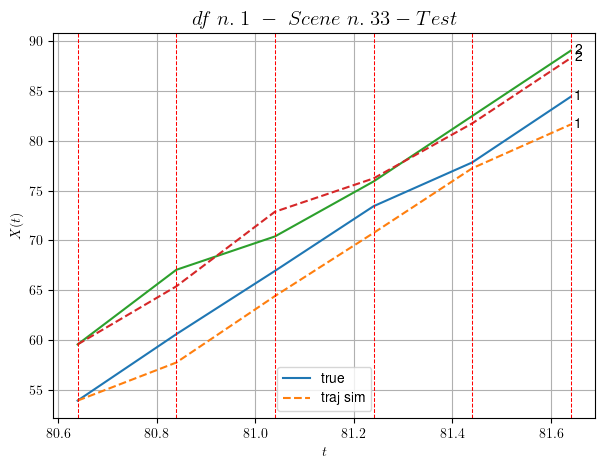

        For scene 33/36:
        * MSE = 3.3242440902734574
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.34/36


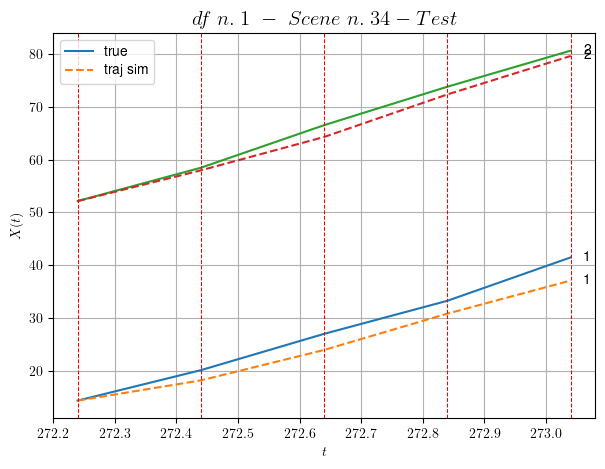

        For scene 34/36:
        * MSE = 4.666132701122794
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.35/36


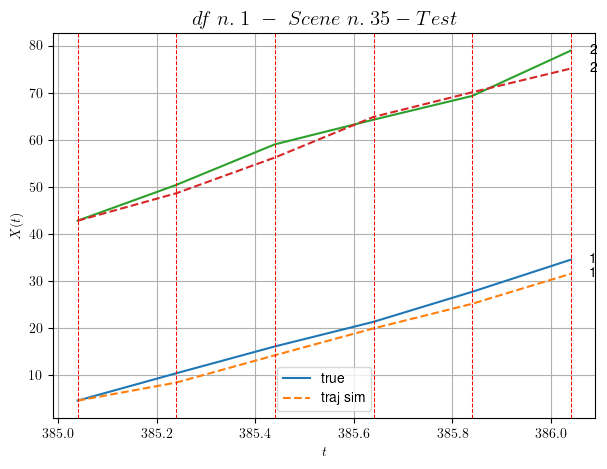

        For scene 35/36:
        * MSE = 4.276052325274172
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.36/36


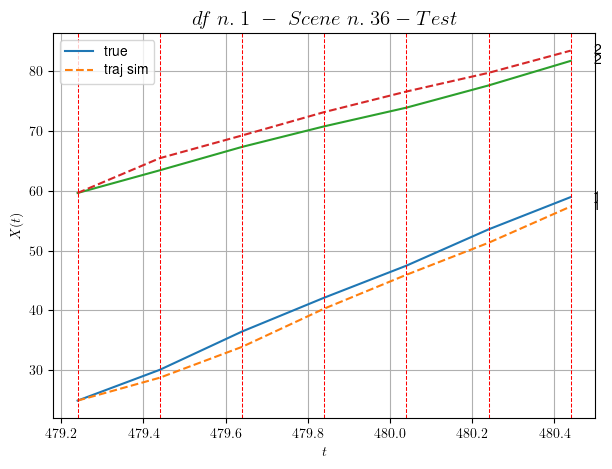

        For scene 36/36:
        * MSE = 3.5508217079934887
----------------------------------------------------------------------------------------------------


MSE test: 3.2599215693701797

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.5973406892998294
          * MSE test: 3.2599215693701797
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 2/10 dfs.
In DataFrame n.2 we have 69 scenes.
    To train the model we use 46 scenes, the remaining 23 to test the model.

Training step. (46 scenes)
DataFrame n.2. Scene n.1/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [292.96,293.56]


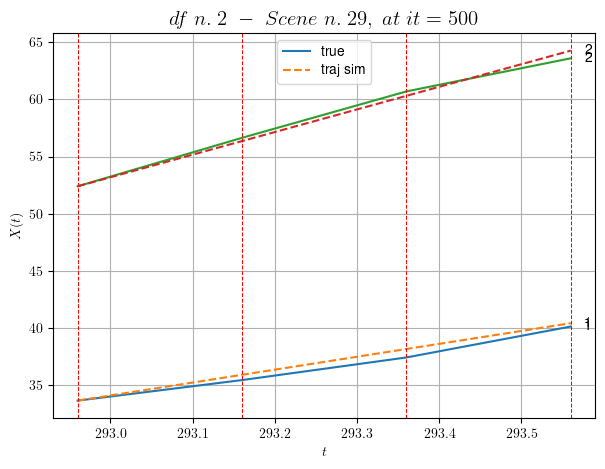

----------------------------------------------------------------------------------------------------
        For scene 1/46:
        * After LR finder: LR_NN=5e-05 with mse=7.914641049150315 at it=24
        * v0 = 19.771247175293336
        * MSE = 0.19035738960477683
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [84.96,85.96]


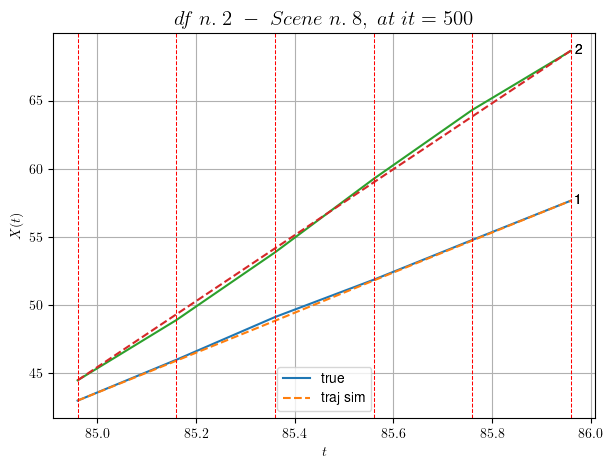

----------------------------------------------------------------------------------------------------
        For scene 2/46:
        * After LR finder: LR_NN=0.005 with mse=5.98072365657911 at it=24
        * v0 = 24.168678500842805
        * MSE = 0.051640025798301764
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [487.56,487.96]


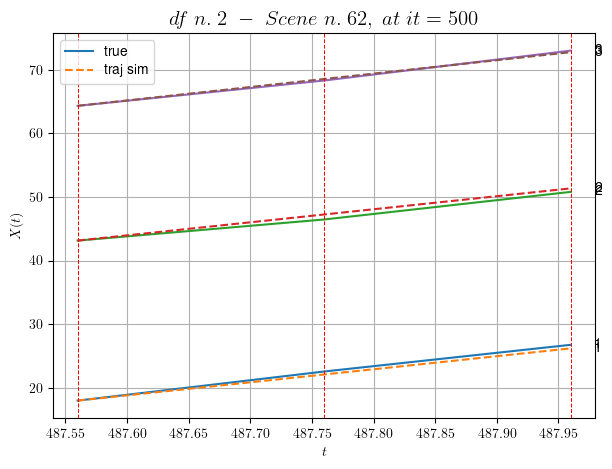

----------------------------------------------------------------------------------------------------
        For scene 3/46:
        * After LR finder: LR_NN=0.0001 with mse=1.6995740309143823 at it=24
        * v0 = 21.111900247991592
        * MSE = 0.17393877925178783
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [440.16,441.36]


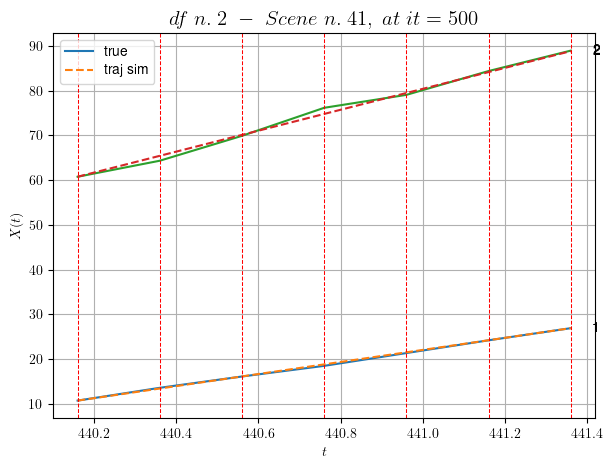

----------------------------------------------------------------------------------------------------
        For scene 4/46:
        * After LR finder: LR_NN=0.001 with mse=11.115984456925062 at it=24
        * v0 = 23.380815312671466
        * MSE = 0.24665102007828338
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [588.96,589.36]


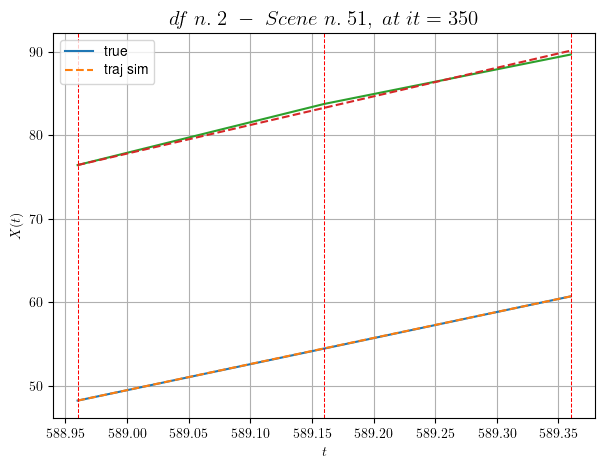

----------------------------------------------------------------------------------------------------
        For scene 5/46:
        * After LR finder: LR_NN=0.01 with mse=0.5353634562105749 at it=24
        * v0 = 34.22110961911138
        * MSE = 0.06549177005231176
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [530.96,531.36]


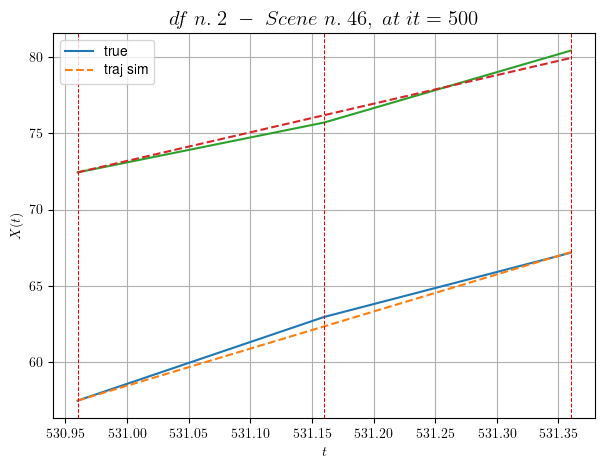

----------------------------------------------------------------------------------------------------
        For scene 6/46:
        * After LR finder: LR_NN=5e-05 with mse=3.9274208754035533 at it=24
        * v0 = 18.785408323068477
        * MSE = 0.13201565992518904
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.7/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [220.36,221.16]


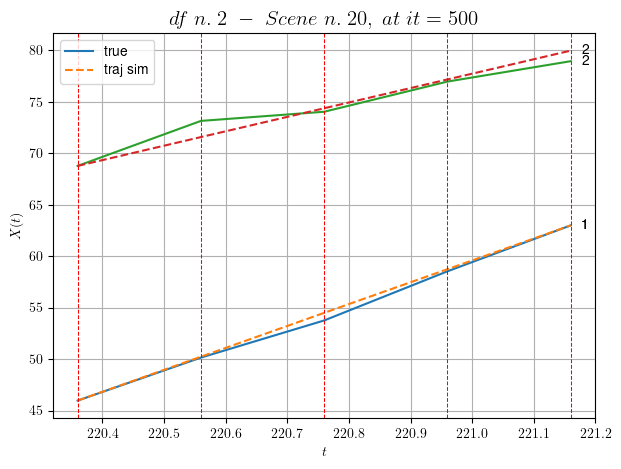

----------------------------------------------------------------------------------------------------
        For scene 7/46:
        * After LR finder: LR_NN=0.001 with mse=33.61802290837248 at it=24
        * v0 = 13.996427133410497
        * MSE = 0.4269049734017069
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.8/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [199.76,200.16]


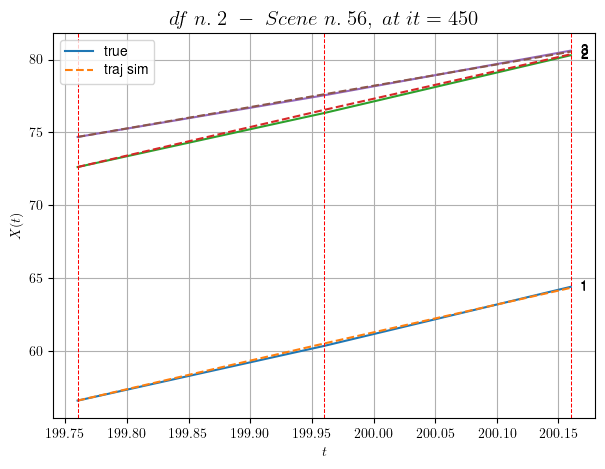

----------------------------------------------------------------------------------------------------
        For scene 8/46:
        * After LR finder: LR_NN=0.01 with mse=5.228243739338866 at it=24
        * v0 = 14.651673034686517
        * MSE = 0.010007175647926676
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.9/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [428.56,429.76]


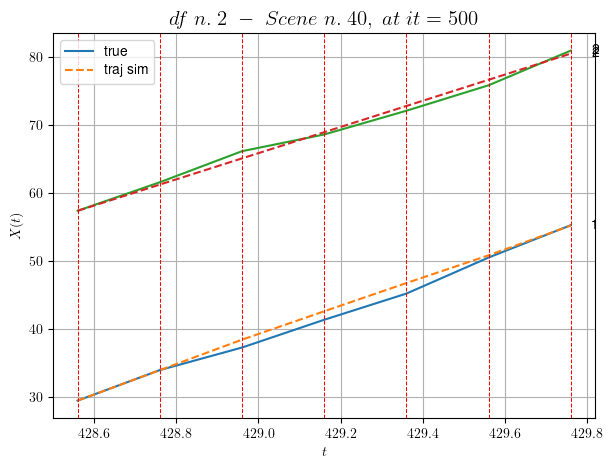

----------------------------------------------------------------------------------------------------
        For scene 9/46:
        * After LR finder: LR_NN=0.01 with mse=31.207476057257054 at it=24
        * v0 = 19.277810356523588
        * MSE = 0.5620487223490687
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.10/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [256.56,258.16]


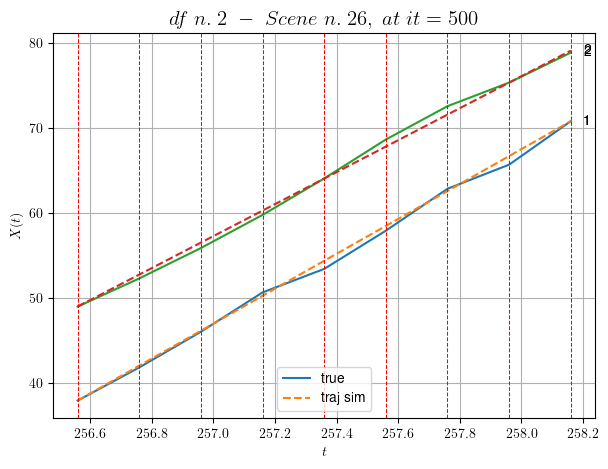

----------------------------------------------------------------------------------------------------
        For scene 10/46:
        * After LR finder: LR_NN=0.001 with mse=55.61379390563321 at it=24
        * v0 = 18.832978045461743
        * MSE = 0.2853349304787346
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.11/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [413.96,414.56]


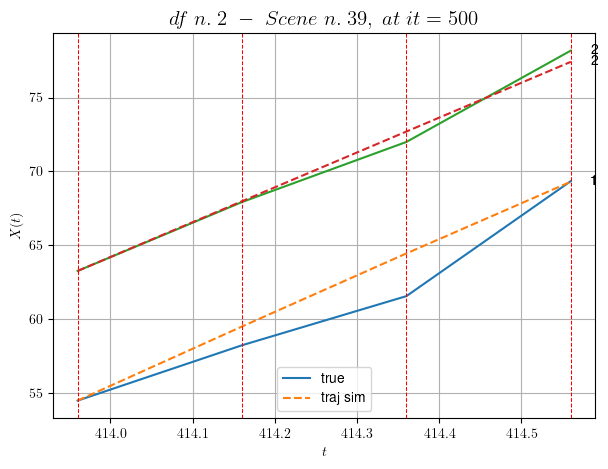

----------------------------------------------------------------------------------------------------
        For scene 11/46:
        * After LR finder: LR_NN=0.001 with mse=3.6398852528606422 at it=24
        * v0 = 23.61552454291712
        * MSE = 1.3705373078495027
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.12/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [183.96,184.56]


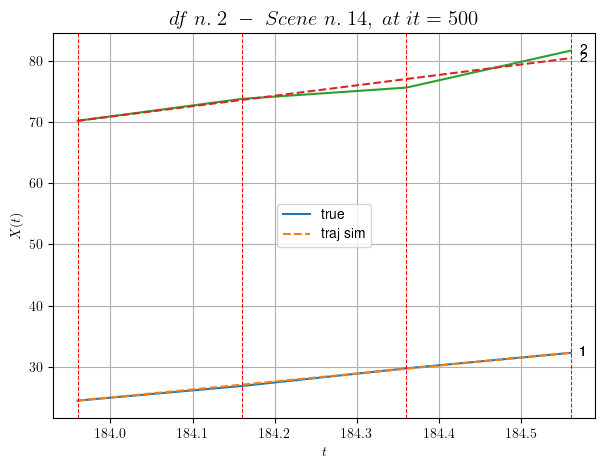

----------------------------------------------------------------------------------------------------
        For scene 12/46:
        * After LR finder: LR_NN=0.0001 with mse=11.493288868383889 at it=24
        * v0 = 17.05181090872116
        * MSE = 0.4441721035658729
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.13/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [576.56,576.96]


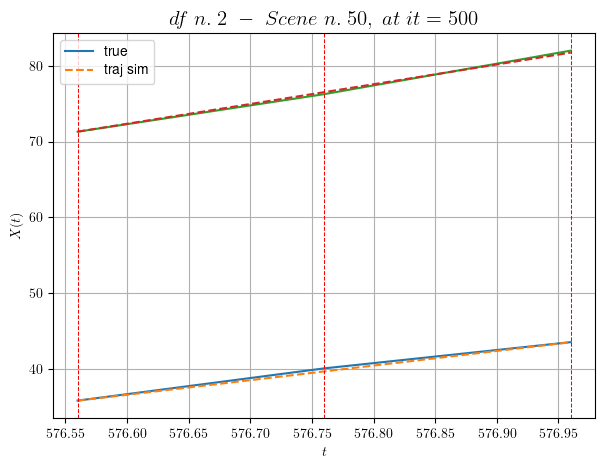

----------------------------------------------------------------------------------------------------
        For scene 13/46:
        * After LR finder: LR_NN=0.0001 with mse=0.5280520974627677 at it=24
        * v0 = 26.069569095123438
        * MSE = 0.04975926870519787
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.14/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [54.56,55.36]


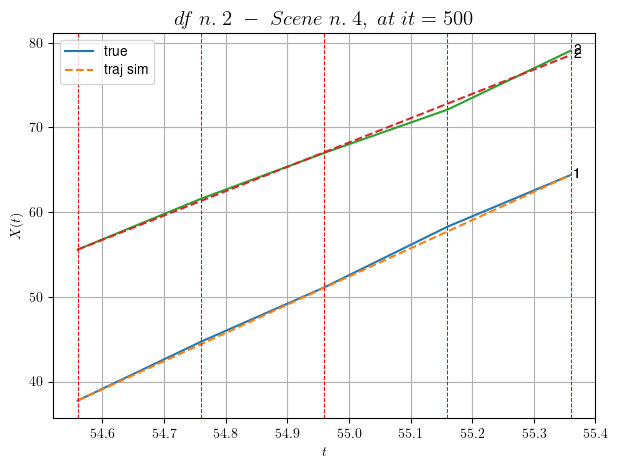

----------------------------------------------------------------------------------------------------
        For scene 14/46:
        * After LR finder: LR_NN=0.0005 with mse=0.33232085934738115 at it=24
        * v0 = 28.716321309649757
        * MSE = 0.12394450689518613
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.15/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [215.36,215.96]


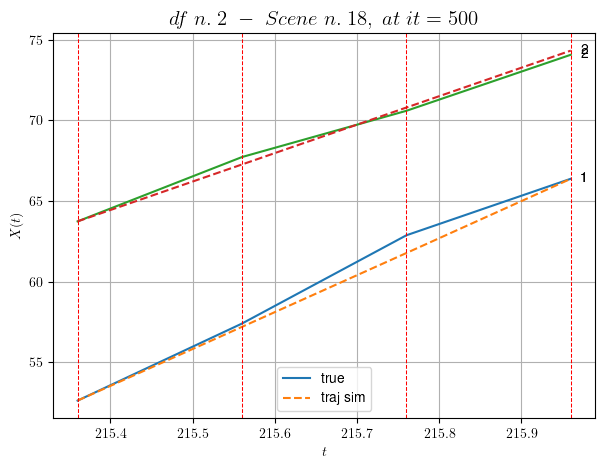

----------------------------------------------------------------------------------------------------
        For scene 15/46:
        * After LR finder: LR_NN=0.0005 with mse=11.296635396509453 at it=24
        * v0 = 17.643232536852175
        * MSE = 0.19568658129886296
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.16/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [96.36,96.76]


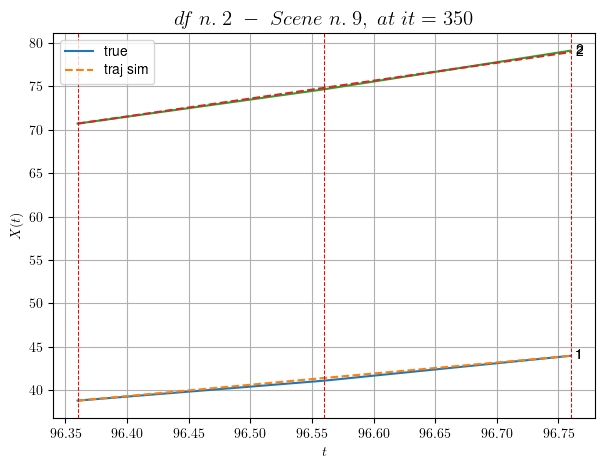

----------------------------------------------------------------------------------------------------
        For scene 16/46:
        * After LR finder: LR_NN=0.005 with mse=2.8676695866603725 at it=24
        * v0 = 20.598848373580587
        * MSE = 0.025331159529416197
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.17/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [179.36,180.16]


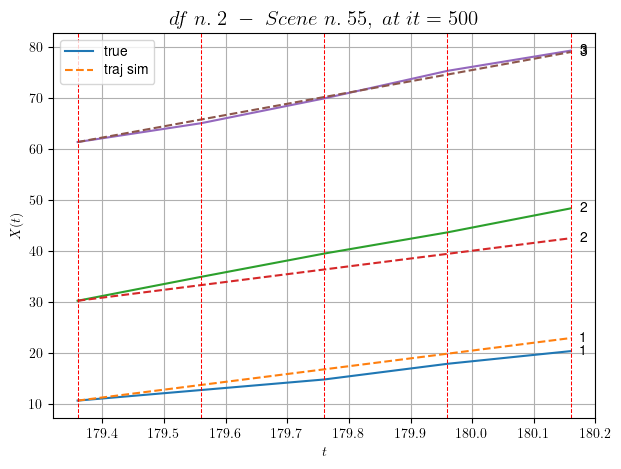

----------------------------------------------------------------------------------------------------
        For scene 17/46:
        * After LR finder: LR_NN=1e-05 with mse=6.177206331893082 at it=24
        * v0 = 22.08199952987897
        * MSE = 5.404336371288923
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.18/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [77.56,78.76]


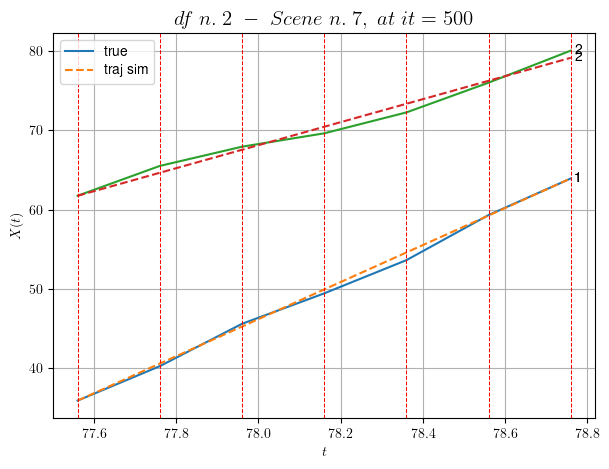

----------------------------------------------------------------------------------------------------
        For scene 18/46:
        * After LR finder: LR_NN=0.0005 with mse=63.01104015856339 at it=24
        * v0 = 14.529876108312846
        * MSE = 0.3622531245907138
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.19/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [399.56,400.56]


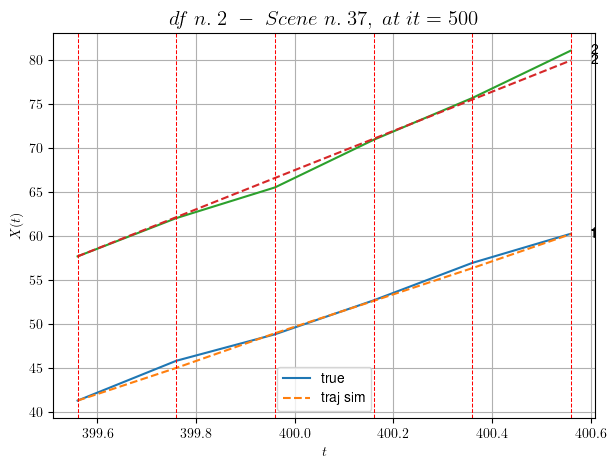

----------------------------------------------------------------------------------------------------
        For scene 19/46:
        * After LR finder: LR_NN=0.01 with mse=10.342247593081433 at it=24
        * v0 = 22.285901484028813
        * MSE = 0.2887134312720613
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.20/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [538.36,539.16]


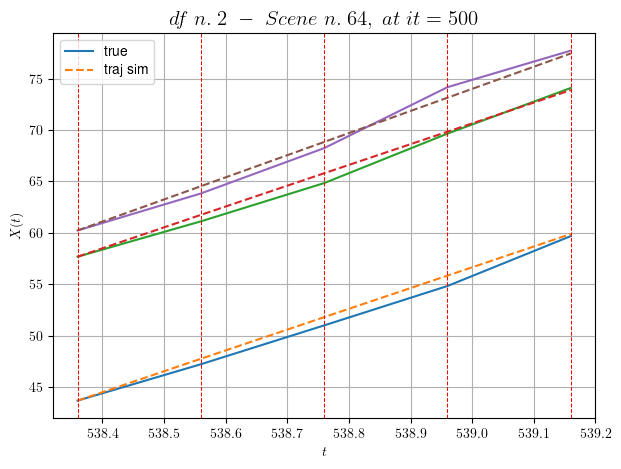

----------------------------------------------------------------------------------------------------
        For scene 20/46:
        * After LR finder: LR_NN=0.001 with mse=5.744472264853029 at it=24
        * v0 = 21.518869344522685
        * MSE = 0.3515162758094261
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.21/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [87.56,88.16]


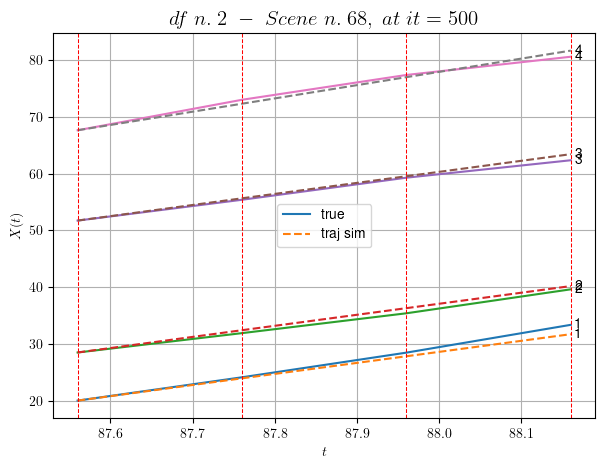

----------------------------------------------------------------------------------------------------
        For scene 21/46:
        * After LR finder: LR_NN=0.005 with mse=2.3058332590153716 at it=24
        * v0 = 23.39910333176455
        * MSE = 0.47814906040225874
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.22/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [208.96,209.36]


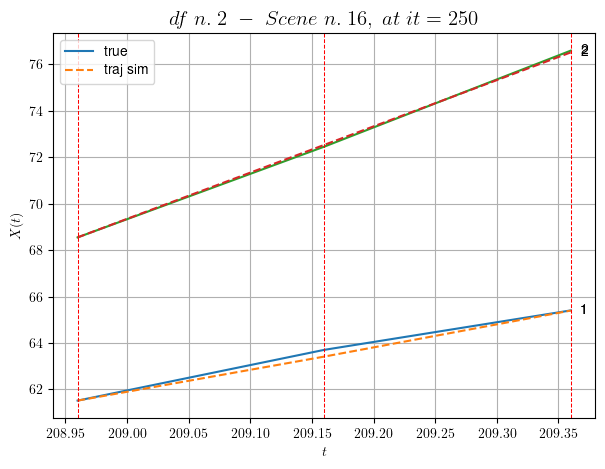

----------------------------------------------------------------------------------------------------
        For scene 22/46:
        * After LR finder: LR_NN=0.01 with mse=3.3734833821194035 at it=24
        * v0 = 19.925338217022304
        * MSE = 0.015609669169777721
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.23/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [287.36,287.96]


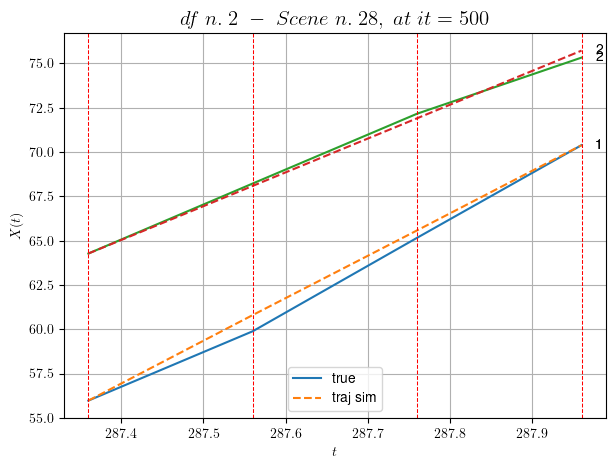

----------------------------------------------------------------------------------------------------
        For scene 23/46:
        * After LR finder: LR_NN=0.001 with mse=8.956635543416134 at it=24
        * v0 = 19.081744094340547
        * MSE = 0.1550192042598818
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.24/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [442.36,443.76]


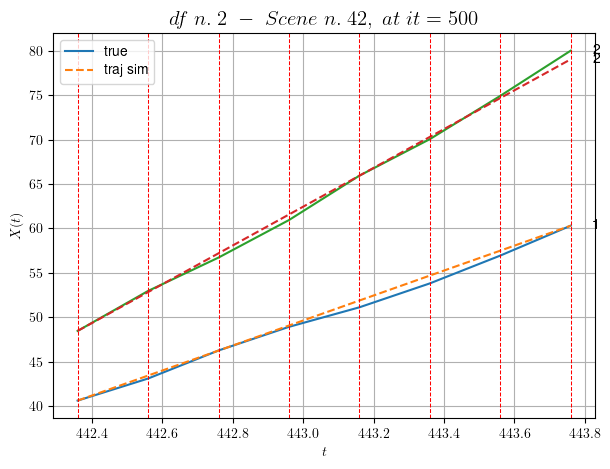

----------------------------------------------------------------------------------------------------
        For scene 24/46:
        * After LR finder: LR_NN=0.001 with mse=22.557562885839317 at it=24
        * v0 = 21.85795817065097
        * MSE = 0.21445369165009004
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.25/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [275.56,275.96]


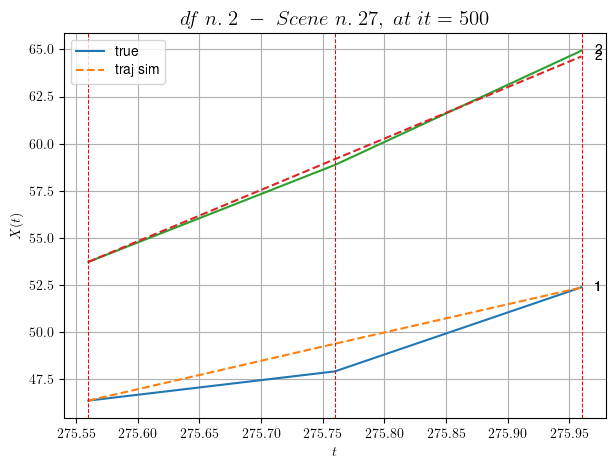

----------------------------------------------------------------------------------------------------
        For scene 25/46:
        * After LR finder: LR_NN=0.0005 with mse=0.6459166029127899 at it=24
        * v0 = 27.245148829197323
        * MSE = 0.37256211047528076
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.26/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [557.96,559.16]


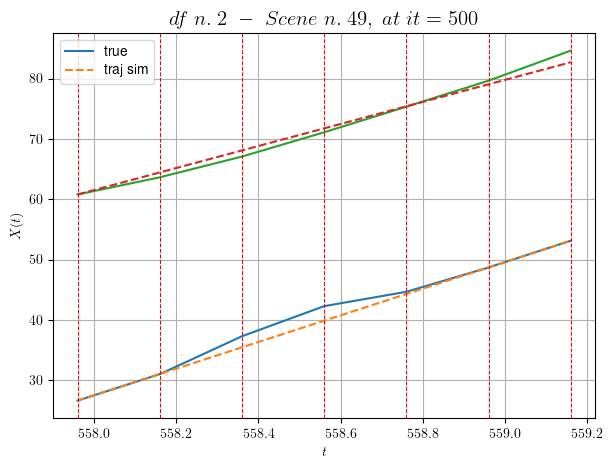

----------------------------------------------------------------------------------------------------
        For scene 26/46:
        * After LR finder: LR_NN=5e-05 with mse=33.512976537241805 at it=24
        * v0 = 18.26598960498433
        * MSE = 1.1084288300421778
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.27/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [253.96,254.56]


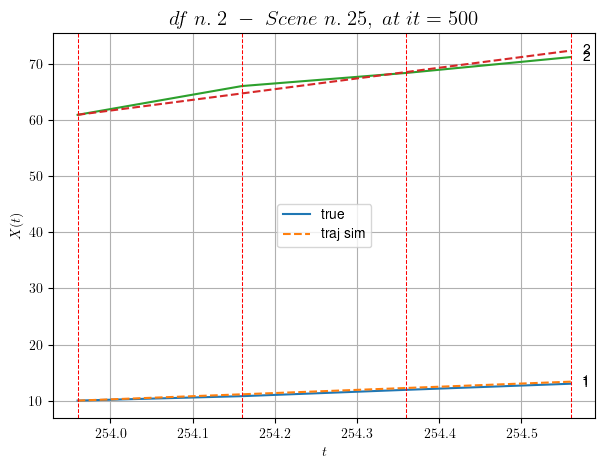

----------------------------------------------------------------------------------------------------
        For scene 27/46:
        * After LR finder: LR_NN=0.0001 with mse=10.115296071640074 at it=24
        * v0 = 19.059884309201923
        * MSE = 0.429066695290924
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.28/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [430.16,430.96]


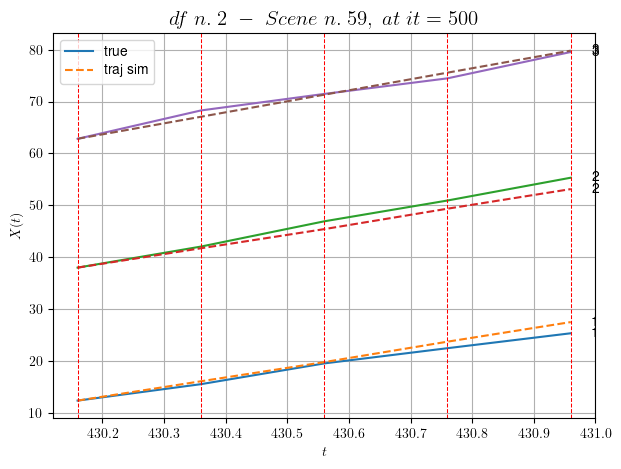

----------------------------------------------------------------------------------------------------
        For scene 28/46:
        * After LR finder: LR_NN=0.01 with mse=8.105163410548053 at it=24
        * v0 = 21.236902740723206
        * MSE = 1.2693629983848482
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.29/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [531.76,532.76]


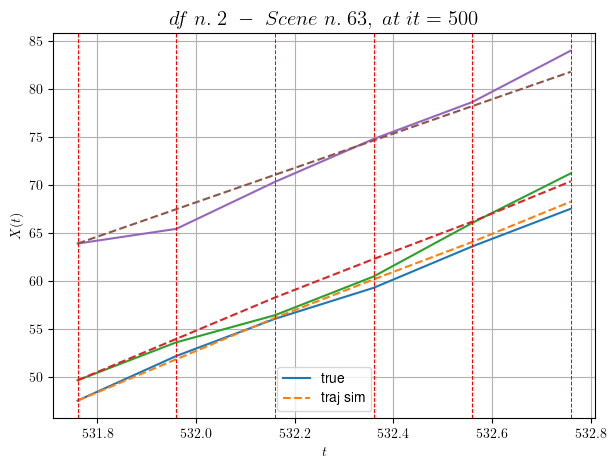

----------------------------------------------------------------------------------------------------
        For scene 29/46:
        * After LR finder: LR_NN=0.01 with mse=16.272178407781844 at it=24
        * v0 = 17.911731328080002
        * MSE = 0.9998790475814849
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.30/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [145.16,145.56]


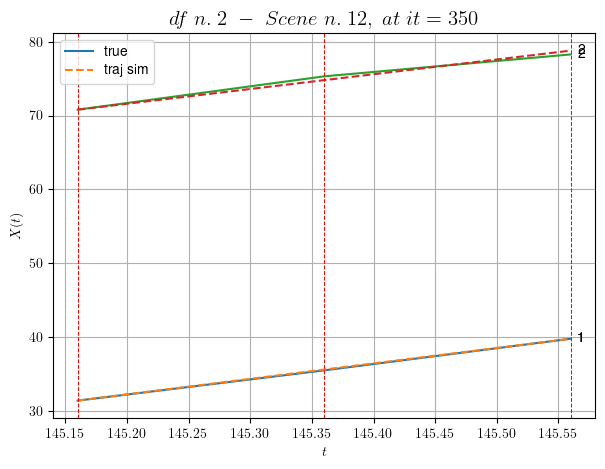

----------------------------------------------------------------------------------------------------
        For scene 30/46:
        * After LR finder: LR_NN=0.005 with mse=3.770652431700862 at it=24
        * v0 = 20.018762484246366
        * MSE = 0.0911261457398153
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.31/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [358.16,358.76]


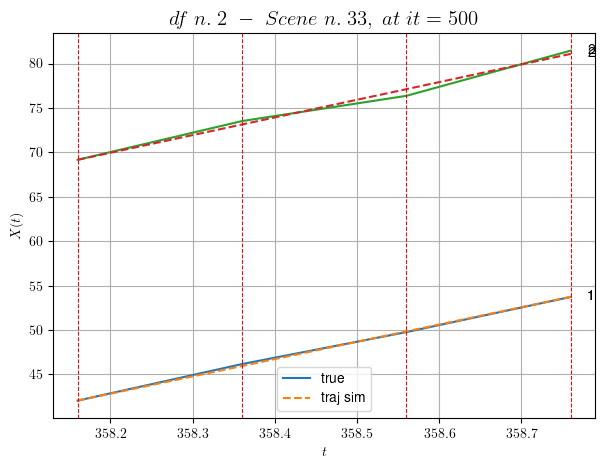

----------------------------------------------------------------------------------------------------
        For scene 31/46:
        * After LR finder: LR_NN=5e-05 with mse=7.297688627782894 at it=24
        * v0 = 19.87709782061694
        * MSE = 0.1121260880084357
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.32/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [549.76,550.16]


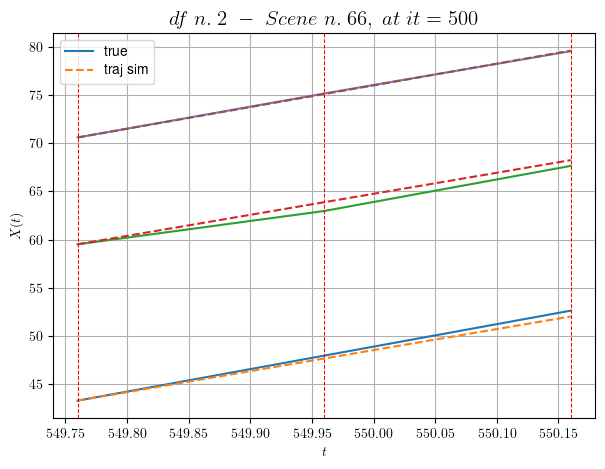

----------------------------------------------------------------------------------------------------
        For scene 32/46:
        * After LR finder: LR_NN=0.0001 with mse=1.4111212076059712 at it=24
        * v0 = 22.49571952540916
        * MSE = 0.17904968778029598
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.33/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [566.76,567.16]


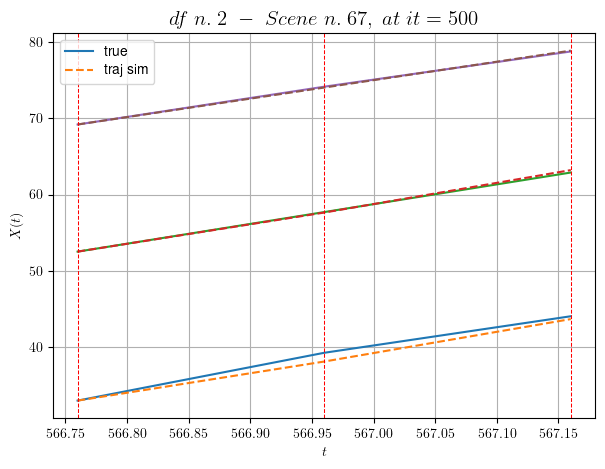

----------------------------------------------------------------------------------------------------
        For scene 33/46:
        * After LR finder: LR_NN=0.01 with mse=1.0146235435690012 at it=24
        * v0 = 24.222520391150397
        * MSE = 0.17462264864800423
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.34/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [411.36,412.16]


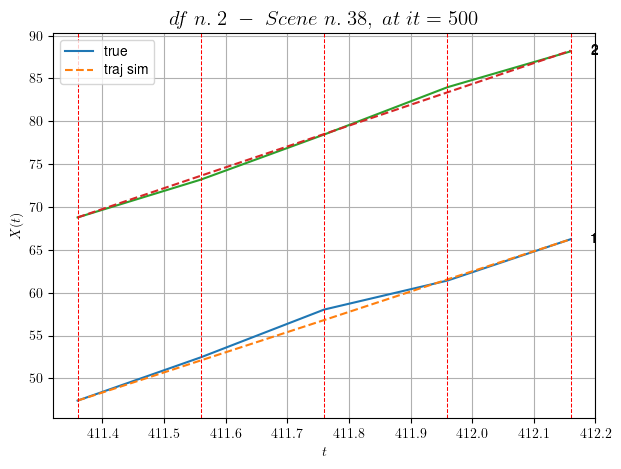

----------------------------------------------------------------------------------------------------
        For scene 34/46:
        * After LR finder: LR_NN=0.001 with mse=3.919861860515974 at it=24
        * v0 = 24.33774318153071
        * MSE = 0.22112496394909797
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.35/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [314.96,315.36]


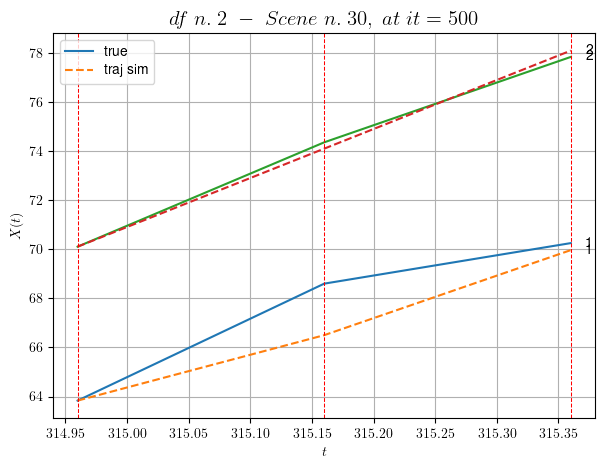

----------------------------------------------------------------------------------------------------
        For scene 35/46:
        * After LR finder: LR_NN=0.01 with mse=4.567159489110486 at it=24
        * v0 = 19.975403002157083
        * MSE = 0.7626290833543404
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.36/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [494.76,495.36]


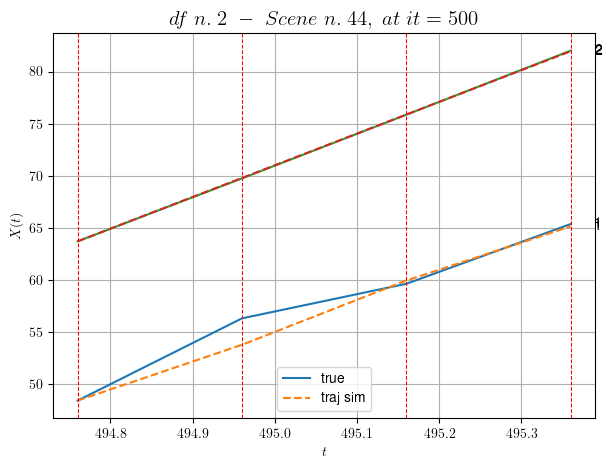

----------------------------------------------------------------------------------------------------
        For scene 36/46:
        * After LR finder: LR_NN=0.005 with mse=1.0361211889654043 at it=24
        * v0 = 30.442979864262888
        * MSE = 0.8087999361082859
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.37/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [541.16,542.36]


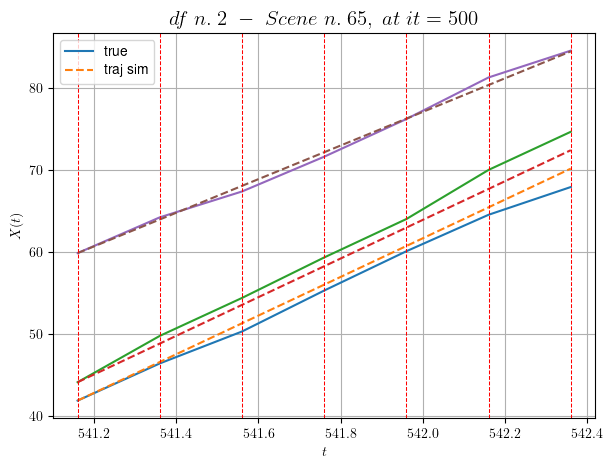

----------------------------------------------------------------------------------------------------
        For scene 37/46:
        * After LR finder: LR_NN=0.0005 with mse=16.75733587866455 at it=24
        * v0 = 20.48999097546761
        * MSE = 1.1319800545606549
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.38/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [14.76,15.36]


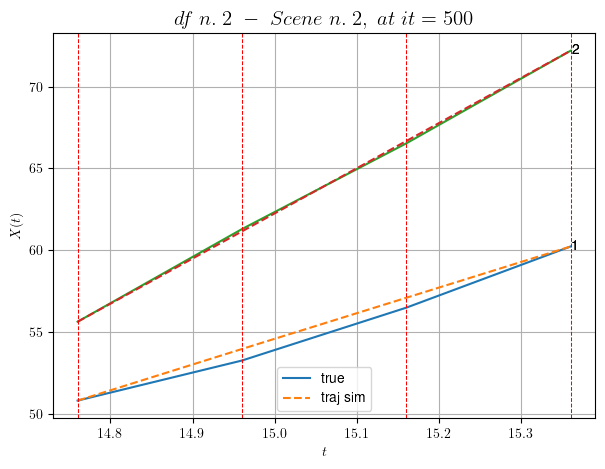

----------------------------------------------------------------------------------------------------
        For scene 38/46:
        * After LR finder: LR_NN=0.001 with mse=0.45430030416944156 at it=24
        * v0 = 27.615406088656982
        * MSE = 0.11245030967598664
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.39/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [109.36,110.16]


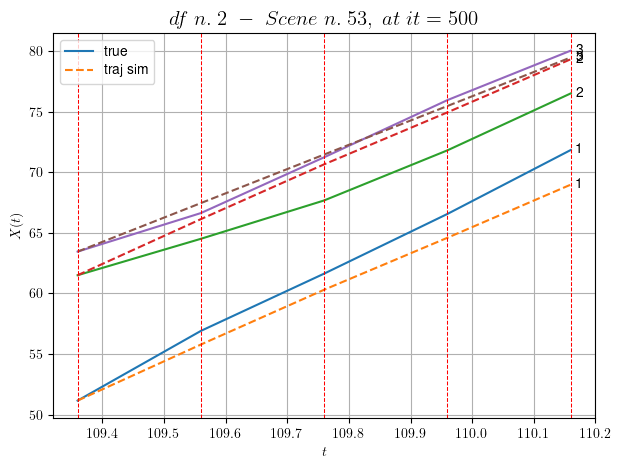

----------------------------------------------------------------------------------------------------
        For scene 39/46:
        * After LR finder: LR_NN=0.01 with mse=9.91064308210464 at it=24
        * v0 = 20.033858704331596
        * MSE = 3.0435414575555733
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.40/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [233.36,235.36]


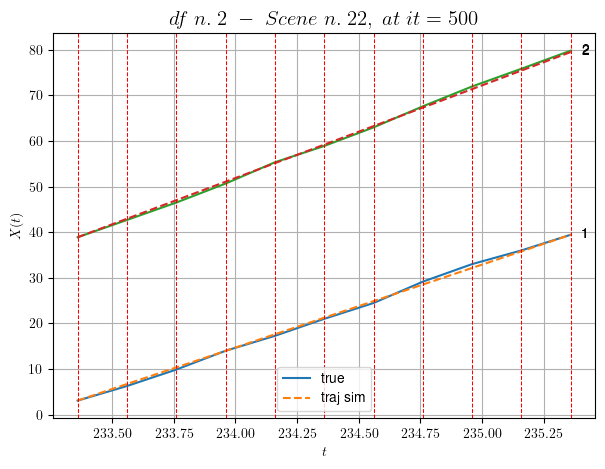

----------------------------------------------------------------------------------------------------
        For scene 40/46:
        * After LR finder: LR_NN=0.001 with mse=64.55685467796859 at it=24
        * v0 = 20.300783427084237
        * MSE = 0.1455731437923633
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.41/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [52.76,53.56]


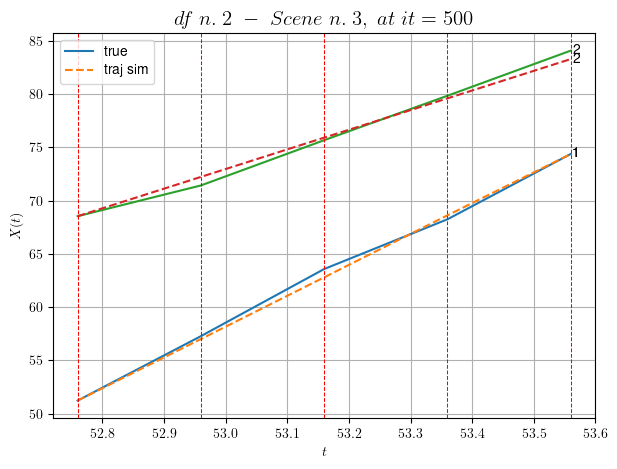

----------------------------------------------------------------------------------------------------
        For scene 41/46:
        * After LR finder: LR_NN=0.001 with mse=15.063820924555566 at it=24
        * v0 = 18.434937295304408
        * MSE = 0.20125435754473392
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.42/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [250.16,250.96]


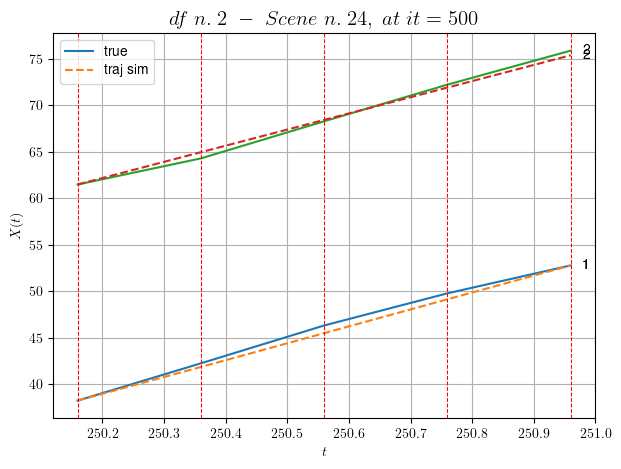

----------------------------------------------------------------------------------------------------
        For scene 42/46:
        * After LR finder: LR_NN=0.001 with mse=18.385828399936813 at it=24
        * v0 = 17.364515373913353
        * MSE = 0.19744940289968396
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.43/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [223.16,223.56]


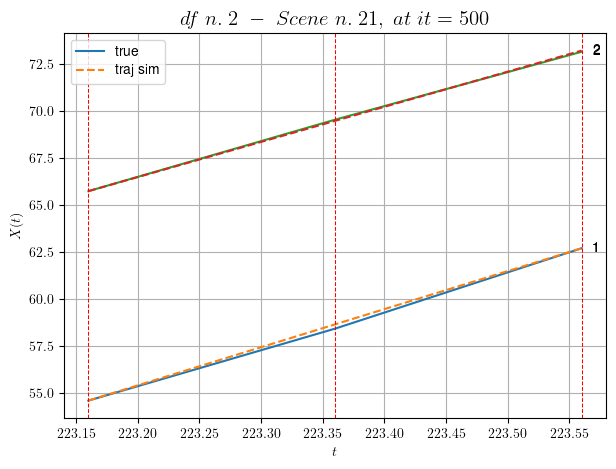

----------------------------------------------------------------------------------------------------
        For scene 43/46:
        * After LR finder: LR_NN=0.0005 with mse=4.353337368716844 at it=24
        * v0 = 18.698370205342545
        * MSE = 0.009955764133390093
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.44/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [442.76,443.76]


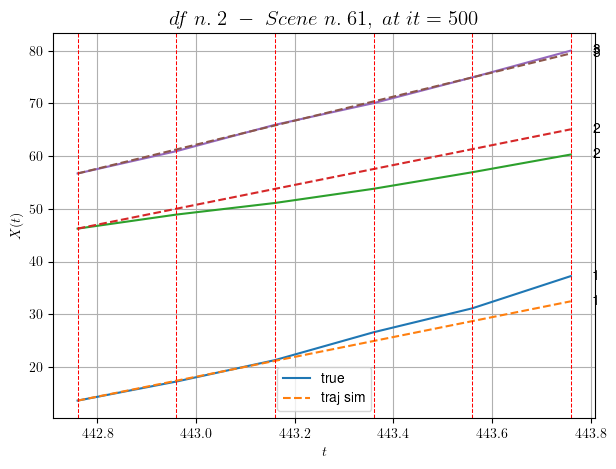

----------------------------------------------------------------------------------------------------
        For scene 44/46:
        * After LR finder: LR_NN=0.0001 with mse=7.86195883042235 at it=24
        * v0 = 22.77589680250468
        * MSE = 5.367534152430678
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.45/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [198.16,200.16]


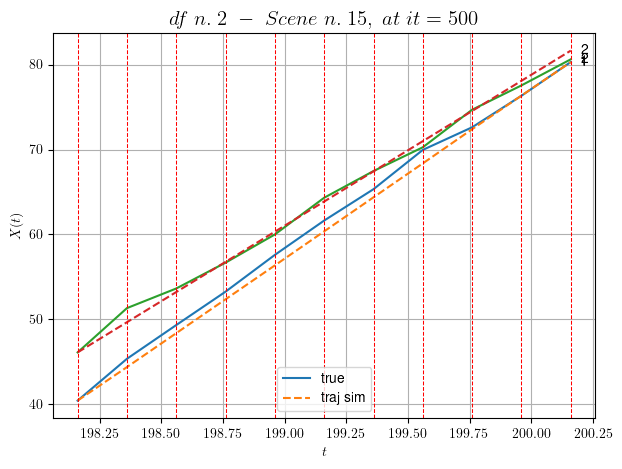

----------------------------------------------------------------------------------------------------
        For scene 45/46:
        * After LR finder: LR_NN=0.005 with mse=108.70990914295487 at it=24
        * v0 = 17.75627925151292
        * MSE = 0.6199665015801247
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.46/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.16,86.96]


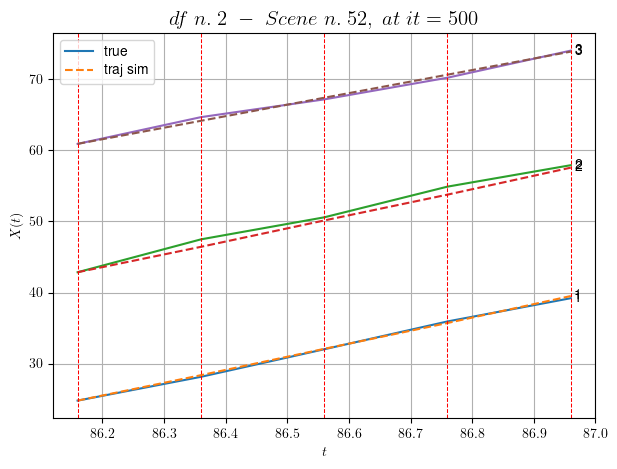

----------------------------------------------------------------------------------------------------
        For scene 46/46:
        * After LR finder: LR_NN=0.01 with mse=15.771071528959546 at it=24
        * v0 = 16.23533006014572
        * MSE = 0.22613856523143394
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.6349672640791928
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (23 scenes)
DataFrame n.2. Scene n.1/23


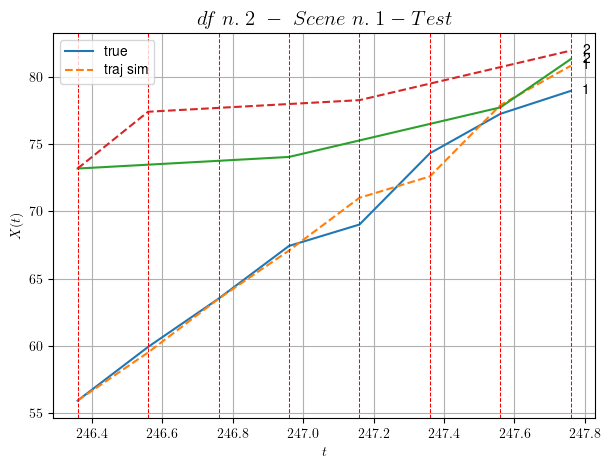

        For scene 1/23:
        * MSE = 5.307575358189445
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/23


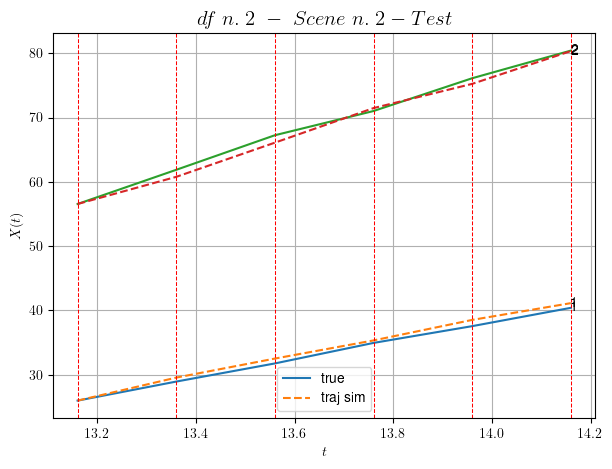

        For scene 2/23:
        * MSE = 0.5069495771906785
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/23


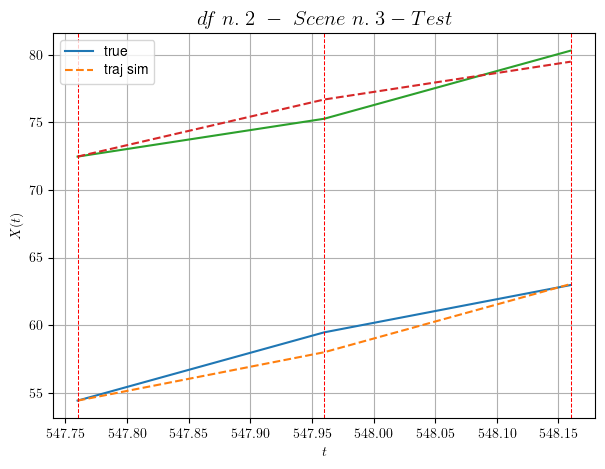

        For scene 3/23:
        * MSE = 0.8110153963939885
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/23


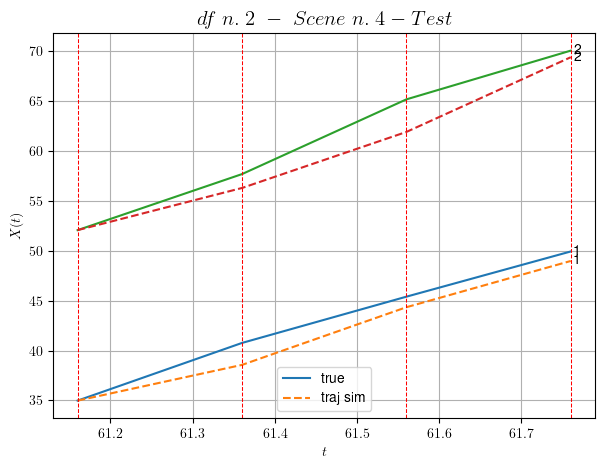

        For scene 4/23:
        * MSE = 2.48516891390148
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/23


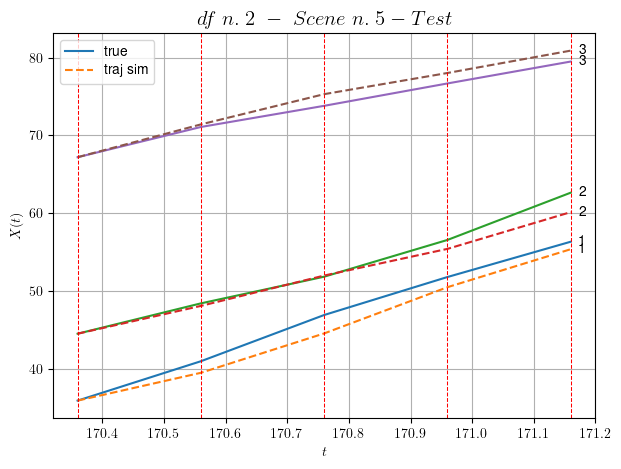

        For scene 5/23:
        * MSE = 1.6225258775744489
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/23


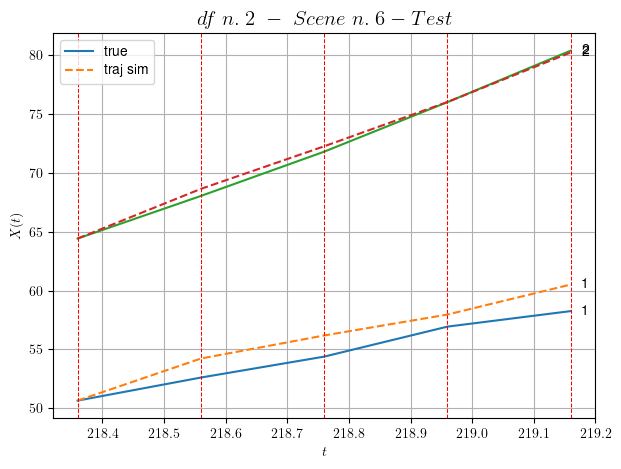

        For scene 6/23:
        * MSE = 1.2604623637970451
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.7/23


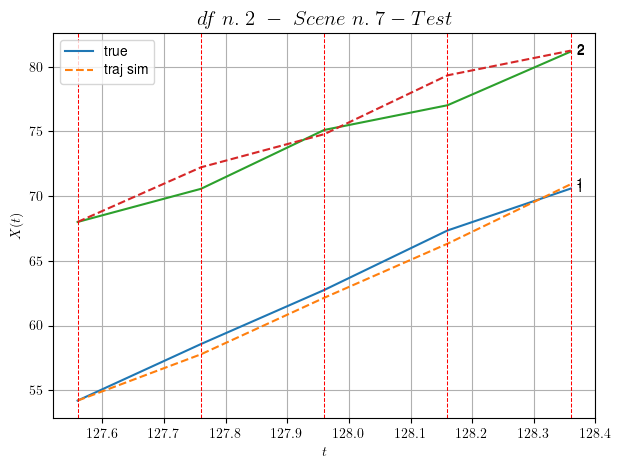

        For scene 7/23:
        * MSE = 1.0377417205063861
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.8/23


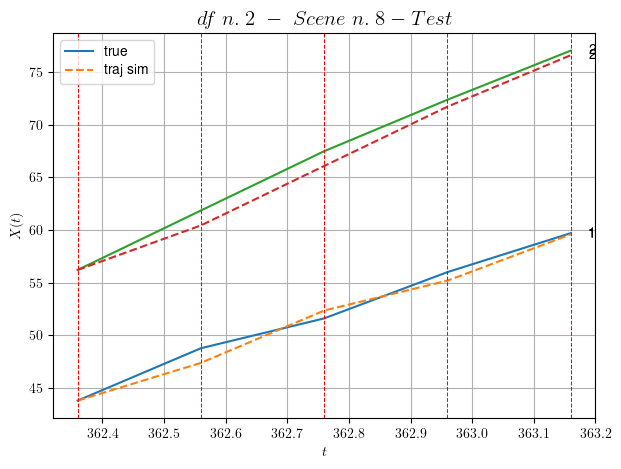

        For scene 8/23:
        * MSE = 0.7760665474253572
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.9/23


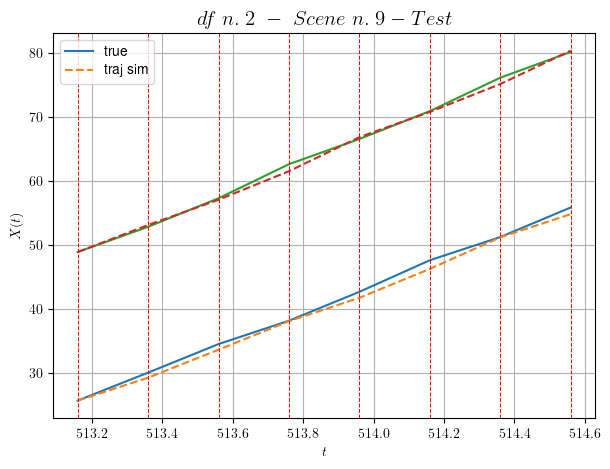

        For scene 9/23:
        * MSE = 0.47810839870706723
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.10/23


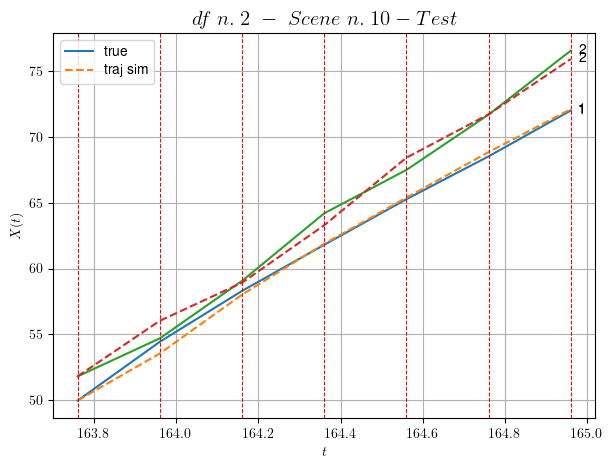

        For scene 10/23:
        * MSE = 0.3495043628846606
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.11/23


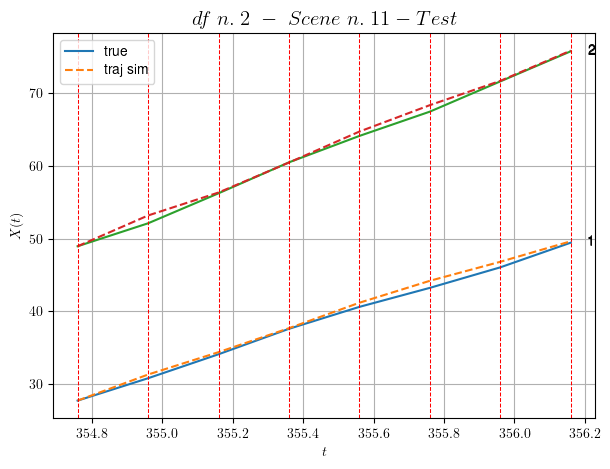

        For scene 11/23:
        * MSE = 0.28455232168521843
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.12/23


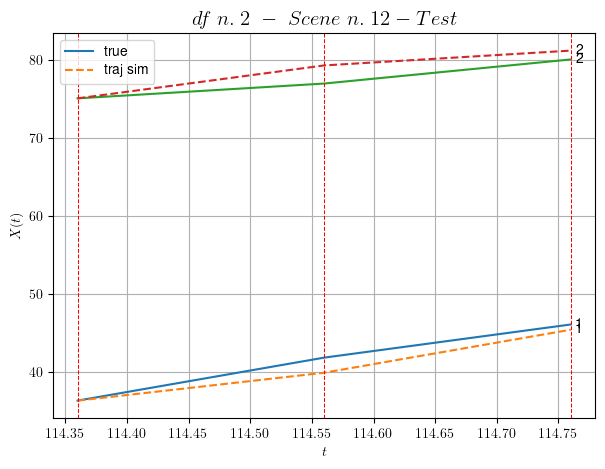

        For scene 12/23:
        * MSE = 1.812098566317352
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.13/23


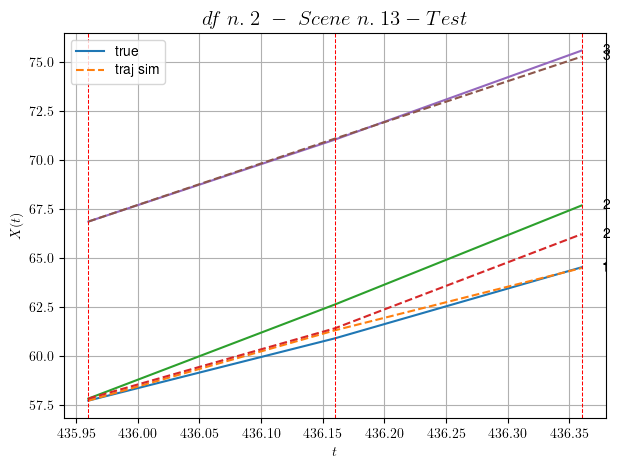

        For scene 13/23:
        * MSE = 0.4295395535976511
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.14/23


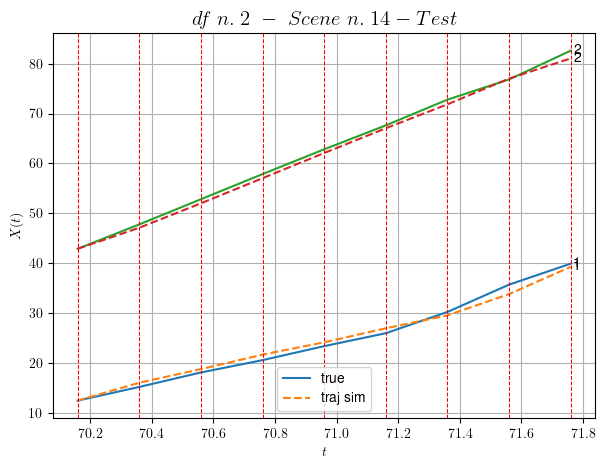

        For scene 14/23:
        * MSE = 0.8006327750084345
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.15/23


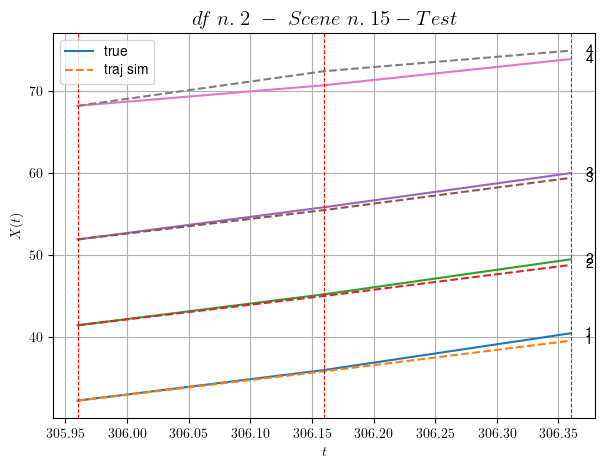

        For scene 15/23:
        * MSE = 0.48476418380908426
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.16/23


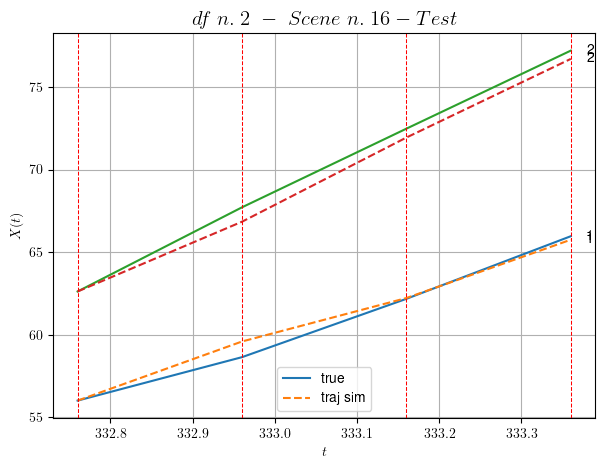

        For scene 16/23:
        * MSE = 0.2805942051040039
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.17/23


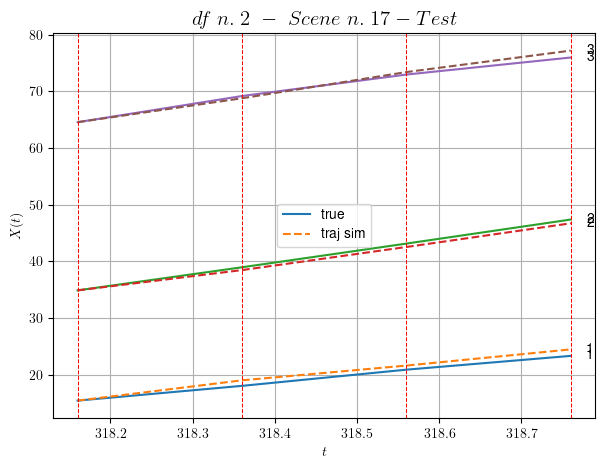

        For scene 17/23:
        * MSE = 0.4714007880817443
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.18/23


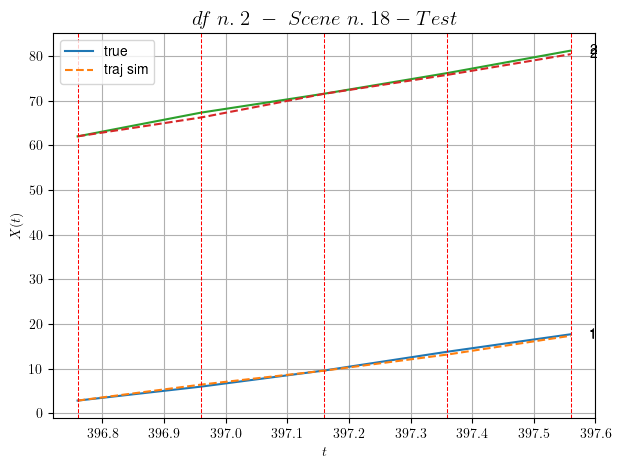

        For scene 18/23:
        * MSE = 0.26909727236727526
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.19/23


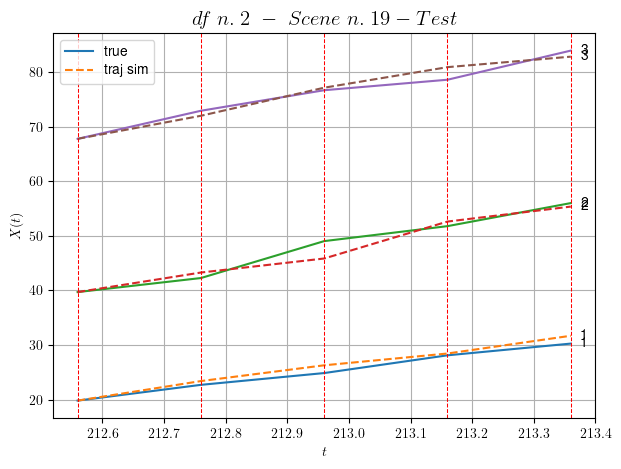

        For scene 19/23:
        * MSE = 1.6332516559864947
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.20/23


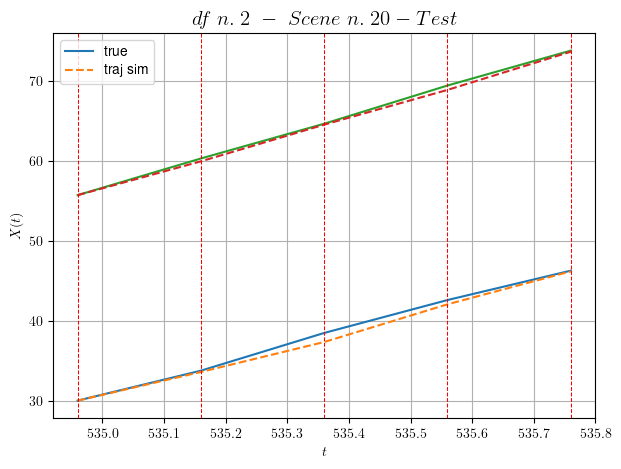

        For scene 20/23:
        * MSE = 0.2058085961385526
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.21/23


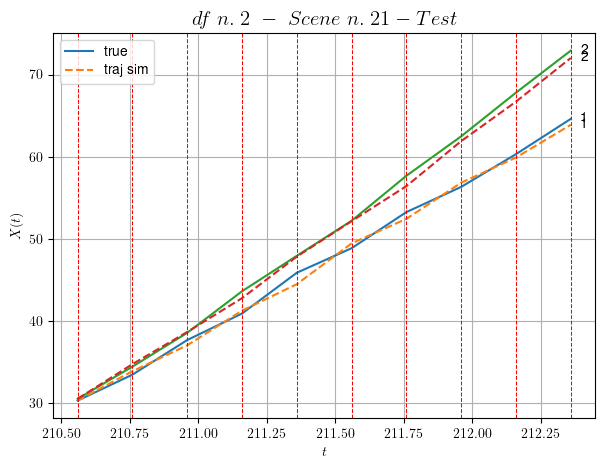

        For scene 21/23:
        * MSE = 0.46799286634064713
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.22/23


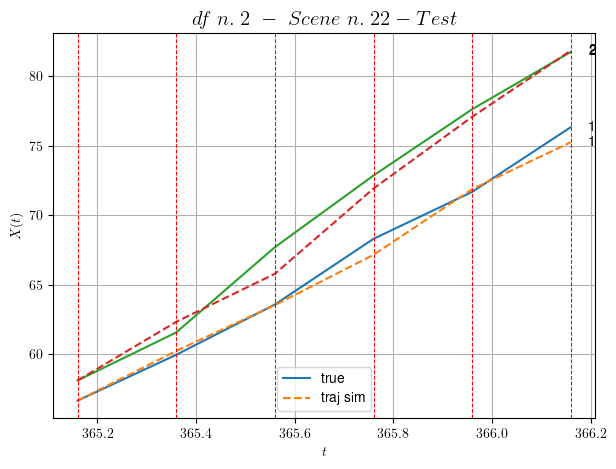

        For scene 22/23:
        * MSE = 0.6717102890312927
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.23/23


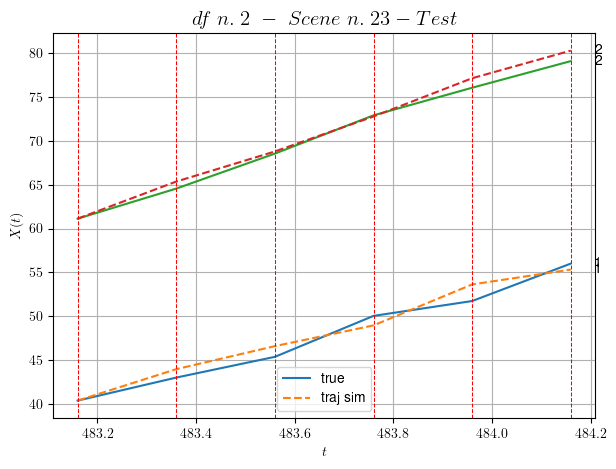

        For scene 23/23:
        * MSE = 0.9096509595366282
----------------------------------------------------------------------------------------------------


MSE test: 1.0154875021554322

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.6349672640791928
          * MSE test: 1.0154875021554322
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 3/10 dfs.
In DataFrame n.3 we have 90 scenes.
    To train the model we use 60 scenes, the remaining 30 to test the model.

Training step. (60 scenes)
DataFrame n.3. Scene n.1/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [215.56,216.36]


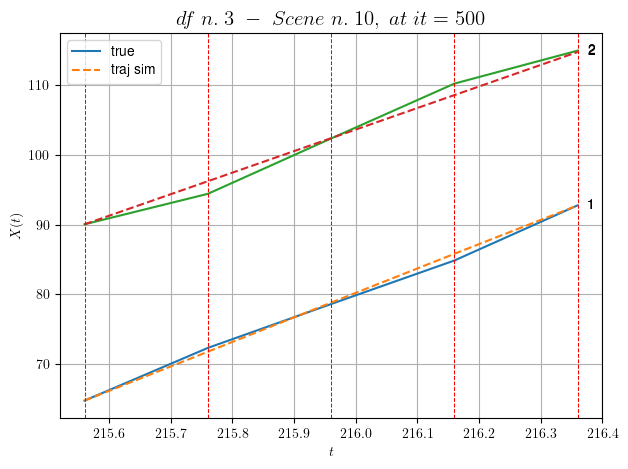

----------------------------------------------------------------------------------------------------
        For scene 1/60:
        * After LR finder: LR_NN=0.001 with mse=0.9494740893341339 at it=24
        * v0 = 30.8428972649706
        * MSE = 0.7245613350073228
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [487.16,487.56]


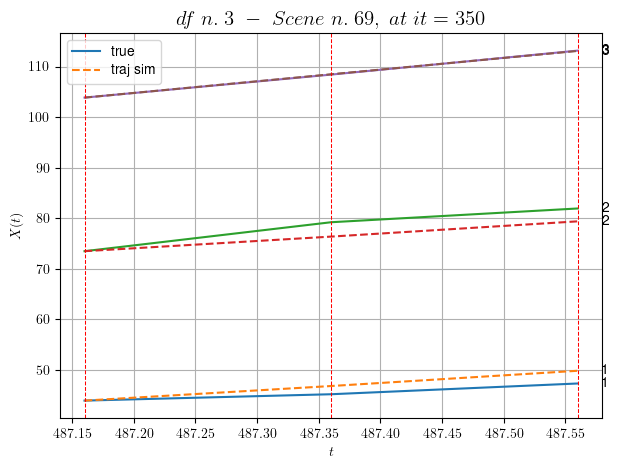

----------------------------------------------------------------------------------------------------
        For scene 2/60:
        * After LR finder: LR_NN=0.005 with mse=3.763012065454134 at it=24
        * v0 = 23.071881683468785
        * MSE = 2.612222738427658
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/60
----------------------------------------------------------------------------------------------------
We have 17 time intervals inside [138.16,141.56]


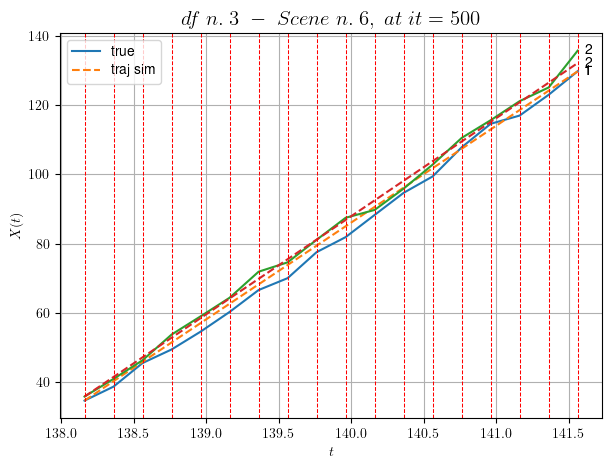

----------------------------------------------------------------------------------------------------
        For scene 3/60:
        * After LR finder: LR_NN=0.001 with mse=7.7566017254289985 at it=24
        * v0 = 28.318639127967607
        * MSE = 2.7495620522336286
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [72.76,74.16]


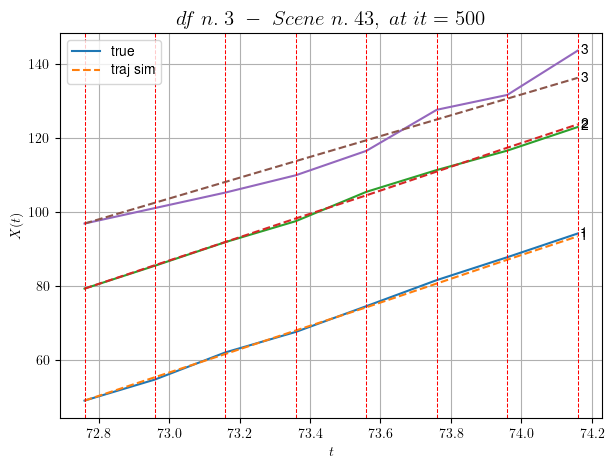

----------------------------------------------------------------------------------------------------
        For scene 4/60:
        * After LR finder: LR_NN=0.005 with mse=3.8210241818020023 at it=24
        * v0 = 28.121240263140137
        * MSE = 3.7602864600765393
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [143.76,144.36]


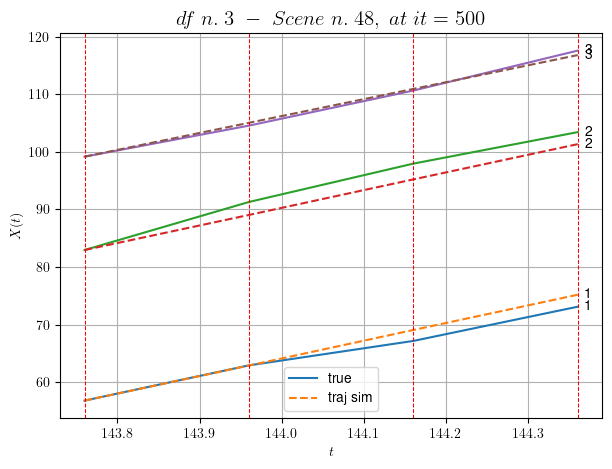

----------------------------------------------------------------------------------------------------
        For scene 5/60:
        * After LR finder: LR_NN=0.001 with mse=2.2452444023477223 at it=24
        * v0 = 29.414744463247054
        * MSE = 2.0962420109700477
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [338.36,338.96]


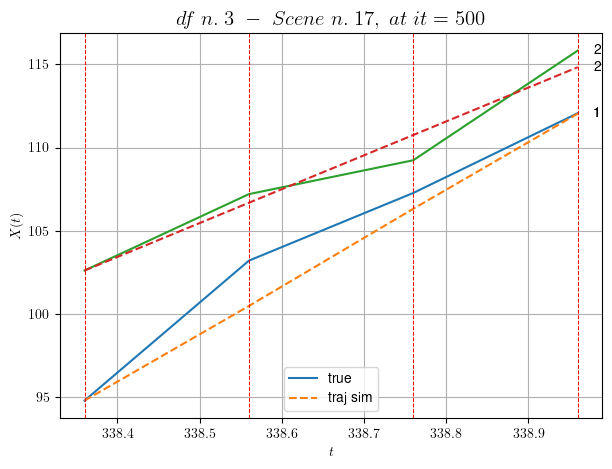

----------------------------------------------------------------------------------------------------
        For scene 6/60:
        * After LR finder: LR_NN=0.001 with mse=7.8520309221818385 at it=24
        * v0 = 20.358070226672208
        * MSE = 1.4795578980855228
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [130.96,131.96]


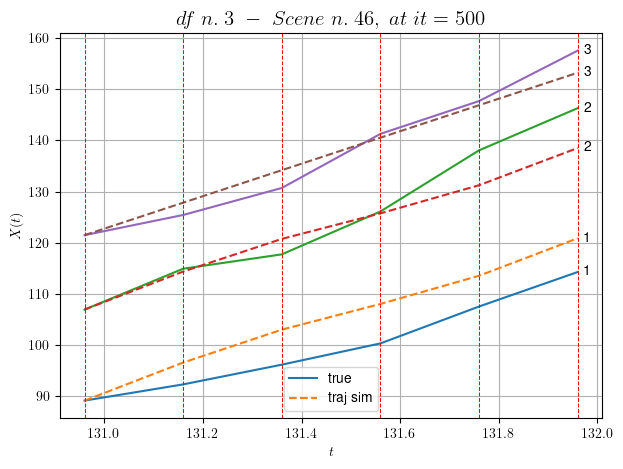

----------------------------------------------------------------------------------------------------
        For scene 7/60:
        * After LR finder: LR_NN=0.01 with mse=20.147571004409986 at it=24
        * v0 = 31.752337885124472
        * MSE = 18.078782730900688
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [590.36,591.76]


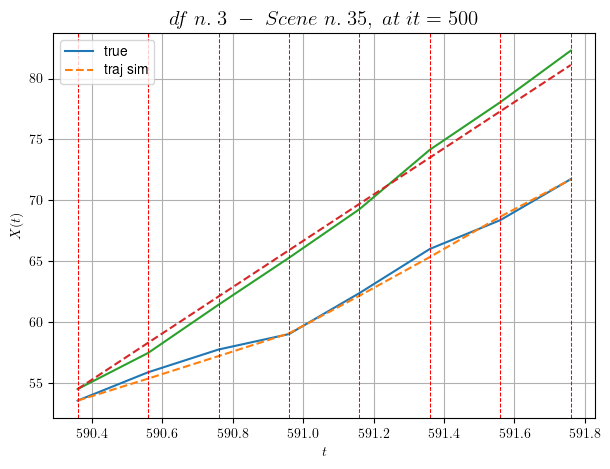

----------------------------------------------------------------------------------------------------
        For scene 8/60:
        * After LR finder: LR_NN=0.01 with mse=39.82904375457079 at it=24
        * v0 = 19.035476639426847
        * MSE = 0.3018177609203312
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [183.16,183.76]


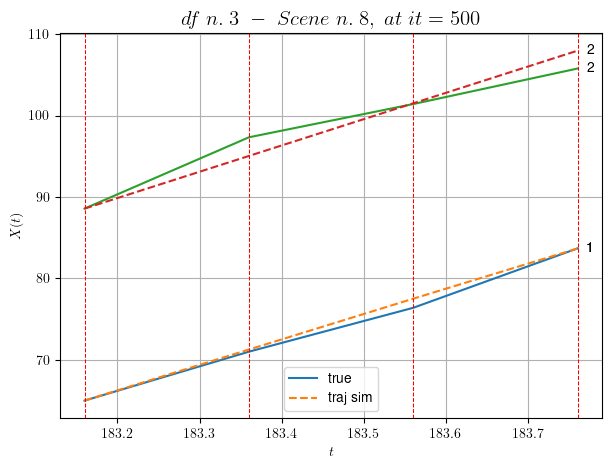

----------------------------------------------------------------------------------------------------
        For scene 9/60:
        * After LR finder: LR_NN=0.0005 with mse=1.295587948258892 at it=24
        * v0 = 32.313983310469666
        * MSE = 1.194707181904738
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.10/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [33.76,34.36]


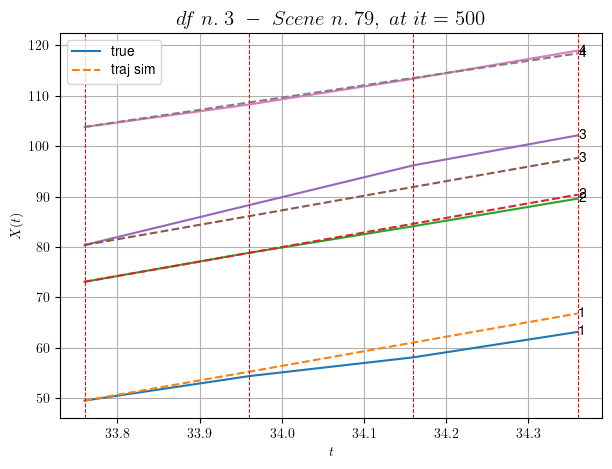

----------------------------------------------------------------------------------------------------
        For scene 10/60:
        * After LR finder: LR_NN=0.001 with mse=5.187390845834531 at it=24
        * v0 = 24.31564748296734
        * MSE = 4.200857491702323
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.11/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [486.56,487.56]


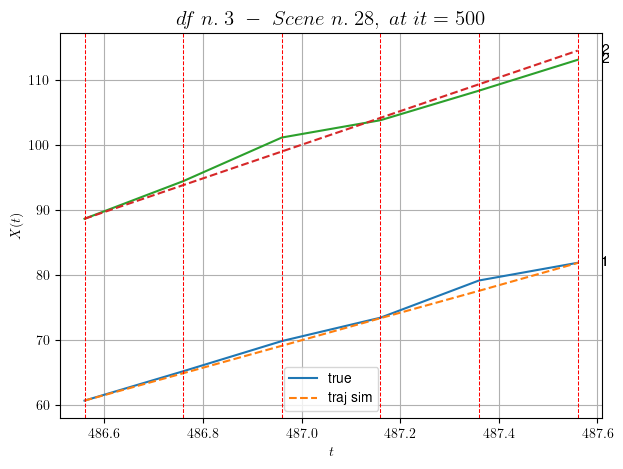

----------------------------------------------------------------------------------------------------
        For scene 11/60:
        * After LR finder: LR_NN=0.001 with mse=5.208088989305667 at it=24
        * v0 = 25.858119431708523
        * MSE = 0.9300556688090185
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.12/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [402.76,403.56]


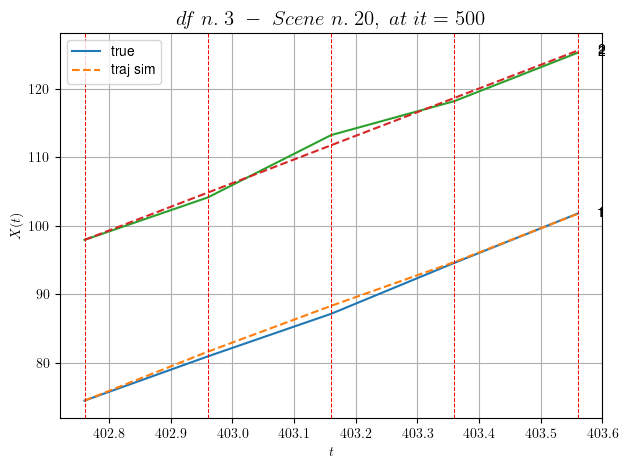

----------------------------------------------------------------------------------------------------
        For scene 12/60:
        * After LR finder: LR_NN=0.01 with mse=2.7844302445108315 at it=24
        * v0 = 34.51967072229264
        * MSE = 0.4004254211728835
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.13/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [248.16,248.56]


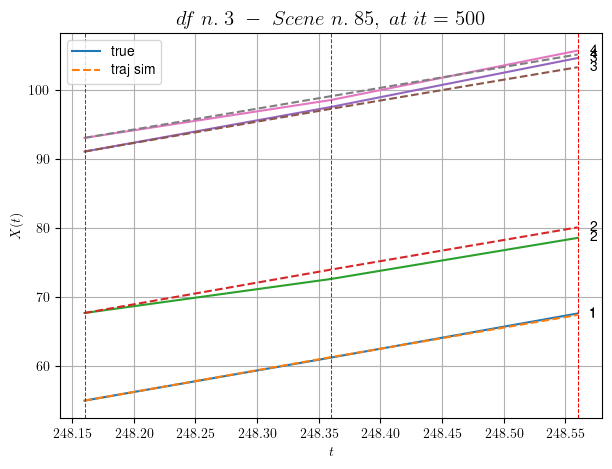

----------------------------------------------------------------------------------------------------
        For scene 13/60:
        * After LR finder: LR_NN=0.005 with mse=0.5384966293811235 at it=24
        * v0 = 30.248970609827392
        * MSE = 0.5597592665074923
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.14/60
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [464.56,466.56]


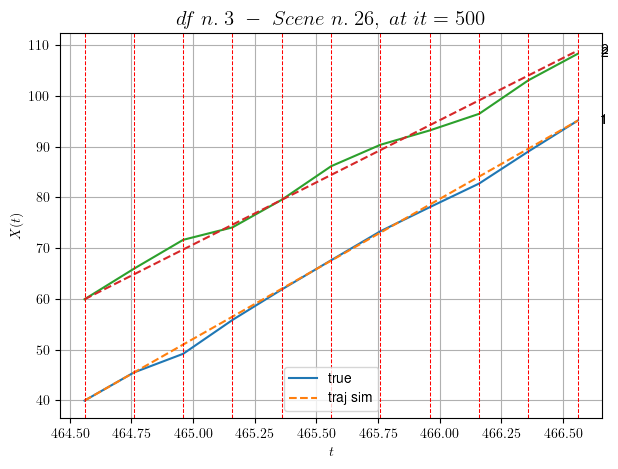

----------------------------------------------------------------------------------------------------
        For scene 14/60:
        * After LR finder: LR_NN=0.001 with mse=24.84099842548707 at it=24
        * v0 = 24.498602704881165
        * MSE = 1.130547674720728
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.15/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [247.36,248.56]


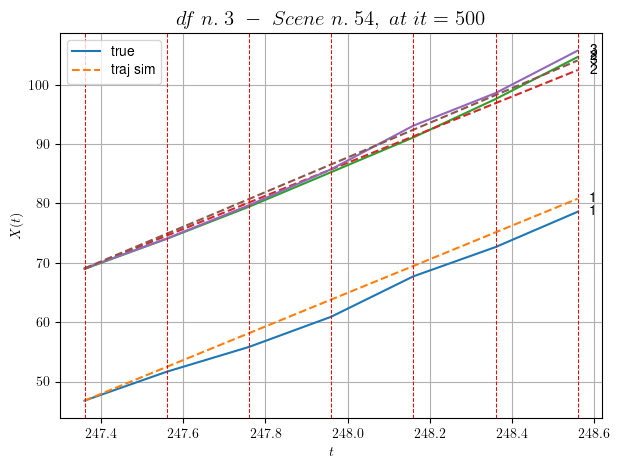

----------------------------------------------------------------------------------------------------
        For scene 15/60:
        * After LR finder: LR_NN=0.0005 with mse=1.3334633525452035 at it=24
        * v0 = 29.199545092787883
        * MSE = 1.6101380187364978
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.16/60
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [292.56,294.56]


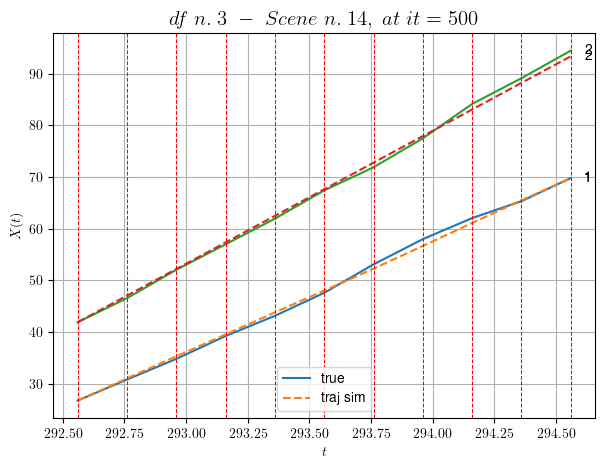

----------------------------------------------------------------------------------------------------
        For scene 16/60:
        * After LR finder: LR_NN=0.01 with mse=11.956174416527302 at it=24
        * v0 = 25.740986248381013
        * MSE = 0.4063385586463607
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.17/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [438.16,438.76]


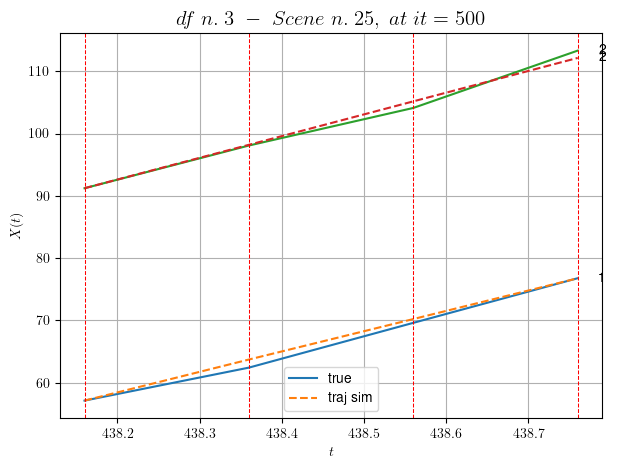

----------------------------------------------------------------------------------------------------
        For scene 17/60:
        * After LR finder: LR_NN=0.001 with mse=2.6395594038251278 at it=24
        * v0 = 34.8683780933164
        * MSE = 0.5674572360441541
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.18/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [79.56,80.36]


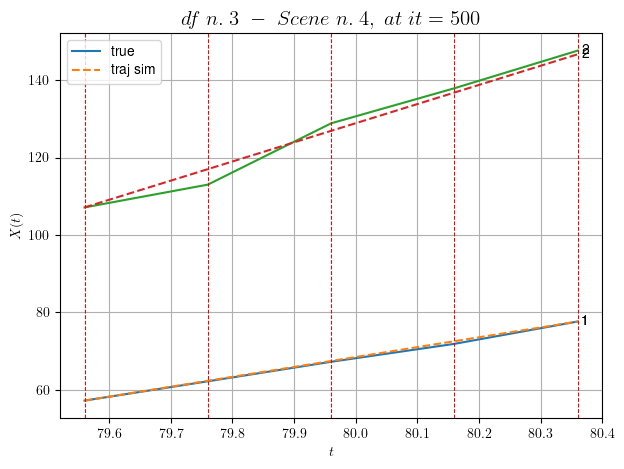

----------------------------------------------------------------------------------------------------
        For scene 18/60:
        * After LR finder: LR_NN=0.001 with mse=52.99543131652214 at it=24
        * v0 = 49.42636153730838
        * MSE = 2.2424526489647327
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.19/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [377.56,378.36]


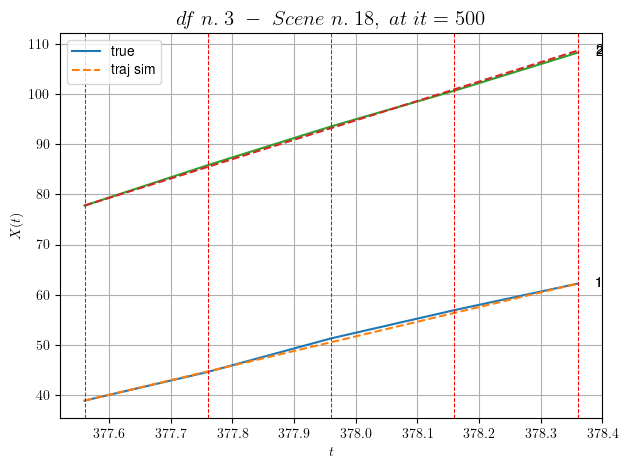

----------------------------------------------------------------------------------------------------
        For scene 19/60:
        * After LR finder: LR_NN=0.0005 with mse=8.565172579646578 at it=24
        * v0 = 38.59992828377948
        * MSE = 0.13262363367531838
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.20/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [42.96,43.76]


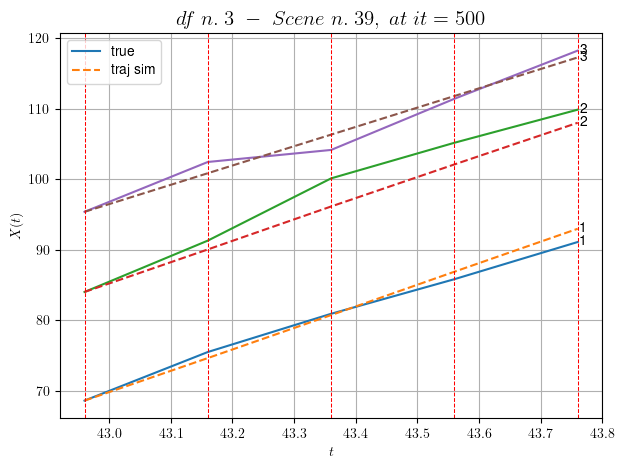

----------------------------------------------------------------------------------------------------
        For scene 20/60:
        * After LR finder: LR_NN=0.001 with mse=3.554345543150928 at it=24
        * v0 = 27.35067344092245
        * MSE = 2.9185251209637797
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.21/60
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [199.96,201.56]


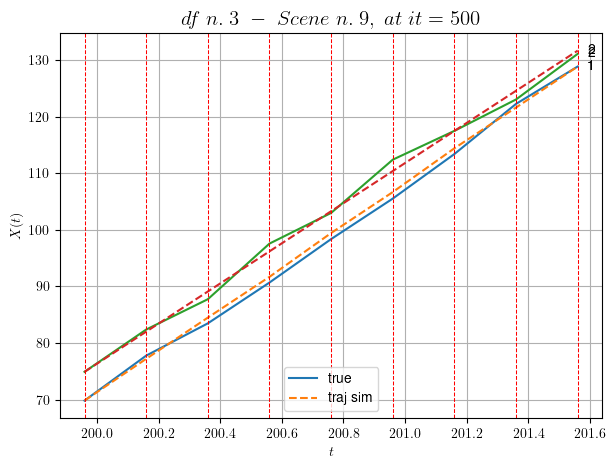

----------------------------------------------------------------------------------------------------
        For scene 21/60:
        * After LR finder: LR_NN=0.001 with mse=14.065342382332314 at it=24
        * v0 = 35.48263392775851
        * MSE = 0.9403380310927644
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.22/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [393.36,393.76]


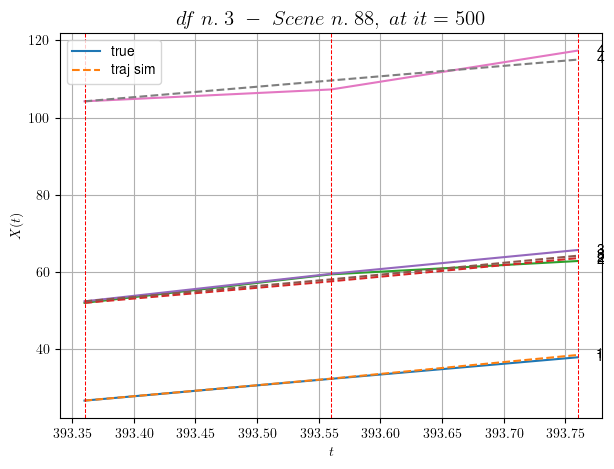

----------------------------------------------------------------------------------------------------
        For scene 22/60:
        * After LR finder: LR_NN=0.005 with mse=1.6911168064929543 at it=24
        * v0 = 27.006293536404645
        * MSE = 1.4924193180727494
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.23/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [154.56,155.36]


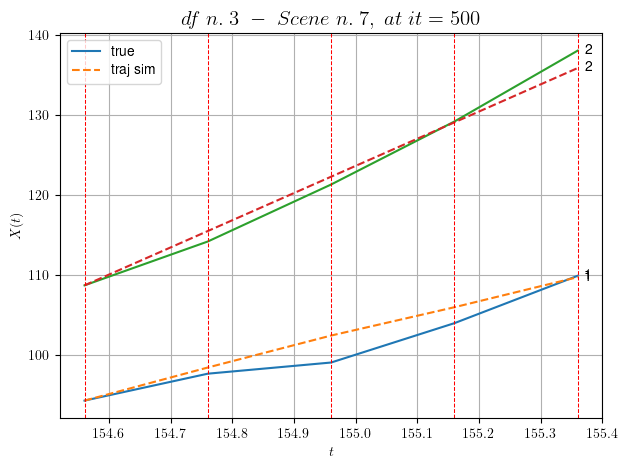

----------------------------------------------------------------------------------------------------
        For scene 23/60:
        * After LR finder: LR_NN=0.005 with mse=5.335704056512241 at it=24
        * v0 = 33.88242010375711
        * MSE = 2.2671923974364923
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.24/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [448.36,448.76]


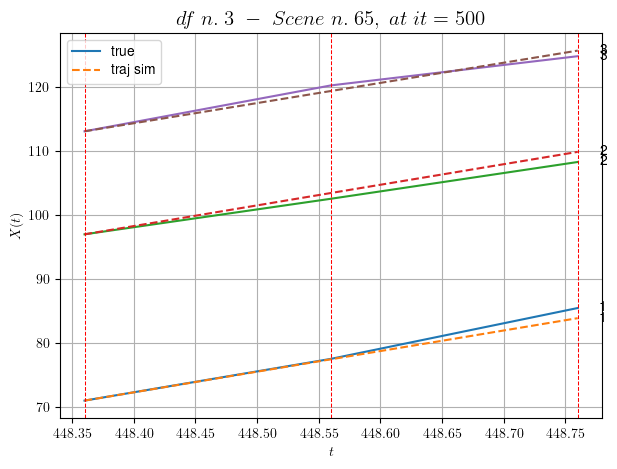

----------------------------------------------------------------------------------------------------
        For scene 24/60:
        * After LR finder: LR_NN=0.001 with mse=0.833025240023766 at it=24
        * v0 = 31.585048186375708
        * MSE = 0.7955690828898546
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.25/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [17.56,17.96]


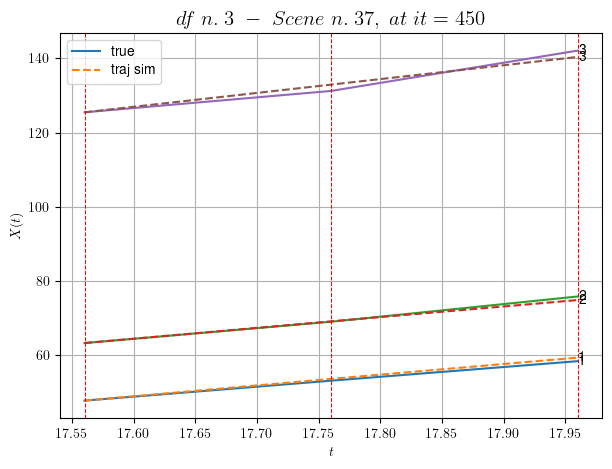

----------------------------------------------------------------------------------------------------
        For scene 25/60:
        * After LR finder: LR_NN=0.005 with mse=2.9465817078792256 at it=24
        * v0 = 37.341607473098264
        * MSE = 0.8769459237106764
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.26/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [83.36,84.56]


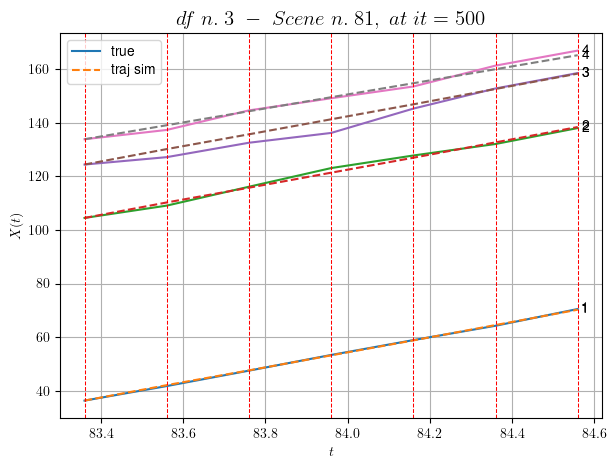

----------------------------------------------------------------------------------------------------
        For scene 26/60:
        * After LR finder: LR_NN=0.005 with mse=3.5702916422754463 at it=24
        * v0 = 26.107724197314457
        * MSE = 2.136998095603058
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.27/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [95.36,95.76]


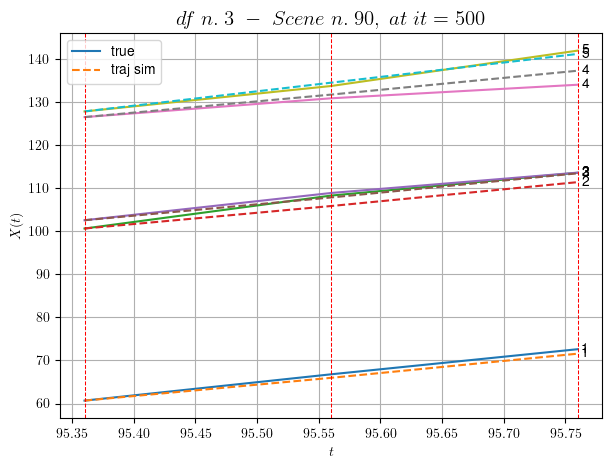

----------------------------------------------------------------------------------------------------
        For scene 27/60:
        * After LR finder: LR_NN=0.005 with mse=2.006148738719477 at it=24
        * v0 = 33.35137428698102
        * MSE = 1.7222527367536091
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.28/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [269.56,270.96]


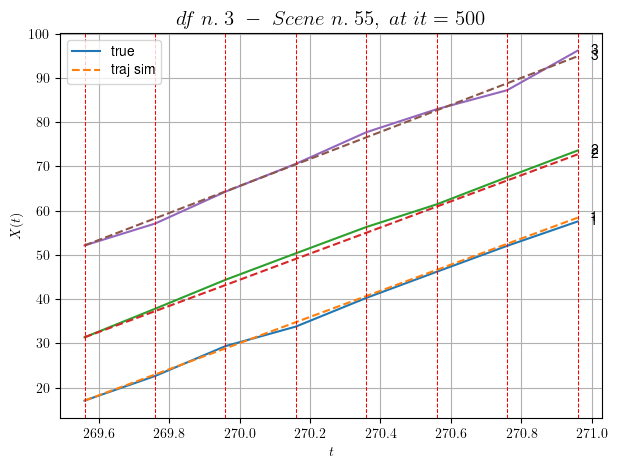

----------------------------------------------------------------------------------------------------
        For scene 28/60:
        * After LR finder: LR_NN=0.001 with mse=0.7744874460685308 at it=24
        * v0 = 30.539175669712044
        * MSE = 0.6673723788871492
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.29/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [82.16,82.76]


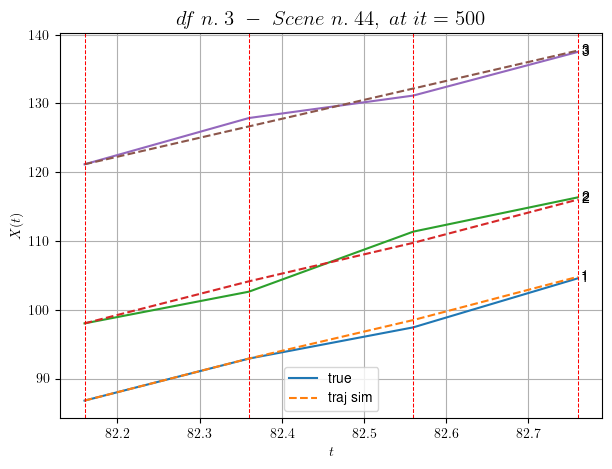

----------------------------------------------------------------------------------------------------
        For scene 29/60:
        * After LR finder: LR_NN=0.01 with mse=1.182915006940336 at it=24
        * v0 = 27.55023741370724
        * MSE = 0.7307377455001269
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.30/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [207.96,208.76]


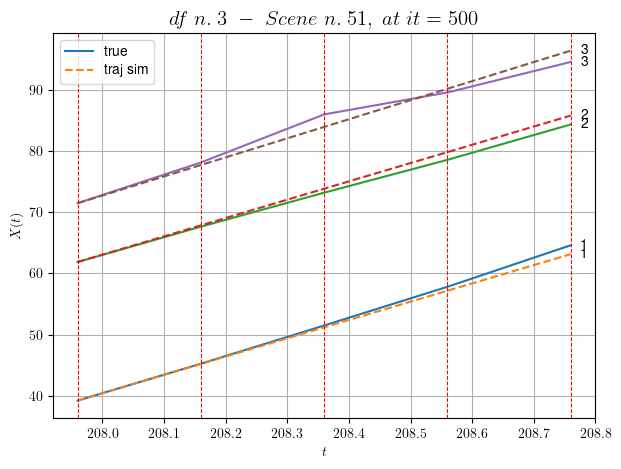

----------------------------------------------------------------------------------------------------
        For scene 30/60:
        * After LR finder: LR_NN=0.001 with mse=0.9444669964329163 at it=24
        * v0 = 31.124909645190172
        * MSE = 0.9448351893800268
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.31/60
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [139.16,141.56]


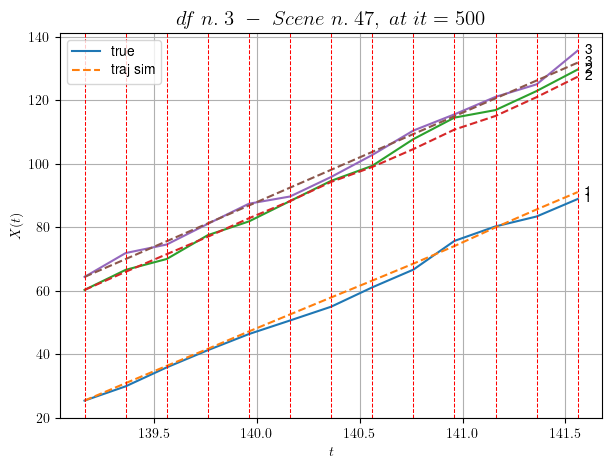

----------------------------------------------------------------------------------------------------
        For scene 31/60:
        * After LR finder: LR_NN=0.01 with mse=6.2878517344515545 at it=24
        * v0 = 28.144630567259274
        * MSE = 2.86442142456009
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.32/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [390.36,390.76]


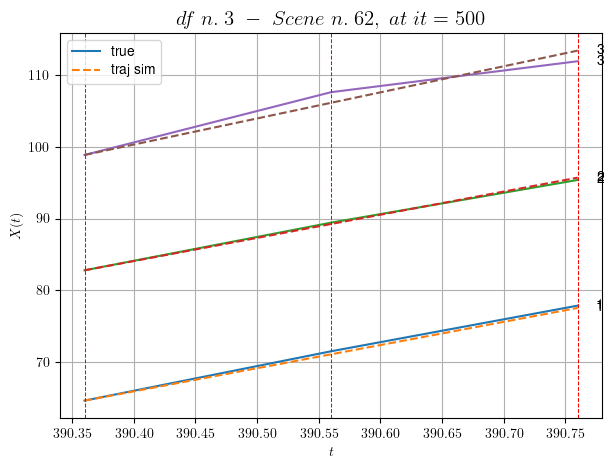

----------------------------------------------------------------------------------------------------
        For scene 32/60:
        * After LR finder: LR_NN=0.0001 with mse=1.0975358412030813 at it=24
        * v0 = 36.35426043629029
        * MSE = 0.5149751663537786
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.33/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [521.76,522.76]


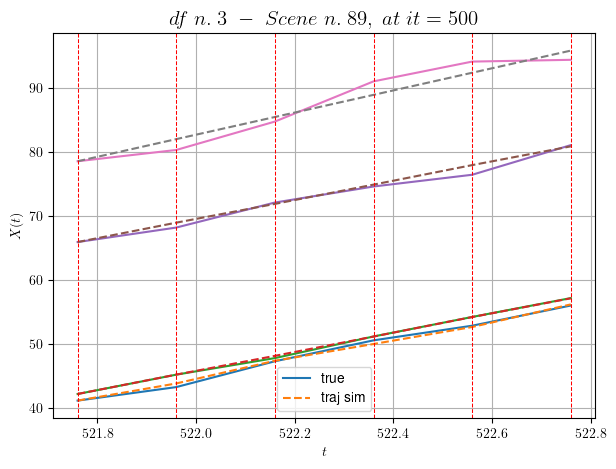

----------------------------------------------------------------------------------------------------
        For scene 33/60:
        * After LR finder: LR_NN=0.01 with mse=15.054322816093253 at it=24
        * v0 = 17.247787667047
        * MSE = 0.6933996680245622
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.34/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [331.56,332.56]


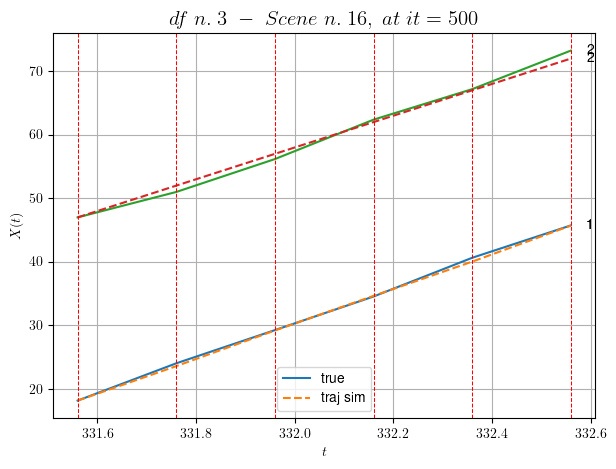

----------------------------------------------------------------------------------------------------
        For scene 34/60:
        * After LR finder: LR_NN=0.01 with mse=4.1818307242719355 at it=24
        * v0 = 25.00216687994852
        * MSE = 0.3299023567172156
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.35/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [530.36,530.96]


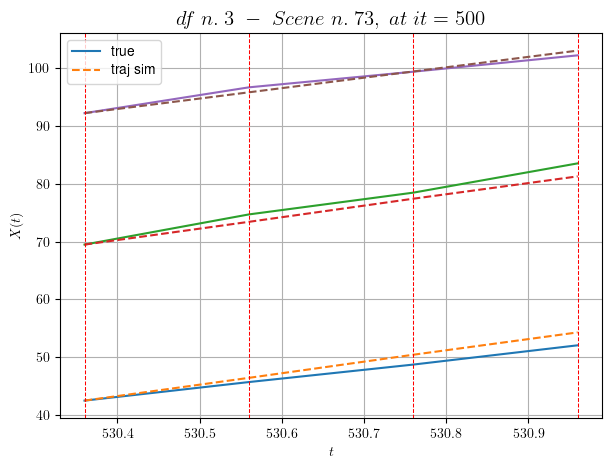

----------------------------------------------------------------------------------------------------
        For scene 35/60:
        * After LR finder: LR_NN=0.005 with mse=8.812556248865441 at it=24
        * v0 = 18.054855152780465
        * MSE = 1.4733222983805891
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.36/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [67.16,67.76]


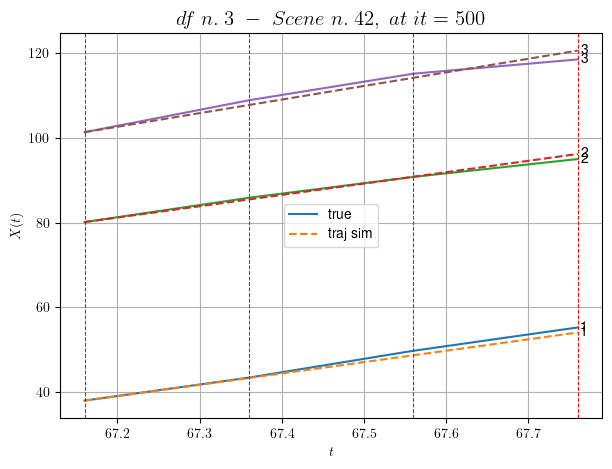

----------------------------------------------------------------------------------------------------
        For scene 36/60:
        * After LR finder: LR_NN=0.001 with mse=0.9031331060394153 at it=24
        * v0 = 32.139321542456024
        * MSE = 0.8343617361275256
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.37/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [335.76,336.16]


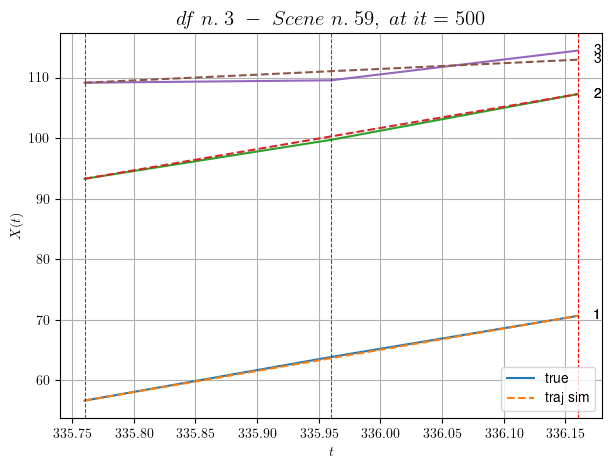

----------------------------------------------------------------------------------------------------
        For scene 37/60:
        * After LR finder: LR_NN=0.001 with mse=8.52093421166089 at it=24
        * v0 = 9.495680524398178
        * MSE = 0.49074063715928595
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.38/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [149.36,149.96]


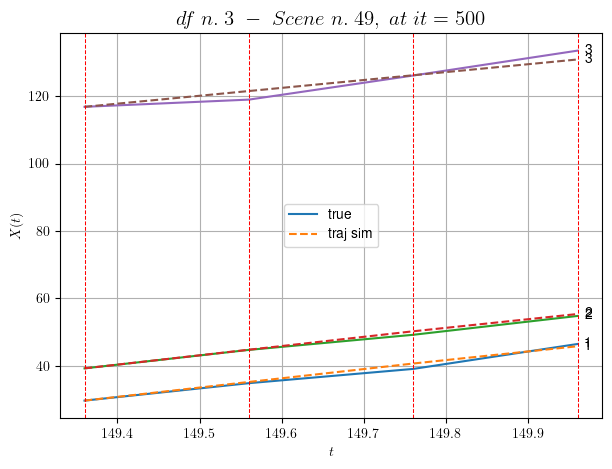

----------------------------------------------------------------------------------------------------
        For scene 38/60:
        * After LR finder: LR_NN=0.005 with mse=2.517554575429216 at it=24
        * v0 = 23.443555328520958
        * MSE = 1.4335461865372772
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.39/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [34.96,35.36]


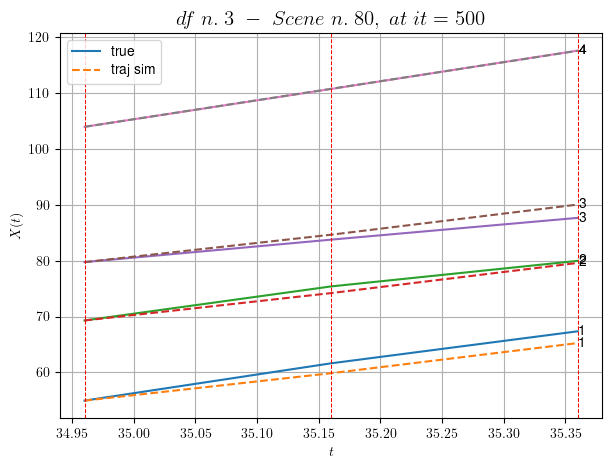

----------------------------------------------------------------------------------------------------
        For scene 39/60:
        * After LR finder: LR_NN=0.01 with mse=1.686822764539969 at it=24
        * v0 = 34.04452453089857
        * MSE = 1.2982256760689754
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.40/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [325.76,326.96]


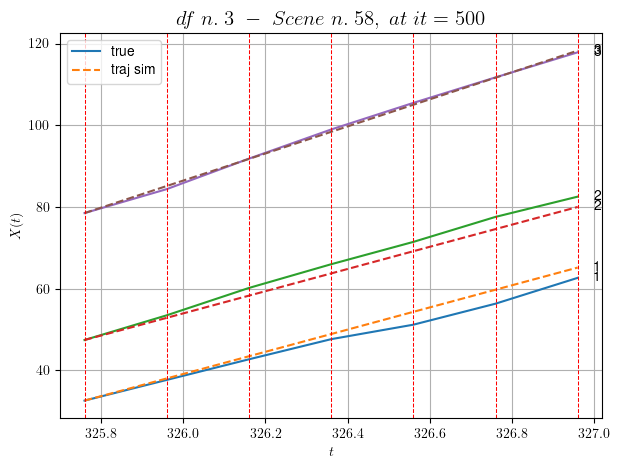

----------------------------------------------------------------------------------------------------
        For scene 40/60:
        * After LR finder: LR_NN=0.0005 with mse=4.632411641012602 at it=24
        * v0 = 33.13555230710742
        * MSE = 2.9037067765538898
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.41/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [573.76,574.56]


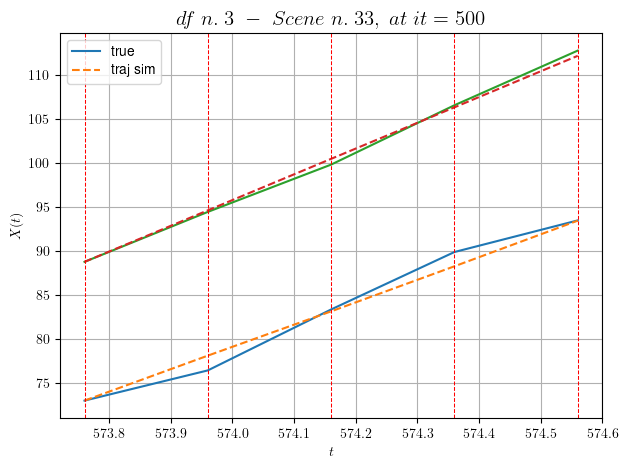

----------------------------------------------------------------------------------------------------
        For scene 41/60:
        * After LR finder: LR_NN=0.001 with mse=1.0745680459526483 at it=24
        * v0 = 29.329399819600855
        * MSE = 0.6225797786682877
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.42/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [320.56,321.16]


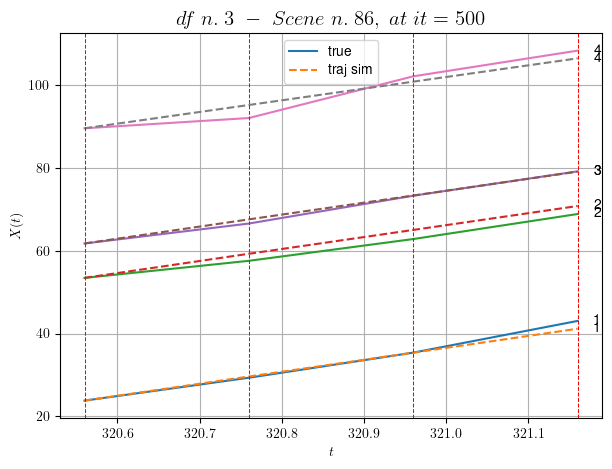

----------------------------------------------------------------------------------------------------
        For scene 42/60:
        * After LR finder: LR_NN=0.001 with mse=1.8757214637548534 at it=24
        * v0 = 28.130140949141975
        * MSE = 1.7515905146071247
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.43/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [371.16,371.76]


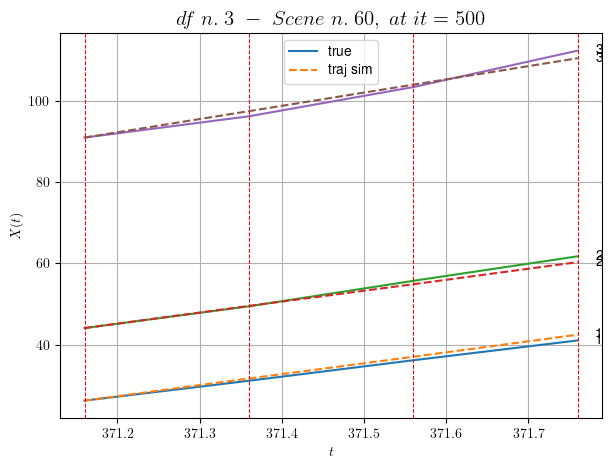

----------------------------------------------------------------------------------------------------
        For scene 43/60:
        * After LR finder: LR_NN=0.005 with mse=1.507968066502995 at it=24
        * v0 = 32.53950759922702
        * MSE = 0.9390130266815522
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.44/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [439.36,439.96]


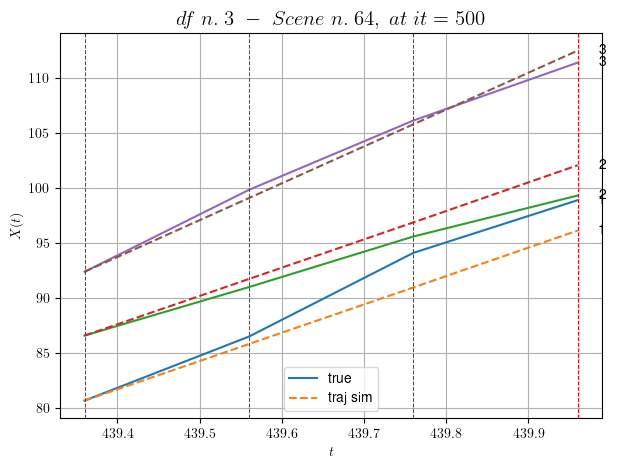

----------------------------------------------------------------------------------------------------
        For scene 44/60:
        * After LR finder: LR_NN=0.001 with mse=2.909528522278972 at it=24
        * v0 = 33.53637857272987
        * MSE = 2.4304386835008285
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.45/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [31.36,31.96]


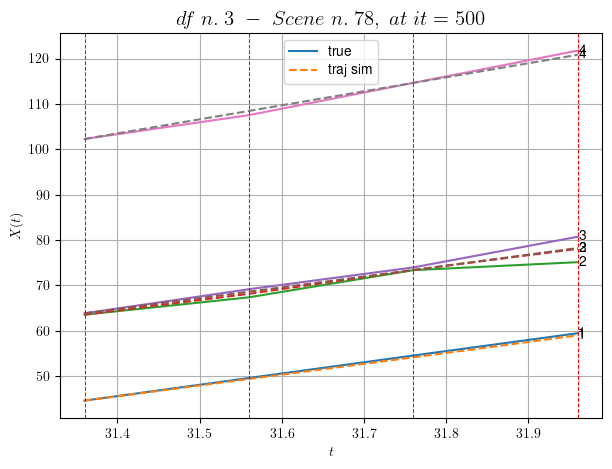

----------------------------------------------------------------------------------------------------
        For scene 45/60:
        * After LR finder: LR_NN=0.005 with mse=1.0341781386349616 at it=24
        * v0 = 30.917174059155997
        * MSE = 1.036849305310171
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.46/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [23.96,24.76]


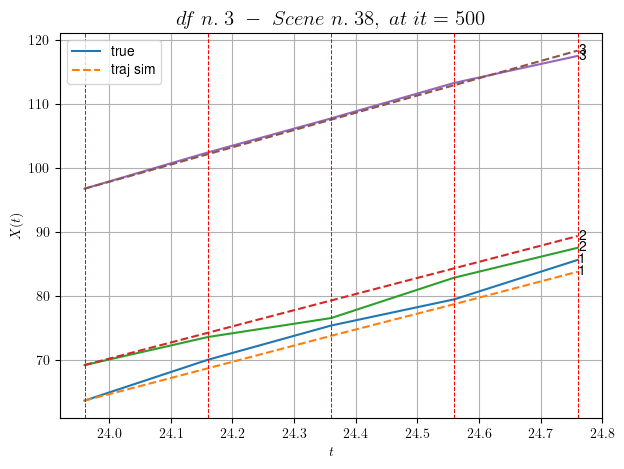

----------------------------------------------------------------------------------------------------
        For scene 46/60:
        * After LR finder: LR_NN=0.0005 with mse=2.400612454967984 at it=24
        * v0 = 27.016664353697166
        * MSE = 1.5146133861362037
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.47/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [544.16,545.16]


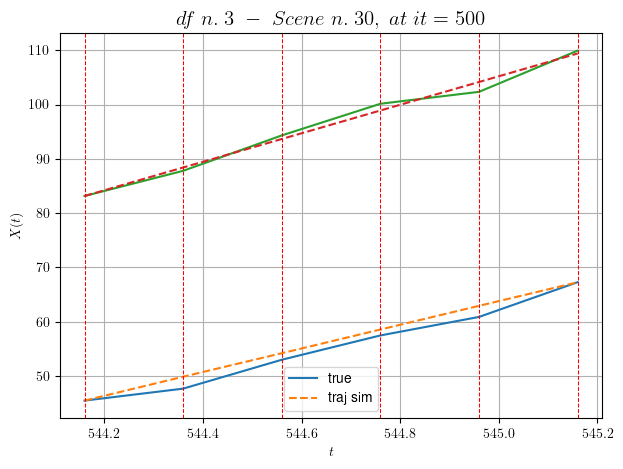

----------------------------------------------------------------------------------------------------
        For scene 47/60:
        * After LR finder: LR_NN=0.001 with mse=4.101679501968807 at it=24
        * v0 = 26.245021293268415
        * MSE = 1.4542829552519516
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.48/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [12.76,13.96]


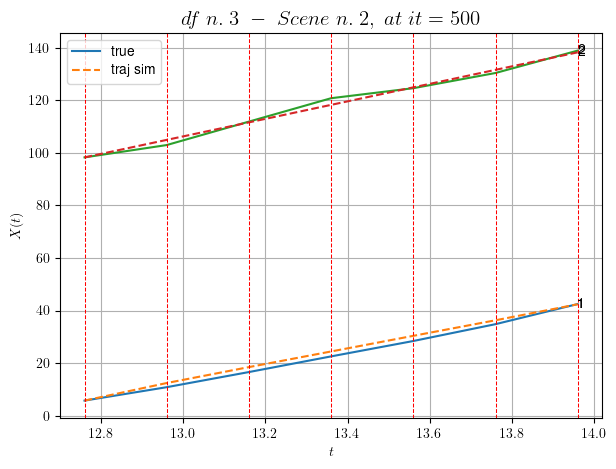

----------------------------------------------------------------------------------------------------
        For scene 48/60:
        * After LR finder: LR_NN=0.01 with mse=4.943124887565567 at it=24
        * v0 = 33.32970746415815
        * MSE = 1.850447505573234
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.49/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [222.96,223.76]


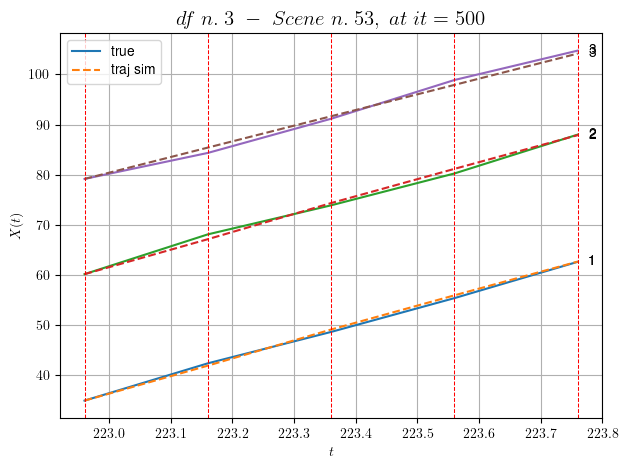

----------------------------------------------------------------------------------------------------
        For scene 49/60:
        * After LR finder: LR_NN=0.005 with mse=0.7105504309249092 at it=24
        * v0 = 31.279750687417696
        * MSE = 0.36158067666810534
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.50/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [427.36,427.76]


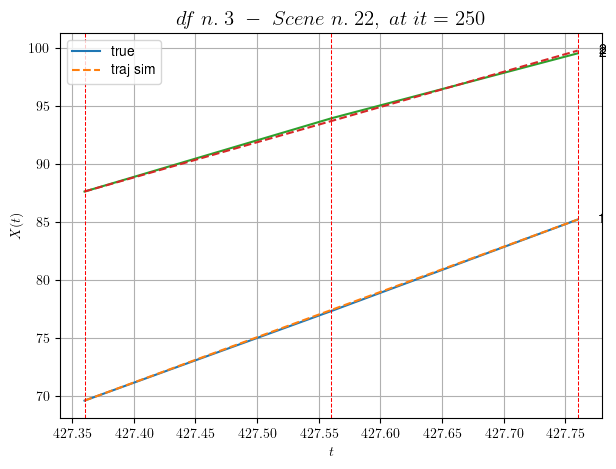

----------------------------------------------------------------------------------------------------
        For scene 50/60:
        * After LR finder: LR_NN=0.001 with mse=0.03746043013450533 at it=24
        * v0 = 30.361524570420812
        * MSE = 0.017724987830435766
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.51/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [40.76,41.16]


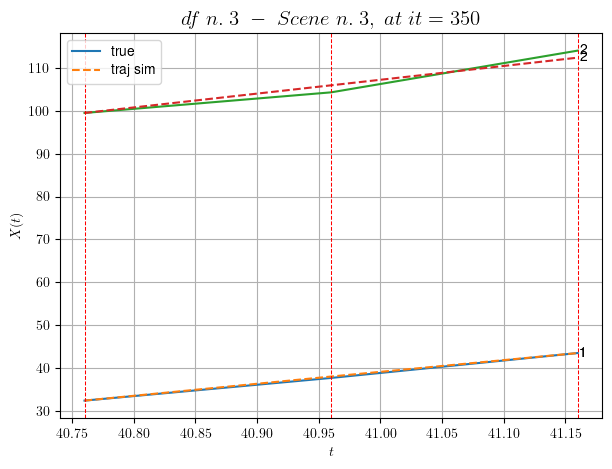

----------------------------------------------------------------------------------------------------
        For scene 51/60:
        * After LR finder: LR_NN=0.005 with mse=1.4375484301776718 at it=24
        * v0 = 32.206883477207874
        * MSE = 0.914678875065149
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.52/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [436.16,437.56]


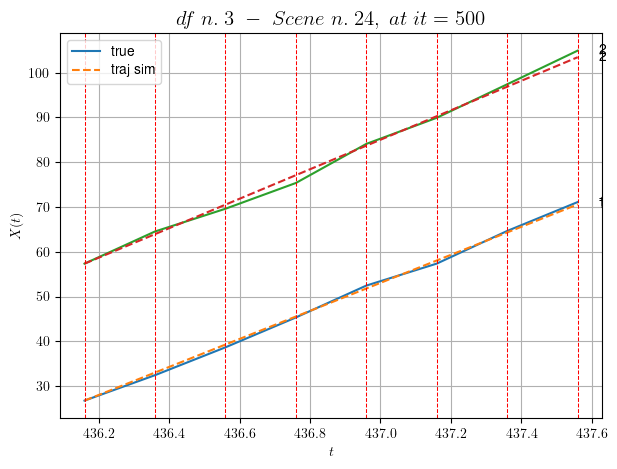

----------------------------------------------------------------------------------------------------
        For scene 52/60:
        * After LR finder: LR_NN=1e-05 with mse=4.060312073579321 at it=24
        * v0 = 32.92393930276377
        * MSE = 0.5650612856936286
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.53/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [170.36,170.76]


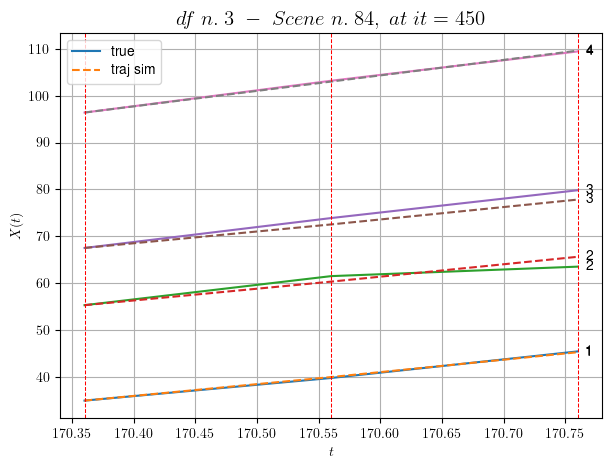

----------------------------------------------------------------------------------------------------
        For scene 53/60:
        * After LR finder: LR_NN=0.005 with mse=1.1375921531900222 at it=24
        * v0 = 32.996515057078554
        * MSE = 0.9723293520961709
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.54/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [579.56,580.56]


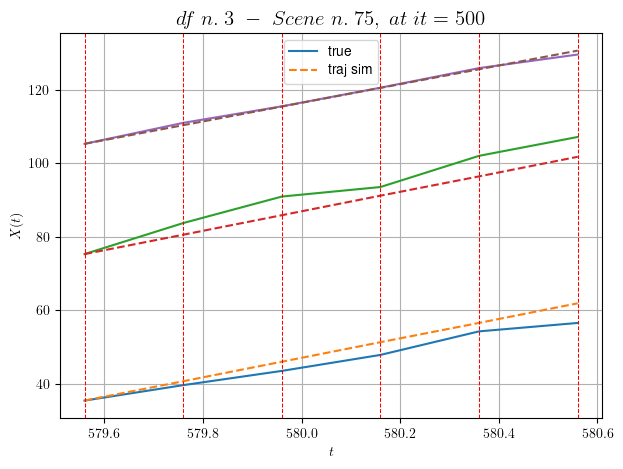

----------------------------------------------------------------------------------------------------
        For scene 54/60:
        * After LR finder: LR_NN=0.001 with mse=12.197933338533604 at it=24
        * v0 = 25.358404463472585
        * MSE = 8.69006890360773
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.55/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [142.16,142.76]


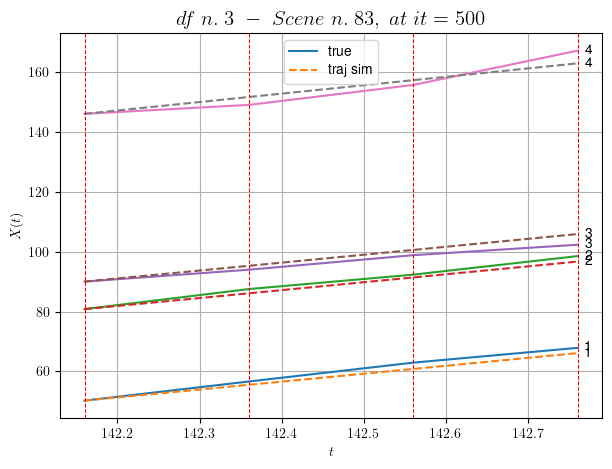

----------------------------------------------------------------------------------------------------
        For scene 55/60:
        * After LR finder: LR_NN=0.001 with mse=3.6005935795081117 at it=24
        * v0 = 28.12123774853818
        * MSE = 3.5471020120404897
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.56/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [417.16,418.16]


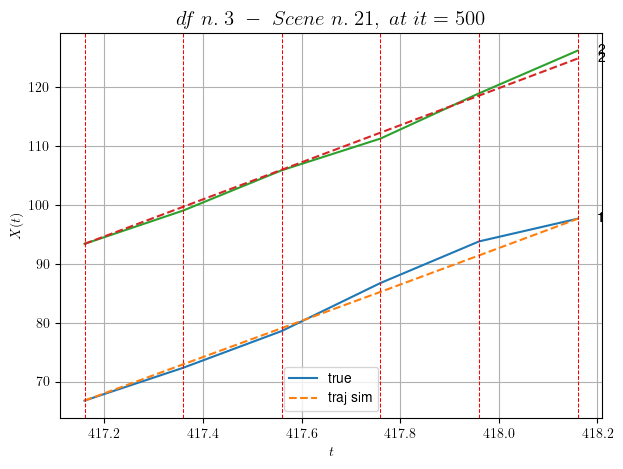

----------------------------------------------------------------------------------------------------
        For scene 56/60:
        * After LR finder: LR_NN=0.0005 with mse=2.0926451742002703 at it=24
        * v0 = 31.44799012371566
        * MSE = 0.9793445549709703
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.57/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [387.36,388.16]


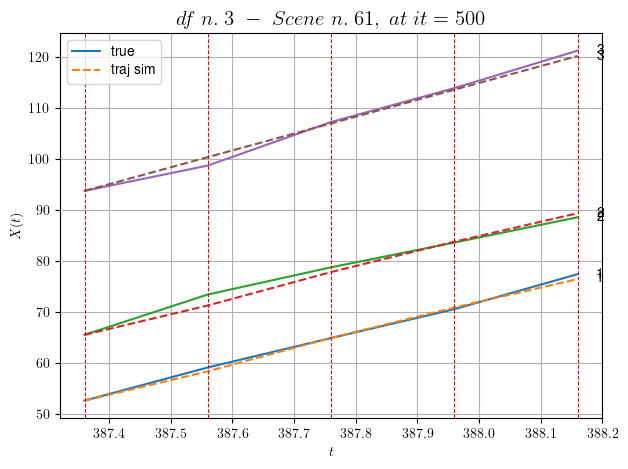

----------------------------------------------------------------------------------------------------
        For scene 57/60:
        * After LR finder: LR_NN=0.01 with mse=1.8330390238620804 at it=24
        * v0 = 33.03189808825565
        * MSE = 0.7545897054200537
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.58/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [527.36,528.16]


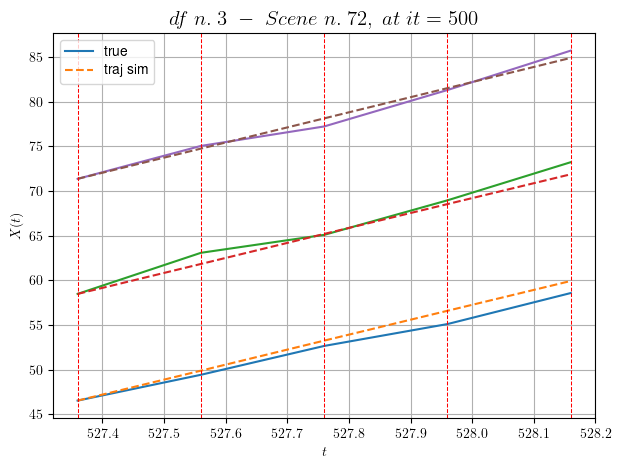

----------------------------------------------------------------------------------------------------
        For scene 58/60:
        * After LR finder: LR_NN=0.001 with mse=13.960930662443014 at it=24
        * v0 = 16.920906022775576
        * MSE = 0.6513346772953601
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.59/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [299.76,300.56]


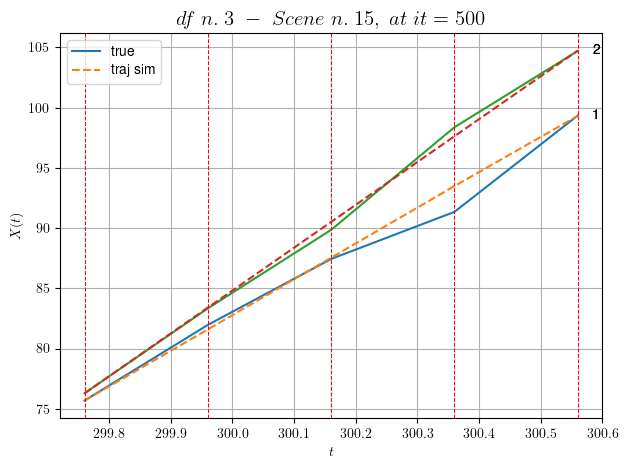

----------------------------------------------------------------------------------------------------
        For scene 59/60:
        * After LR finder: LR_NN=0.001 with mse=4.540890073282284 at it=24
        * v0 = 35.55620181997074
        * MSE = 0.5664641738789891
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.60/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [218.16,219.16]


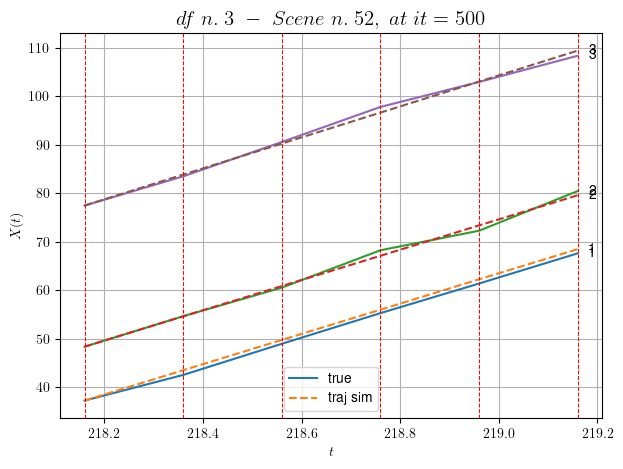

----------------------------------------------------------------------------------------------------
        For scene 60/60:
        * After LR finder: LR_NN=0.001 with mse=0.9592445533574313 at it=24
        * v0 = 31.946925583263518
        * MSE = 0.5312692457357124
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.7276591223385267
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (30 scenes)
DataFrame n.3. Scene n.1/30


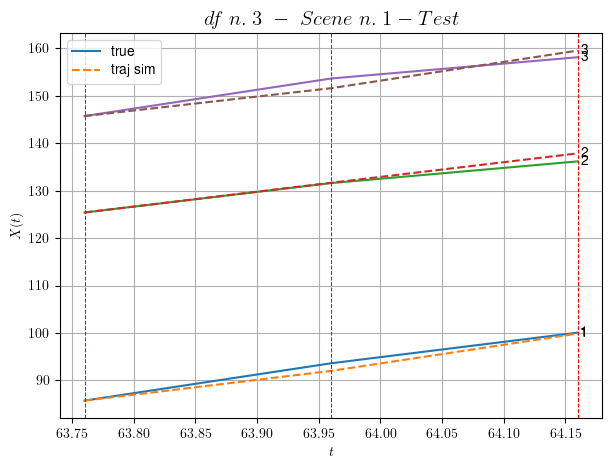

        For scene 1/30:
        * MSE = 1.286529239641842
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/30


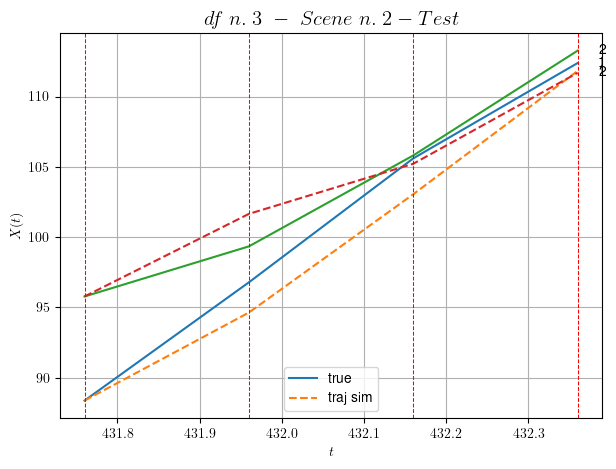

        For scene 2/30:
        * MSE = 2.4513158866379356
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/30


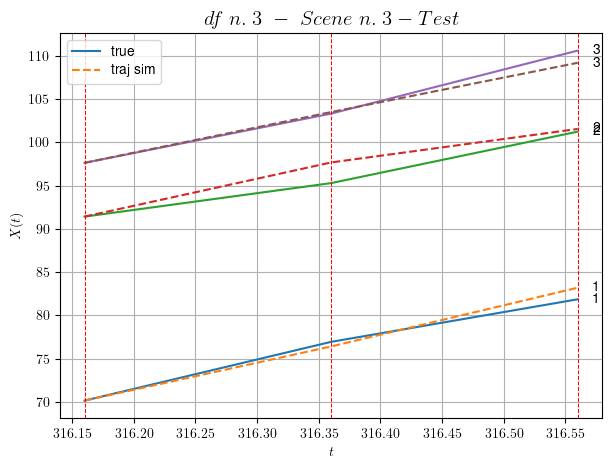

        For scene 3/30:
        * MSE = 1.0987025809435444
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/30


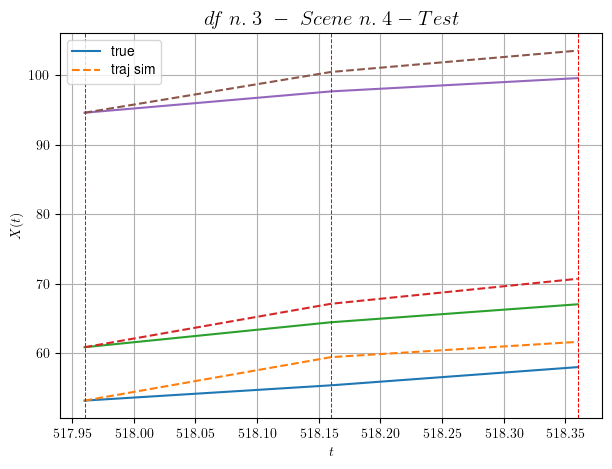

        For scene 4/30:
        * MSE = 8.204072226086154
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/30


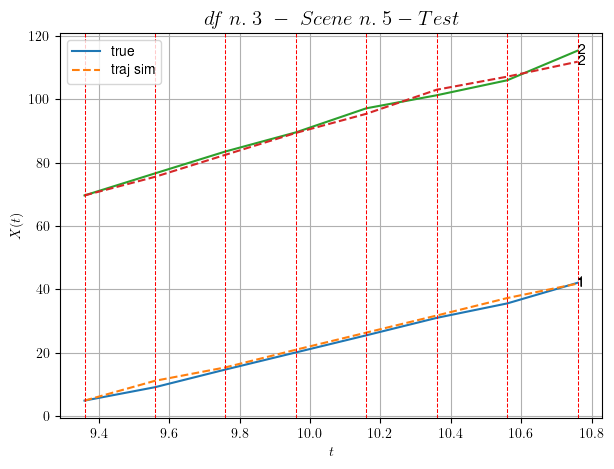

        For scene 5/30:
        * MSE = 1.9643456462566626
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/30


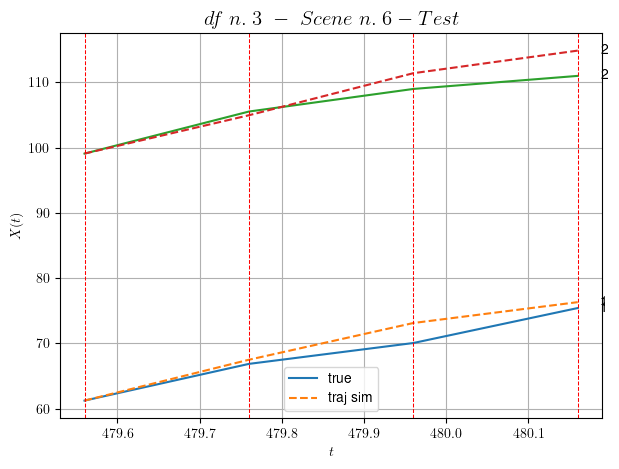

        For scene 6/30:
        * MSE = 3.9702812671133674
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/30


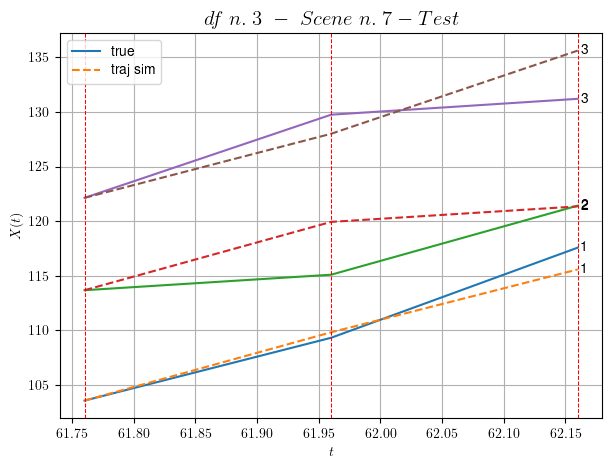

        For scene 7/30:
        * MSE = 5.584553687536719
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/30


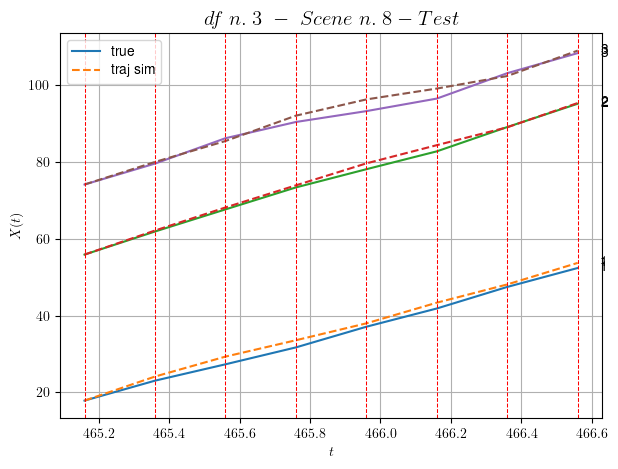

        For scene 8/30:
        * MSE = 1.6631521827852787
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/30


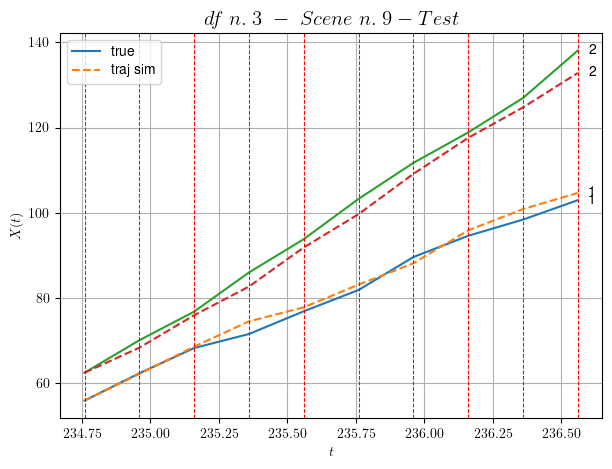

        For scene 9/30:
        * MSE = 4.8133503896562075
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.10/30


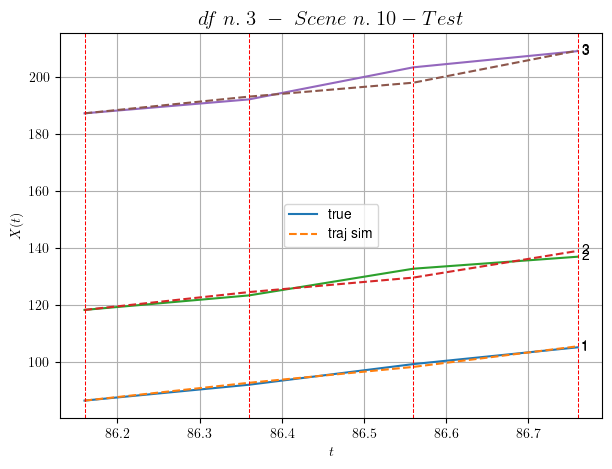

        For scene 10/30:
        * MSE = 3.9190825791352233
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.11/30


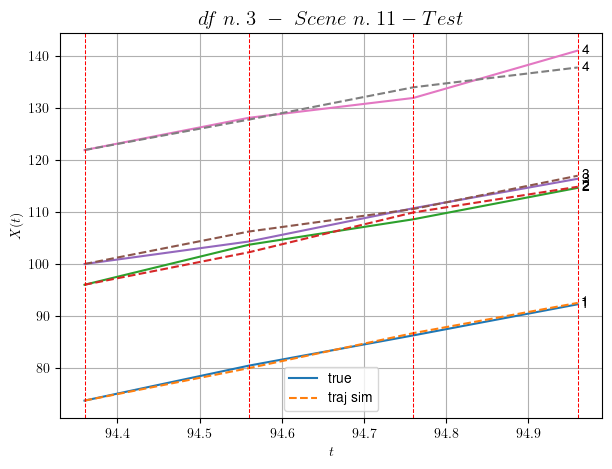

        For scene 11/30:
        * MSE = 1.4588912750794432
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.12/30


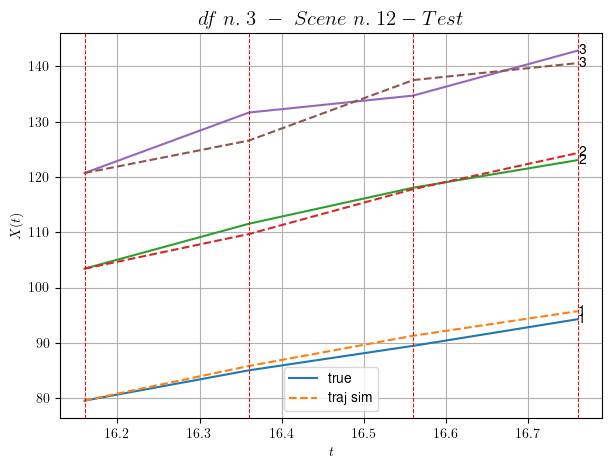

        For scene 12/30:
        * MSE = 4.151374919553549
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.13/30


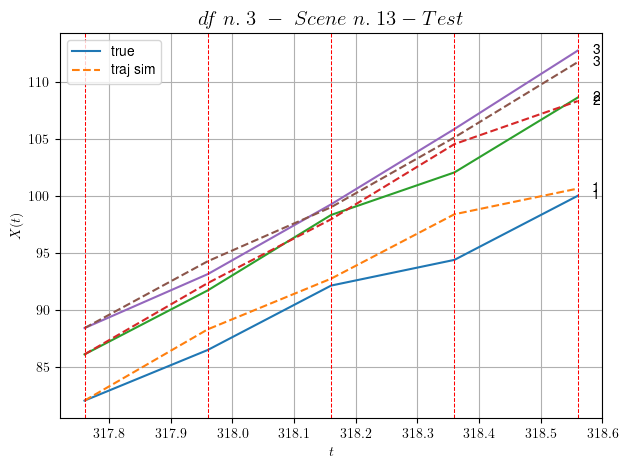

        For scene 13/30:
        * MSE = 1.9901042378496863
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.14/30


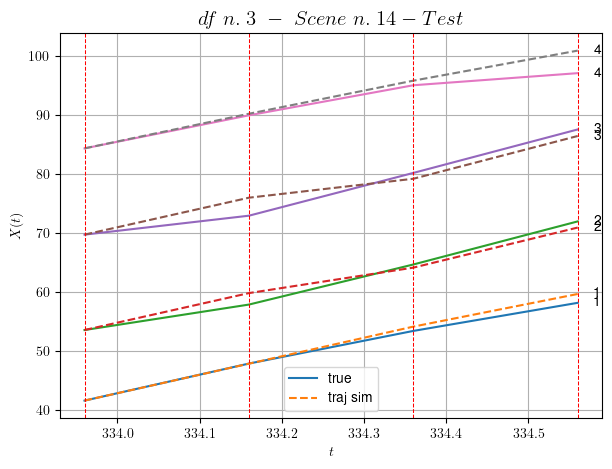

        For scene 14/30:
        * MSE = 2.1707764402182748
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.15/30


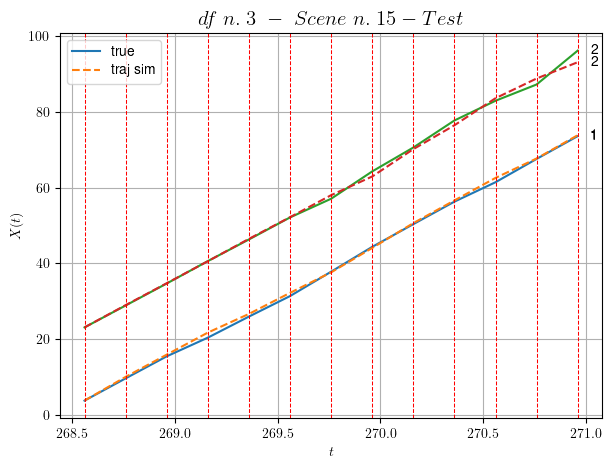

        For scene 15/30:
        * MSE = 0.8392367827729849
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.16/30


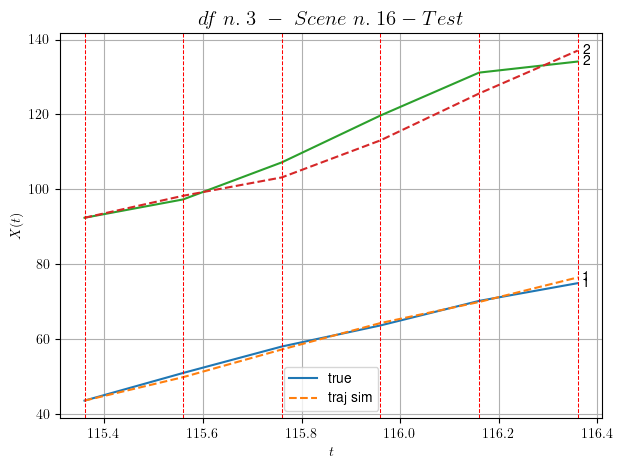

        For scene 16/30:
        * MSE = 8.781074433569081
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.17/30


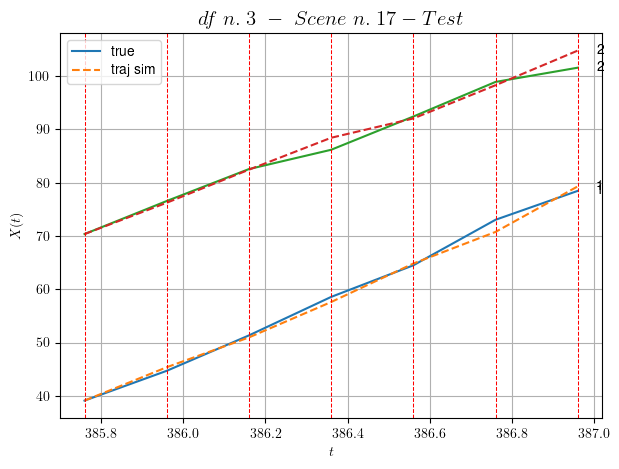

        For scene 17/30:
        * MSE = 1.6793215224878408
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.18/30


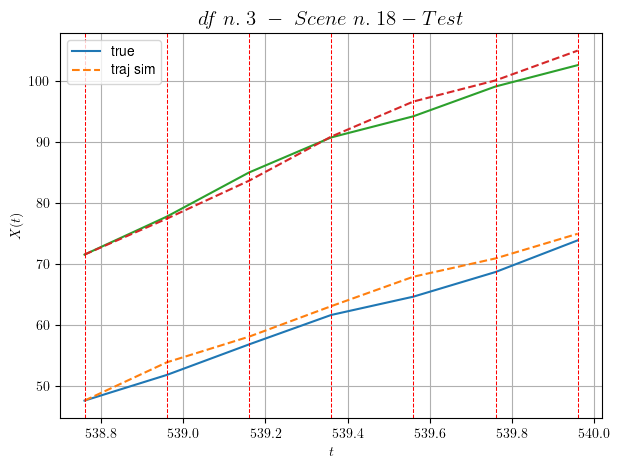

        For scene 18/30:
        * MSE = 2.793112499750528
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.19/30


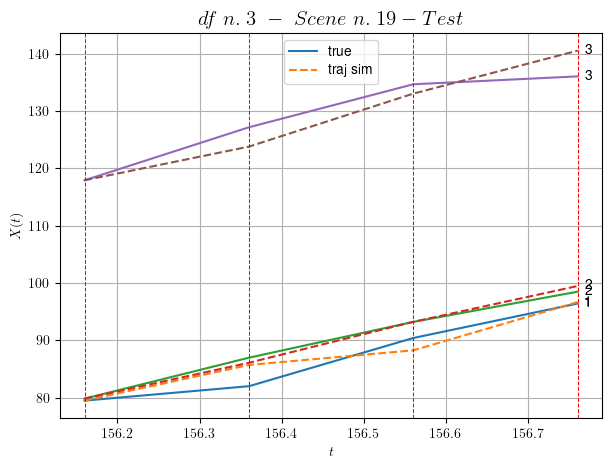

        For scene 19/30:
        * MSE = 4.540454445623633
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.20/30


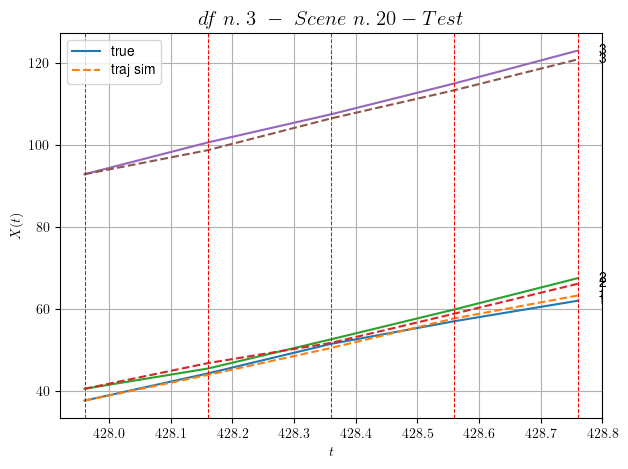

        For scene 20/30:
        * MSE = 1.366359716692396
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.21/30


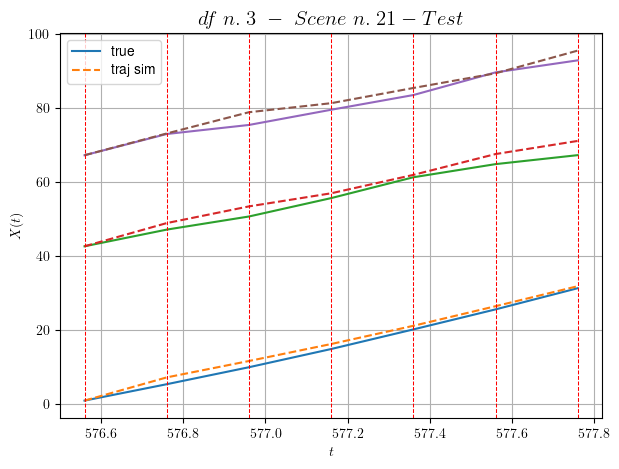

        For scene 21/30:
        * MSE = 3.346258265020141
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.22/30


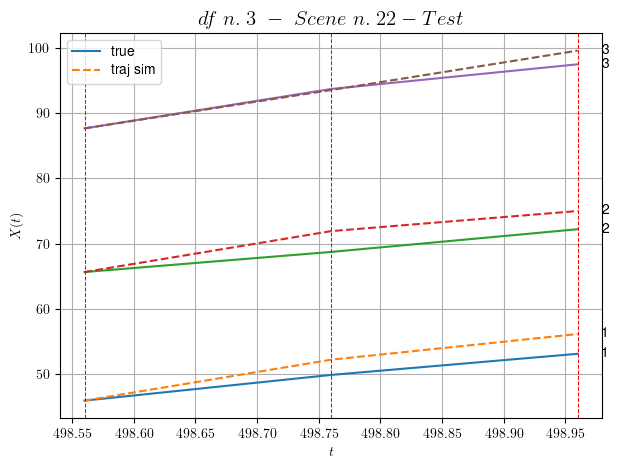

        For scene 22/30:
        * MSE = 4.099947856434016
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.23/30


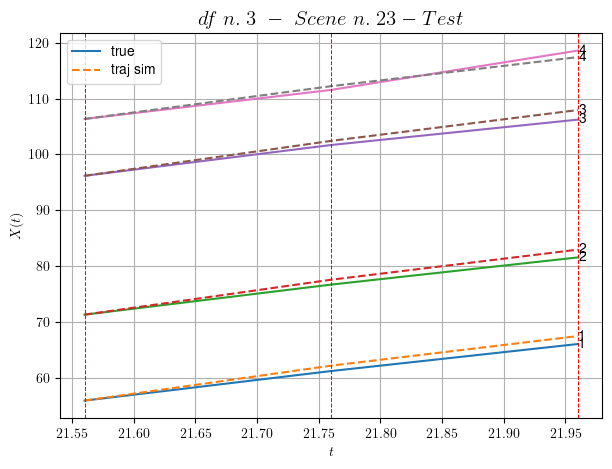

        For scene 23/30:
        * MSE = 0.9134346882257501
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.24/30


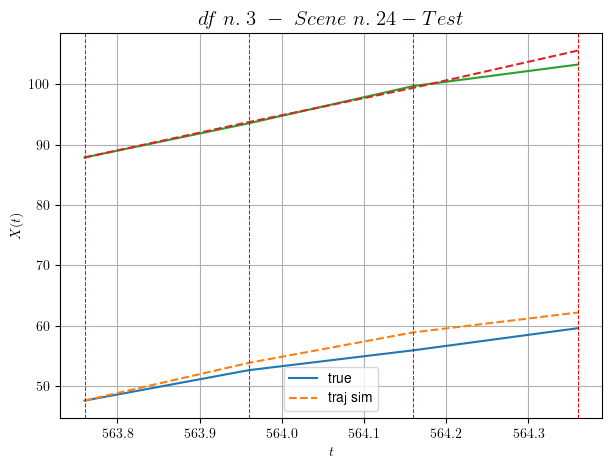

        For scene 24/30:
        * MSE = 2.819071520280848
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.25/30


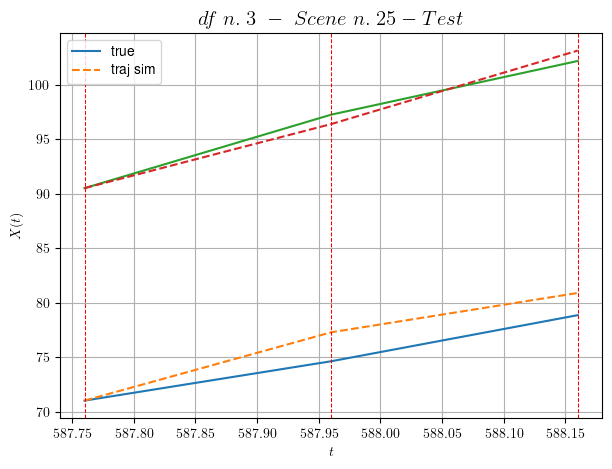

        For scene 25/30:
        * MSE = 2.139549276880174
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.26/30


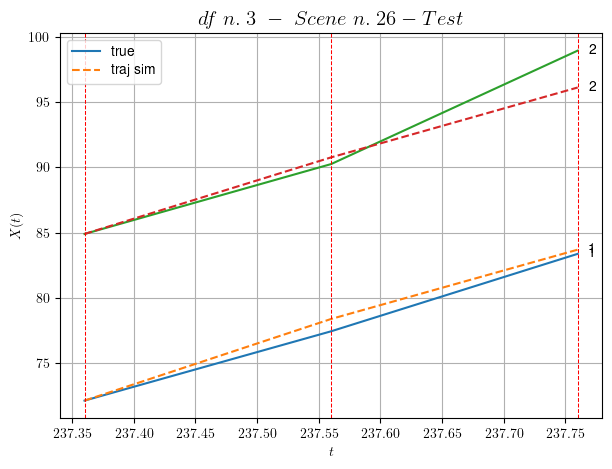

        For scene 26/30:
        * MSE = 1.5426210773533473
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.27/30


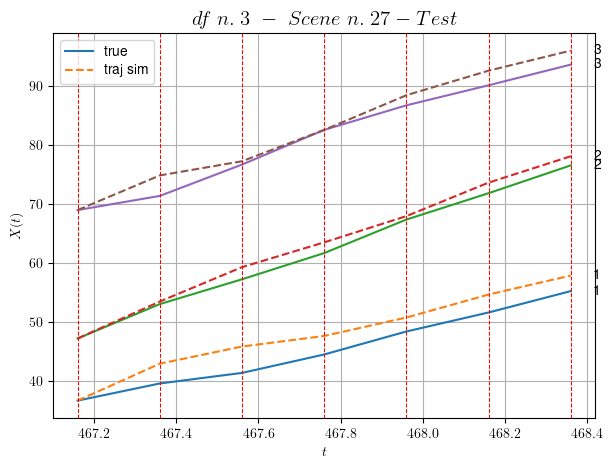

        For scene 27/30:
        * MSE = 4.9352339100781455
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.28/30


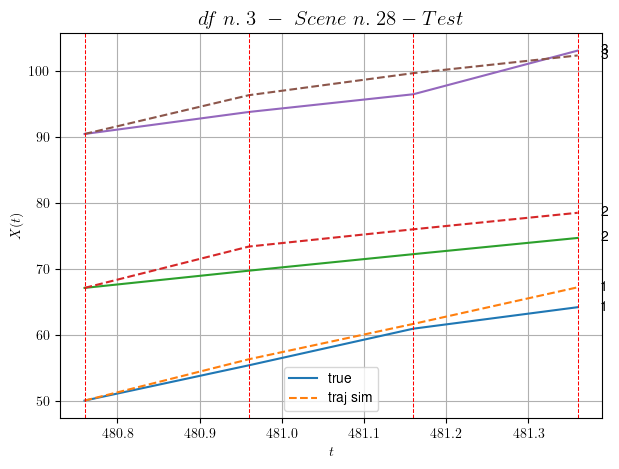

        For scene 28/30:
        * MSE = 5.801120704249368
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.29/30


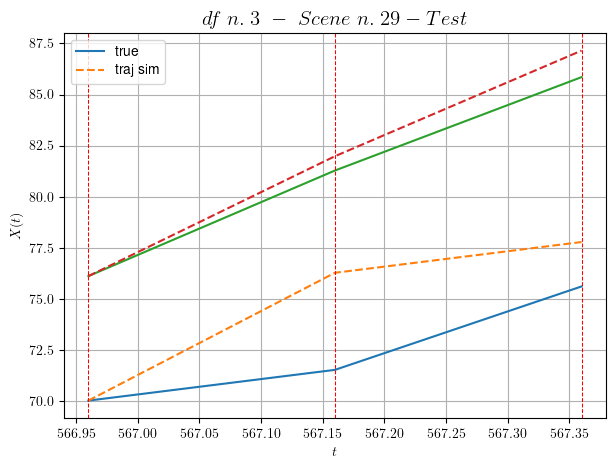

        For scene 29/30:
        * MSE = 4.920635107097986
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.30/30


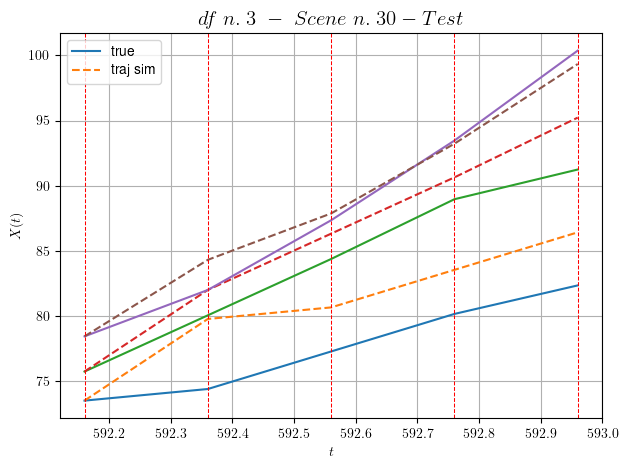

        For scene 30/30:
        * MSE = 6.755650186419068
----------------------------------------------------------------------------------------------------


MSE test: 3.3999871517143068

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.7276591223385267
          * MSE test: 3.3999871517143068
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 4/10 dfs.
In DataFrame n.4 we have 69 scenes.
    To train the model we use 46 scenes, the remaining 23 to test the model.

Training step. (46 scenes)
DataFrame n.4. Scene n.1/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [399.24,399.84]


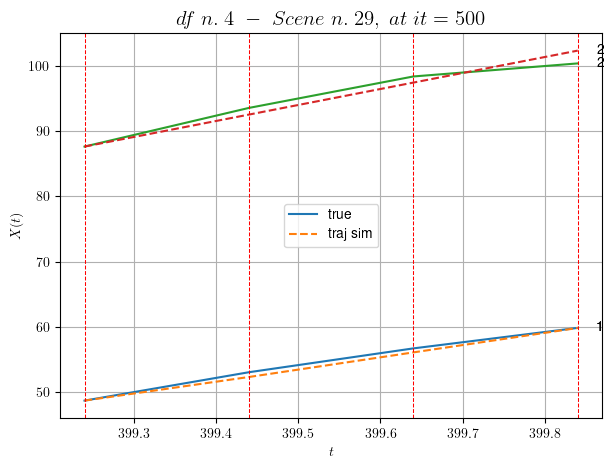

----------------------------------------------------------------------------------------------------
        For scene 1/46:
        * After LR finder: LR_NN=0.005 with mse=3.7822060544701377 at it=24
        * v0 = 24.51238647529525
        * MSE = 0.8334267002495269
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [128.24,129.24]


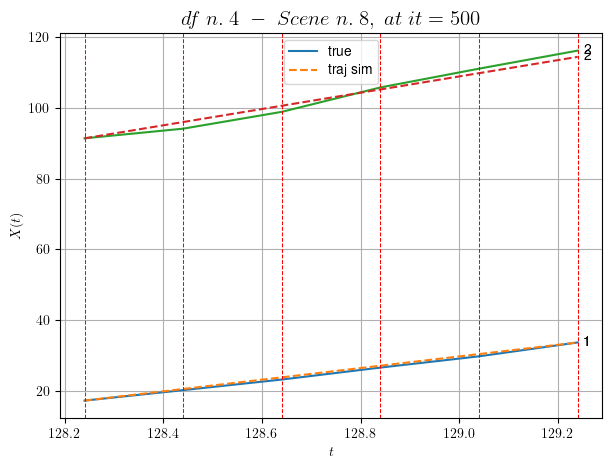

----------------------------------------------------------------------------------------------------
        For scene 2/46:
        * After LR finder: LR_NN=0.0001 with mse=7.60994502376696 at it=24
        * v0 = 23.00518102872587
        * MSE = 1.0067538358332402
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [556.24,556.64]


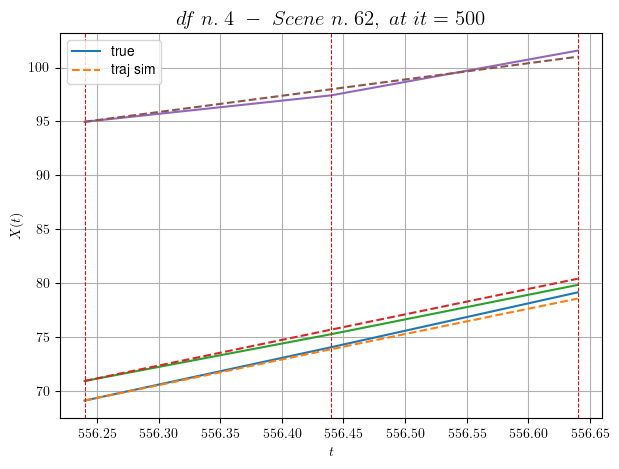

----------------------------------------------------------------------------------------------------
        For scene 3/46:
        * After LR finder: LR_NN=0.005 with mse=4.7306057151181 at it=24
        * v0 = 15.086092436632361
        * MSE = 0.1625019209186288
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [19.84,20.24]


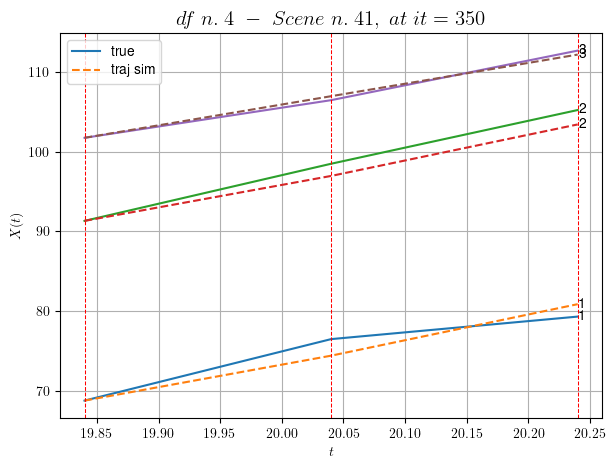

----------------------------------------------------------------------------------------------------
        For scene 4/46:
        * After LR finder: LR_NN=0.005 with mse=1.9750137139737338 at it=24
        * v0 = 26.058995147815473
        * MSE = 1.4216174584337686
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [230.84,232.24]


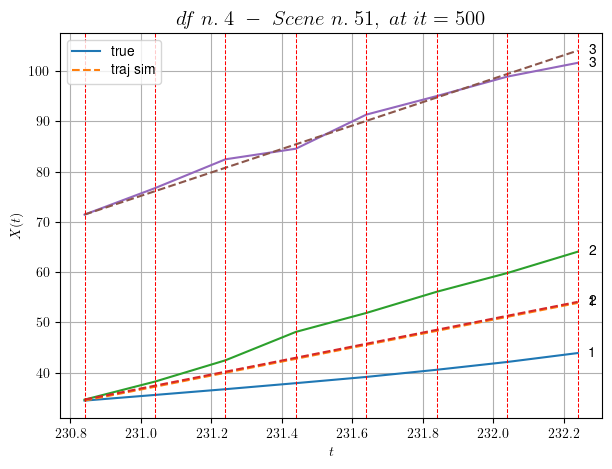

----------------------------------------------------------------------------------------------------
        For scene 5/46:
        * After LR finder: LR_NN=0.0005 with mse=20.46504486166202 at it=24
        * v0 = 23.322723002586773
        * MSE = 26.21988554501033
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [182.24,183.64]


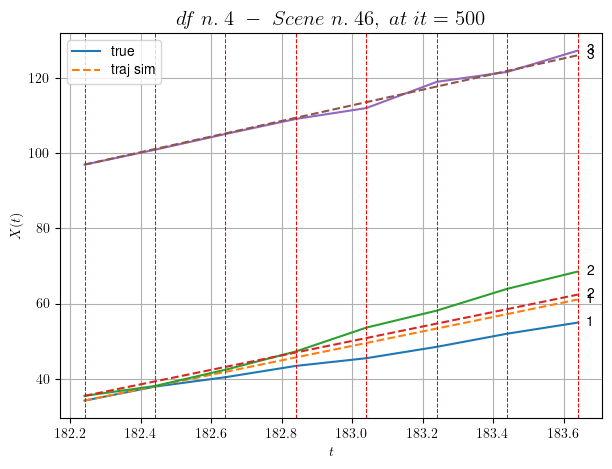

----------------------------------------------------------------------------------------------------
        For scene 6/46:
        * After LR finder: LR_NN=0.001 with mse=26.947457255288295 at it=24
        * v0 = 20.773199567272496
        * MSE = 8.601989208845117
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.7/46
----------------------------------------------------------------------------------------------------
We have 11 time intervals inside [266.84,269.04]


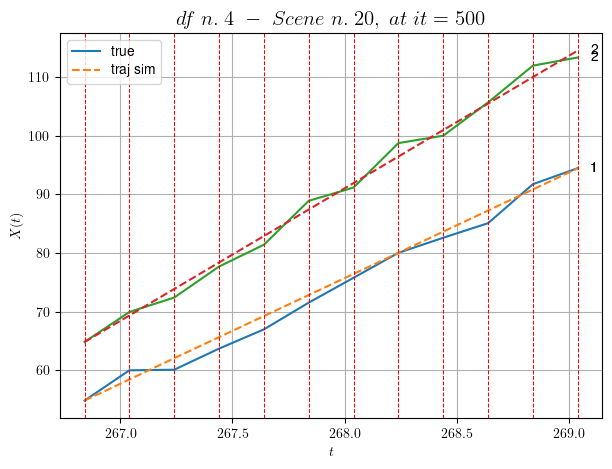

----------------------------------------------------------------------------------------------------
        For scene 7/46:
        * After LR finder: LR_NN=0.001 with mse=46.76638172492815 at it=24
        * v0 = 22.599995584638805
        * MSE = 1.7818547972731302
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.8/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [440.44,440.84]


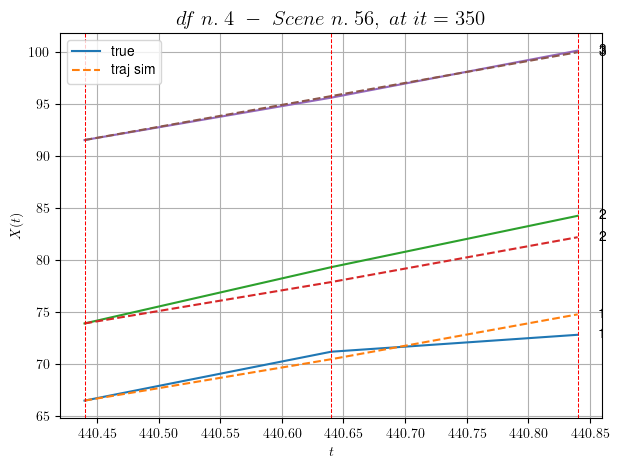

----------------------------------------------------------------------------------------------------
        For scene 8/46:
        * After LR finder: LR_NN=0.005 with mse=3.083024631950885 at it=24
        * v0 = 21.127058612420512
        * MSE = 1.1888673452231389
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.9/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [7.04,7.44]


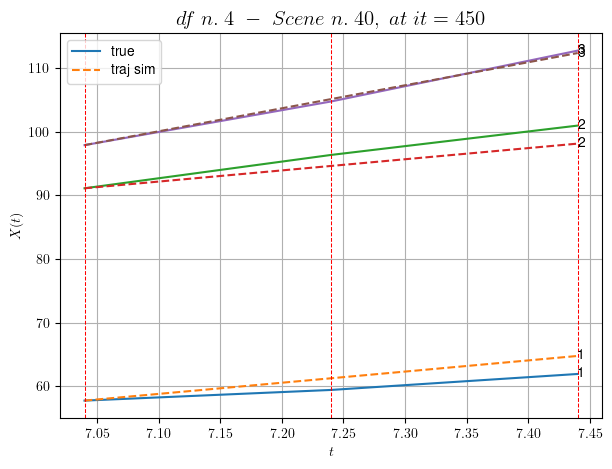

----------------------------------------------------------------------------------------------------
        For scene 9/46:
        * After LR finder: LR_NN=0.001 with mse=11.350660347370075 at it=24
        * v0 = 36.154229124863036
        * MSE = 2.5170832855875758
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.10/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [374.24,375.04]


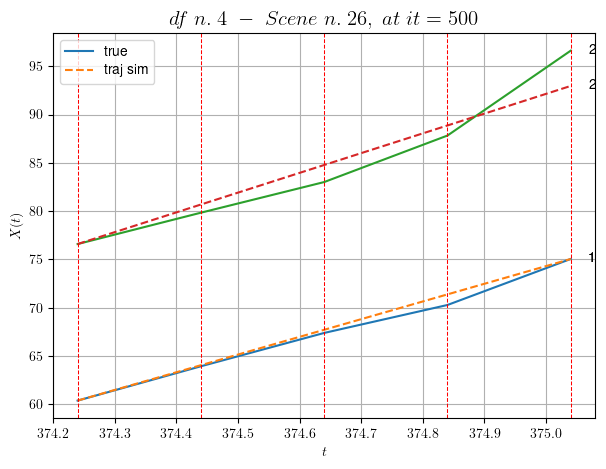

----------------------------------------------------------------------------------------------------
        For scene 10/46:
        * After LR finder: LR_NN=5e-05 with mse=10.119258071985115 at it=24
        * v0 = 20.475722036934272
        * MSE = 1.7459927232464478
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.11/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [584.84,585.44]


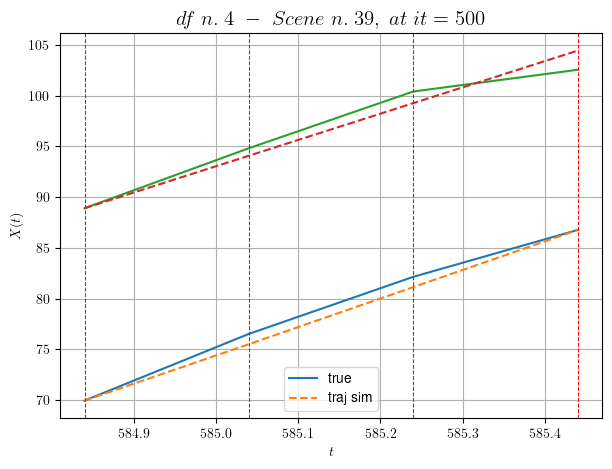

----------------------------------------------------------------------------------------------------
        For scene 11/46:
        * After LR finder: LR_NN=0.001 with mse=2.7596807709276607 at it=24
        * v0 = 25.88944052970651
        * MSE = 0.9340228093782437
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.12/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [176.24,177.24]


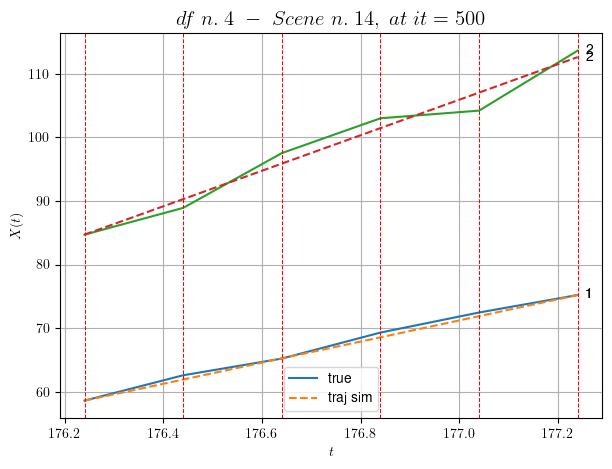

----------------------------------------------------------------------------------------------------
        For scene 12/46:
        * After LR finder: LR_NN=0.001 with mse=26.27266647660489 at it=24
        * v0 = 27.94819777081733
        * MSE = 1.4521353856378931
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.13/46
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [224.84,227.24]


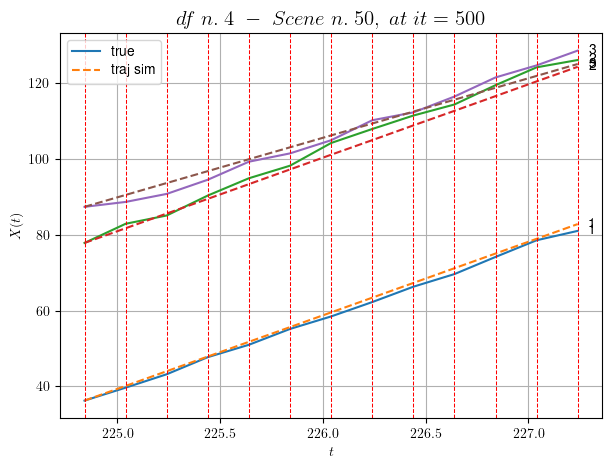

----------------------------------------------------------------------------------------------------
        For scene 13/46:
        * After LR finder: LR_NN=0.001 with mse=127.83632586757665 at it=24
        * v0 = 15.71367713005469
        * MSE = 2.9190915975780825
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.14/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [67.64,68.04]


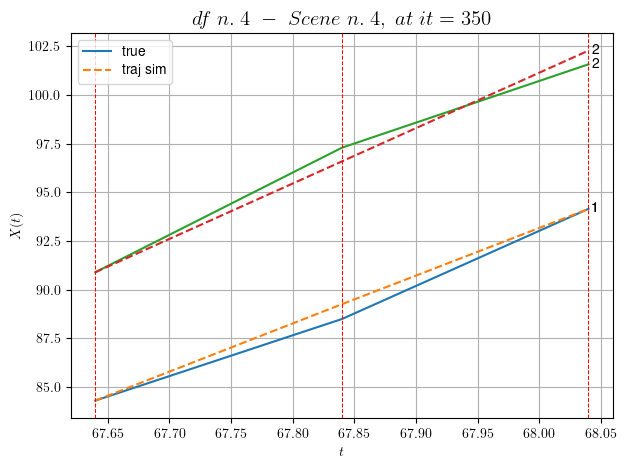

----------------------------------------------------------------------------------------------------
        For scene 14/46:
        * After LR finder: LR_NN=0.001 with mse=0.324686370542838 at it=24
        * v0 = 28.464980033502524
        * MSE = 0.26199219674606333
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.15/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [205.84,206.84]


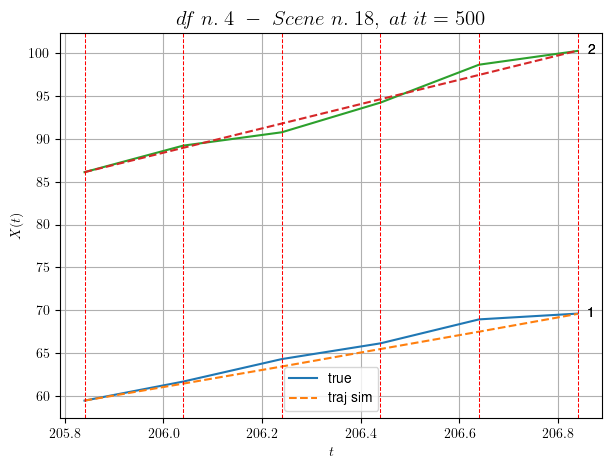

----------------------------------------------------------------------------------------------------
        For scene 15/46:
        * After LR finder: LR_NN=0.005 with mse=45.56540836607142 at it=24
        * v0 = 14.204943221368252
        * MSE = 0.49431616374701803
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.16/46
----------------------------------------------------------------------------------------------------
We have 15 time intervals inside [129.84,132.84]


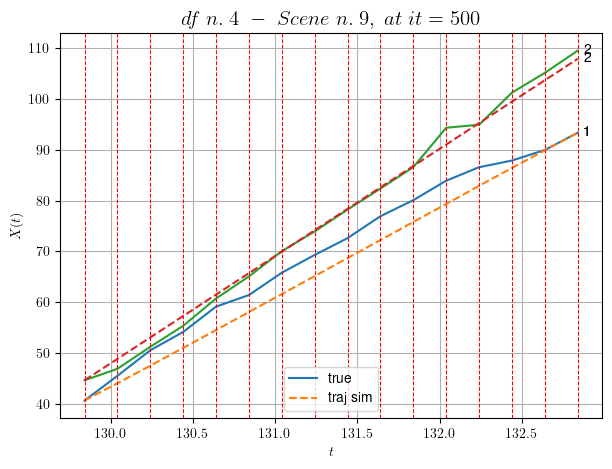

----------------------------------------------------------------------------------------------------
        For scene 16/46:
        * After LR finder: LR_NN=0.01 with mse=118.58323695202787 at it=24
        * v0 = 21.068534244852284
        * MSE = 4.01182312209531
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.17/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [422.64,423.64]


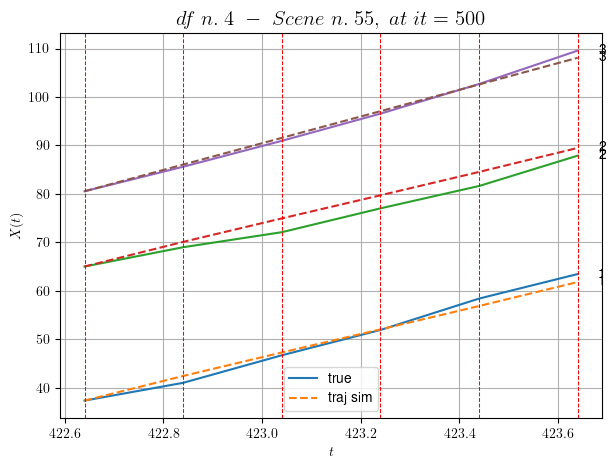

----------------------------------------------------------------------------------------------------
        For scene 17/46:
        * After LR finder: LR_NN=0.005 with mse=2.377127151866914 at it=24
        * v0 = 27.545089607777104
        * MSE = 2.102962877871685
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.18/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [122.84,123.84]


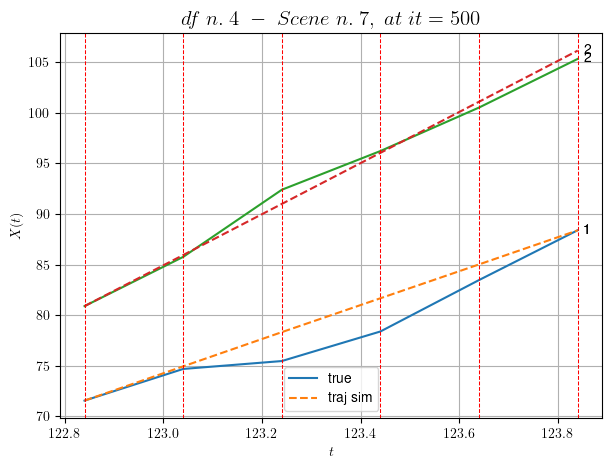

----------------------------------------------------------------------------------------------------
        For scene 18/46:
        * After LR finder: LR_NN=0.0005 with mse=5.363694799220066 at it=24
        * v0 = 25.259320008419433
        * MSE = 2.028320541675508
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.19/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [500.04,501.04]


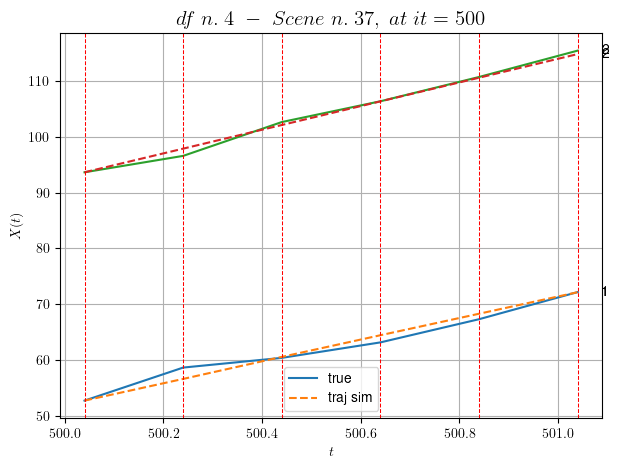

----------------------------------------------------------------------------------------------------
        For scene 19/46:
        * After LR finder: LR_NN=0.001 with mse=14.050123736112312 at it=24
        * v0 = 21.18957249510253
        * MSE = 0.7586385305708901
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.20/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [313.84,314.44]


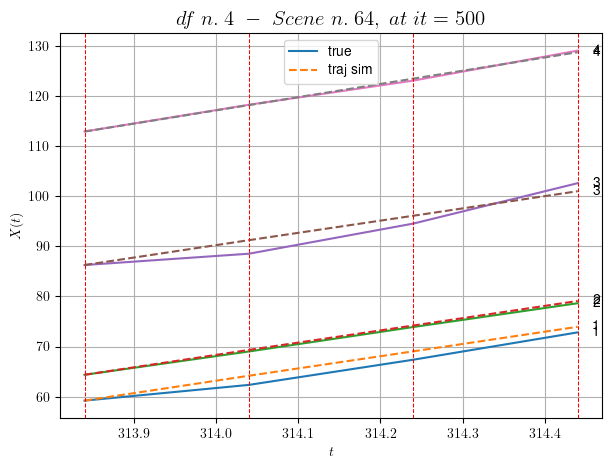

----------------------------------------------------------------------------------------------------
        For scene 20/46:
        * After LR finder: LR_NN=0.001 with mse=1.770982292895674 at it=24
        * v0 = 26.41552952480402
        * MSE = 1.2682782526452132
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.21/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [541.84,542.84]


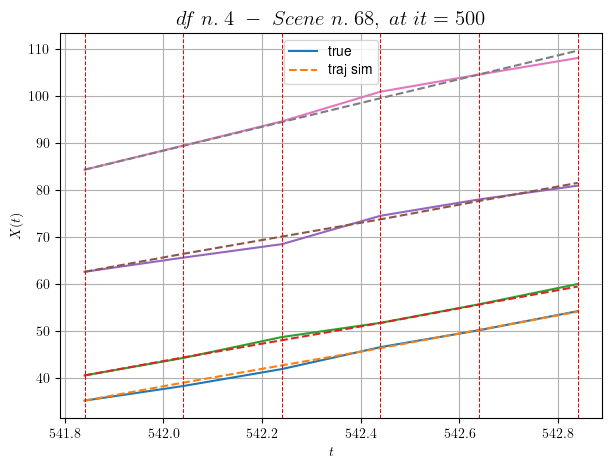

----------------------------------------------------------------------------------------------------
        For scene 21/46:
        * After LR finder: LR_NN=0.01 with mse=2.7488097584287647 at it=24
        * v0 = 25.311591600963585
        * MSE = 0.44480481507850744
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.22/46
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [195.44,197.24]


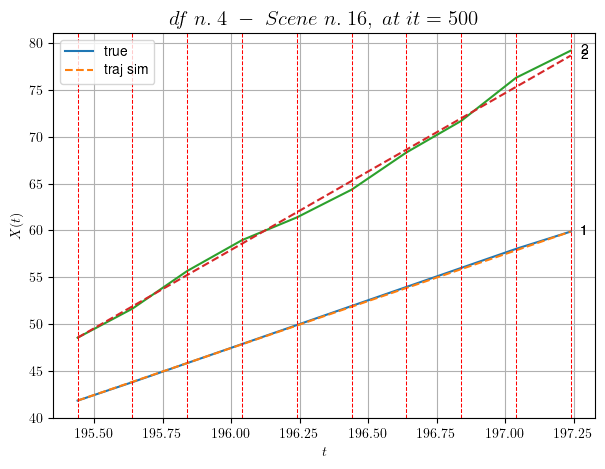

----------------------------------------------------------------------------------------------------
        For scene 22/46:
        * After LR finder: LR_NN=0.005 with mse=99.43027985005148 at it=24
        * v0 = 16.73844314065949
        * MSE = 0.14978501978024986
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.23/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [387.64,388.44]


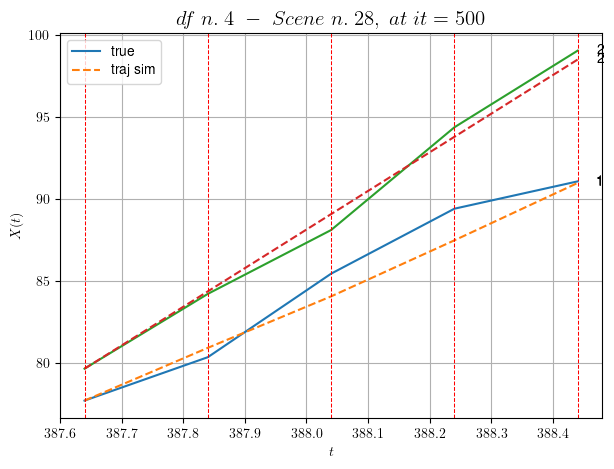

----------------------------------------------------------------------------------------------------
        For scene 23/46:
        * After LR finder: LR_NN=0.005 with mse=6.034207143135353 at it=24
        * v0 = 23.572406443207264
        * MSE = 0.7572191954015989
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.24/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [23.64,24.64]


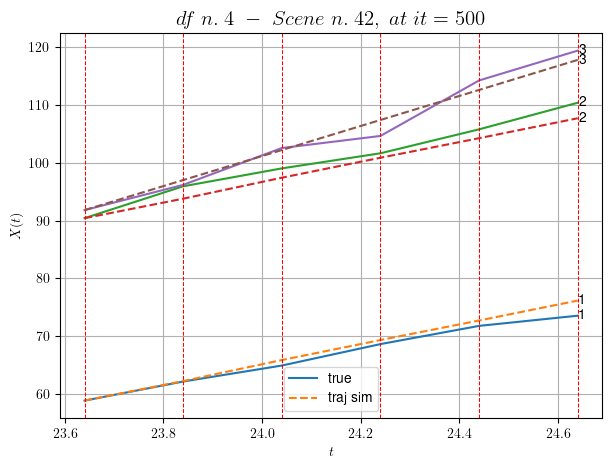

----------------------------------------------------------------------------------------------------
        For scene 24/46:
        * After LR finder: LR_NN=0.01 with mse=4.0179556000946866 at it=24
        * v0 = 25.97457555941859
        * MSE = 2.2098188371095344
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.25/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [378.64,379.24]


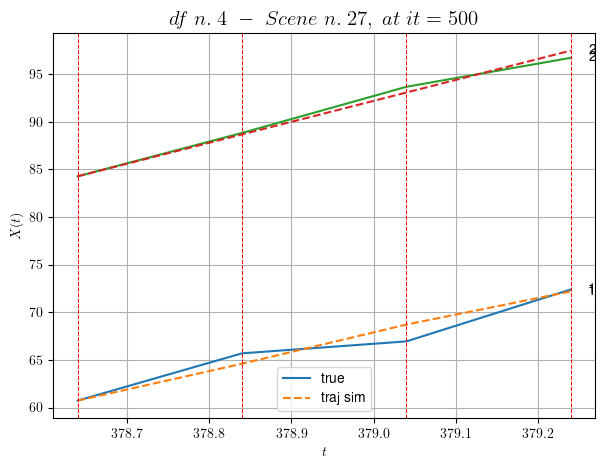

----------------------------------------------------------------------------------------------------
        For scene 25/46:
        * After LR finder: LR_NN=0.005 with mse=5.634812630835265 at it=24
        * v0 = 21.986682448765844
        * MSE = 0.6565850600381096
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.26/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [222.84,223.44]


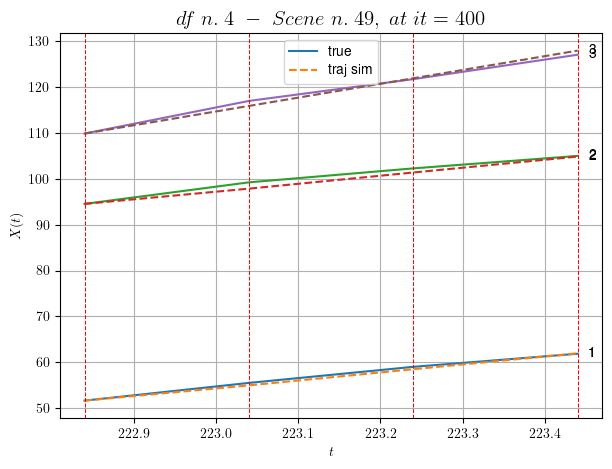

----------------------------------------------------------------------------------------------------
        For scene 26/46:
        * After LR finder: LR_NN=0.005 with mse=0.4645968564193271 at it=24
        * v0 = 30.10792852352005
        * MSE = 0.37374788178540214
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.27/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [321.84,323.84]


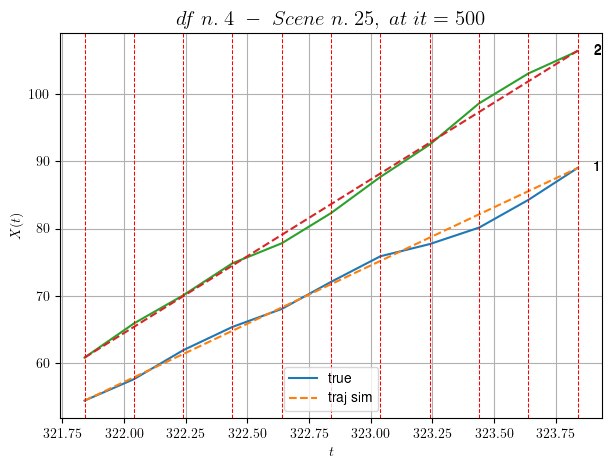

----------------------------------------------------------------------------------------------------
        For scene 27/46:
        * After LR finder: LR_NN=0.001 with mse=36.290908525550364 at it=24
        * v0 = 22.81009773351758
        * MSE = 0.6765381529843184
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.28/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [520.04,521.64]


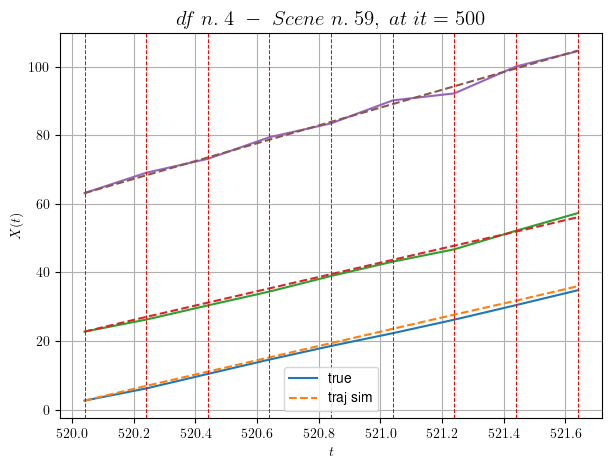

----------------------------------------------------------------------------------------------------
        For scene 28/46:
        * After LR finder: LR_NN=0.01 with mse=5.877197346826965 at it=24
        * v0 = 25.962807327177217
        * MSE = 0.7917102784037984
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.29/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [575.04,575.84]


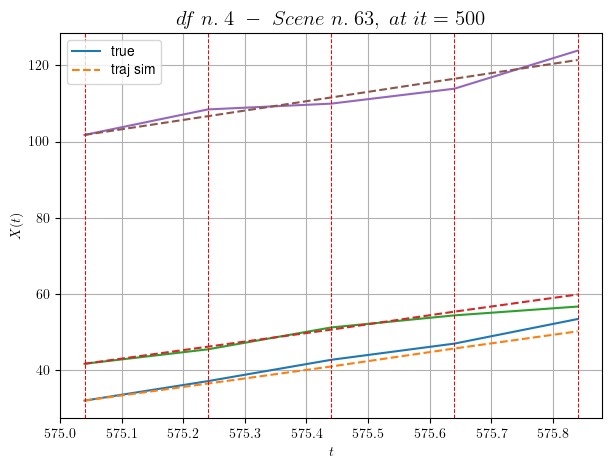

----------------------------------------------------------------------------------------------------
        For scene 29/46:
        * After LR finder: LR_NN=0.005 with mse=5.423131726375299 at it=24
        * v0 = 24.545621507401968
        * MSE = 3.0568737558286454
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.30/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [153.04,153.44]


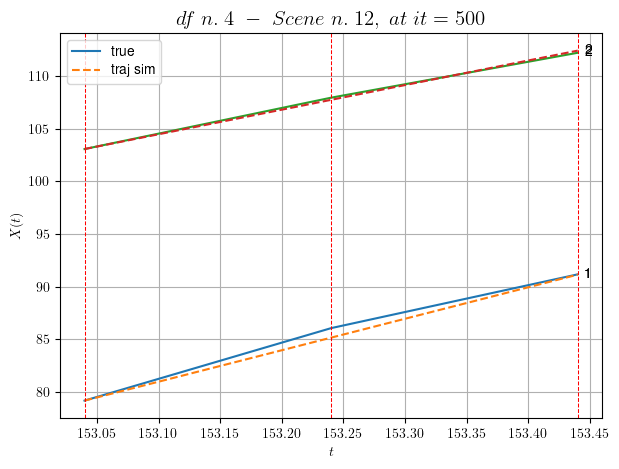

----------------------------------------------------------------------------------------------------
        For scene 30/46:
        * After LR finder: LR_NN=5e-05 with mse=1.6538244478178379 at it=24
        * v0 = 23.38510904852379
        * MSE = 0.15013284279343309
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.31/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [419.84,421.84]


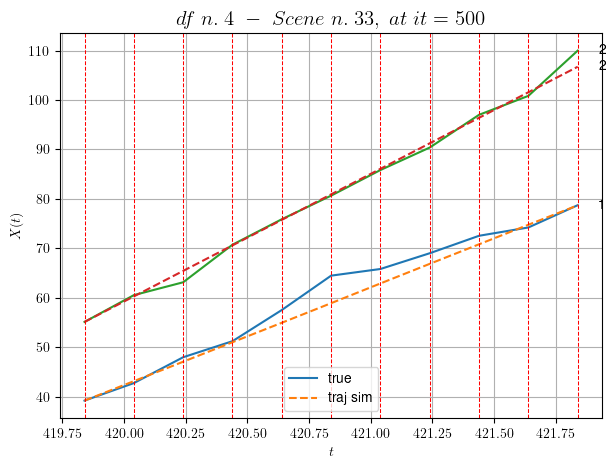

----------------------------------------------------------------------------------------------------
        For scene 31/46:
        * After LR finder: LR_NN=0.001 with mse=14.480611649116065 at it=24
        * v0 = 25.806420226564263
        * MSE = 3.291521225459392
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.32/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [462.64,463.04]


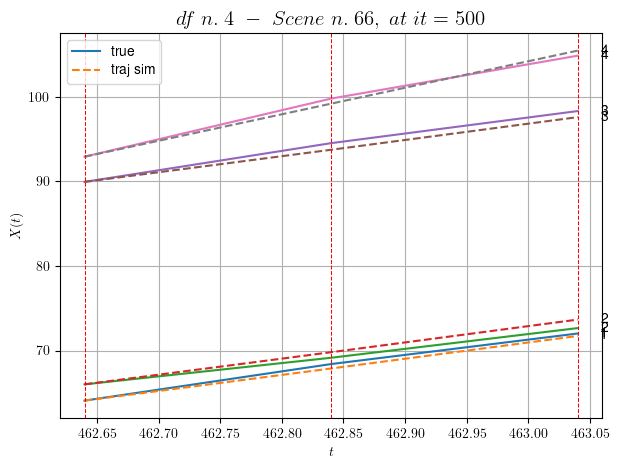

----------------------------------------------------------------------------------------------------
        For scene 32/46:
        * After LR finder: LR_NN=0.005 with mse=0.3660834862298348 at it=24
        * v0 = 31.352447205664888
        * MSE = 0.2997501332848085
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.33/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [495.24,495.84]


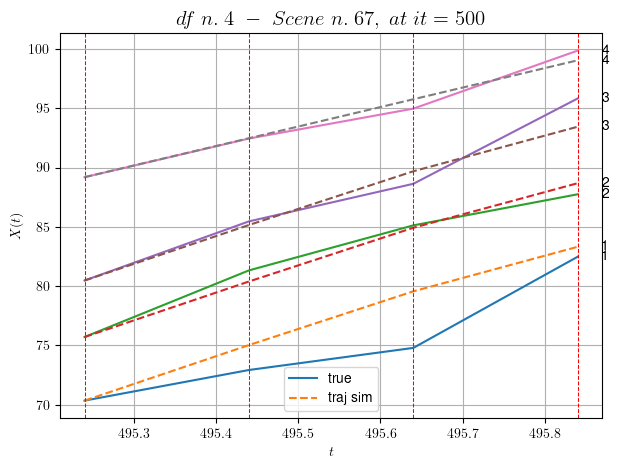

----------------------------------------------------------------------------------------------------
        For scene 33/46:
        * After LR finder: LR_NN=0.01 with mse=8.80840454701689 at it=24
        * v0 = 16.437805482236033
        * MSE = 2.3422312074646574
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.34/46
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [566.84,569.24]


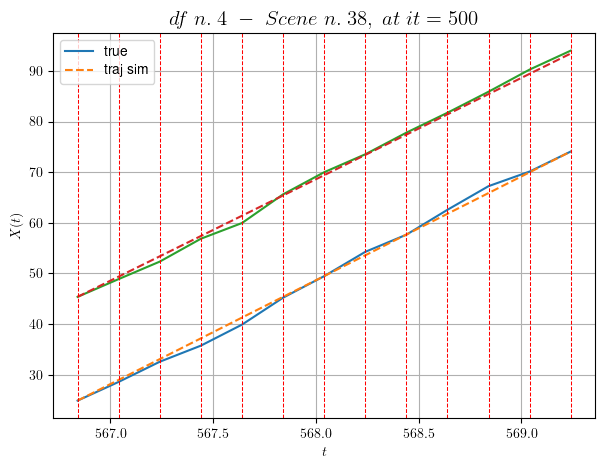

----------------------------------------------------------------------------------------------------
        For scene 34/46:
        * After LR finder: LR_NN=5e-05 with mse=96.5223456272562 at it=24
        * v0 = 20.02848758219776
        * MSE = 0.46021503922561546
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.35/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [406.24,406.64]


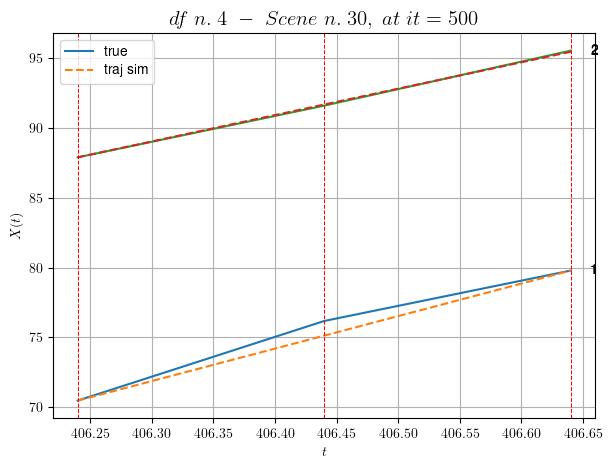

----------------------------------------------------------------------------------------------------
        For scene 35/46:
        * After LR finder: LR_NN=0.0001 with mse=4.173834033075396 at it=24
        * v0 = 18.926519541434423
        * MSE = 0.18551365493650115
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.36/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [89.04,89.84]


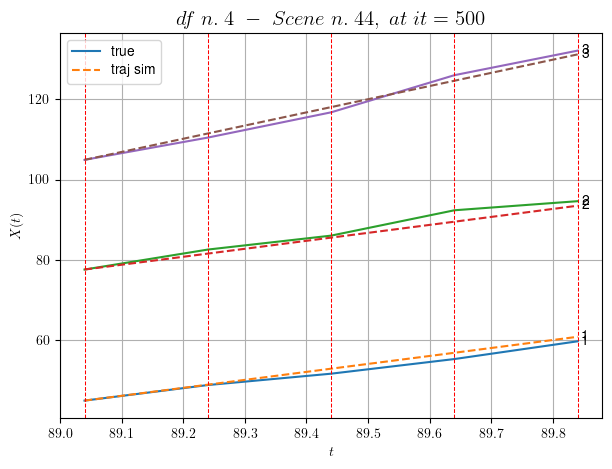

----------------------------------------------------------------------------------------------------
        For scene 36/46:
        * After LR finder: LR_NN=0.0005 with mse=2.3750130251600674 at it=24
        * v0 = 32.77543163260234
        * MSE = 1.421123879210441
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.37/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [460.84,461.24]


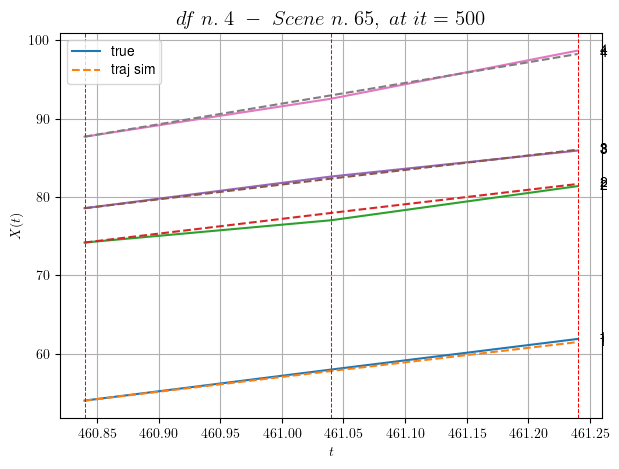

----------------------------------------------------------------------------------------------------
        For scene 37/46:
        * After LR finder: LR_NN=0.01 with mse=0.29670234223241015 at it=24
        * v0 = 26.404314529227058
        * MSE = 0.13158546394366255
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.38/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [59.84,60.44]


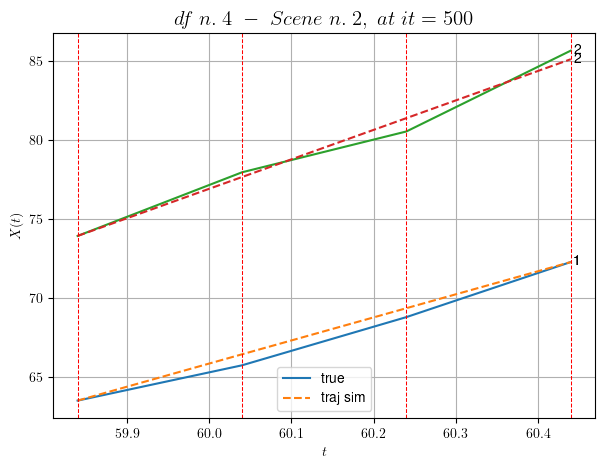

----------------------------------------------------------------------------------------------------
        For scene 38/46:
        * After LR finder: LR_NN=0.0005 with mse=9.174842986799144 at it=24
        * v0 = 18.625518273300347
        * MSE = 0.23718296289095298
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.39/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [302.44,302.84]


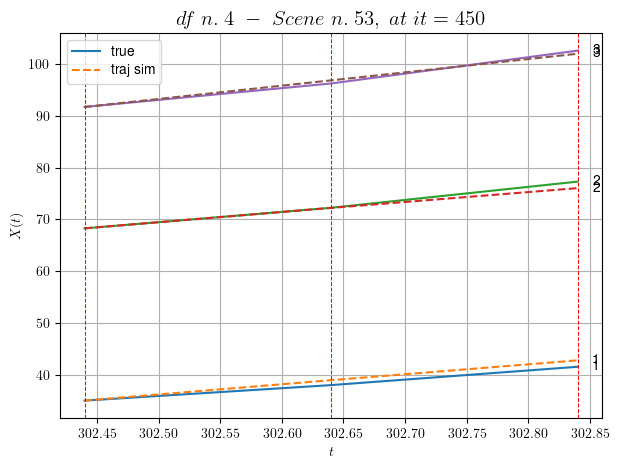

----------------------------------------------------------------------------------------------------
        For scene 39/46:
        * After LR finder: LR_NN=0.005 with mse=0.823156950368587 at it=24
        * v0 = 25.744539084389743
        * MSE = 0.5256882449046237
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.40/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [288.04,289.04]


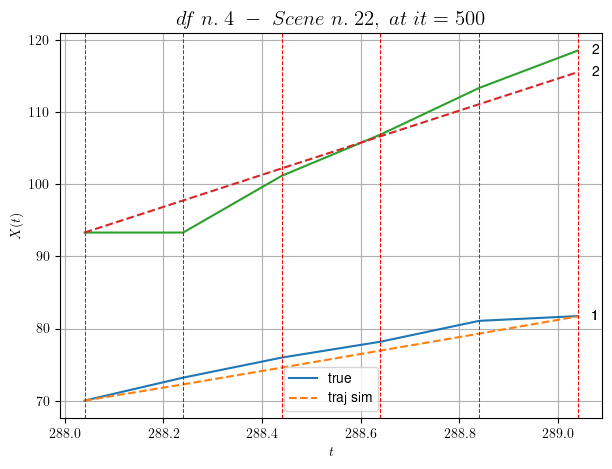

----------------------------------------------------------------------------------------------------
        For scene 40/46:
        * After LR finder: LR_NN=0.005 with mse=10.276043770493272 at it=24
        * v0 = 22.24789971530882
        * MSE = 3.1995474300785016
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.41/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [65.04,65.64]


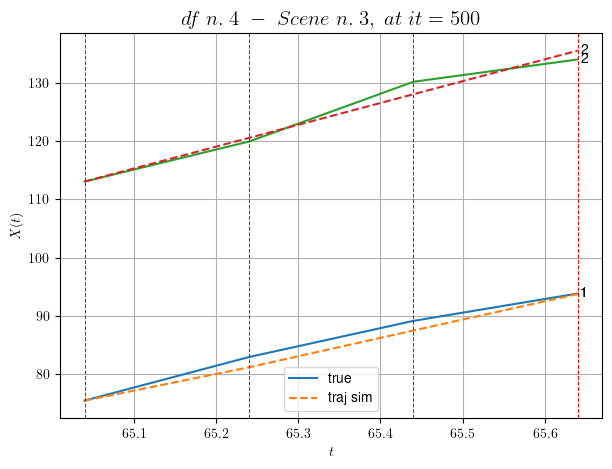

----------------------------------------------------------------------------------------------------
        For scene 41/46:
        * After LR finder: LR_NN=0.005 with mse=5.426387835401657 at it=24
        * v0 = 37.41903742148324
        * MSE = 1.6212530854330327
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.42/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [320.44,321.04]


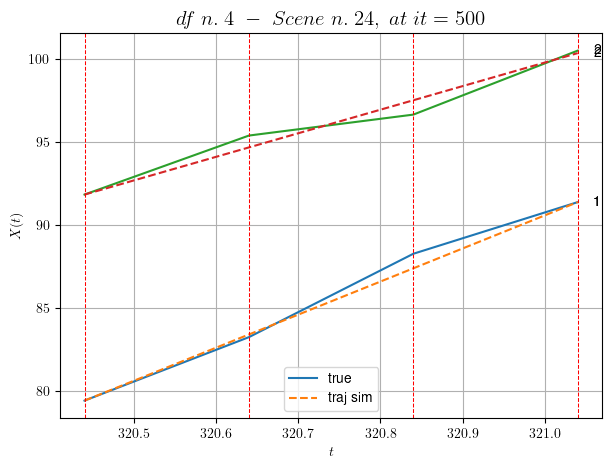

----------------------------------------------------------------------------------------------------
        For scene 42/46:
        * After LR finder: LR_NN=0.0001 with mse=18.23398874173245 at it=24
        * v0 = 14.162426648992758
        * MSE = 0.23752293882435987
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.43/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [285.84,287.44]


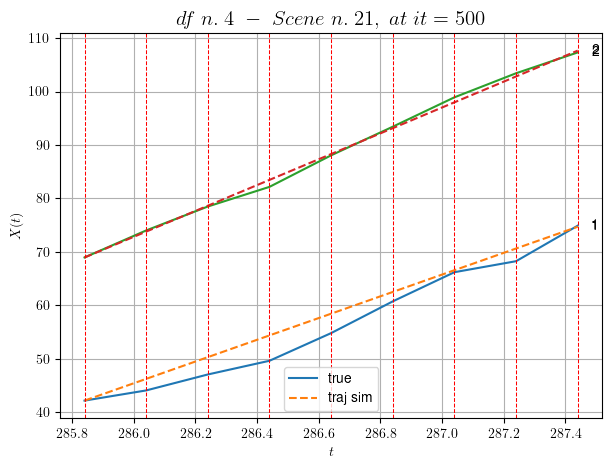

----------------------------------------------------------------------------------------------------
        For scene 43/46:
        * After LR finder: LR_NN=1e-05 with mse=16.782696373741345 at it=24
        * v0 = 24.201830847422865
        * MSE = 3.133004183252392
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.44/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [554.64,555.04]


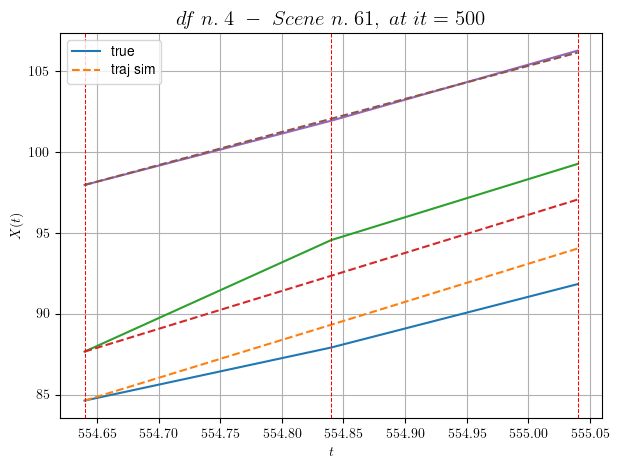

----------------------------------------------------------------------------------------------------
        For scene 44/46:
        * After LR finder: LR_NN=0.001 with mse=2.8013415074326677 at it=24
        * v0 = 20.44072781876368
        * MSE = 1.8372667749004536
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.45/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [182.04,183.64]


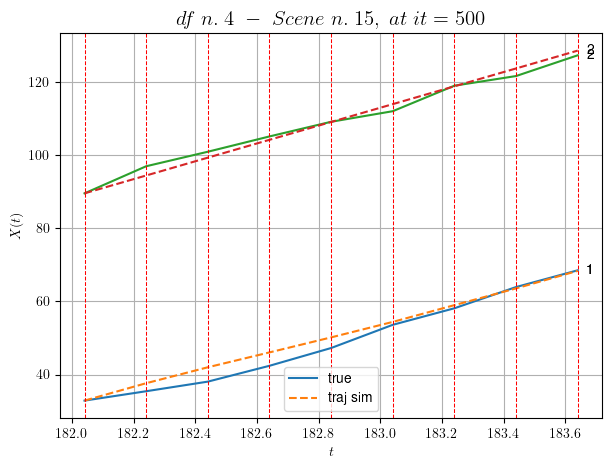

----------------------------------------------------------------------------------------------------
        For scene 45/46:
        * After LR finder: LR_NN=0.01 with mse=19.549475033039702 at it=24
        * v0 = 24.384953428579923
        * MSE = 2.3164791577161856
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.46/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [233.84,235.24]


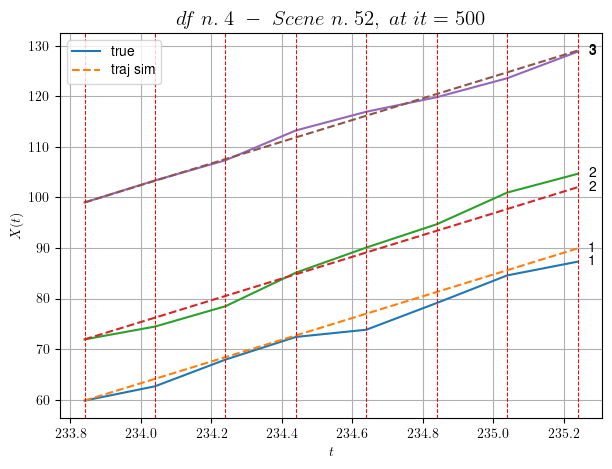

----------------------------------------------------------------------------------------------------
        For scene 46/46:
        * After LR finder: LR_NN=0.0005 with mse=20.068329757599653 at it=24
        * v0 = 21.462806471988227
        * MSE = 2.3835844057802915
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 2.0565704331538326
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (23 scenes)
DataFrame n.4. Scene n.1/23


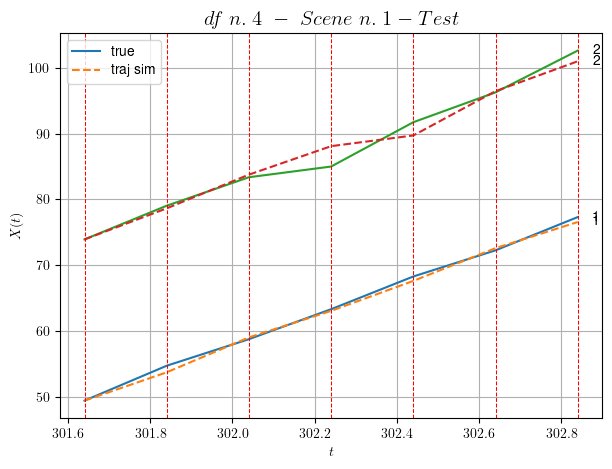

        For scene 1/23:
        * MSE = 1.351952158484461
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/23


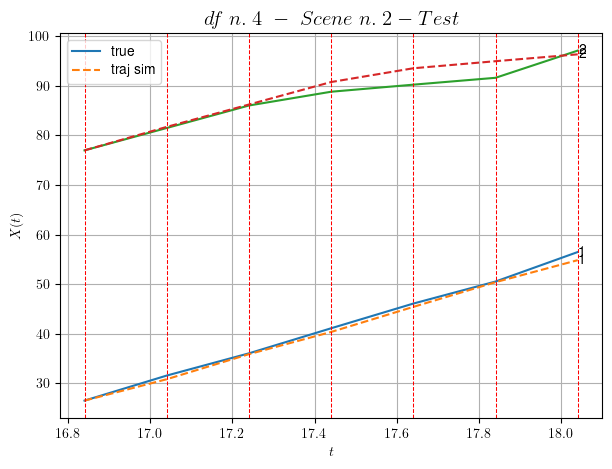

        For scene 2/23:
        * MSE = 2.2043737614849825
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/23


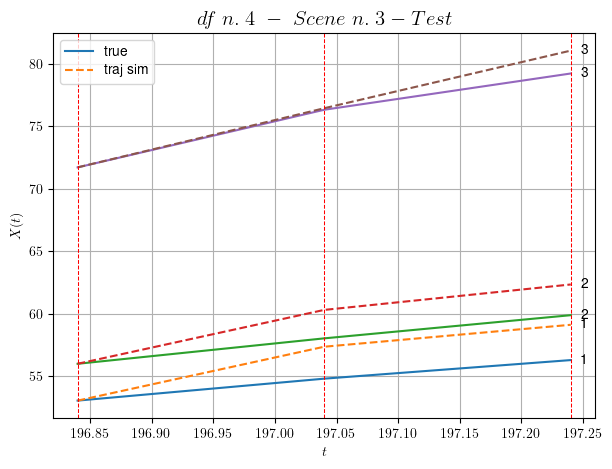

        For scene 3/23:
        * MSE = 3.2264893115819113
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/23


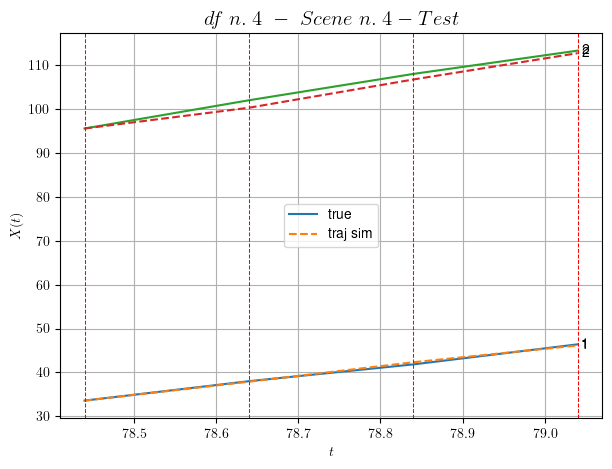

        For scene 4/23:
        * MSE = 0.643160166497198
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/23


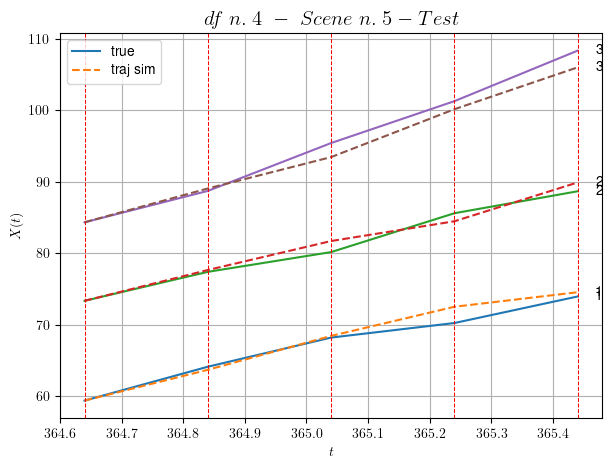

        For scene 5/23:
        * MSE = 1.4475158974204134
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/23


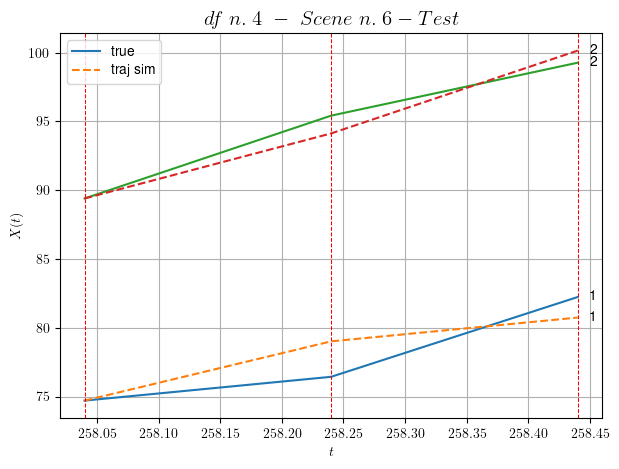

        For scene 6/23:
        * MSE = 1.885484556628627
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.7/23


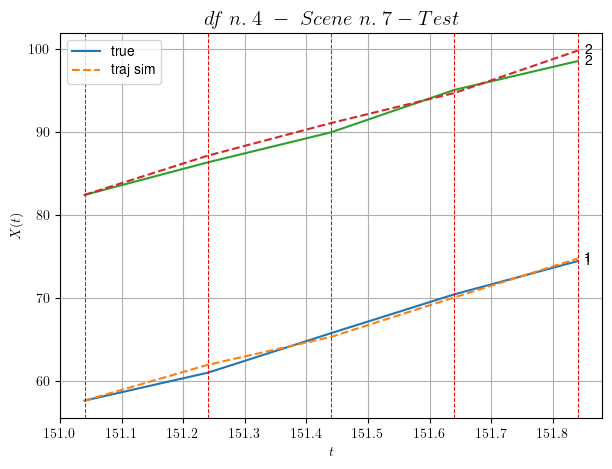

        For scene 7/23:
        * MSE = 0.49543624930174657
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.8/23


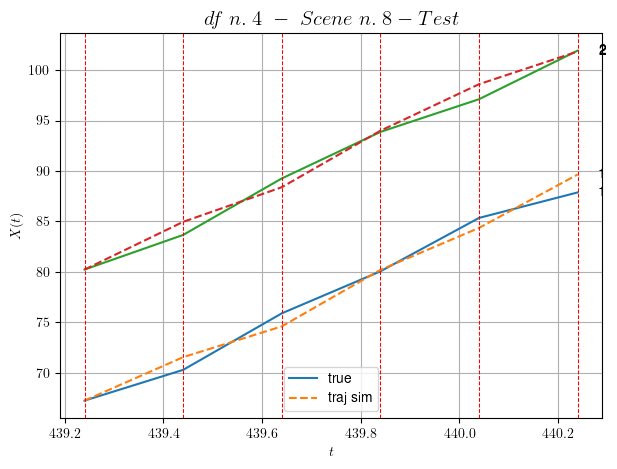

        For scene 8/23:
        * MSE = 1.007748548579114
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.9/23


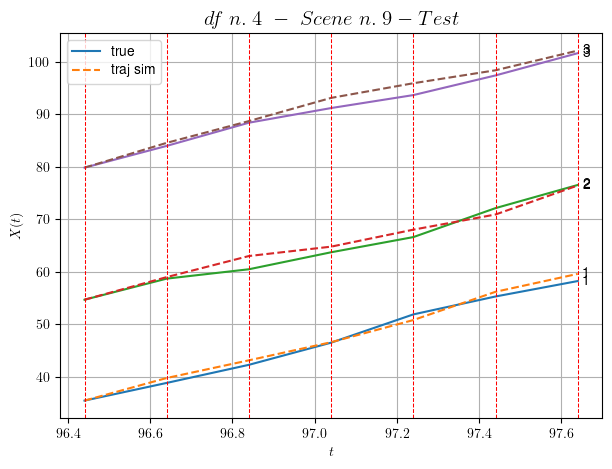

        For scene 9/23:
        * MSE = 1.2863470732969151
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.10/23


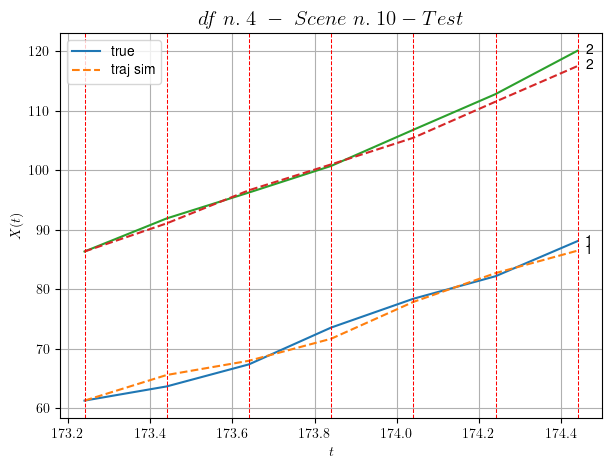

        For scene 10/23:
        * MSE = 1.5505036735641857
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.11/23


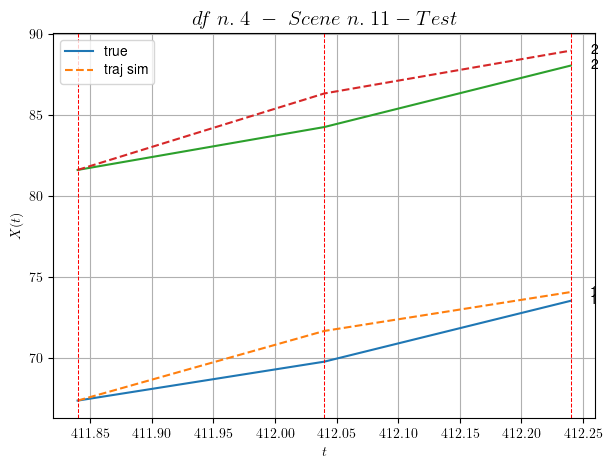

        For scene 11/23:
        * MSE = 1.5110005715975108
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.12/23


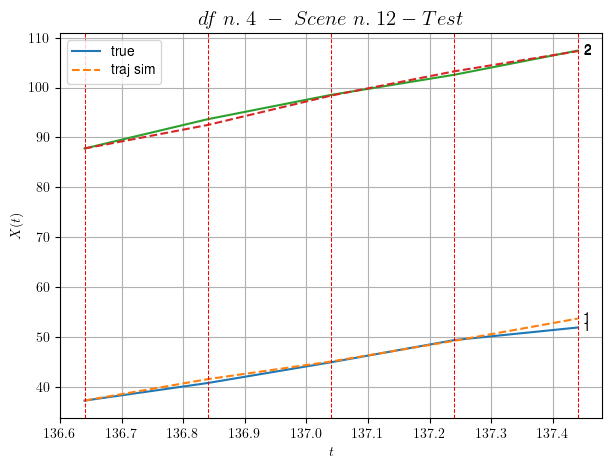

        For scene 12/23:
        * MSE = 0.5678690948244403
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.13/23


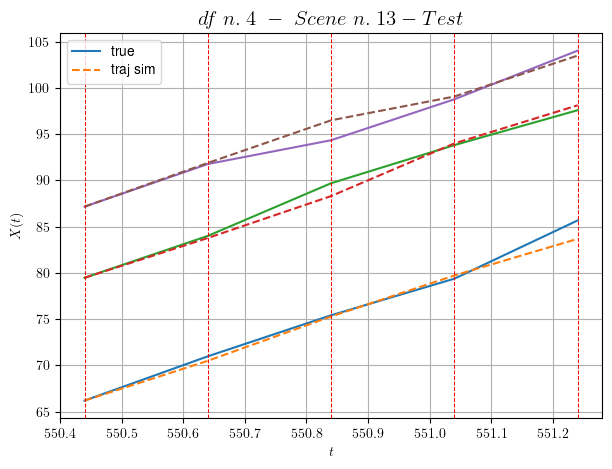

        For scene 13/23:
        * MSE = 0.7786514484523996
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.14/23


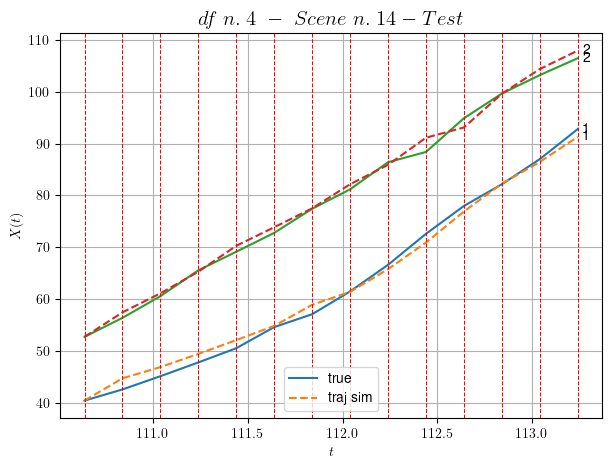

        For scene 14/23:
        * MSE = 1.5294387600391377
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.15/23


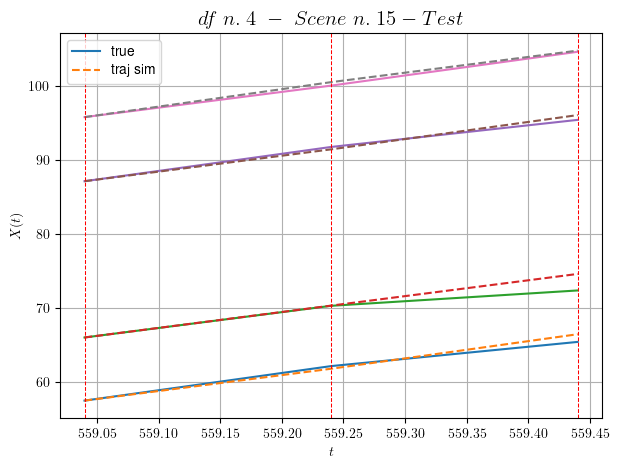

        For scene 15/23:
        * MSE = 0.5794603768835815
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.16/23


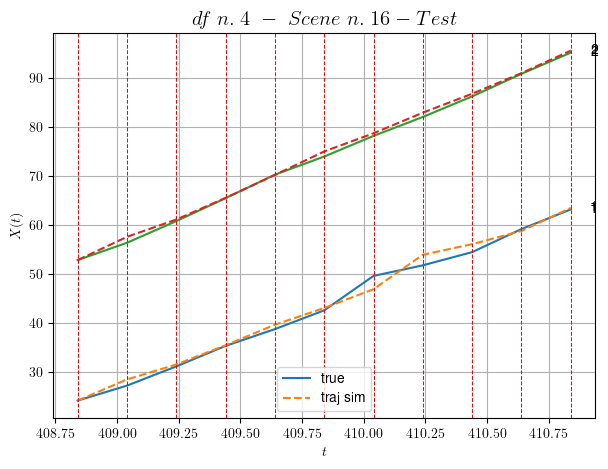

        For scene 16/23:
        * MSE = 0.9891447949379358
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.17/23


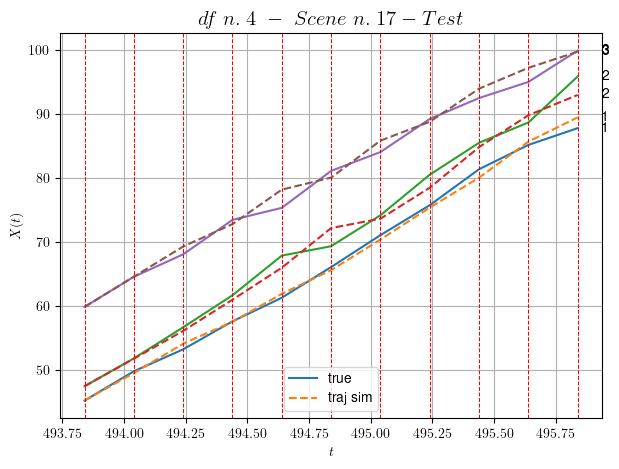

        For scene 17/23:
        * MSE = 1.6780084086510438
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.18/23


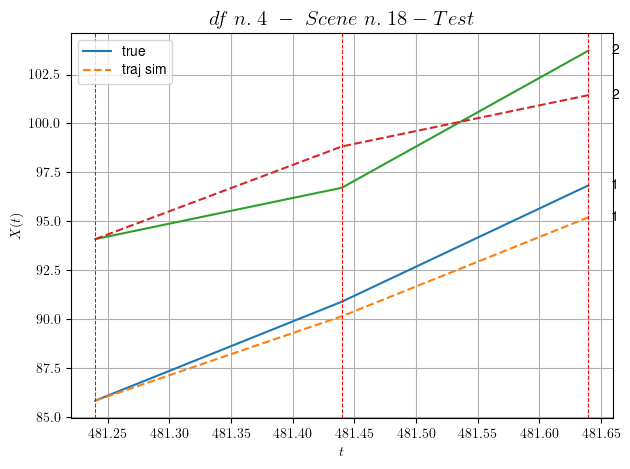

        For scene 18/23:
        * MSE = 2.1373192402751995
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.19/23


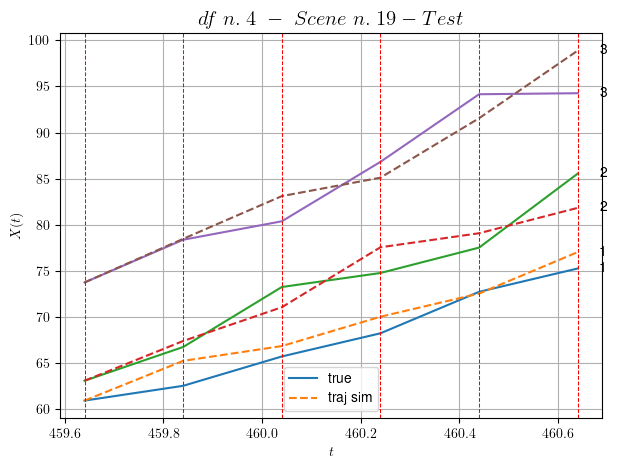

        For scene 19/23:
        * MSE = 4.593921969563521
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.20/23


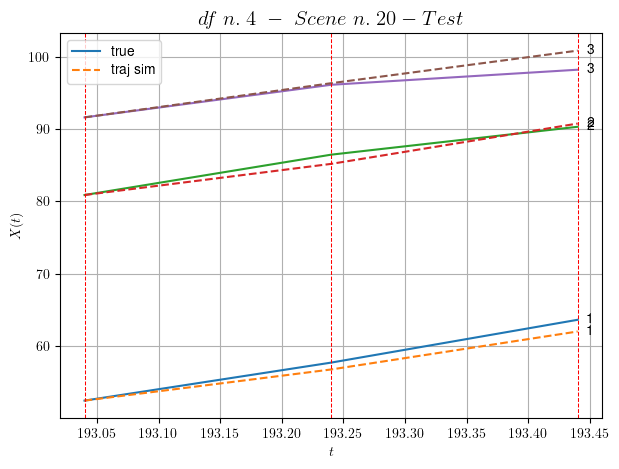

        For scene 20/23:
        * MSE = 1.3748005042085378
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.21/23


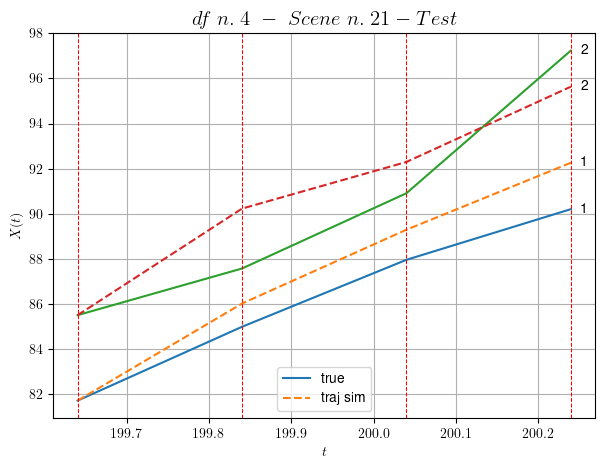

        For scene 21/23:
        * MSE = 2.331027538904954
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.22/23


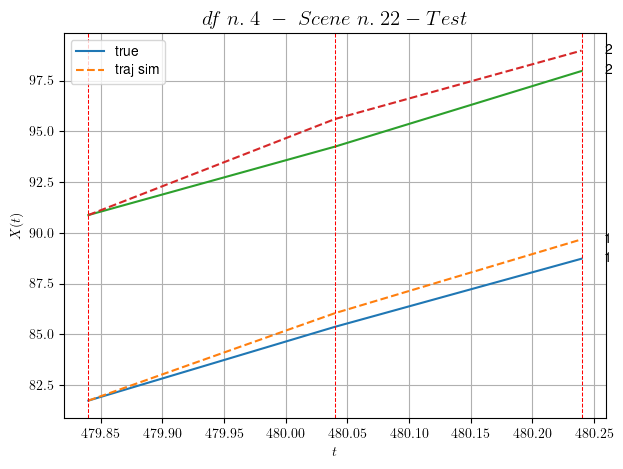

        For scene 22/23:
        * MSE = 0.7023935627960736
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.23/23


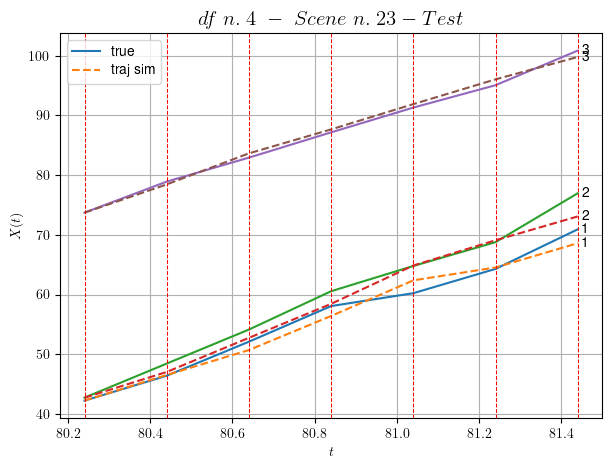

        For scene 23/23:
        * MSE = 1.9875797355698361
----------------------------------------------------------------------------------------------------


MSE test: 1.559114234936684

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 2.0565704331538326
          * MSE test: 1.559114234936684
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 5/10 dfs.
In DataFrame n.5 we have 66 scenes.
    To train the model we use 44 scenes, the remaining 22 to test the model.

Training step. (44 scenes)
DataFrame n.5. Scene n.1/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [64.32,65.32]


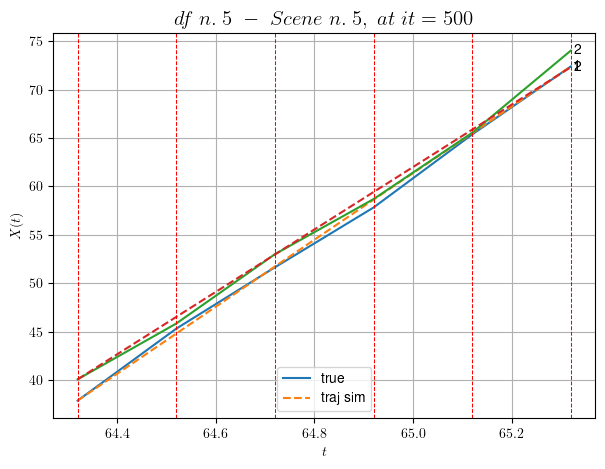

----------------------------------------------------------------------------------------------------
        For scene 1/44:
        * After LR finder: LR_NN=0.001 with mse=1.7289391116388757 at it=24
        * v0 = 32.233878573413385
        * MSE = 0.41431728861017997
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [502.72,503.72]


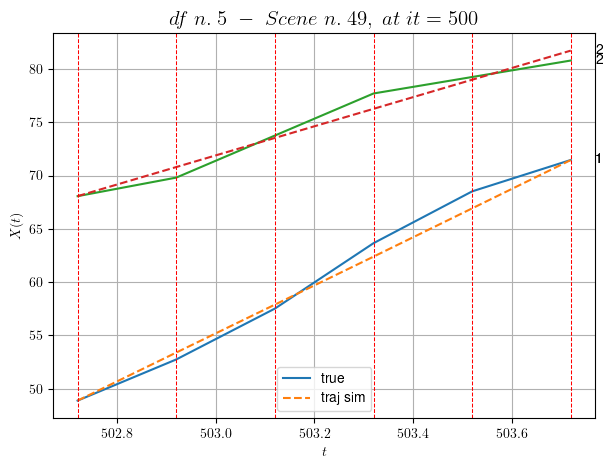

----------------------------------------------------------------------------------------------------
        For scene 2/44:
        * After LR finder: LR_NN=0.0005 with mse=50.61863149809332 at it=24
        * v0 = 13.651414022050073
        * MSE = 0.7241614945085317
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [395.32,395.72]


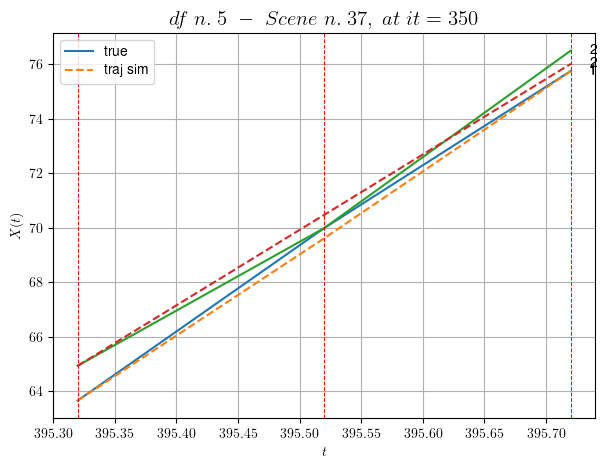

----------------------------------------------------------------------------------------------------
        For scene 3/44:
        * After LR finder: LR_NN=0.005 with mse=0.21198161125972387 at it=24
        * v0 = 27.69921331573338
        * MSE = 0.09778627040037013
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [225.72,226.12]


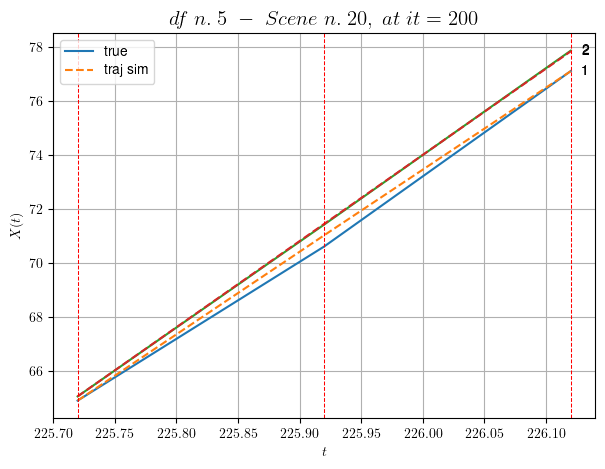

----------------------------------------------------------------------------------------------------
        For scene 4/44:
        * After LR finder: LR_NN=0.001 with mse=0.1400145207029213 at it=24
        * v0 = 32.021407180302184
        * MSE = 0.02882202592248822
        * iterations = 200
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [177.32,178.52]


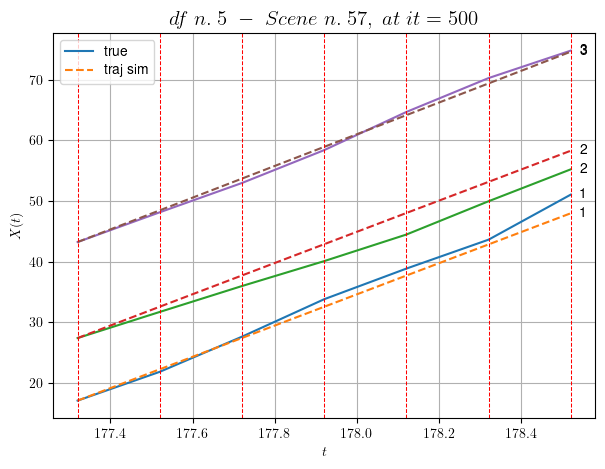

----------------------------------------------------------------------------------------------------
        For scene 5/44:
        * After LR finder: LR_NN=0.001 with mse=5.300776298801008 at it=24
        * v0 = 26.180378384786586
        * MSE = 2.8138069637841006
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [319.52,319.92]


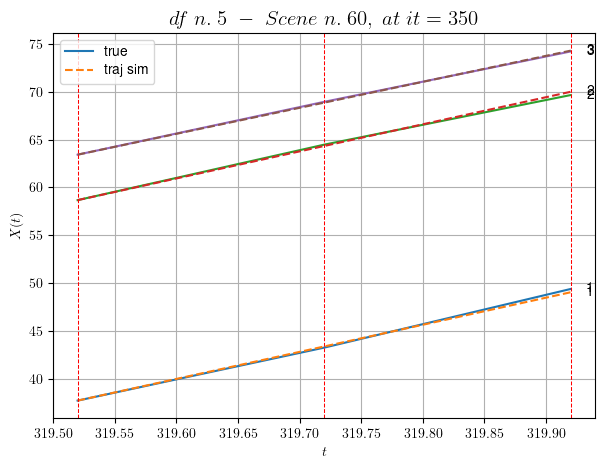

----------------------------------------------------------------------------------------------------
        For scene 6/44:
        * After LR finder: LR_NN=0.01 with mse=0.20895297818180084 at it=24
        * v0 = 27.222480010443164
        * MSE = 0.03174675907261191
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.7/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [316.92,317.32]


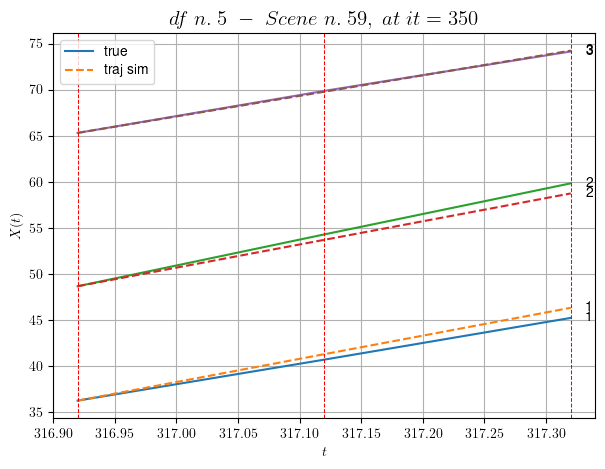

----------------------------------------------------------------------------------------------------
        For scene 7/44:
        * After LR finder: LR_NN=0.0005 with mse=1.3626968415952636 at it=24
        * v0 = 22.342101196301837
        * MSE = 0.3460985846091115
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.8/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [533.12,533.52]


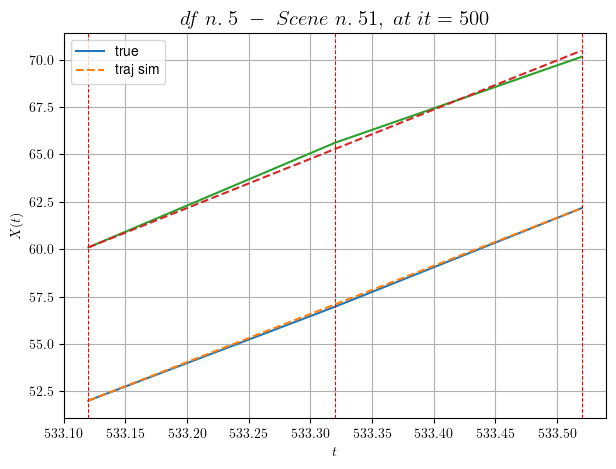

----------------------------------------------------------------------------------------------------
        For scene 8/44:
        * After LR finder: LR_NN=0.0001 with mse=0.6727568038941338 at it=24
        * v0 = 25.94872029249367
        * MSE = 0.038551310304560285
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.9/44
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [332.72,334.12]


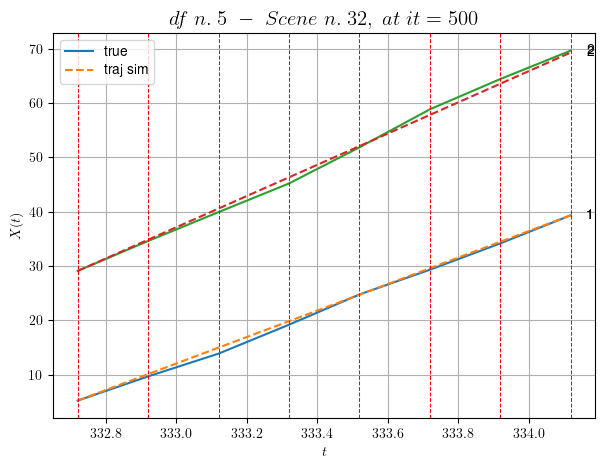

----------------------------------------------------------------------------------------------------
        For scene 9/44:
        * After LR finder: LR_NN=0.0005 with mse=0.6834140833601178 at it=24
        * v0 = 28.714685816754475
        * MSE = 0.33766387304469847
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.10/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [457.32,458.32]


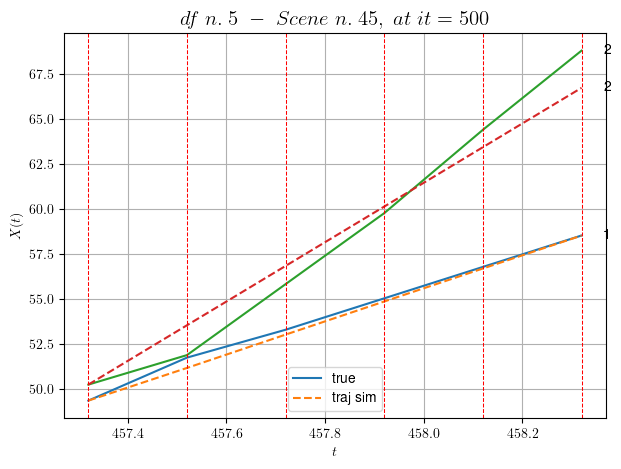

----------------------------------------------------------------------------------------------------
        For scene 10/44:
        * After LR finder: LR_NN=0.005 with mse=30.009156351350846 at it=24
        * v0 = 16.493097805853914
        * MSE = 0.6625152505567075
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.11/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [578.92,579.52]


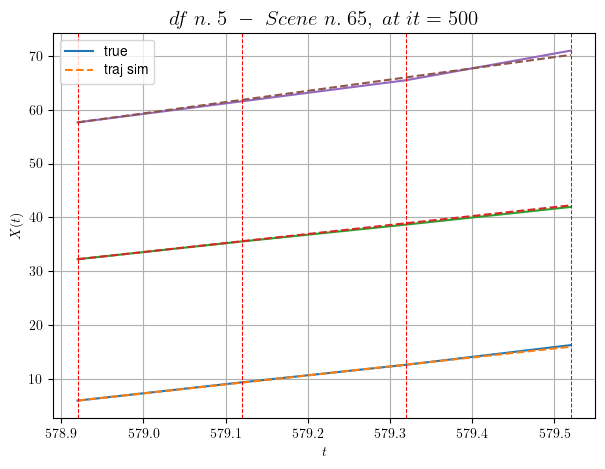

----------------------------------------------------------------------------------------------------
        For scene 11/44:
        * After LR finder: LR_NN=0.005 with mse=3.6381711683594857 at it=24
        * v0 = 20.916611347753545
        * MSE = 0.09542886329563327
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.12/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [167.32,167.72]


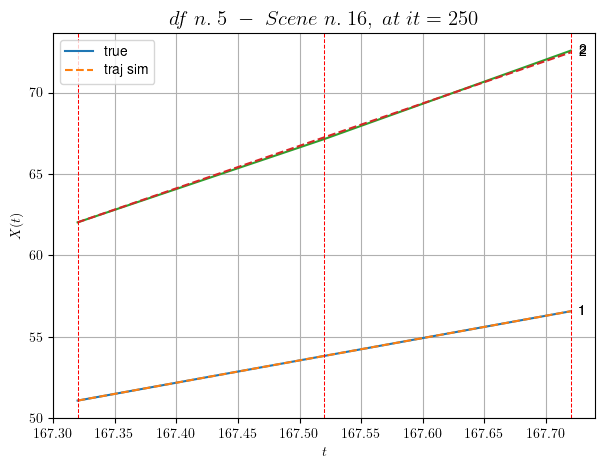

----------------------------------------------------------------------------------------------------
        For scene 12/44:
        * After LR finder: LR_NN=0.001 with mse=0.5761994625278309 at it=24
        * v0 = 26.107264726505786
        * MSE = 0.0034371023541658685
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.13/44
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [293.52,294.32]


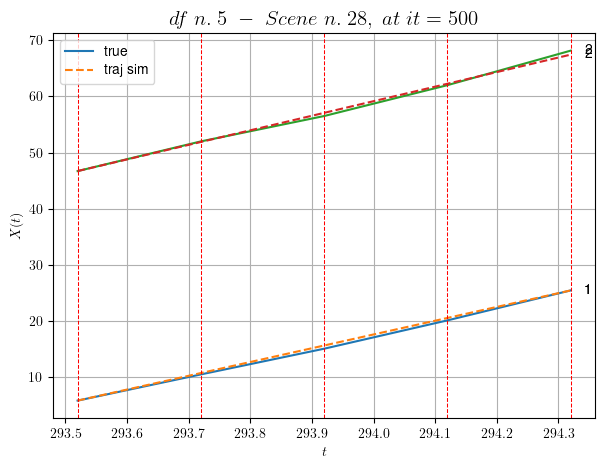

----------------------------------------------------------------------------------------------------
        For scene 13/44:
        * After LR finder: LR_NN=0.0001 with mse=1.9909598937449495 at it=24
        * v0 = 25.93052748237322
        * MSE = 0.1223874735884424
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.14/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [282.52,282.92]


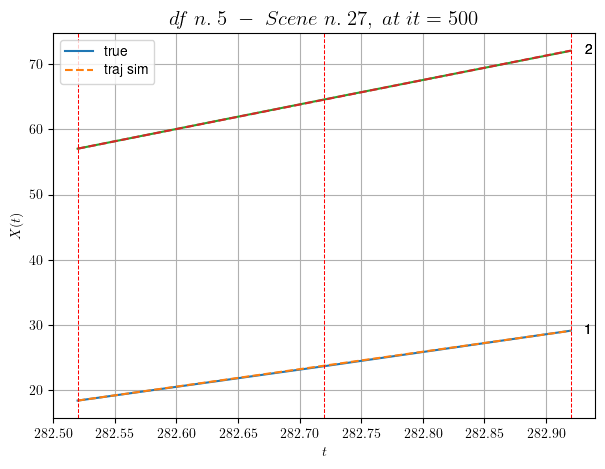

----------------------------------------------------------------------------------------------------
        For scene 14/44:
        * After LR finder: LR_NN=5e-05 with mse=1.8834589615945758 at it=24
        * v0 = 37.541206655621046
        * MSE = 0.0012042141839268296
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.15/44
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [274.12,275.52]


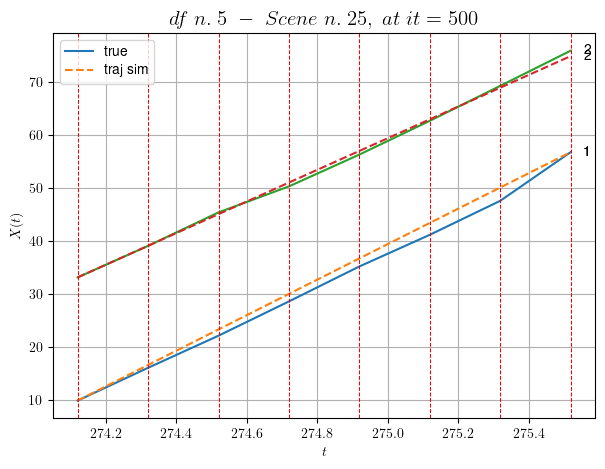

----------------------------------------------------------------------------------------------------
        For scene 15/44:
        * After LR finder: LR_NN=0.0005 with mse=1.6868829313555183 at it=24
        * v0 = 29.831436253445773
        * MSE = 0.5656304642878676
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.16/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [496.72,497.12]


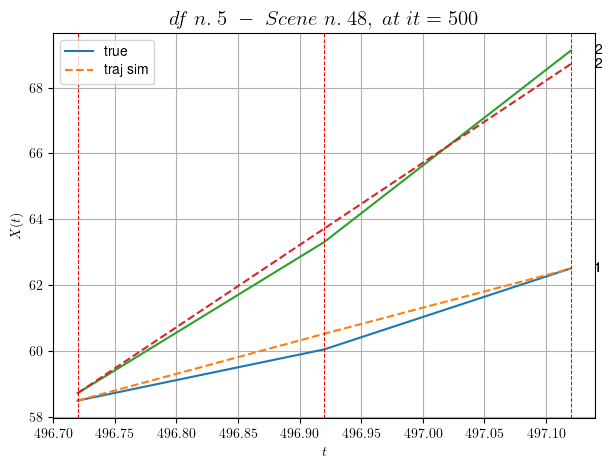

----------------------------------------------------------------------------------------------------
        For scene 16/44:
        * After LR finder: LR_NN=0.005 with mse=0.7533639204289754 at it=24
        * v0 = 25.01096626444741
        * MSE = 0.08964724085522452
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.17/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [125.12,126.12]


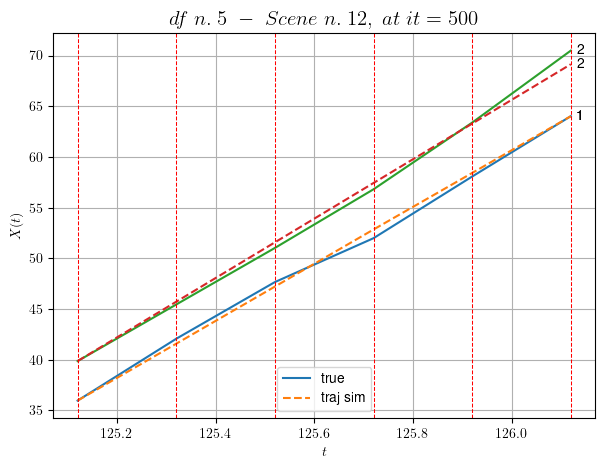

----------------------------------------------------------------------------------------------------
        For scene 17/44:
        * After LR finder: LR_NN=0.001 with mse=0.35484380320795844 at it=24
        * v0 = 29.269210394723558
        * MSE = 0.2983957331741762
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.18/44
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [337.72,339.52]


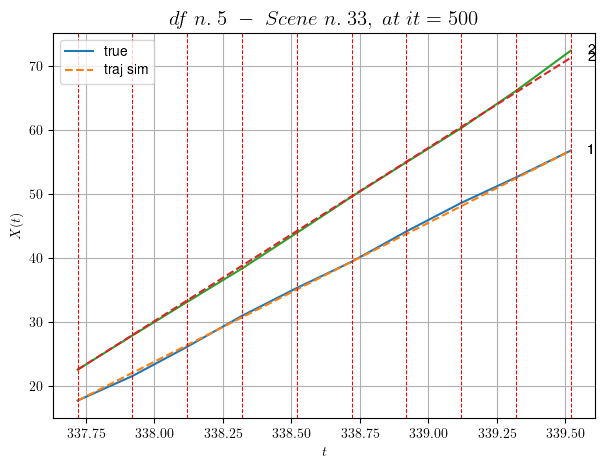

----------------------------------------------------------------------------------------------------
        For scene 18/44:
        * After LR finder: LR_NN=0.001 with mse=4.783156340890222 at it=24
        * v0 = 27.020038219087827
        * MSE = 0.12270723476605369
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.19/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [338.52,339.52]


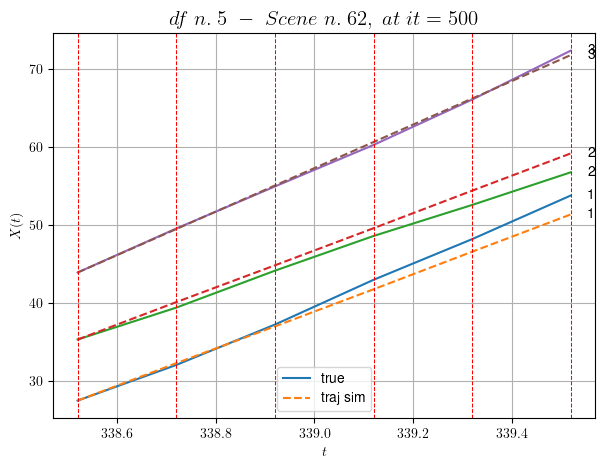

----------------------------------------------------------------------------------------------------
        For scene 19/44:
        * After LR finder: LR_NN=0.005 with mse=1.7629327600954152 at it=24
        * v0 = 27.853928426096356
        * MSE = 1.2064846121778763
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.20/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [490.92,491.32]


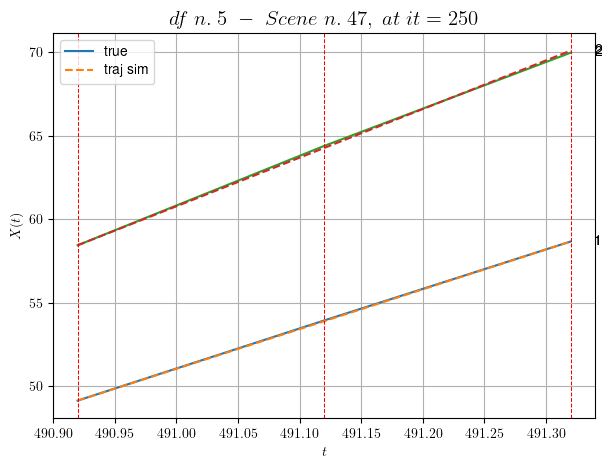

----------------------------------------------------------------------------------------------------
        For scene 20/44:
        * After LR finder: LR_NN=0.005 with mse=0.04020540646203108 at it=24
        * v0 = 29.11559727009669
        * MSE = 0.00539219819675425
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.21/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [396.92,397.32]


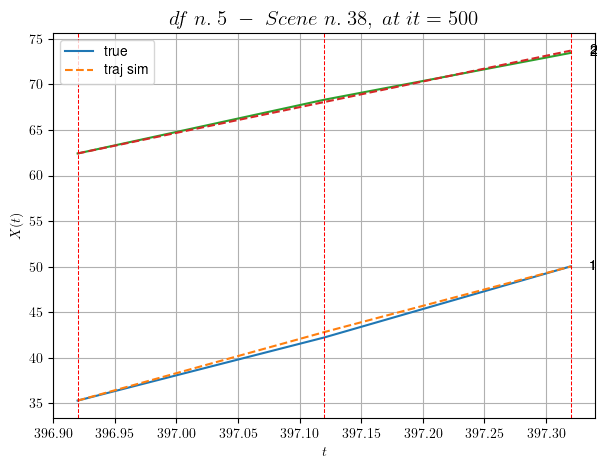

----------------------------------------------------------------------------------------------------
        For scene 21/44:
        * After LR finder: LR_NN=0.005 with mse=0.23161821166818142 at it=24
        * v0 = 28.239105392625085
        * MSE = 0.07657807642271948
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.22/44
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [326.52,327.92]


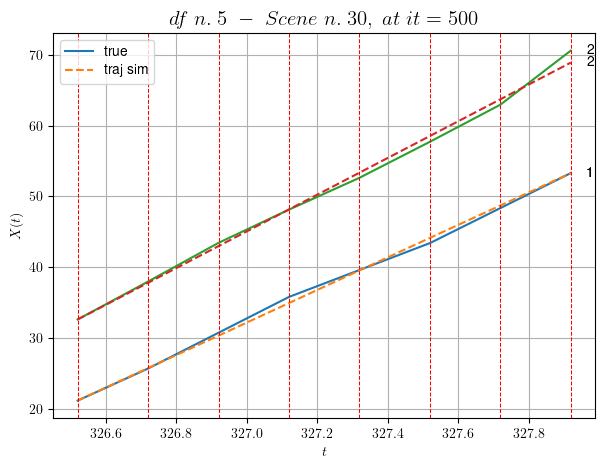

----------------------------------------------------------------------------------------------------
        For scene 22/44:
        * After LR finder: LR_NN=0.001 with mse=6.15346545506104 at it=24
        * v0 = 25.910216862746072
        * MSE = 0.4045065326860211
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.23/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [450.92,451.52]


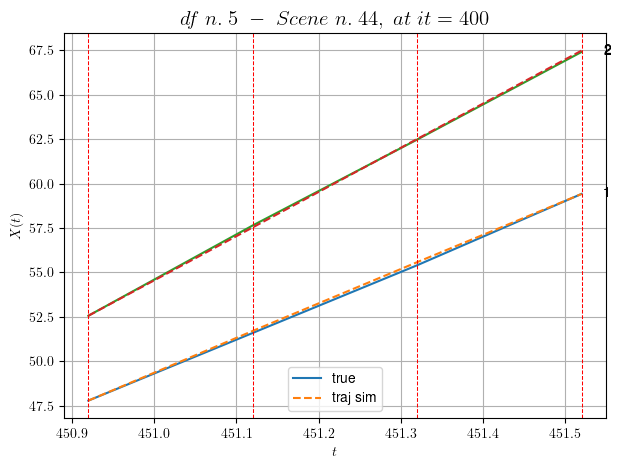

----------------------------------------------------------------------------------------------------
        For scene 23/44:
        * After LR finder: LR_NN=0.01 with mse=1.8961840564061 at it=24
        * v0 = 24.87748266118287
        * MSE = 0.007523122337758675
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.24/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [525.52,526.12]


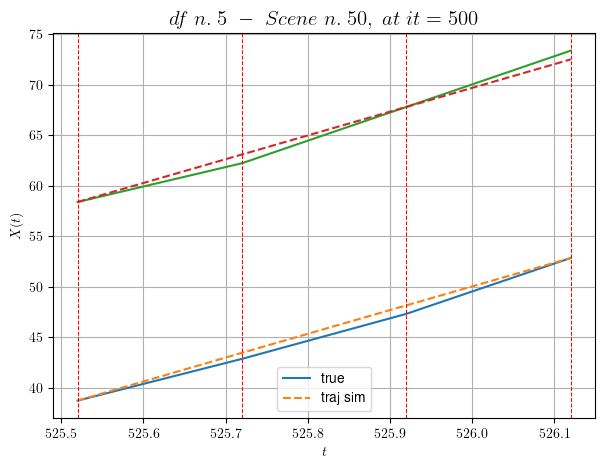

----------------------------------------------------------------------------------------------------
        For scene 24/44:
        * After LR finder: LR_NN=0.001 with mse=2.675308543540557 at it=24
        * v0 = 23.53935545424715
        * MSE = 0.2993523015271311
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.25/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [38.72,39.12]


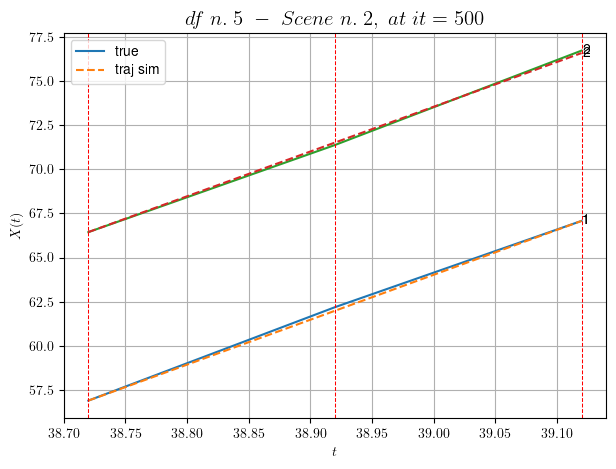

----------------------------------------------------------------------------------------------------
        For scene 25/44:
        * After LR finder: LR_NN=0.0001 with mse=0.6798643960553256 at it=24
        * v0 = 25.372431967348927
        * MSE = 0.013239649828298195
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.26/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [232.32,233.52]


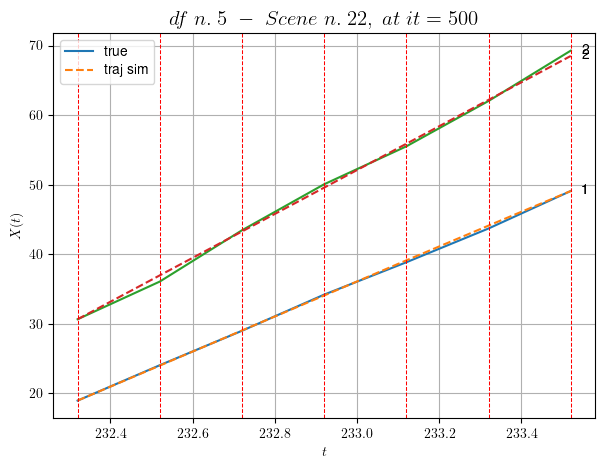

----------------------------------------------------------------------------------------------------
        For scene 26/44:
        * After LR finder: LR_NN=0.005 with mse=0.9227786896547431 at it=24
        * v0 = 31.537257787030374
        * MSE = 0.14845613223557608
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.27/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [47.12,47.52]


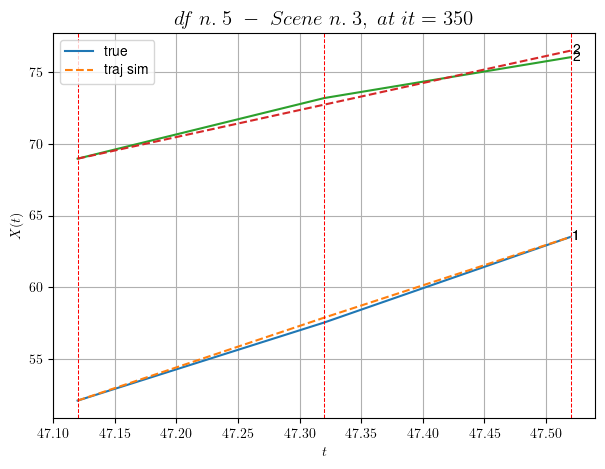

----------------------------------------------------------------------------------------------------
        For scene 27/44:
        * After LR finder: LR_NN=0.005 with mse=4.6672324531573475 at it=24
        * v0 = 18.77182145861044
        * MSE = 0.08875615175693721
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.28/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [28.12,28.72]


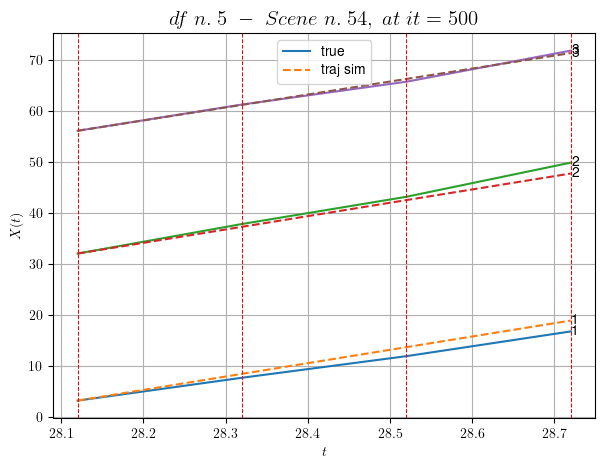

----------------------------------------------------------------------------------------------------
        For scene 28/44:
        * After LR finder: LR_NN=0.001 with mse=2.131171384412715 at it=24
        * v0 = 25.379383792483893
        * MSE = 1.1676867140986895
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.29/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [415.32,416.32]


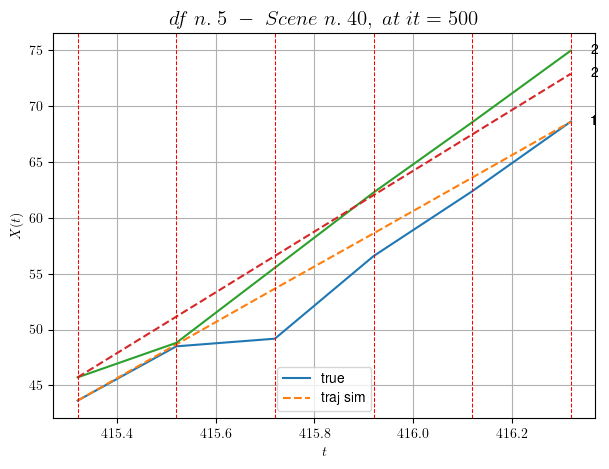

----------------------------------------------------------------------------------------------------
        For scene 29/44:
        * After LR finder: LR_NN=0.0005 with mse=1.7238331733277892 at it=24
        * v0 = 27.188395316739523
        * MSE = 3.0224094227534537
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.30/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [368.32,368.92]


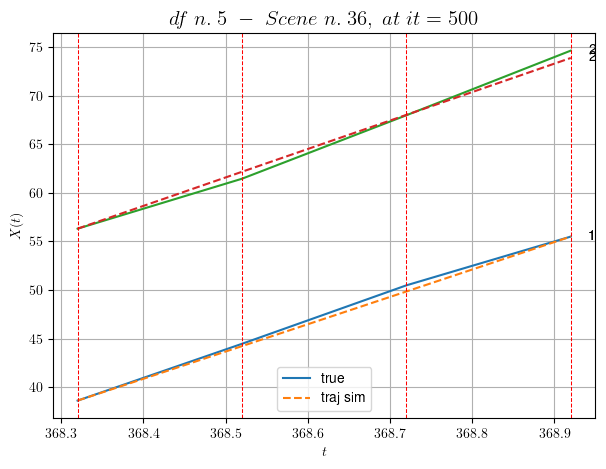

----------------------------------------------------------------------------------------------------
        For scene 30/44:
        * After LR finder: LR_NN=0.001 with mse=0.32455763762982465 at it=24
        * v0 = 29.29813929812586
        * MSE = 0.18158911947955567
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.31/44
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [23.72,24.52]


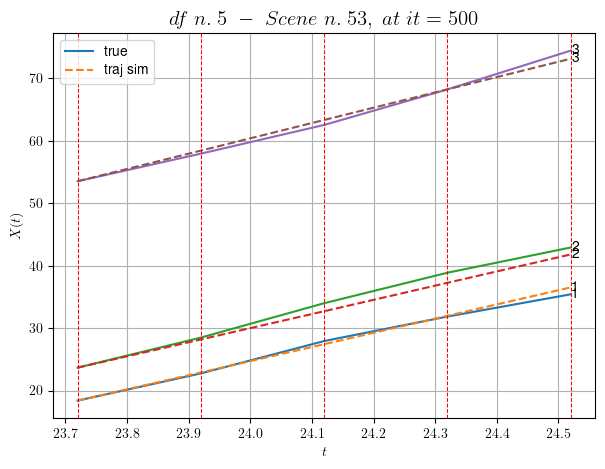

----------------------------------------------------------------------------------------------------
        For scene 31/44:
        * After LR finder: LR_NN=0.001 with mse=2.9209883875635536 at it=24
        * v0 = 24.534803734519375
        * MSE = 0.631916384734915
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.32/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [264.92,266.12]


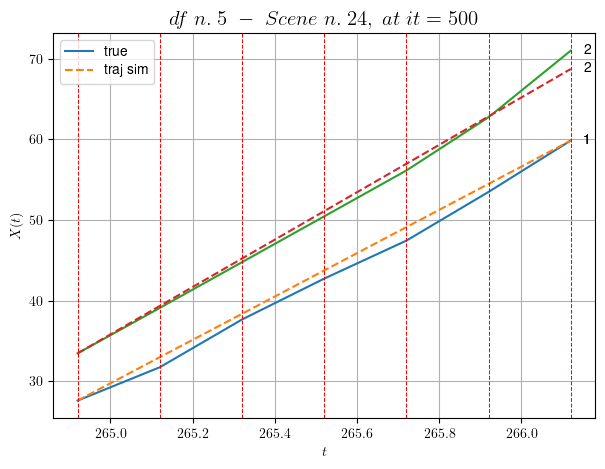

----------------------------------------------------------------------------------------------------
        For scene 32/44:
        * After LR finder: LR_NN=0.0005 with mse=0.6987442019558063 at it=24
        * v0 = 29.366788374198897
        * MSE = 0.6903073353954412
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.33/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [151.12,151.52]


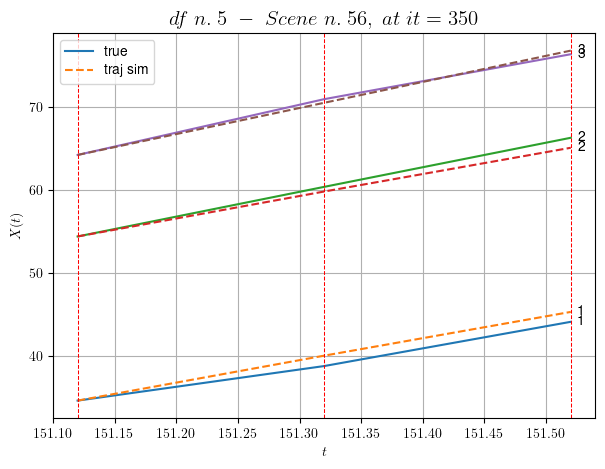

----------------------------------------------------------------------------------------------------
        For scene 33/44:
        * After LR finder: LR_NN=0.005 with mse=1.2239682051408904 at it=24
        * v0 = 31.516127782591557
        * MSE = 0.5733890789320171
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.34/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [123.92,124.52]


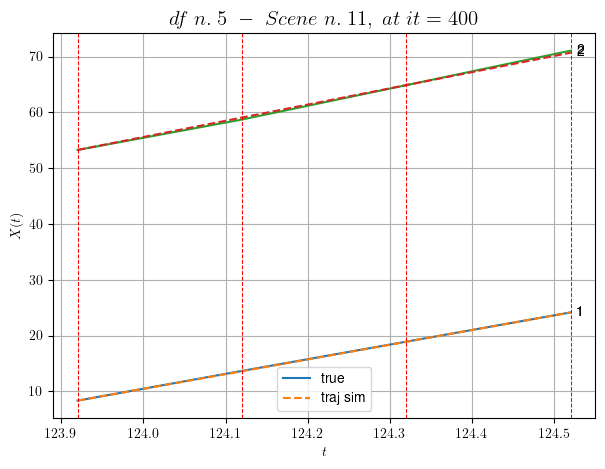

----------------------------------------------------------------------------------------------------
        For scene 34/44:
        * After LR finder: LR_NN=0.005 with mse=0.06078696634710148 at it=24
        * v0 = 29.067105023723787
        * MSE = 0.028870658839850676
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.35/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [251.72,252.72]


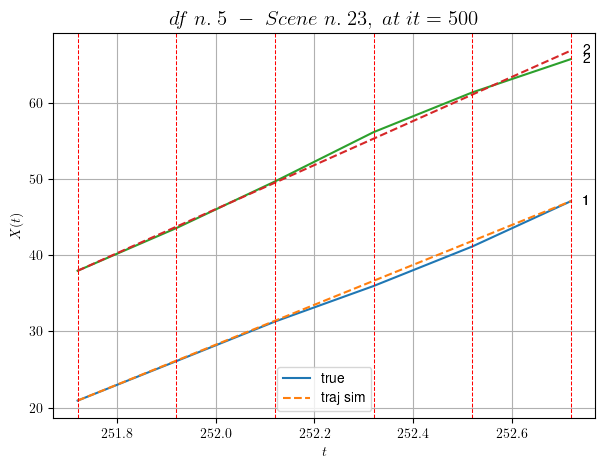

----------------------------------------------------------------------------------------------------
        For scene 35/44:
        * After LR finder: LR_NN=0.0005 with mse=0.48795863919258026 at it=24
        * v0 = 28.91133195438014
        * MSE = 0.26001922239876163
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.36/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [214.32,214.92]


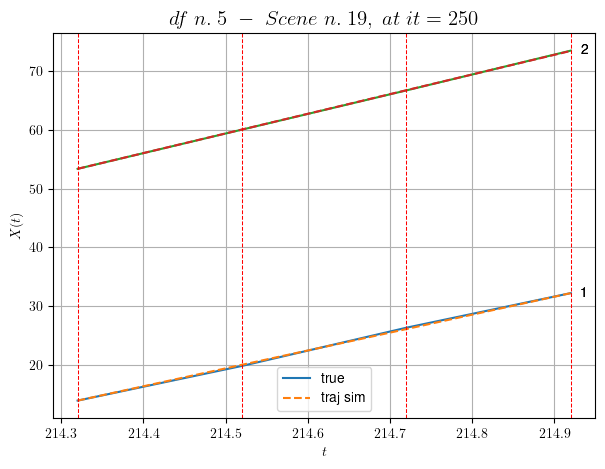

----------------------------------------------------------------------------------------------------
        For scene 36/44:
        * After LR finder: LR_NN=0.001 with mse=0.8471552542197651 at it=24
        * v0 = 33.41664171121942
        * MSE = 0.011679709581953947
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.37/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [266.92,267.32]


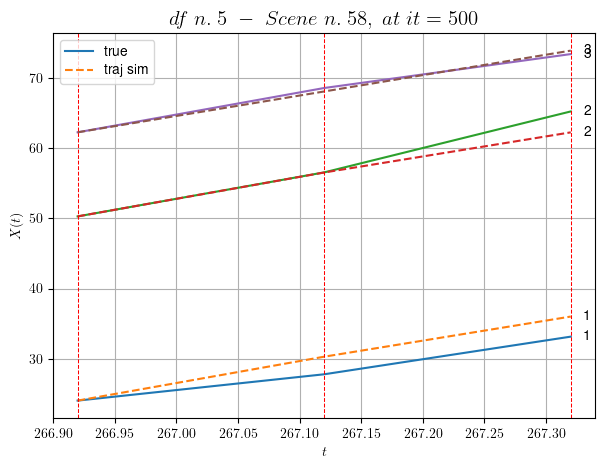

----------------------------------------------------------------------------------------------------
        For scene 37/44:
        * After LR finder: LR_NN=0.005 with mse=2.8543614634861023 at it=24
        * v0 = 29.085701625927186
        * MSE = 2.631059993613867
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.38/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [407.92,408.52]


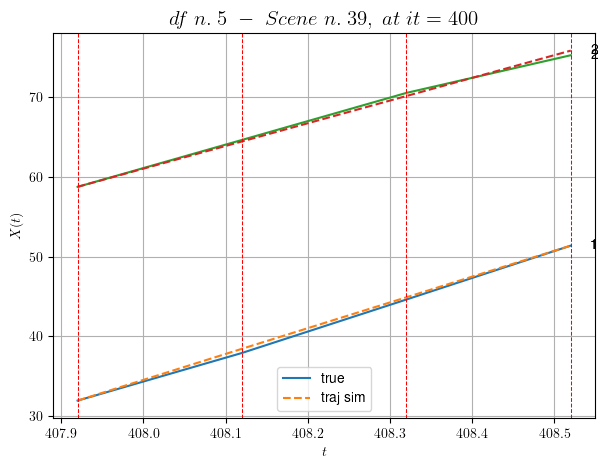

----------------------------------------------------------------------------------------------------
        For scene 38/44:
        * After LR finder: LR_NN=0.001 with mse=0.3449033070563592 at it=24
        * v0 = 28.45068736411465
        * MSE = 0.1094698415450572
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.39/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [226.72,227.92]


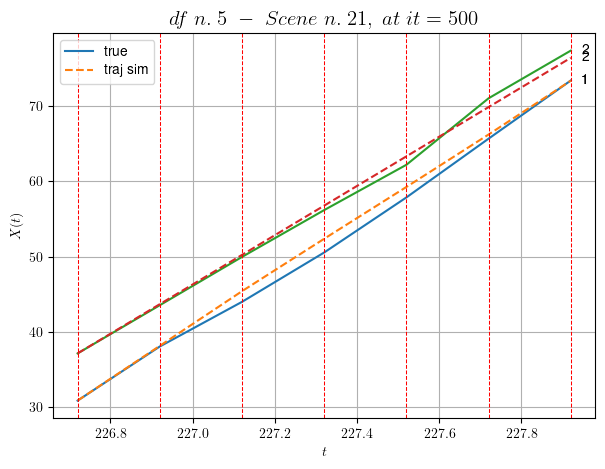

----------------------------------------------------------------------------------------------------
        For scene 39/44:
        * After LR finder: LR_NN=0.005 with mse=3.0462377614419873 at it=24
        * v0 = 32.693664579613966
        * MSE = 0.8192979755336767
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.40/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [330.12,330.52]


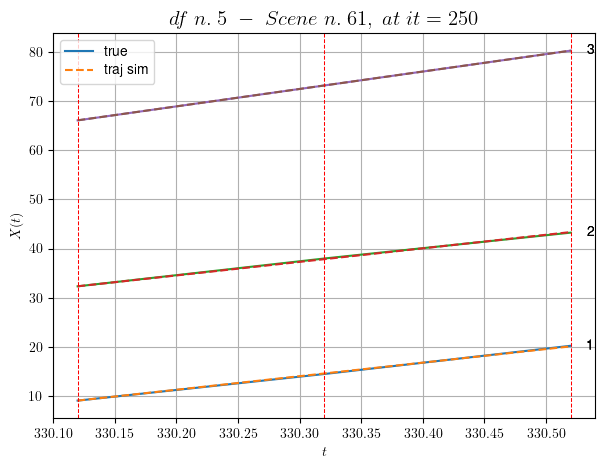

----------------------------------------------------------------------------------------------------
        For scene 40/44:
        * After LR finder: LR_NN=0.001 with mse=0.6736771901319988 at it=24
        * v0 = 35.47750160164112
        * MSE = 0.0065714075752958505
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.41/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [78.72,79.32]


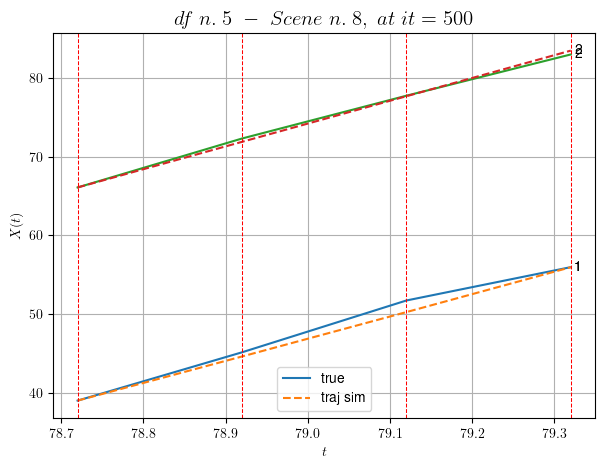

----------------------------------------------------------------------------------------------------
        For scene 41/44:
        * After LR finder: LR_NN=0.001 with mse=0.6962242553435738 at it=24
        * v0 = 28.965407295611083
        * MSE = 0.3571642921373734
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.42/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [449.12,450.12]


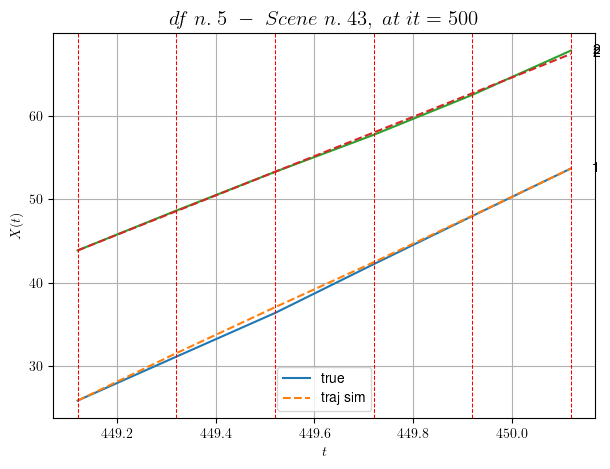

----------------------------------------------------------------------------------------------------
        For scene 42/44:
        * After LR finder: LR_NN=0.01 with mse=7.6301328506856905 at it=24
        * v0 = 23.52760427573229
        * MSE = 0.0617839036686921
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.43/44
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [149.92,150.72]


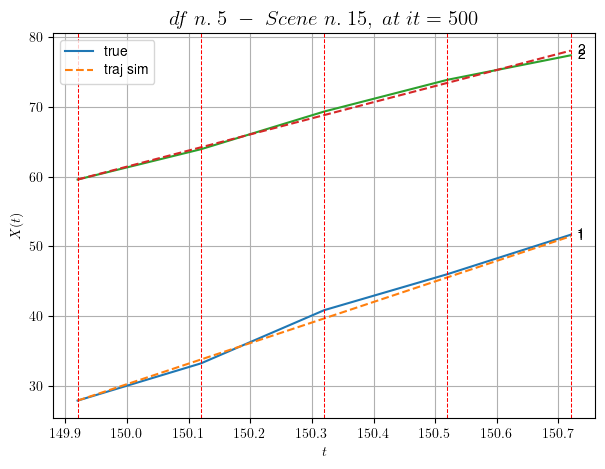

----------------------------------------------------------------------------------------------------
        For scene 43/44:
        * After LR finder: LR_NN=1e-05 with mse=6.114204696042565 at it=24
        * v0 = 23.102993584361272
        * MSE = 0.29348967803821324
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.44/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [535.32,535.92]


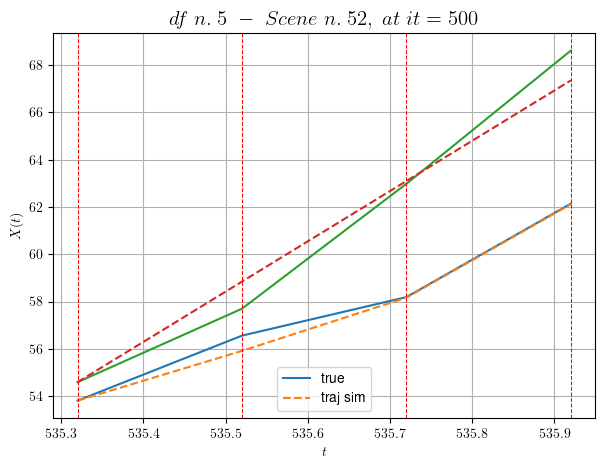

----------------------------------------------------------------------------------------------------
        For scene 44/44:
        * After LR finder: LR_NN=0.01 with mse=4.930261219733255 at it=24
        * v0 = 21.27807752048418
        * MSE = 0.4110155955478463
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.4614163013264223
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (22 scenes)
DataFrame n.5. Scene n.1/22


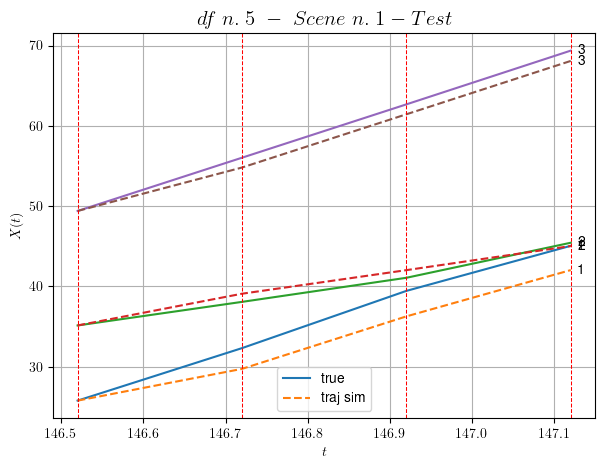

        For scene 1/22:
        * MSE = 2.7258030612194255
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/22


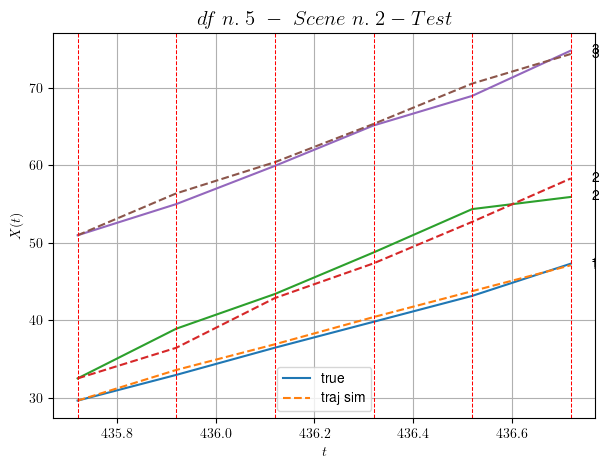

        For scene 2/22:
        * MSE = 1.2788232320629673
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/22


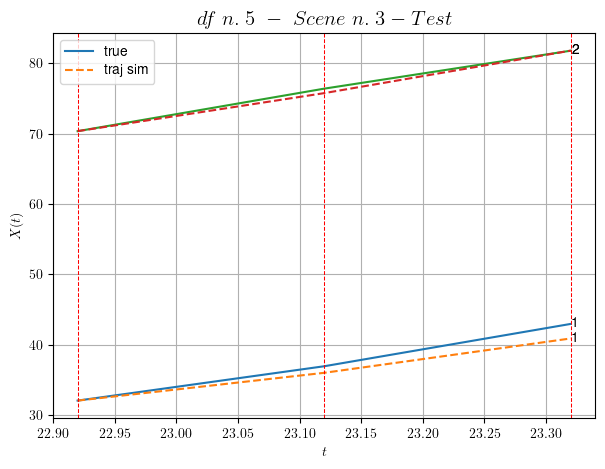

        For scene 3/22:
        * MSE = 0.9270128158009582
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/22


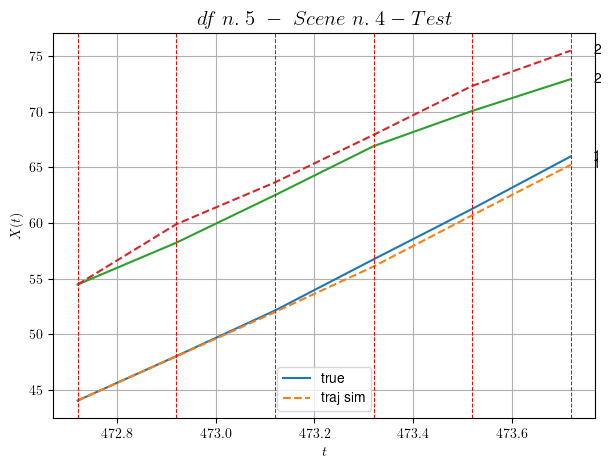

        For scene 4/22:
        * MSE = 1.502695712946695
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/22


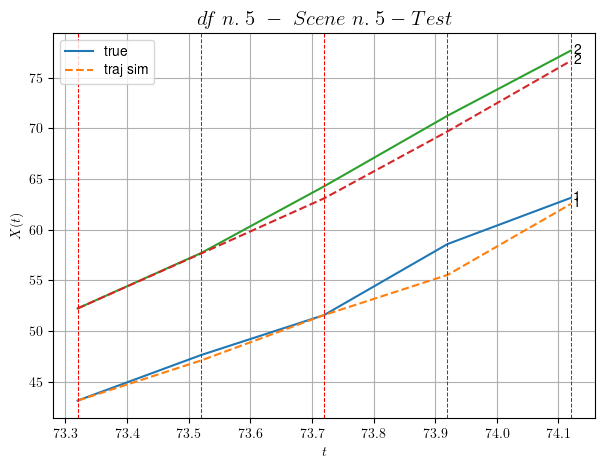

        For scene 5/22:
        * MSE = 1.4759901893002823
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/22


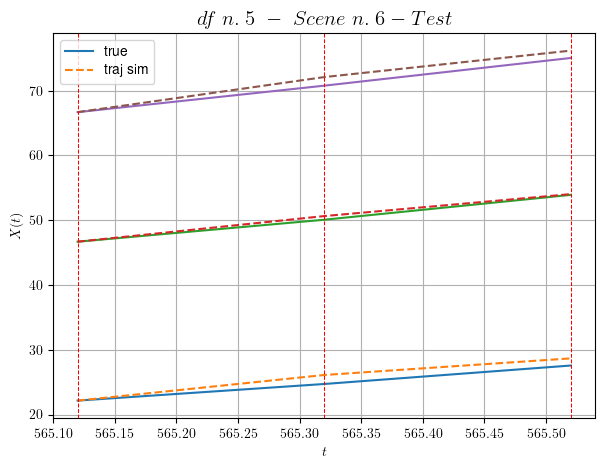

        For scene 6/22:
        * MSE = 0.7251798904800021
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.7/22


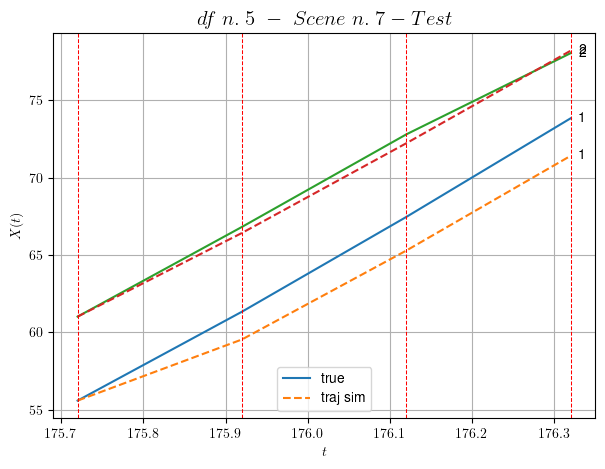

        For scene 7/22:
        * MSE = 1.7934225462754845
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.8/22


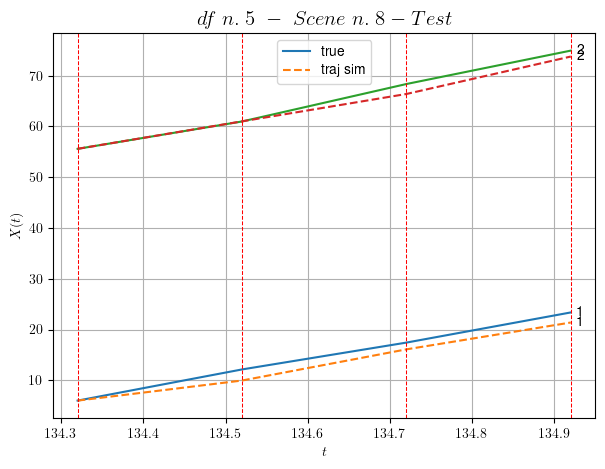

        For scene 8/22:
        * MSE = 1.9614246006984237
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.9/22


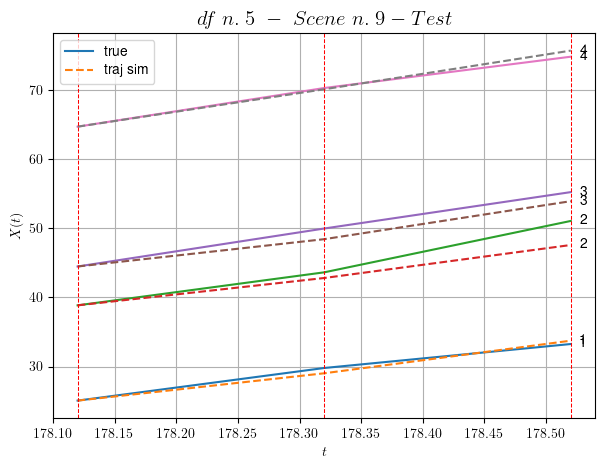

        For scene 9/22:
        * MSE = 1.5433101270244303
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.10/22


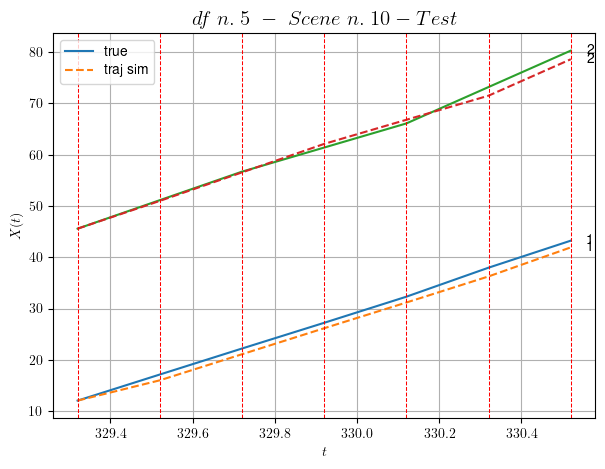

        For scene 10/22:
        * MSE = 1.1617442869941759
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.11/22


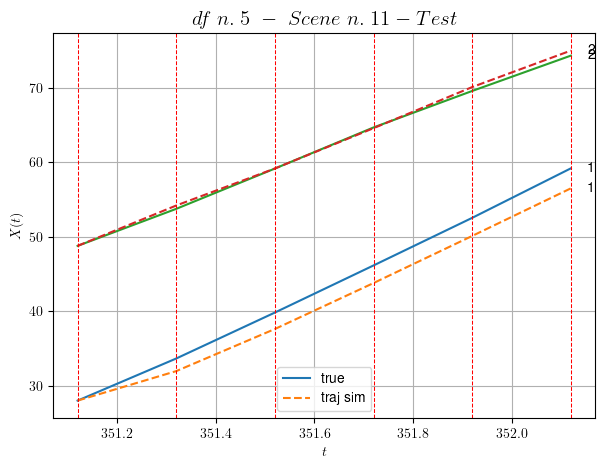

        For scene 11/22:
        * MSE = 2.2756949068446173
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.12/22


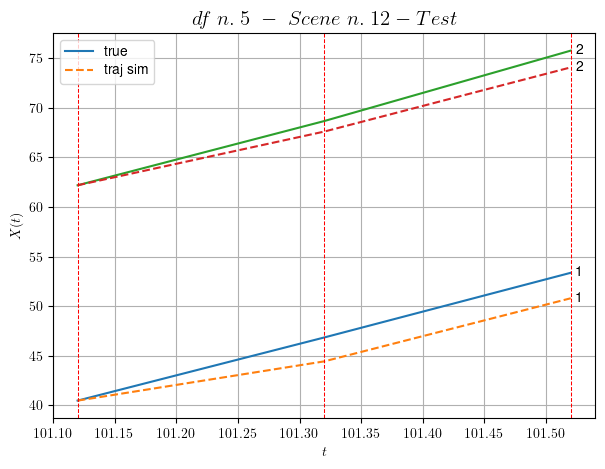

        For scene 12/22:
        * MSE = 2.7283500427110274
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.13/22


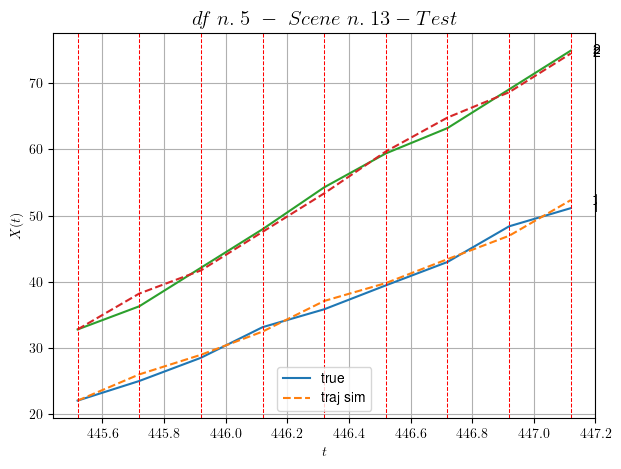

        For scene 13/22:
        * MSE = 0.8252978183168405
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.14/22


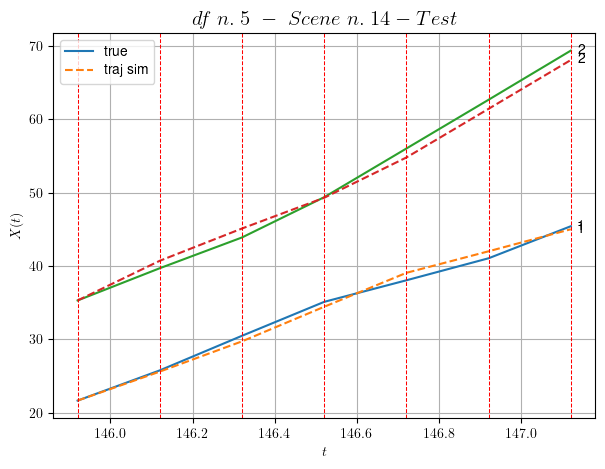

        For scene 14/22:
        * MSE = 0.7400327537232246
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.15/22


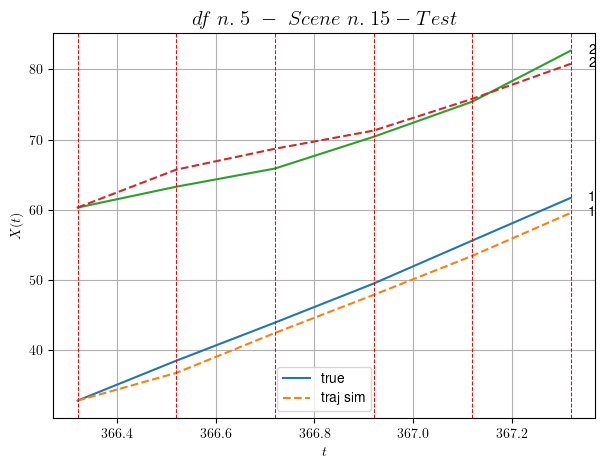

        For scene 15/22:
        * MSE = 2.9611793519279157
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.16/22


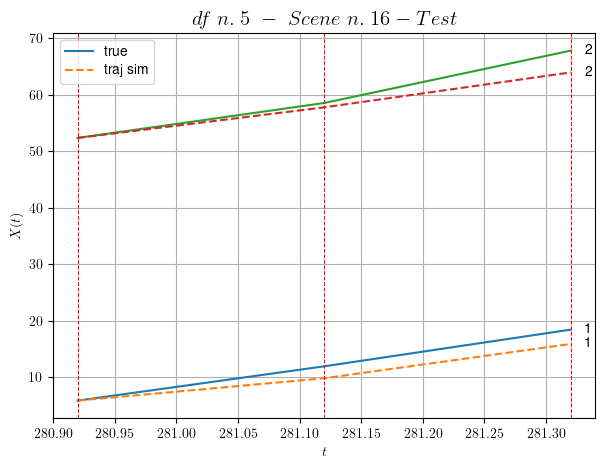

        For scene 16/22:
        * MSE = 4.389007639234559
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.17/22


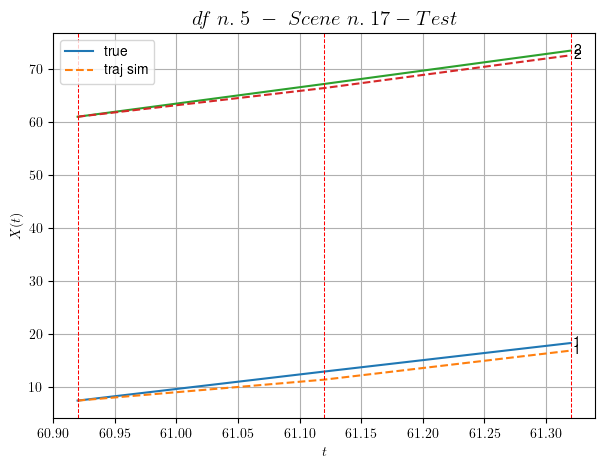

        For scene 17/22:
        * MSE = 0.958114623728531
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.18/22


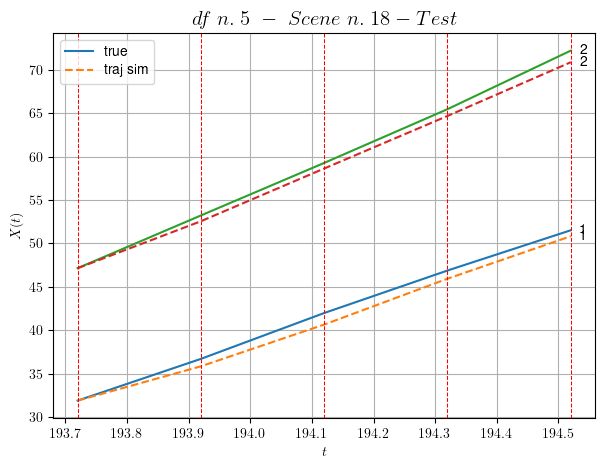

        For scene 18/22:
        * MSE = 0.7131072433374013
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.19/22


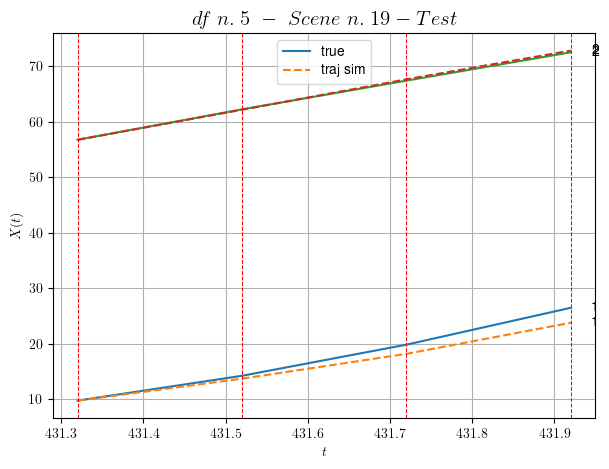

        For scene 19/22:
        * MSE = 1.3006063096697635
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.20/22


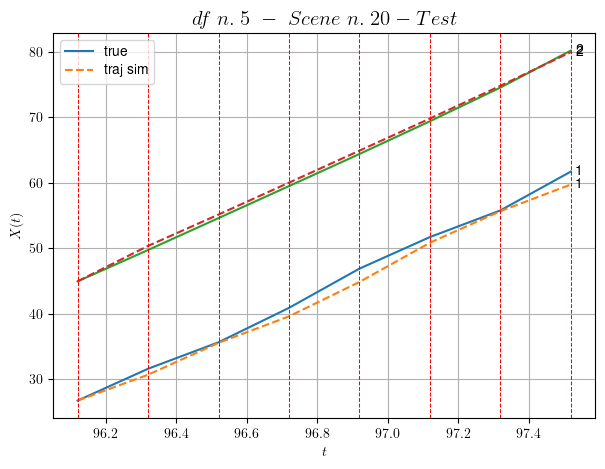

        For scene 20/22:
        * MSE = 0.8031691668733492
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.21/22


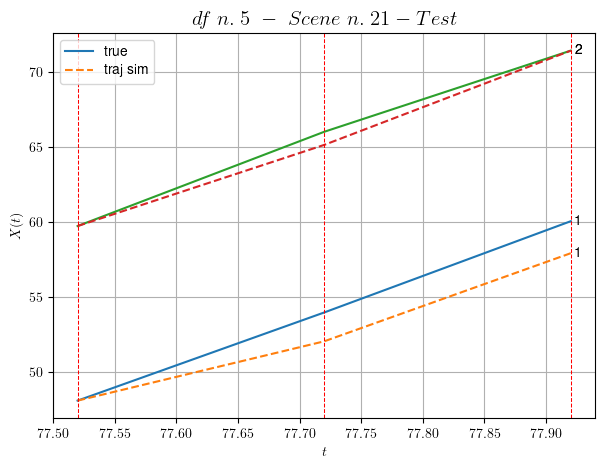

        For scene 21/22:
        * MSE = 1.503512476951676
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.22/22


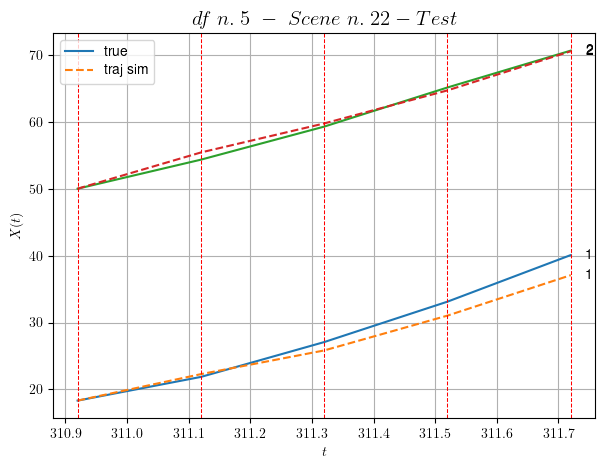

        For scene 22/22:
        * MSE = 1.6701117101340008
----------------------------------------------------------------------------------------------------


MSE test: 1.6347086593752613

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.4614163013264223
          * MSE test: 1.6347086593752613
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 6/10 dfs.
In DataFrame n.6 we have 52 scenes.
    To train the model we use 34 scenes, the remaining 18 to test the model.

Training step. (34 scenes)
DataFrame n.6. Scene n.1/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [530.40,530.80]


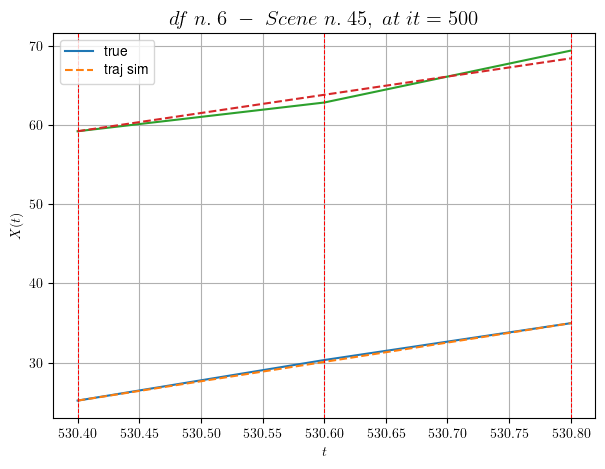

----------------------------------------------------------------------------------------------------
        For scene 1/34:
        * After LR finder: LR_NN=0.0001 with mse=1.5036317712991925 at it=24
        * v0 = 22.991928031469914
        * MSE = 0.31365730326630725
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [446.80,447.80]


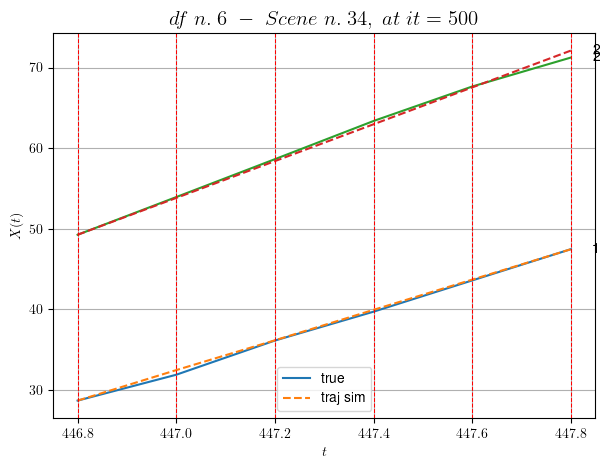

----------------------------------------------------------------------------------------------------
        For scene 2/34:
        * After LR finder: LR_NN=0.005 with mse=10.005748368991156 at it=24
        * v0 = 22.841482925265804
        * MSE = 0.11489910324115213
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [552.20,552.80]


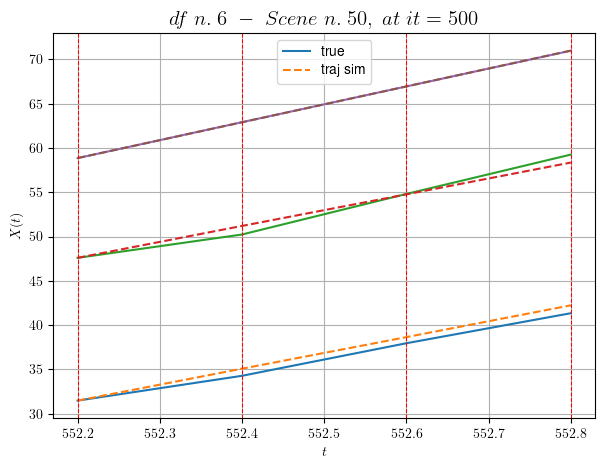

----------------------------------------------------------------------------------------------------
        For scene 3/34:
        * After LR finder: LR_NN=0.001 with mse=4.778072958548583 at it=24
        * v0 = 20.2332050395537
        * MSE = 0.30415643061285863
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [195.80,196.80]


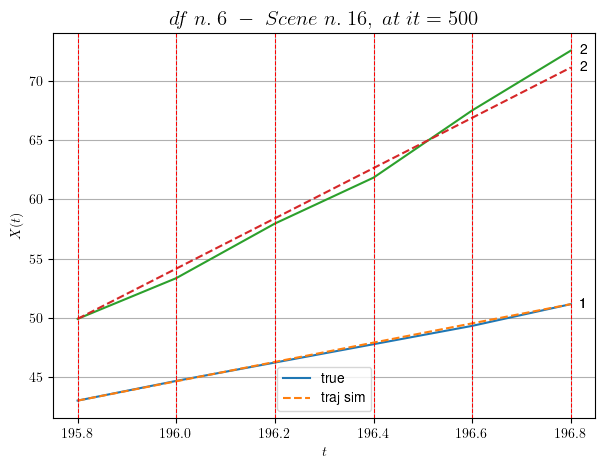

----------------------------------------------------------------------------------------------------
        For scene 4/34:
        * After LR finder: LR_NN=0.005 with mse=12.793989752263212 at it=24
        * v0 = 21.237347440799663
        * MSE = 0.2874587427334336
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [129.80,130.20]


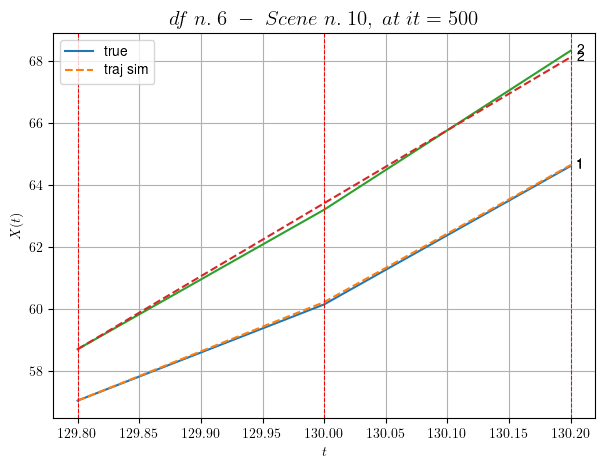

----------------------------------------------------------------------------------------------------
        For scene 5/34:
        * After LR finder: LR_NN=0.0005 with mse=1.314413116269652 at it=24
        * v0 = 23.60183293107532
        * MSE = 0.015753008817984276
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.6/34
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [204.40,206.20]


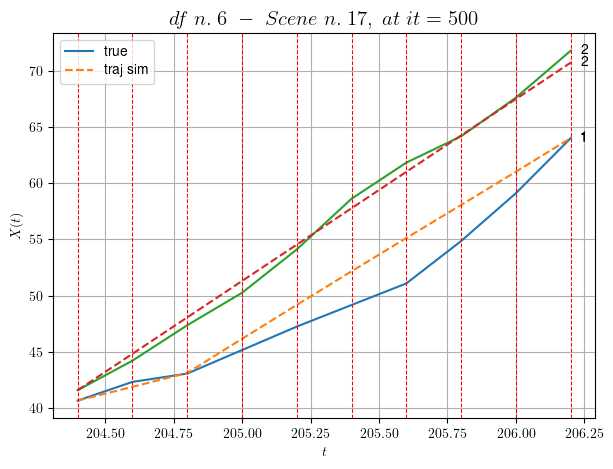

----------------------------------------------------------------------------------------------------
        For scene 6/34:
        * After LR finder: LR_NN=0.001 with mse=106.15562314855218 at it=24
        * v0 = 16.186070594948653
        * MSE = 2.439373056229499
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.7/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [396.40,397.60]


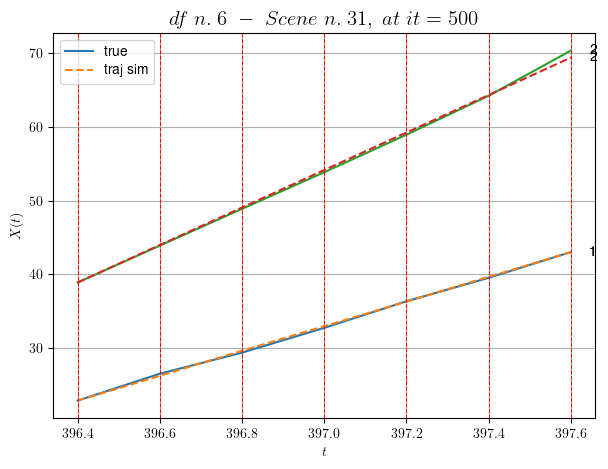

----------------------------------------------------------------------------------------------------
        For scene 7/34:
        * After LR finder: LR_NN=0.005 with mse=5.183346748654103 at it=24
        * v0 = 25.429850069094865
        * MSE = 0.09540900979101312
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.8/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [458.00,458.40]


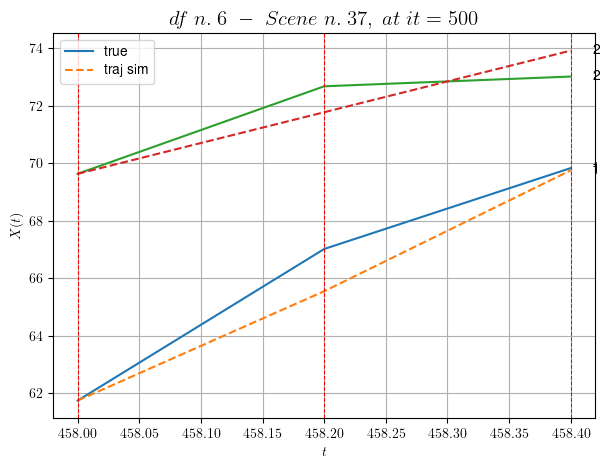

----------------------------------------------------------------------------------------------------
        For scene 8/34:
        * After LR finder: LR_NN=0.005 with mse=14.58497942050786 at it=24
        * v0 = 10.716650123126483
        * MSE = 0.6254042216107045
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.9/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [296.40,296.80]


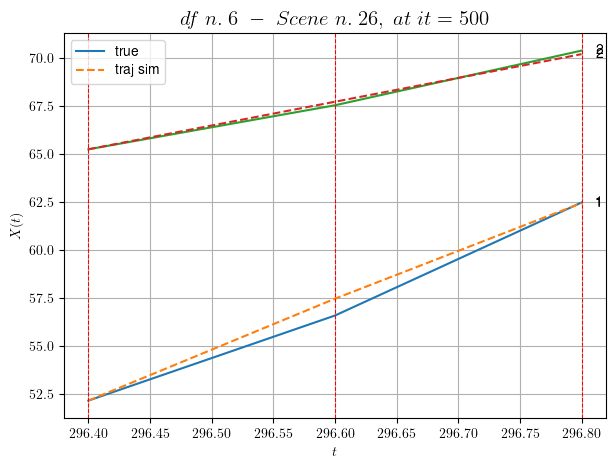

----------------------------------------------------------------------------------------------------
        For scene 9/34:
        * After LR finder: LR_NN=0.005 with mse=10.361552928649827 at it=24
        * v0 = 12.399412488572612
        * MSE = 0.13489142511270777
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.10/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [134.00,135.20]


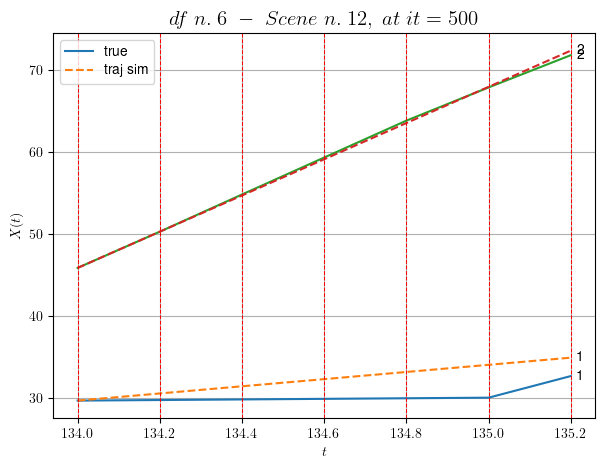

----------------------------------------------------------------------------------------------------
        For scene 10/34:
        * After LR finder: LR_NN=5e-05 with mse=17.021380526233504 at it=24
        * v0 = 22.06323233551294
        * MSE = 2.911996306381458
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.11/34
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [14.80,15.60]


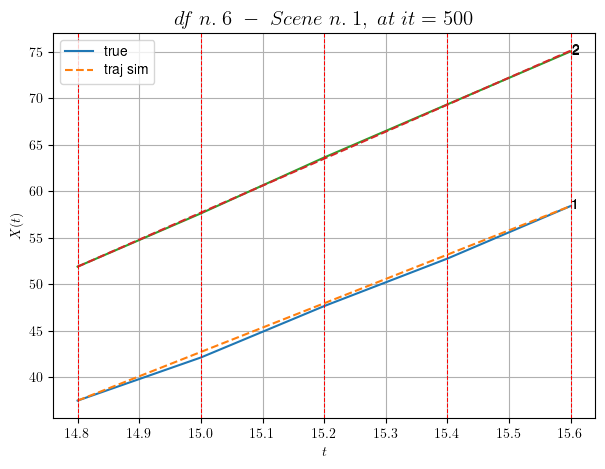

----------------------------------------------------------------------------------------------------
        For scene 11/34:
        * After LR finder: LR_NN=0.0001 with mse=0.12228813675379595 at it=24
        * v0 = 29.057098132173117
        * MSE = 0.04529235420359436
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.12/34
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [576.00,577.60]


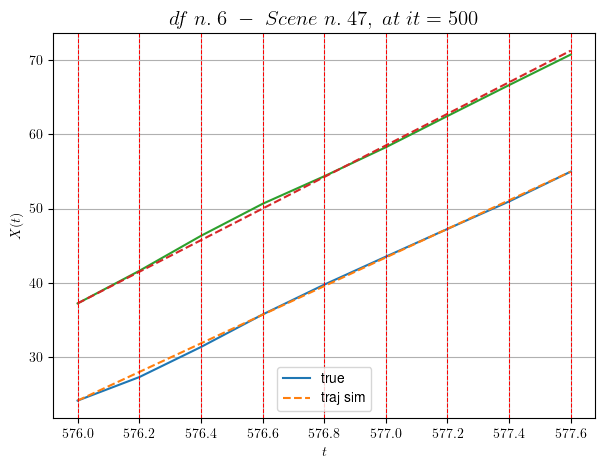

----------------------------------------------------------------------------------------------------
        For scene 12/34:
        * After LR finder: LR_NN=0.0005 with mse=35.62034137551384 at it=24
        * v0 = 21.30103062024141
        * MSE = 0.12030060288799863
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.13/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [359.20,359.60]


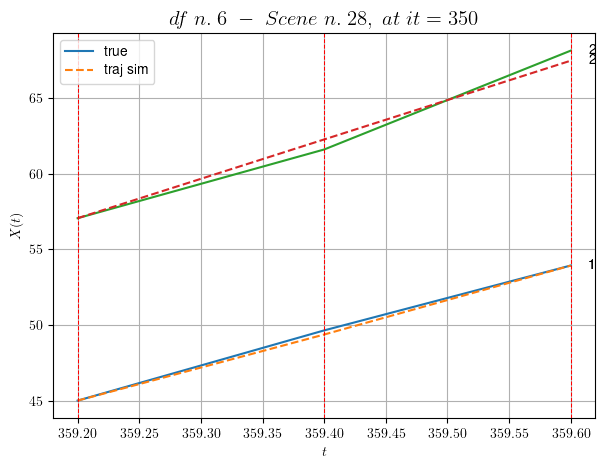

----------------------------------------------------------------------------------------------------
        For scene 13/34:
        * After LR finder: LR_NN=0.01 with mse=0.5122166067947028 at it=24
        * v0 = 26.036961880599307
        * MSE = 0.14865617567698197
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.14/34
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [407.80,409.20]


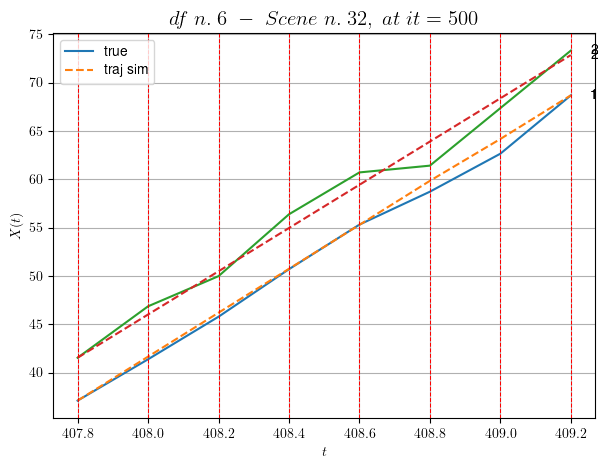

----------------------------------------------------------------------------------------------------
        For scene 14/34:
        * After LR finder: LR_NN=0.001 with mse=22.670959987183434 at it=24
        * v0 = 22.36371629852114
        * MSE = 0.9890500050250983
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.15/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [467.00,468.20]


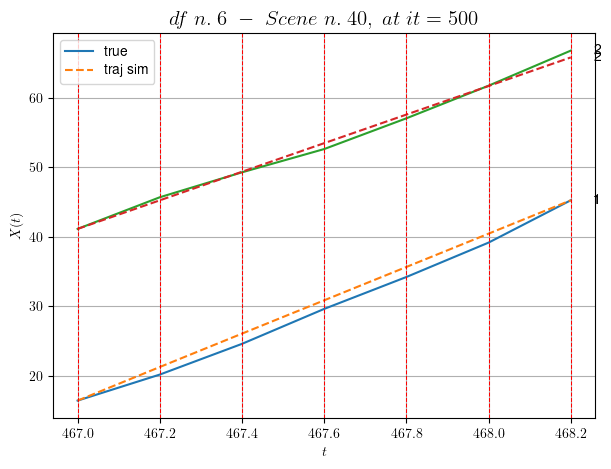

----------------------------------------------------------------------------------------------------
        For scene 15/34:
        * After LR finder: LR_NN=0.001 with mse=23.64634103174009 at it=24
        * v0 = 20.547439201770132
        * MSE = 0.7677954983546456
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.16/34
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [374.40,376.00]


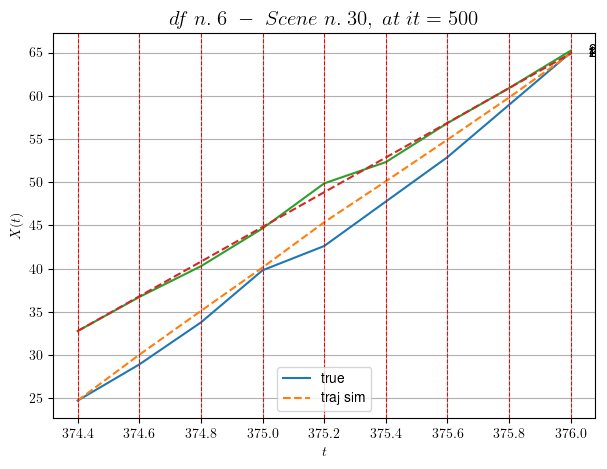

----------------------------------------------------------------------------------------------------
        For scene 16/34:
        * After LR finder: LR_NN=0.01 with mse=45.24658735631256 at it=24
        * v0 = 20.073696885977775
        * MSE = 1.0785620942618135
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.17/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [551.40,552.00]


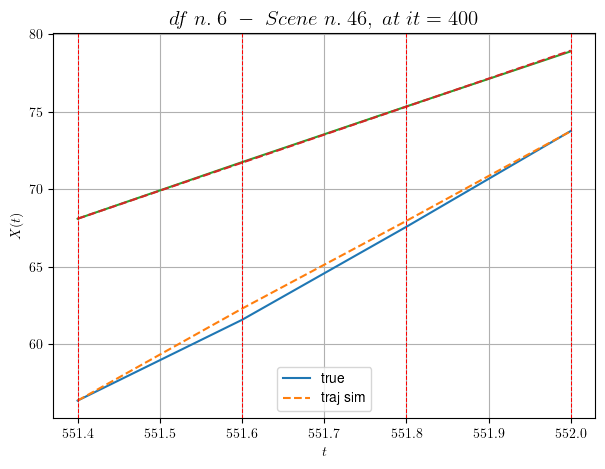

----------------------------------------------------------------------------------------------------
        For scene 17/34:
        * After LR finder: LR_NN=0.005 with mse=10.05302103389802 at it=24
        * v0 = 18.102658564771936
        * MSE = 0.08430772045762627
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.18/34
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [24.60,26.40]


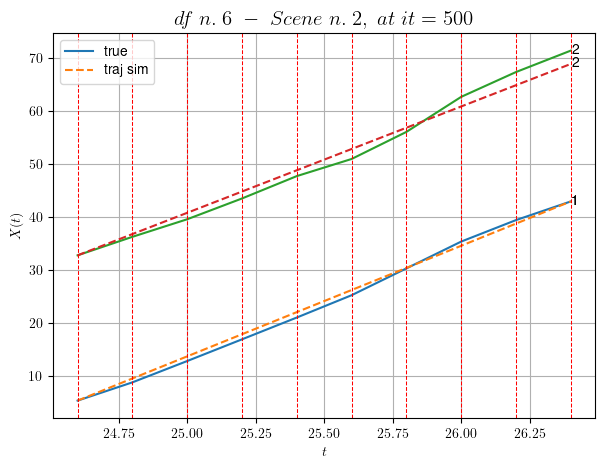

----------------------------------------------------------------------------------------------------
        For scene 18/34:
        * After LR finder: LR_NN=0.0005 with mse=51.73497371563876 at it=24
        * v0 = 20.07254372579165
        * MSE = 1.3404473700478627
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.19/34
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [236.20,237.00]


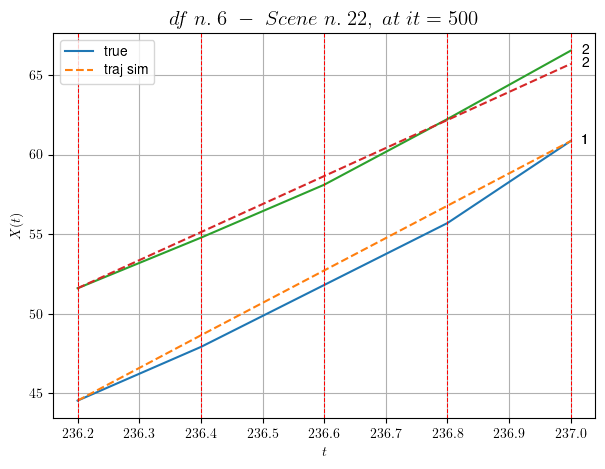

----------------------------------------------------------------------------------------------------
        For scene 19/34:
        * After LR finder: LR_NN=0.001 with mse=17.741927147782985 at it=24
        * v0 = 17.634130974587826
        * MSE = 0.36131102927585784
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.20/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [29.80,30.80]


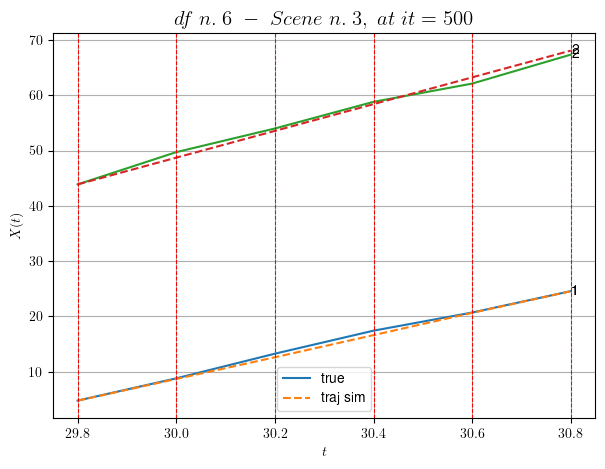

----------------------------------------------------------------------------------------------------
        For scene 20/34:
        * After LR finder: LR_NN=0.005 with mse=7.469025254150833 at it=24
        * v0 = 24.207929046504994
        * MSE = 0.3516493327742552
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.21/34
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [477.80,479.80]


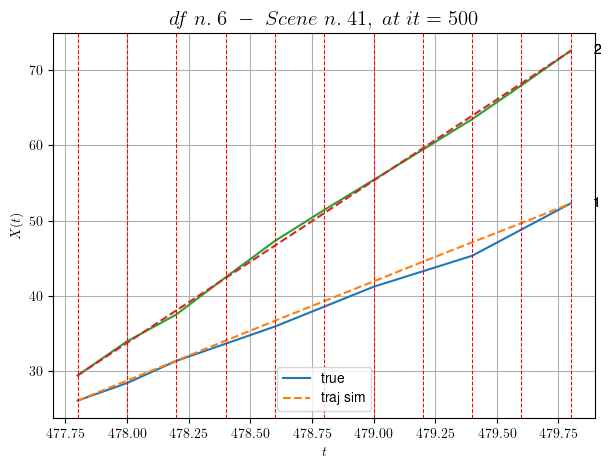

----------------------------------------------------------------------------------------------------
        For scene 21/34:
        * After LR finder: LR_NN=0.01 with mse=50.227149574463944 at it=24
        * v0 = 21.601430911083135
        * MSE = 0.3774046836488478
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.22/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [450.60,451.20]


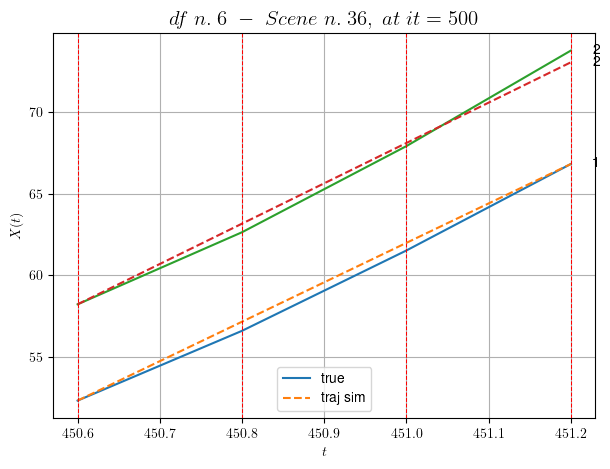

----------------------------------------------------------------------------------------------------
        For scene 22/34:
        * After LR finder: LR_NN=0.0001 with mse=1.765641600766859 at it=24
        * v0 = 24.707838126992097
        * MSE = 0.14957581013404037
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.23/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [263.80,264.20]


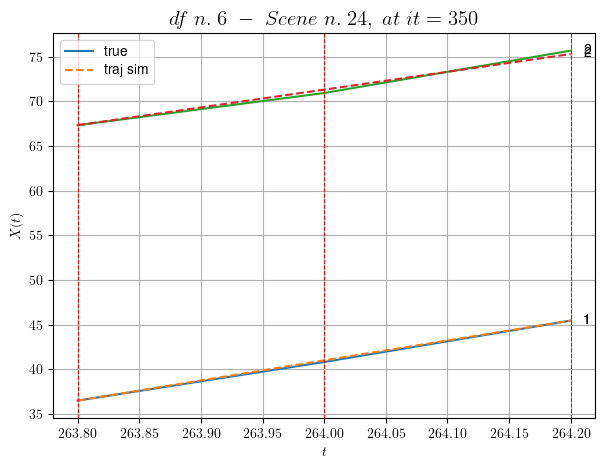

----------------------------------------------------------------------------------------------------
        For scene 23/34:
        * After LR finder: LR_NN=0.005 with mse=3.1797354114529273 at it=24
        * v0 = 19.938624229336703
        * MSE = 0.050227735327332275
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.24/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [593.40,594.60]


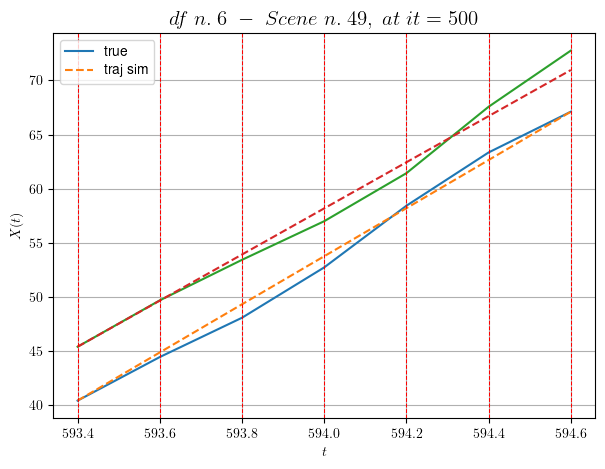

----------------------------------------------------------------------------------------------------
        For scene 24/34:
        * After LR finder: LR_NN=0.0005 with mse=18.822846084505837 at it=24
        * v0 = 21.280809908317227
        * MSE = 0.6790784393924196
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.25/34
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [131.80,133.40]


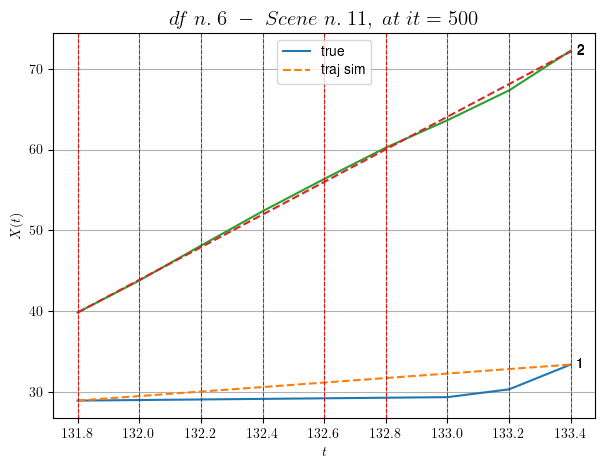

----------------------------------------------------------------------------------------------------
        For scene 25/34:
        * After LR finder: LR_NN=0.001 with mse=44.79583427700902 at it=24
        * v0 = 20.22300032377142
        * MSE = 1.6194424614060923
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.26/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [252.60,253.20]


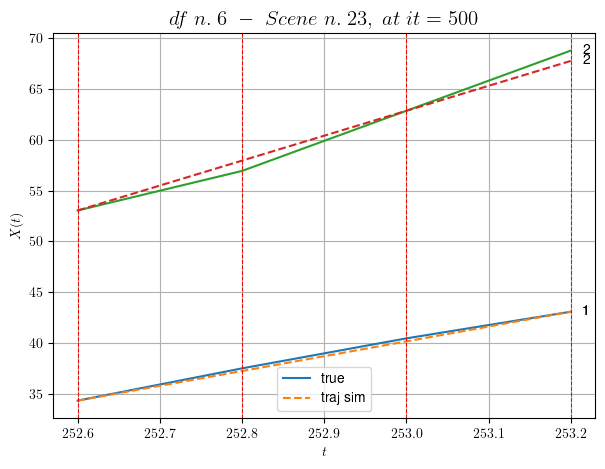

----------------------------------------------------------------------------------------------------
        For scene 26/34:
        * After LR finder: LR_NN=0.0005 with mse=8.948993710187754 at it=24
        * v0 = 24.514205448075334
        * MSE = 0.27389466073346735
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.27/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [228.80,229.40]


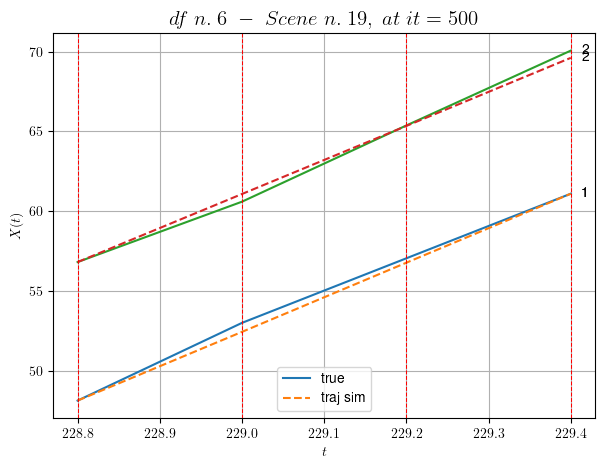

----------------------------------------------------------------------------------------------------
        For scene 27/34:
        * After LR finder: LR_NN=0.001 with mse=4.99346663587313 at it=24
        * v0 = 21.319904834010064
        * MSE = 0.09768295651629338
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.28/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [554.00,554.40]


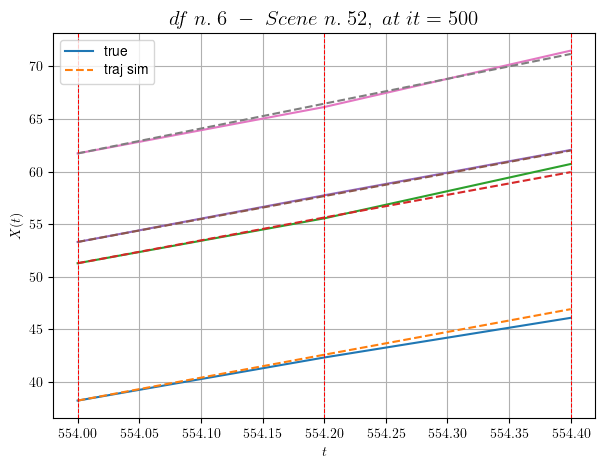

----------------------------------------------------------------------------------------------------
        For scene 28/34:
        * After LR finder: LR_NN=0.005 with mse=0.7624215229380169 at it=24
        * v0 = 23.647050620334902
        * MSE = 0.1290011076455351
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.29/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [234.00,234.60]


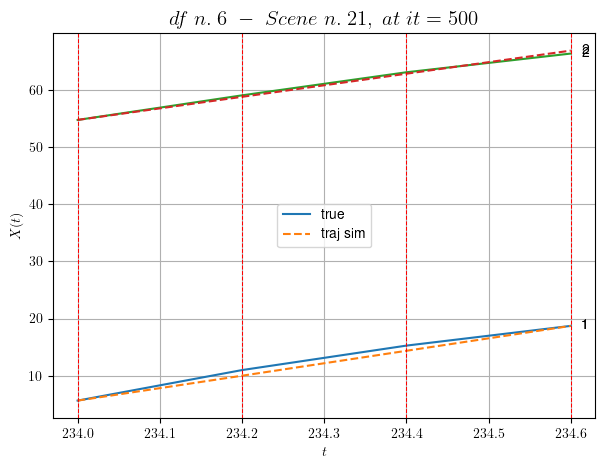

----------------------------------------------------------------------------------------------------
        For scene 29/34:
        * After LR finder: LR_NN=0.0001 with mse=7.574501828162563 at it=24
        * v0 = 20.201366857274152
        * MSE = 0.2737552948626586
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.30/34
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.60,87.40]


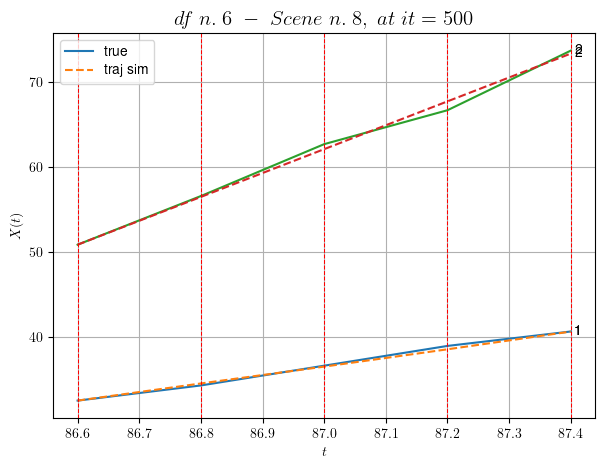

----------------------------------------------------------------------------------------------------
        For scene 30/34:
        * After LR finder: LR_NN=0.01 with mse=0.6209347055669284 at it=24
        * v0 = 28.176915163685493
        * MSE = 0.17998121649679844
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.31/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [493.80,494.40]


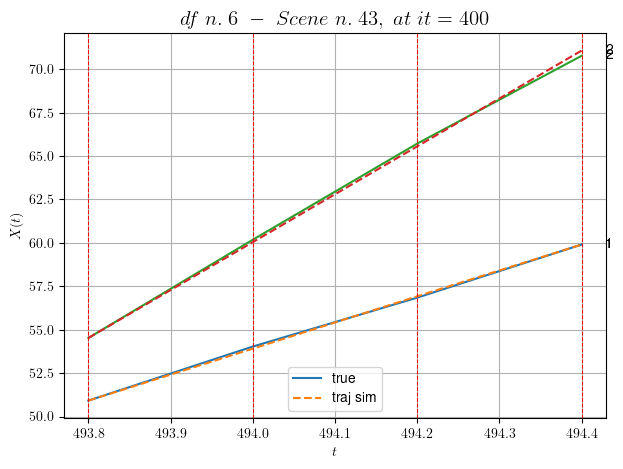

----------------------------------------------------------------------------------------------------
        For scene 31/34:
        * After LR finder: LR_NN=0.005 with mse=0.4860577676281554 at it=24
        * v0 = 27.577027547634234
        * MSE = 0.019474582478708372
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.32/34
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [162.20,163.60]


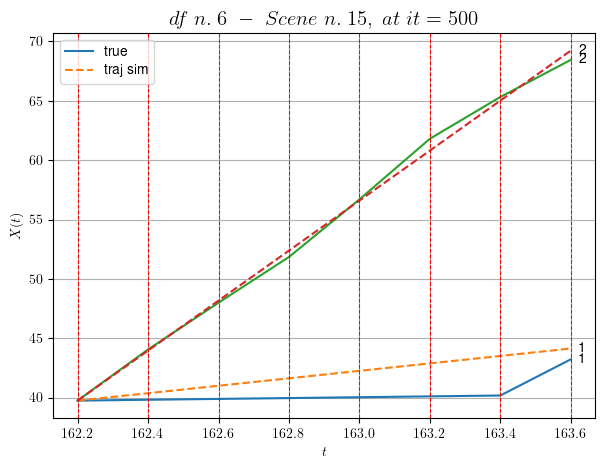

----------------------------------------------------------------------------------------------------
        For scene 32/34:
        * After LR finder: LR_NN=0.0001 with mse=28.82739452274986 at it=24
        * v0 = 21.059787487615633
        * MSE = 1.9346021147798724
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.33/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [368.20,369.20]


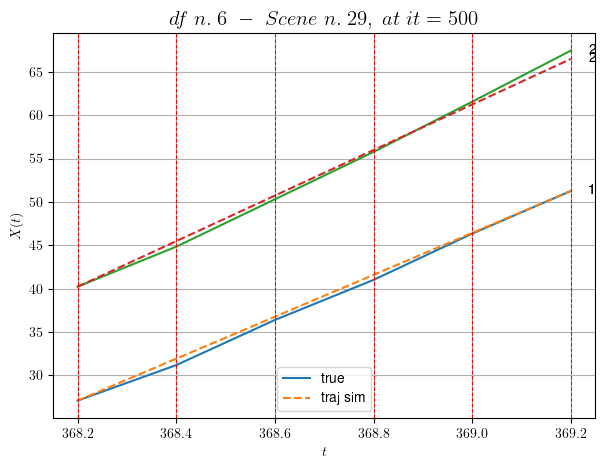

----------------------------------------------------------------------------------------------------
        For scene 33/34:
        * After LR finder: LR_NN=0.0001 with mse=2.2354604265490425 at it=24
        * v0 = 26.26965461417418
        * MSE = 0.20480752697947902
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.34/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [465.20,466.40]


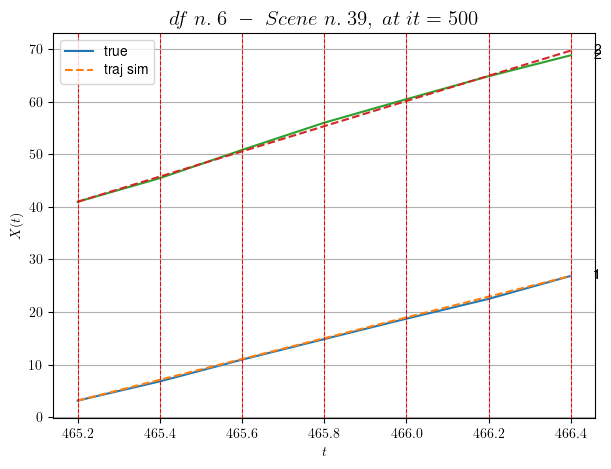

----------------------------------------------------------------------------------------------------
        For scene 34/34:
        * After LR finder: LR_NN=5e-05 with mse=9.99188597490195 at it=24
        * v0 = 23.9569624588022
        * MSE = 0.13398192566547887
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.5486259207891141
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (18 scenes)
DataFrame n.6. Scene n.1/18


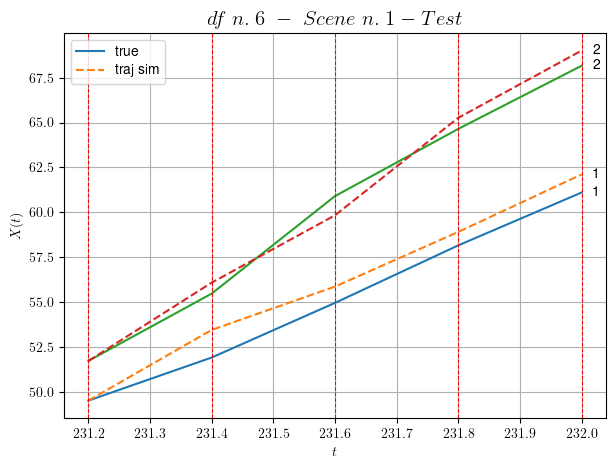

        For scene 1/18:
        * MSE = 0.7376613824611731
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/18


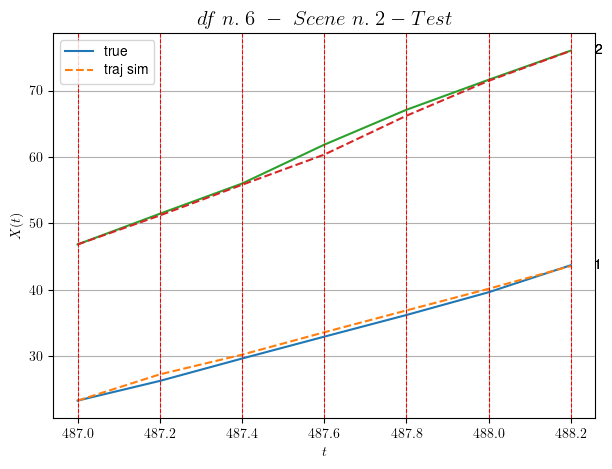

        For scene 2/18:
        * MSE = 0.405595987730791
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/18


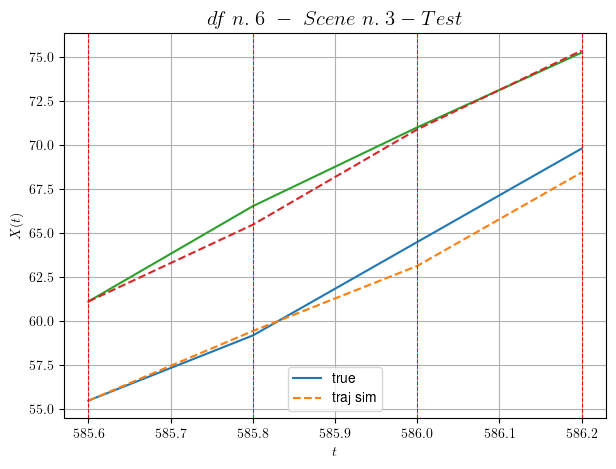

        For scene 3/18:
        * MSE = 0.6102558022392717
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/18


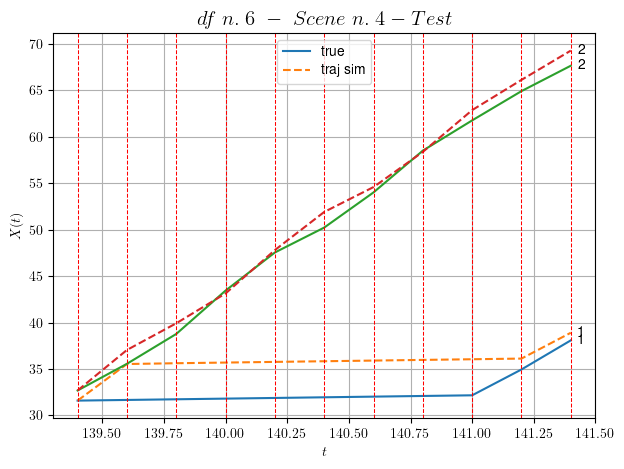

        For scene 4/18:
        * MSE = 6.123858518426268
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/18


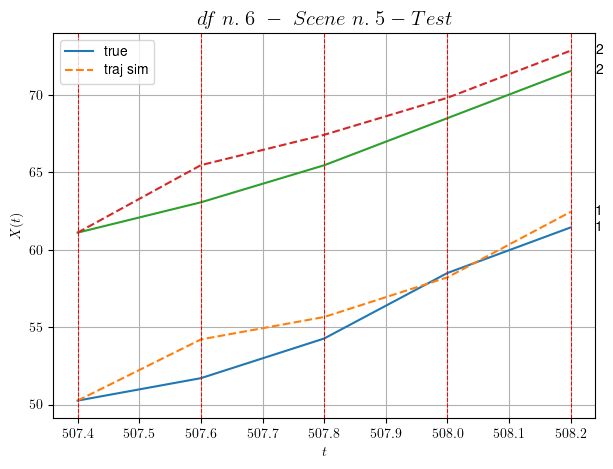

        For scene 5/18:
        * MSE = 2.23958052930701
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.6/18


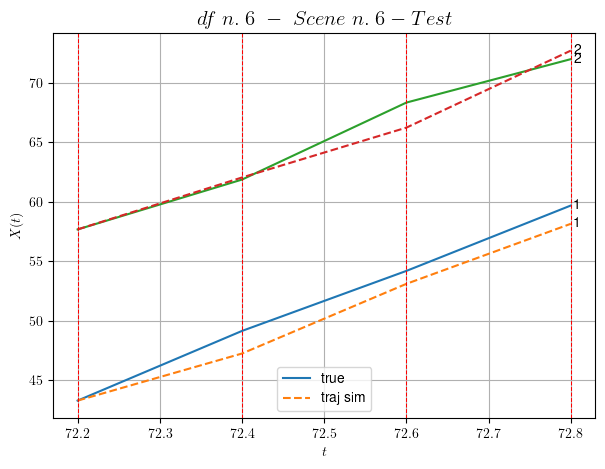

        For scene 6/18:
        * MSE = 1.5126170979150884
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.7/18


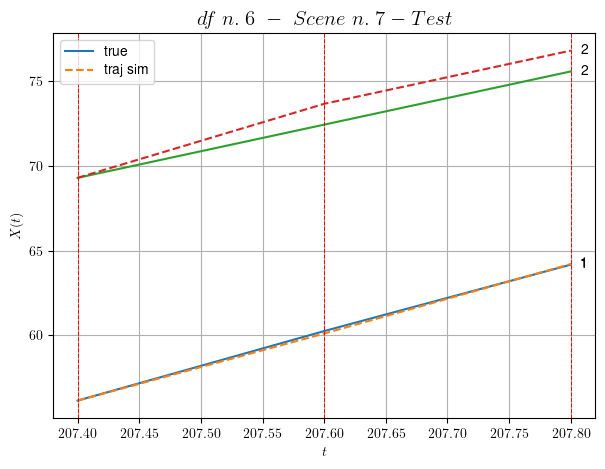

        For scene 7/18:
        * MSE = 0.505472803179311
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.8/18


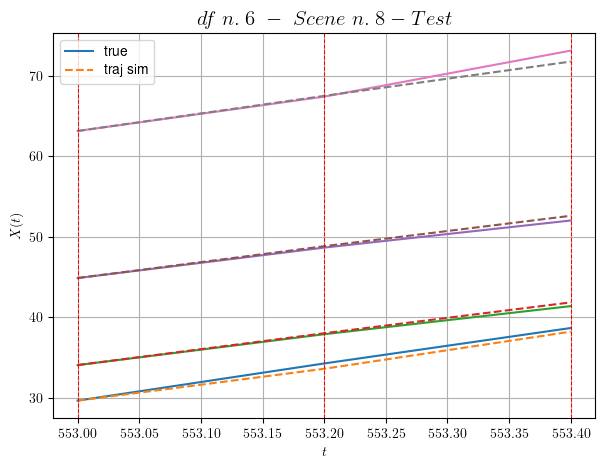

        For scene 8/18:
        * MSE = 0.2580598055640685
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.9/18


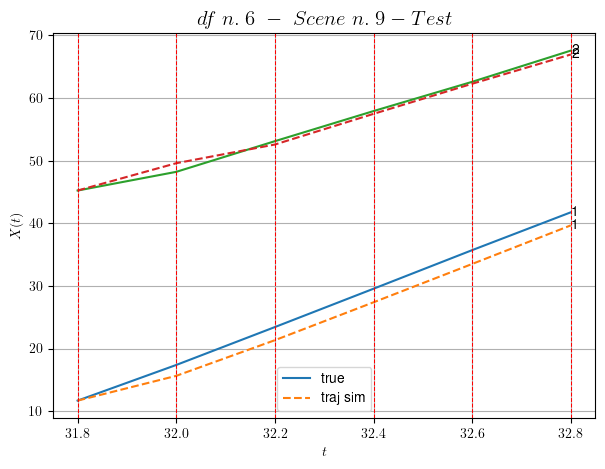

        For scene 9/18:
        * MSE = 2.0152145253057894
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.10/18


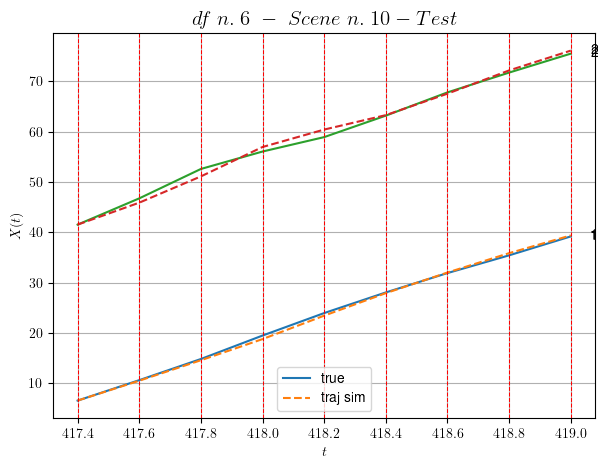

        For scene 10/18:
        * MSE = 0.4265791714291436
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.11/18


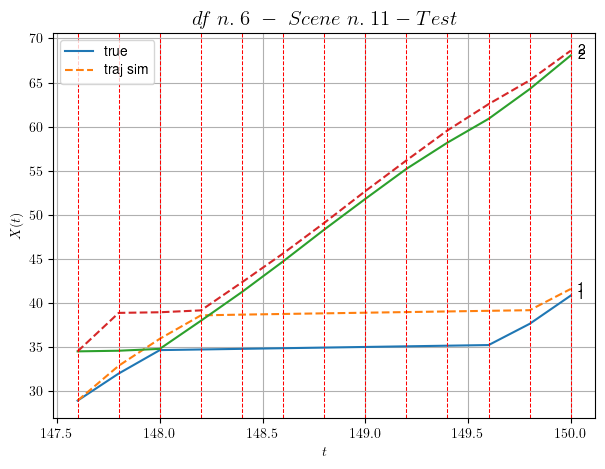

        For scene 11/18:
        * MSE = 6.65710161715384
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.12/18


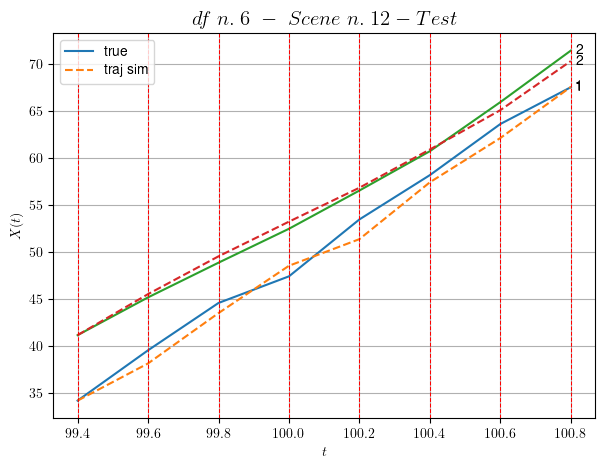

        For scene 12/18:
        * MSE = 0.9255203203232745
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.13/18


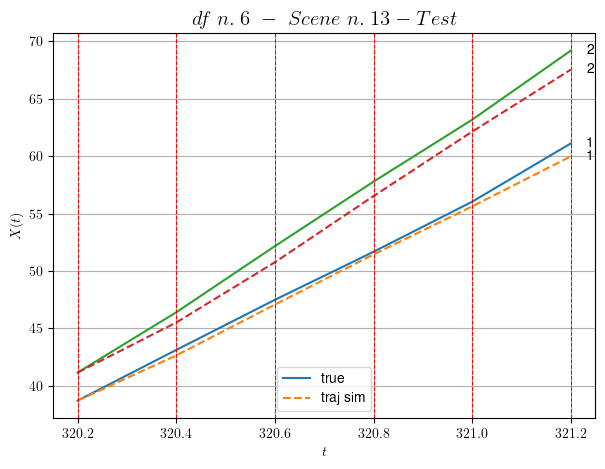

        For scene 13/18:
        * MSE = 0.8384361183826399
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.14/18


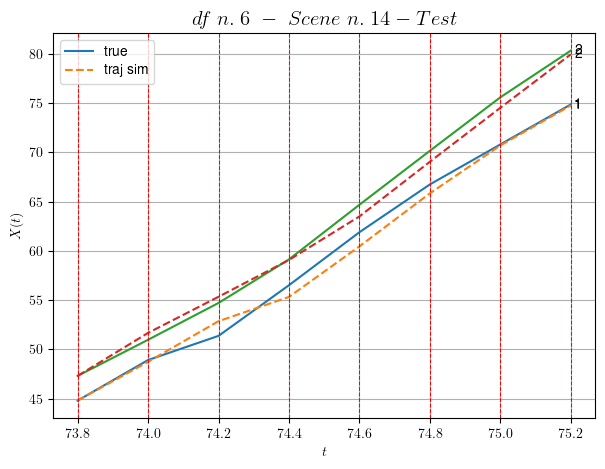

        For scene 14/18:
        * MSE = 0.7095190847433727
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.15/18


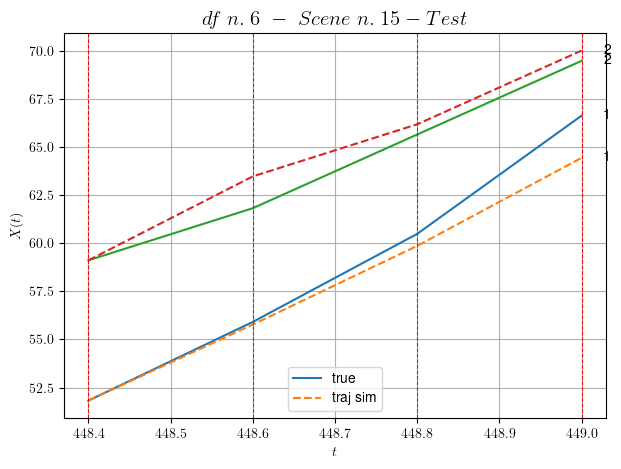

        For scene 15/18:
        * MSE = 1.0636427200504364
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.16/18


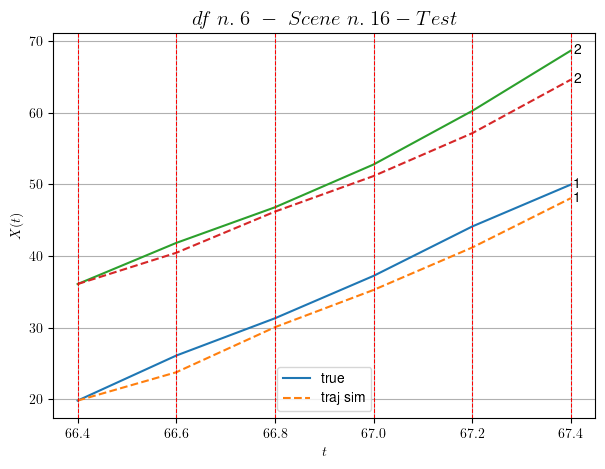

        For scene 16/18:
        * MSE = 4.499169557266386
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.17/18


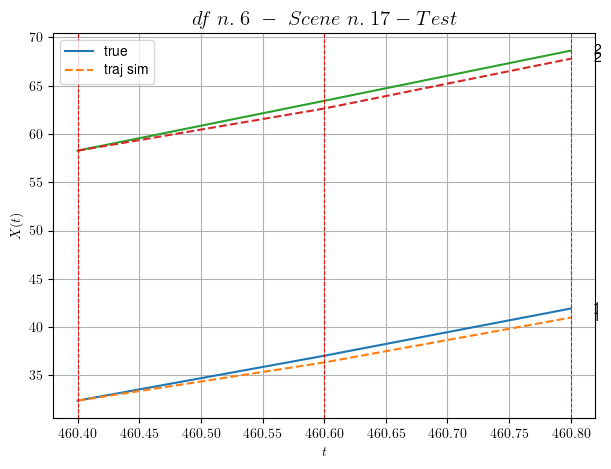

        For scene 17/18:
        * MSE = 0.44948784595807445
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.18/18


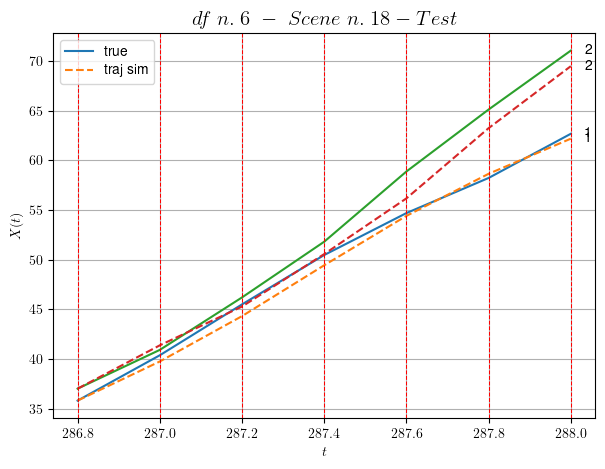

        For scene 18/18:
        * MSE = 1.3746325216245556
----------------------------------------------------------------------------------------------------


MSE test: 1.7418003005033609

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.5486259207891141
          * MSE test: 1.7418003005033609
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 7/10 dfs.
In DataFrame n.7 we have 30 scenes.
    To train the model we use 20 scenes, the remaining 10 to test the model.

Training step. (20 scenes)
DataFrame n.7. Scene n.1/20
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [60.56,61.56]


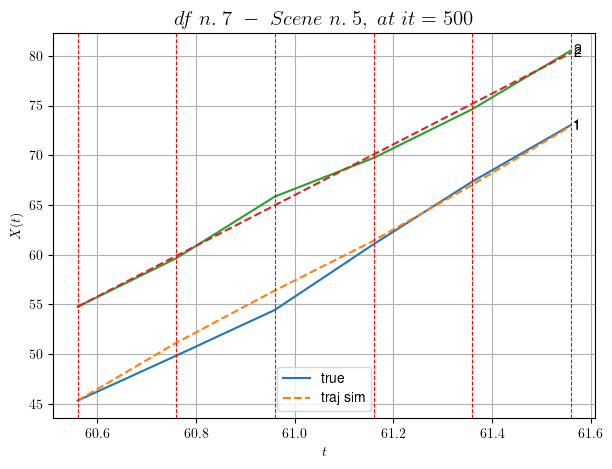

----------------------------------------------------------------------------------------------------
        For scene 1/20:
        * After LR finder: LR_NN=0.01 with mse=4.166707635290502 at it=24
        * v0 = 25.527220166442742
        * MSE = 0.4490054637914698
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [177.76,178.56]


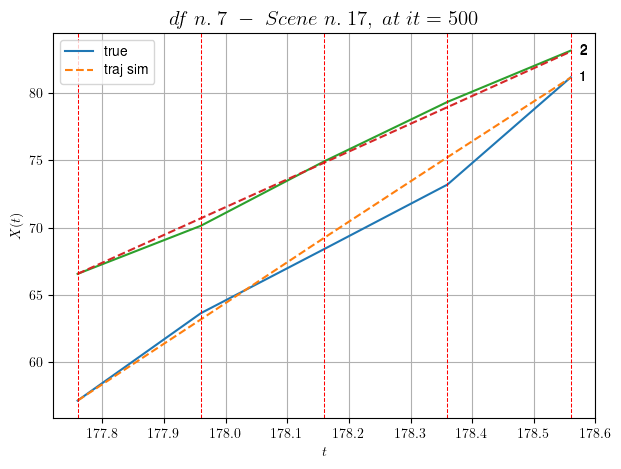

----------------------------------------------------------------------------------------------------
        For scene 2/20:
        * After LR finder: LR_NN=0.001 with mse=10.672988820233433 at it=24
        * v0 = 20.68352620370638
        * MSE = 0.5461005825050061
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [76.36,77.16]


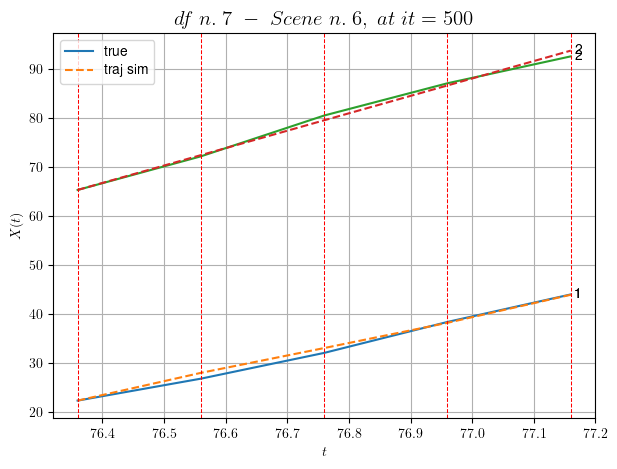

----------------------------------------------------------------------------------------------------
        For scene 3/20:
        * After LR finder: LR_NN=0.01 with mse=3.7654382600185157 at it=24
        * v0 = 35.53676782183333
        * MSE = 0.44281029974506425
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.4/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [154.96,155.56]


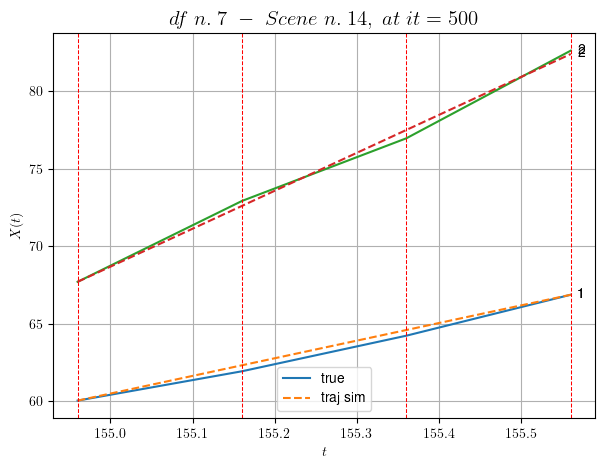

----------------------------------------------------------------------------------------------------
        For scene 4/20:
        * After LR finder: LR_NN=0.0005 with mse=2.2018939568227403 at it=24
        * v0 = 24.52487868148255
        * MSE = 0.09037354296919516
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.5/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [116.96,117.56]


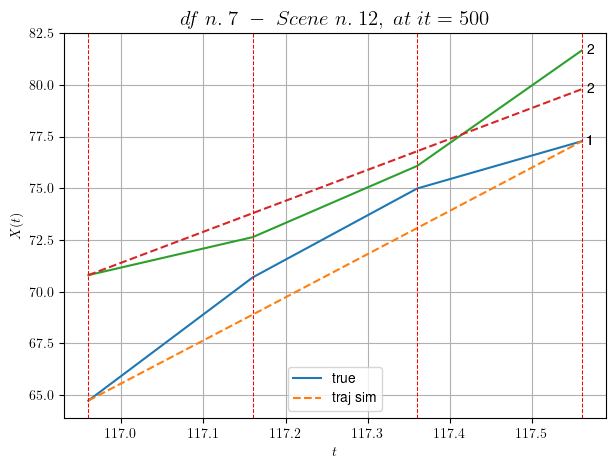

----------------------------------------------------------------------------------------------------
        For scene 5/20:
        * After LR finder: LR_NN=0.0005 with mse=14.370664002014042 at it=24
        * v0 = 14.98164072478226
        * MSE = 1.4768405184366602
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.6/20
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [38.56,38.96]


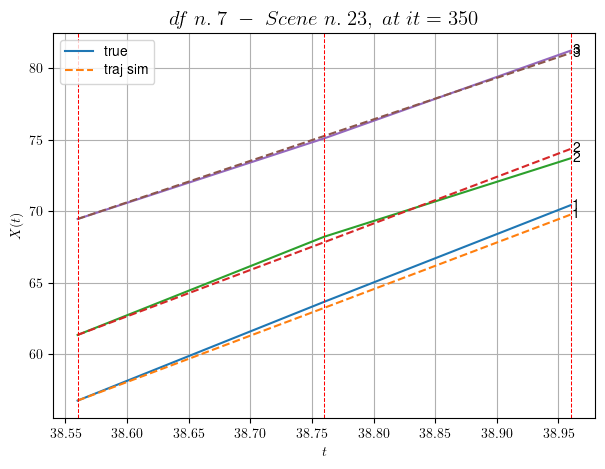

----------------------------------------------------------------------------------------------------
        For scene 6/20:
        * After LR finder: LR_NN=0.001 with mse=0.24527012117022132 at it=24
        * v0 = 28.990017888098407
        * MSE = 0.1380422691833497
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.7/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [43.16,43.76]


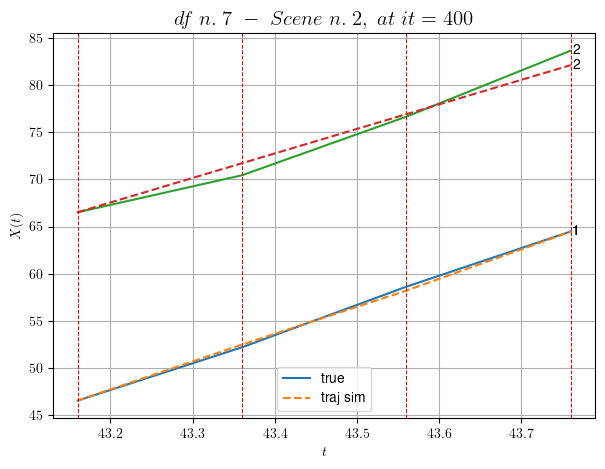

----------------------------------------------------------------------------------------------------
        For scene 7/20:
        * After LR finder: LR_NN=0.01 with mse=1.1486180144937592 at it=24
        * v0 = 25.959463575253086
        * MSE = 0.502101406225878
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.8/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [44.96,46.36]


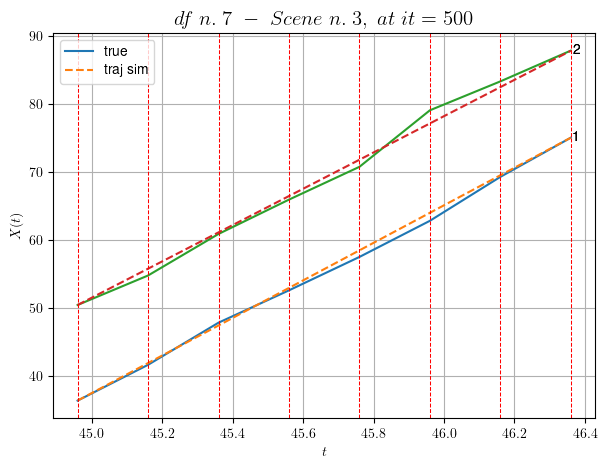

----------------------------------------------------------------------------------------------------
        For scene 8/20:
        * After LR finder: LR_NN=0.0001 with mse=3.7547592454455625 at it=24
        * v0 = 26.65775703593358
        * MSE = 0.586219561929195
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.9/20
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [162.76,163.16]


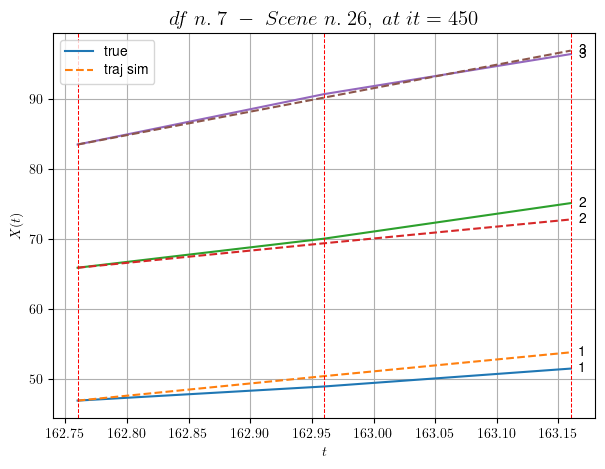

----------------------------------------------------------------------------------------------------
        For scene 9/20:
        * After LR finder: LR_NN=0.005 with mse=1.7574751901474175 at it=24
        * v0 = 33.5145539133131
        * MSE = 1.5483148438886314
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.10/20
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [51.36,52.36]


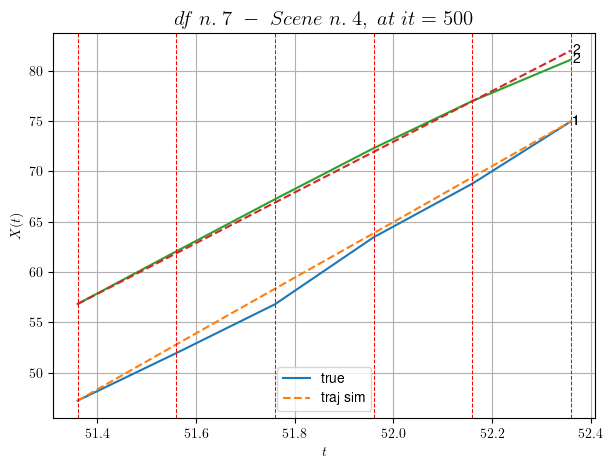

----------------------------------------------------------------------------------------------------
        For scene 10/20:
        * After LR finder: LR_NN=0.001 with mse=5.0459443877967365 at it=24
        * v0 = 25.15874060713298
        * MSE = 0.3941721309283697
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.11/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [226.76,228.16]


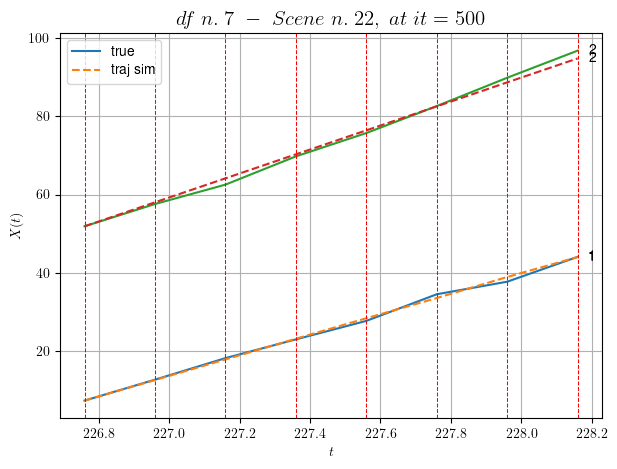

----------------------------------------------------------------------------------------------------
        For scene 11/20:
        * After LR finder: LR_NN=0.005 with mse=1.2472752919213912 at it=24
        * v0 = 30.698361324533188
        * MSE = 0.7439902340252607
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.12/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [165.76,166.36]


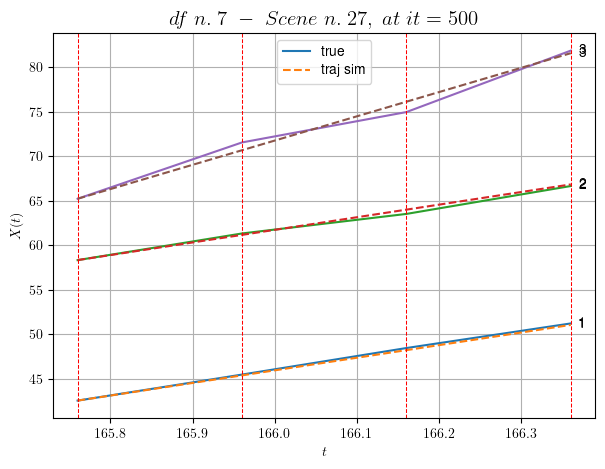

----------------------------------------------------------------------------------------------------
        For scene 12/20:
        * After LR finder: LR_NN=0.0001 with mse=1.6110732325414652 at it=24
        * v0 = 27.262209824915317
        * MSE = 0.21523634965839877
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.13/20
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [190.56,190.96]


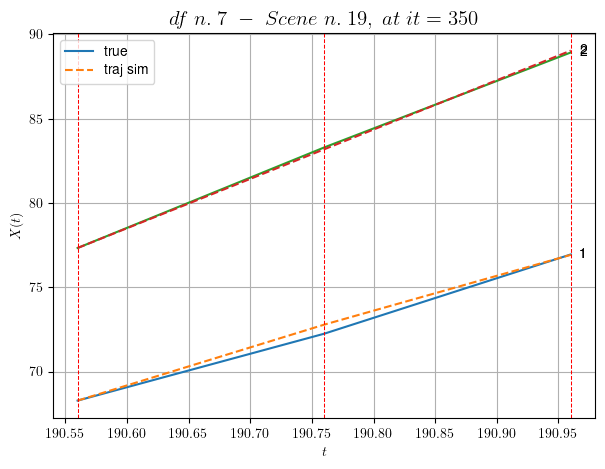

----------------------------------------------------------------------------------------------------
        For scene 13/20:
        * After LR finder: LR_NN=0.01 with mse=0.13394983927770993 at it=24
        * v0 = 29.28362610334117
        * MSE = 0.052434362244148144
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.14/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [166.56,167.36]


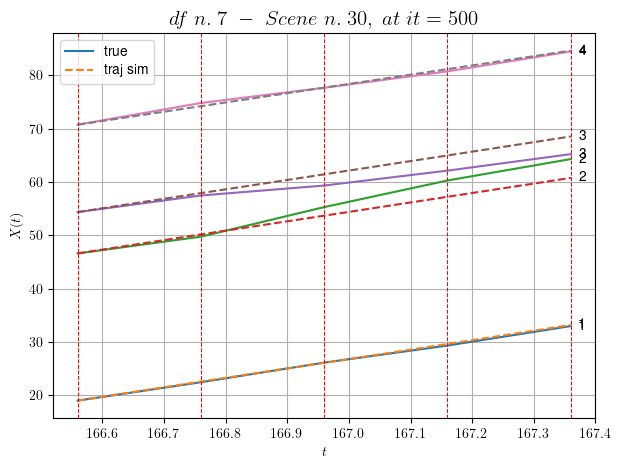

----------------------------------------------------------------------------------------------------
        For scene 14/20:
        * After LR finder: LR_NN=0.005 with mse=12.279512811989717 at it=24
        * v0 = 17.368635969066617
        * MSE = 2.449914531896844
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.15/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [219.96,221.36]


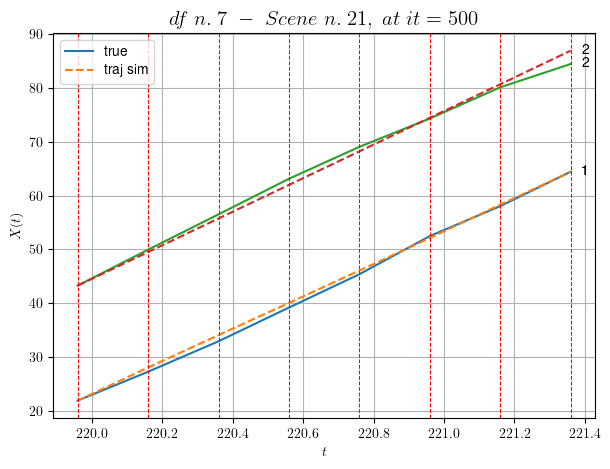

----------------------------------------------------------------------------------------------------
        For scene 15/20:
        * After LR finder: LR_NN=0.005 with mse=0.8744962927212039 at it=24
        * v0 = 31.227007582862946
        * MSE = 0.6664542856927065
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.16/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [86.96,87.56]


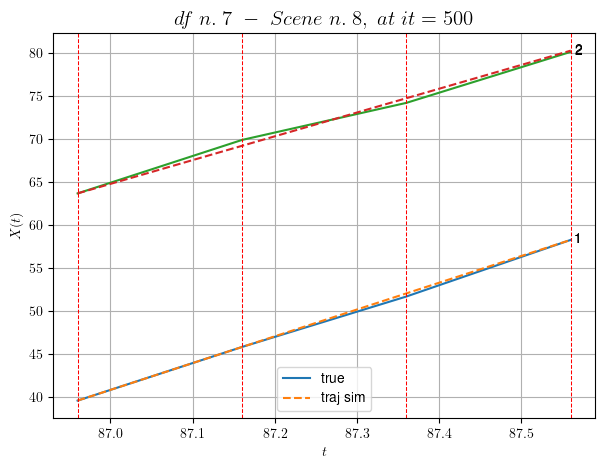

----------------------------------------------------------------------------------------------------
        For scene 16/20:
        * After LR finder: LR_NN=0.0005 with mse=0.6082056611675677 at it=24
        * v0 = 27.633294787015338
        * MSE = 0.11334497157576613
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.17/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [110.96,112.36]


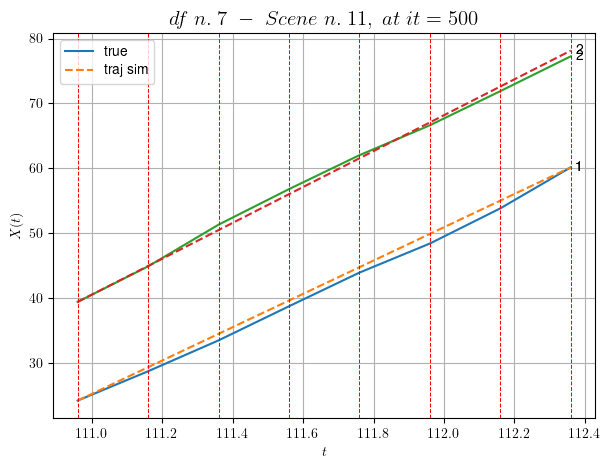

----------------------------------------------------------------------------------------------------
        For scene 17/20:
        * After LR finder: LR_NN=0.0005 with mse=2.68118389447204 at it=24
        * v0 = 27.676256807459275
        * MSE = 0.5952222344359226
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.18/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [162.36,163.16]


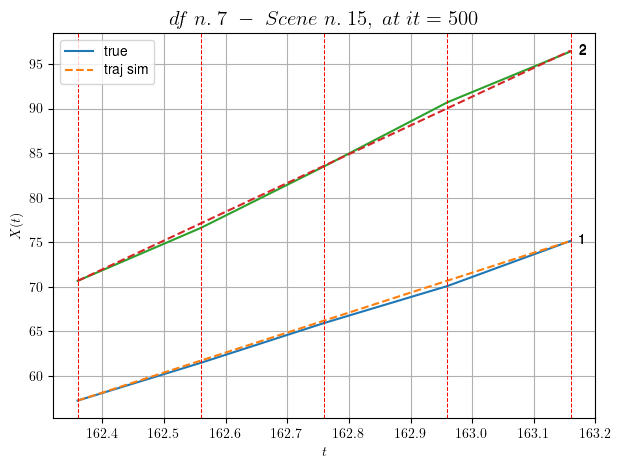

----------------------------------------------------------------------------------------------------
        For scene 18/20:
        * After LR finder: LR_NN=0.001 with mse=0.8406971146923037 at it=24
        * v0 = 32.323787690864414
        * MSE = 0.12119525147413378
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.19/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [206.96,207.56]


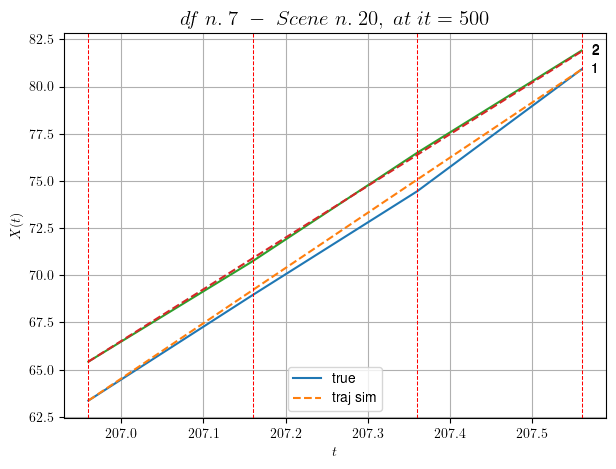

----------------------------------------------------------------------------------------------------
        For scene 19/20:
        * After LR finder: LR_NN=0.0005 with mse=0.5837414867572706 at it=24
        * v0 = 27.399256338800768
        * MSE = 0.06093683744286501
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.20/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [82.16,82.76]


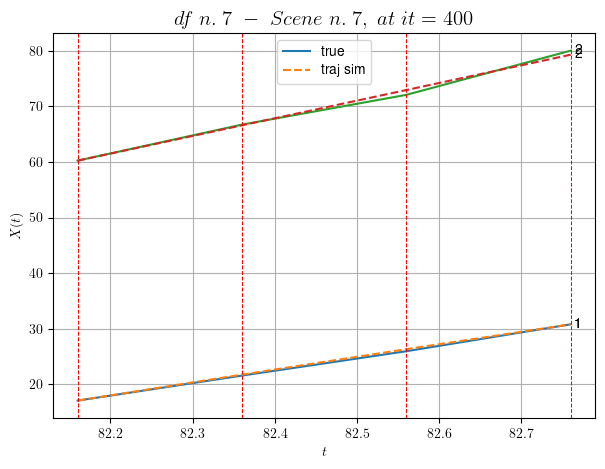

----------------------------------------------------------------------------------------------------
        For scene 20/20:
        * After LR finder: LR_NN=0.01 with mse=0.4782977871132522 at it=24
        * v0 = 31.74543102111279
        * MSE = 0.18331000673136955
        * iterations = 400
----------------------------------------------------------------------------------------------------


MSE train: 0.5688009842390118
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (10 scenes)
DataFrame n.7. Scene n.1/10


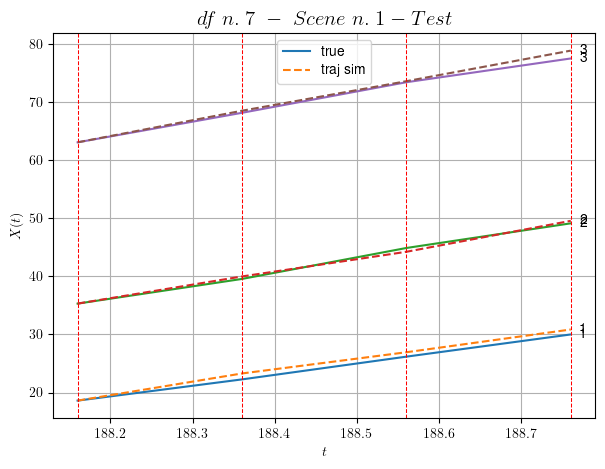

        For scene 1/10:
        * MSE = 0.42698927083544475
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/10


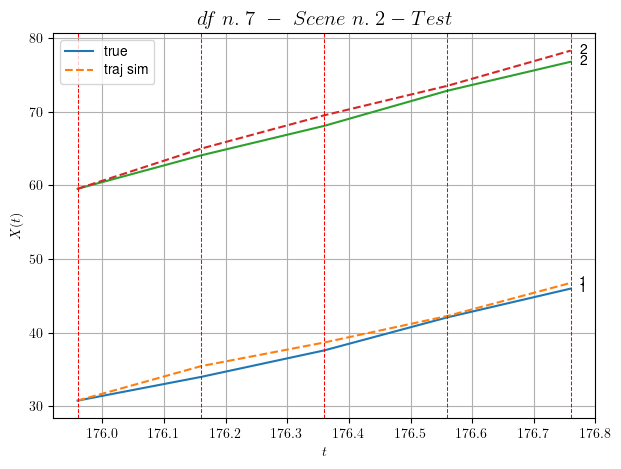

        For scene 2/10:
        * MSE = 0.9531226740092309
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/10


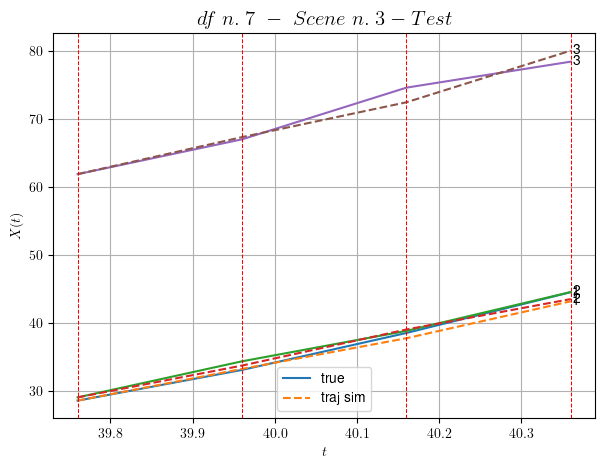

        For scene 3/10:
        * MSE = 0.9400527127702496
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.4/10


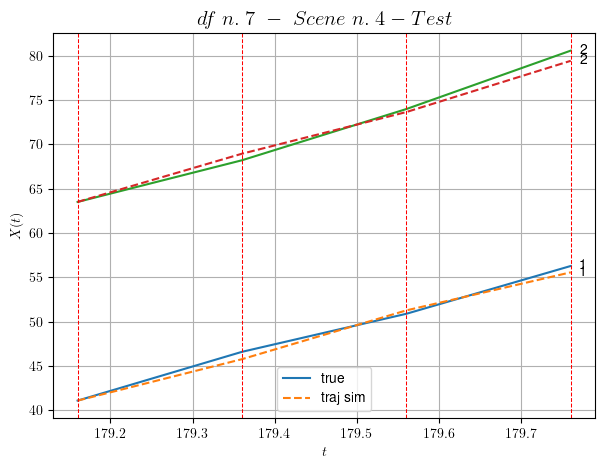

        For scene 4/10:
        * MSE = 0.41582099548453944
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.5/10


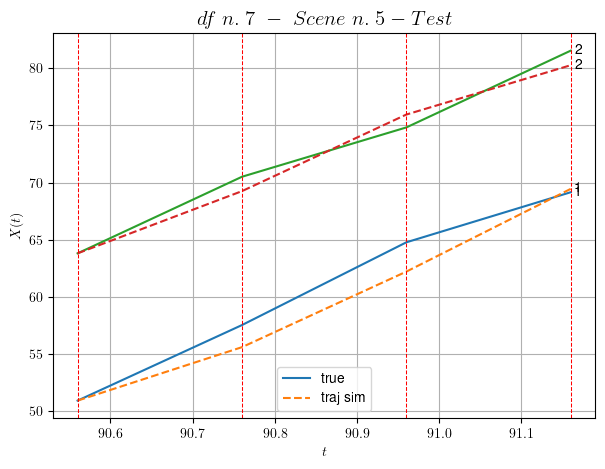

        For scene 5/10:
        * MSE = 1.8582460989955656
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.6/10


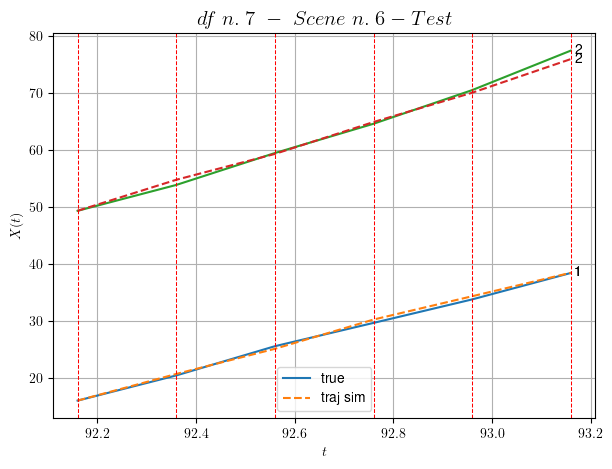

        For scene 6/10:
        * MSE = 0.35757799825211306
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.7/10


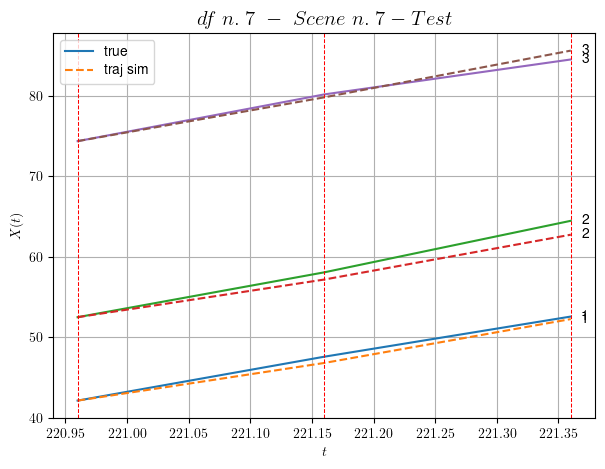

        For scene 7/10:
        * MSE = 0.6475032535134543
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.8/10


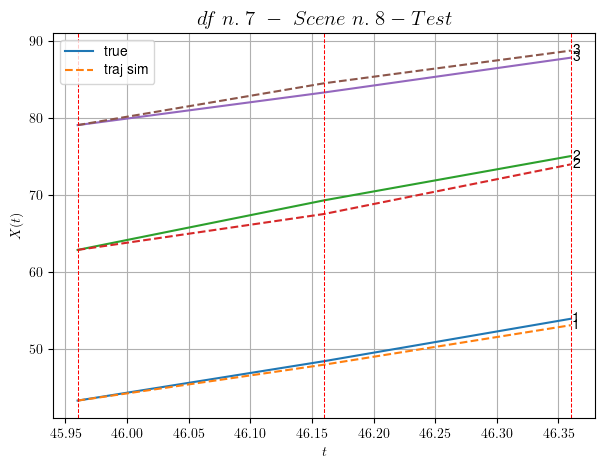

        For scene 8/10:
        * MSE = 0.8332314412796394
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.9/10


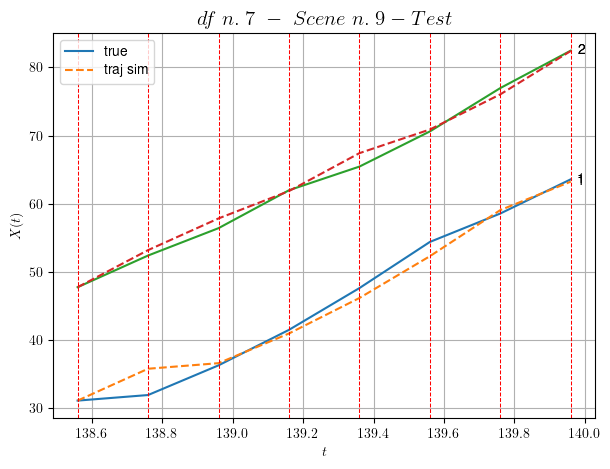

        For scene 9/10:
        * MSE = 1.8516911332553592
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.10/10


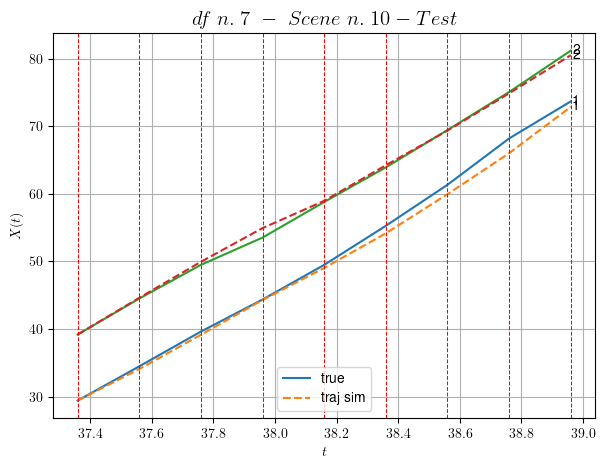

        For scene 10/10:
        * MSE = 0.6680629639447365
----------------------------------------------------------------------------------------------------


MSE test: 0.8952298542340333

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.5688009842390118
          * MSE test: 0.8952298542340333
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 8/10 dfs.
In DataFrame n.8 we have 79 scenes.
    To train the model we use 52 scenes, the remaining 27 to test the model.

Training step. (52 scenes)
DataFrame n.8. Scene n.1/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [574.24,575.04]


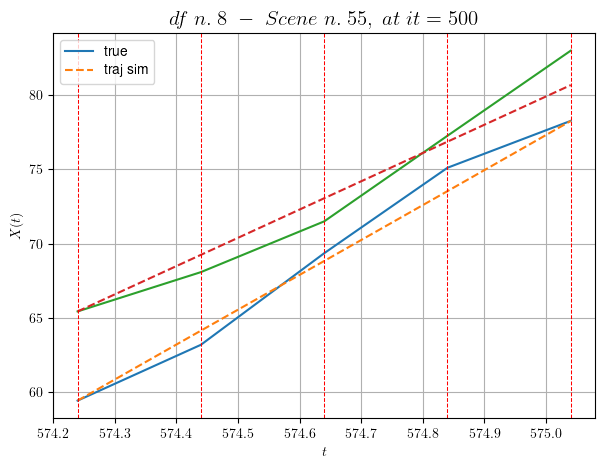

----------------------------------------------------------------------------------------------------
        For scene 1/52:
        * After LR finder: LR_NN=0.0005 with mse=13.133118825110566 at it=24
        * v0 = 19.07774944355215
        * MSE = 1.1880142460624712
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [194.44,194.84]


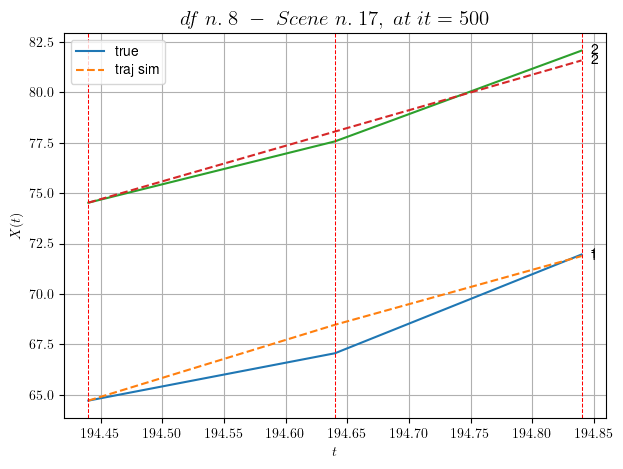

----------------------------------------------------------------------------------------------------
        For scene 2/52:
        * After LR finder: LR_NN=0.005 with mse=5.288993999812434 at it=24
        * v0 = 17.64870499817804
        * MSE = 0.40335430135006434
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/52
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [458.64,460.24]


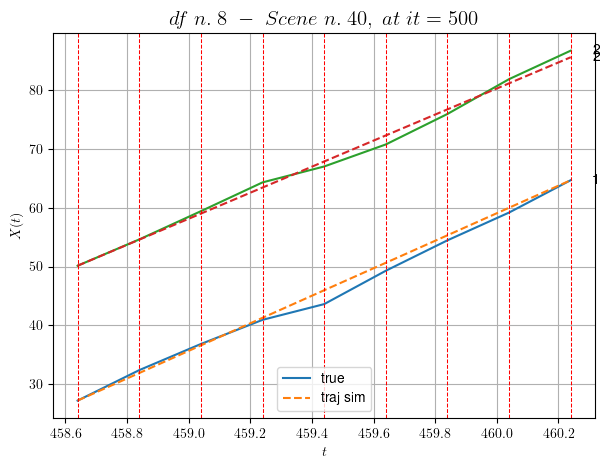

----------------------------------------------------------------------------------------------------
        For scene 3/52:
        * After LR finder: LR_NN=0.0005 with mse=28.326750139575655 at it=24
        * v0 = 22.184785448498722
        * MSE = 0.8652412924567534
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [587.44,587.84]


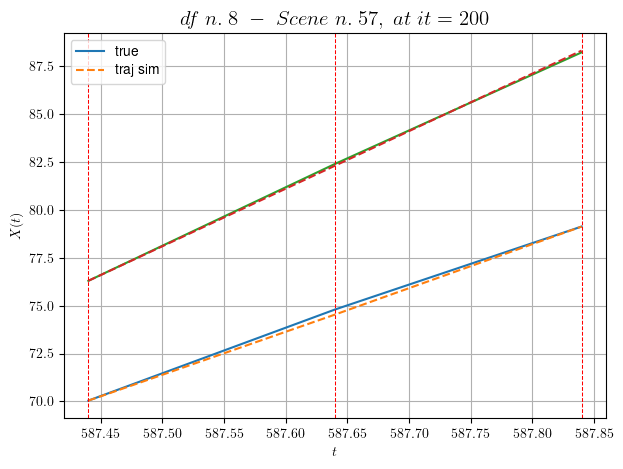

----------------------------------------------------------------------------------------------------
        For scene 4/52:
        * After LR finder: LR_NN=0.005 with mse=0.019576298944355586 at it=24
        * v0 = 30.037169893910686
        * MSE = 0.011556136423479186
        * iterations = 200
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [256.44,257.24]


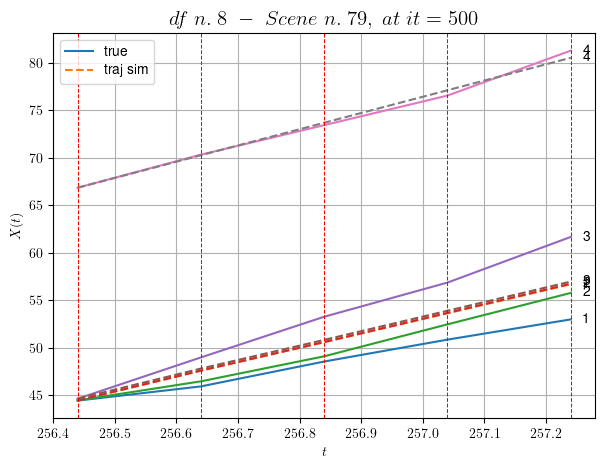

----------------------------------------------------------------------------------------------------
        For scene 5/52:
        * After LR finder: LR_NN=0.01 with mse=12.282529568908984 at it=24
        * v0 = 17.104258674666134
        * MSE = 3.6716506691525206
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [105.04,105.64]


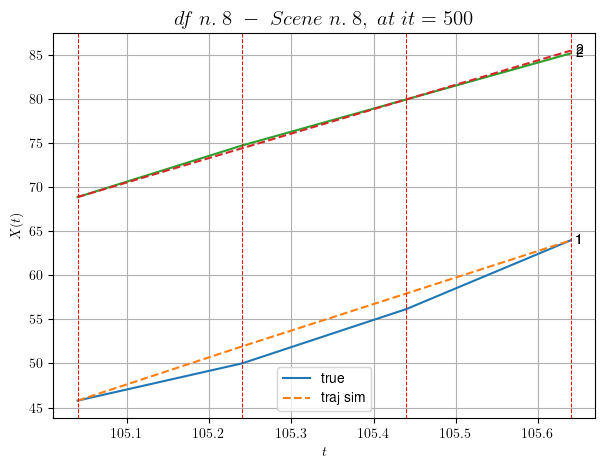

----------------------------------------------------------------------------------------------------
        For scene 6/52:
        * After LR finder: LR_NN=0.001 with mse=1.6533457643119784 at it=24
        * v0 = 27.68802462182384
        * MSE = 0.8475548248120547
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [531.84,532.84]


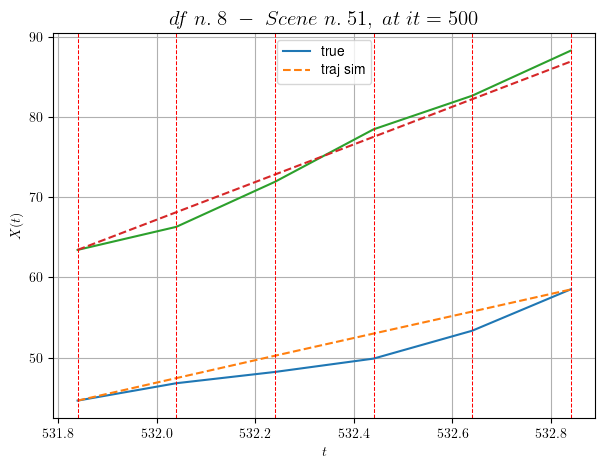

----------------------------------------------------------------------------------------------------
        For scene 7/52:
        * After LR finder: LR_NN=0.001 with mse=8.103429322377586 at it=24
        * v0 = 23.472410774642476
        * MSE = 2.2151002566034856
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.8/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [548.04,549.44]


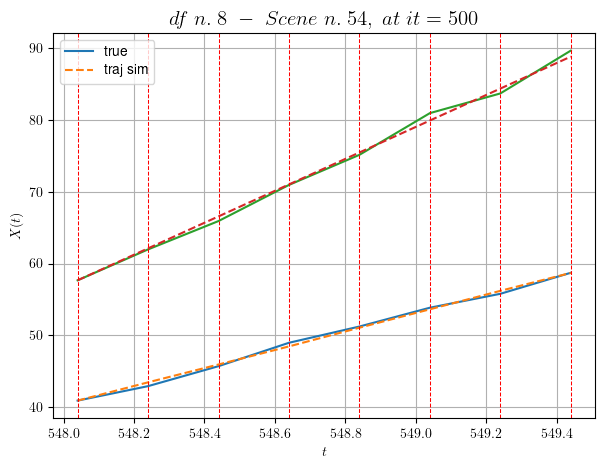

----------------------------------------------------------------------------------------------------
        For scene 8/52:
        * After LR finder: LR_NN=0.01 with mse=20.307425475307404 at it=24
        * v0 = 22.28422335728387
        * MSE = 0.22639748432516218
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.9/52
----------------------------------------------------------------------------------------------------
We have 11 time intervals inside [250.44,252.64]


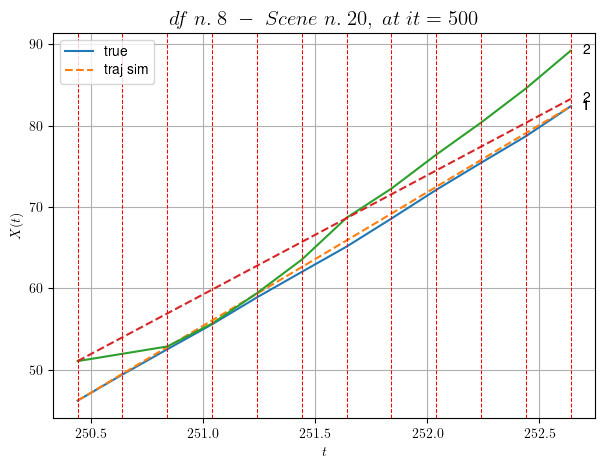

----------------------------------------------------------------------------------------------------
        For scene 9/52:
        * After LR finder: LR_NN=0.0005 with mse=176.29440445524898 at it=24
        * v0 = 14.644824448517854
        * MSE = 4.142084994555913
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.10/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [227.04,227.84]


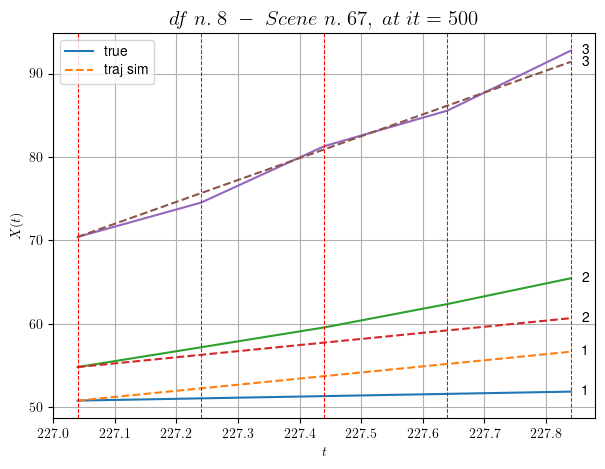

----------------------------------------------------------------------------------------------------
        For scene 10/52:
        * After LR finder: LR_NN=0.001 with mse=2.8609412034459947 at it=24
        * v0 = 26.24315546538644
        * MSE = 5.551093626169746
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.11/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [319.44,320.44]


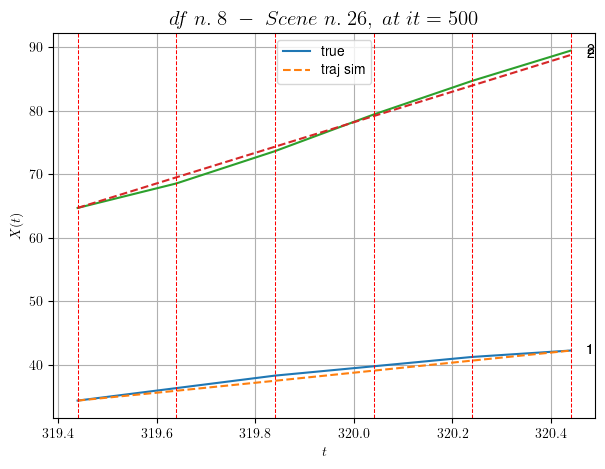

----------------------------------------------------------------------------------------------------
        For scene 11/52:
        * After LR finder: LR_NN=0.005 with mse=5.865835451785871 at it=24
        * v0 = 24.072557838554268
        * MSE = 0.3215683542201093
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.12/52
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [496.44,498.84]


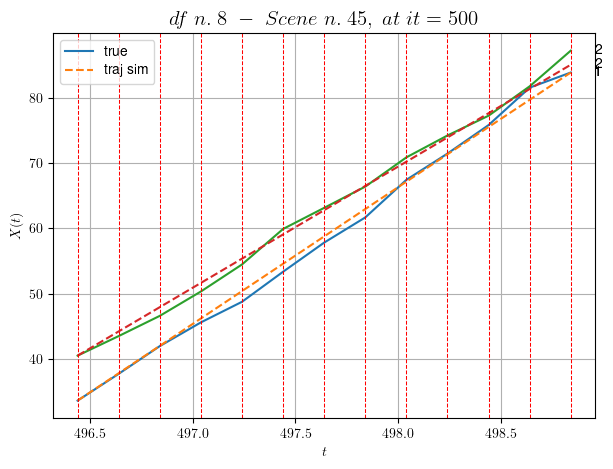

----------------------------------------------------------------------------------------------------
        For scene 12/52:
        * After LR finder: LR_NN=0.0005 with mse=127.09782629942357 at it=24
        * v0 = 18.546831523765686
        * MSE = 0.7906010686327023
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.13/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [176.24,176.64]


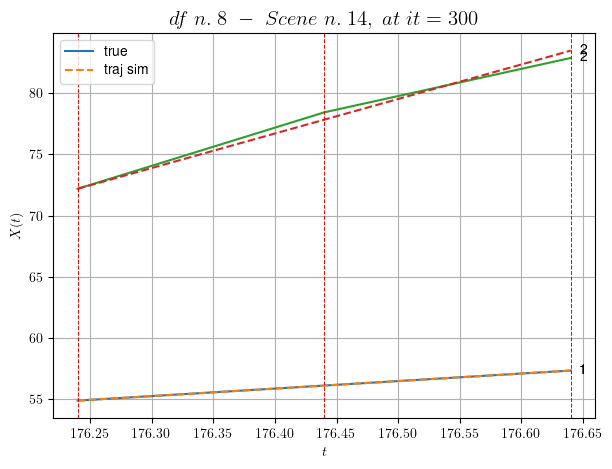

----------------------------------------------------------------------------------------------------
        For scene 13/52:
        * After LR finder: LR_NN=0.005 with mse=0.29776902427795837 at it=24
        * v0 = 28.209764281783194
        * MSE = 0.1194826217611233
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.14/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [477.84,478.84]


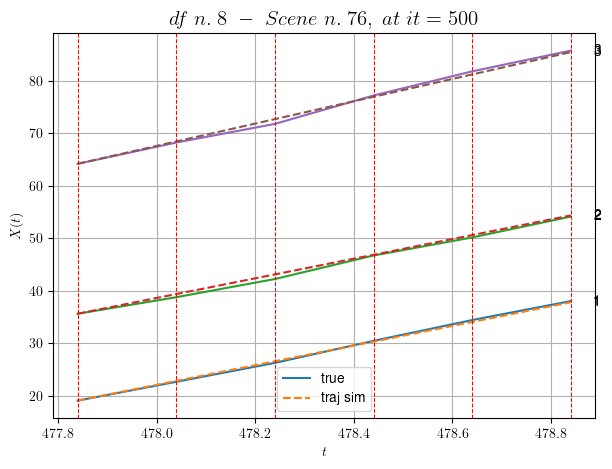

----------------------------------------------------------------------------------------------------
        For scene 14/52:
        * After LR finder: LR_NN=0.001 with mse=9.010325196278158 at it=24
        * v0 = 21.26815930217752
        * MSE = 0.16496119823832114
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.15/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [58.44,59.84]


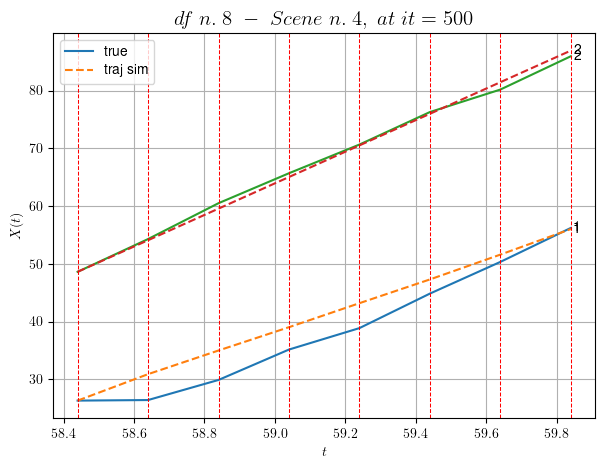

----------------------------------------------------------------------------------------------------
        For scene 15/52:
        * After LR finder: LR_NN=0.005 with mse=7.537099348030755 at it=24
        * v0 = 27.356016886559175
        * MSE = 4.751173471469416
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.16/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [197.84,198.64]


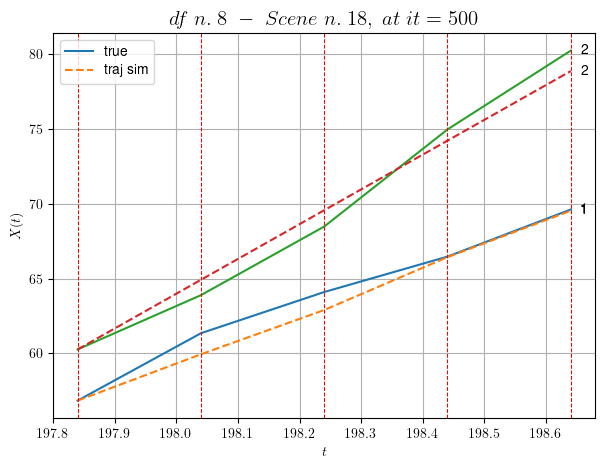

----------------------------------------------------------------------------------------------------
        For scene 16/52:
        * After LR finder: LR_NN=0.01 with mse=4.9622831701741745 at it=24
        * v0 = 23.275091763732032
        * MSE = 0.685960925478464
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.17/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [456.44,457.24]


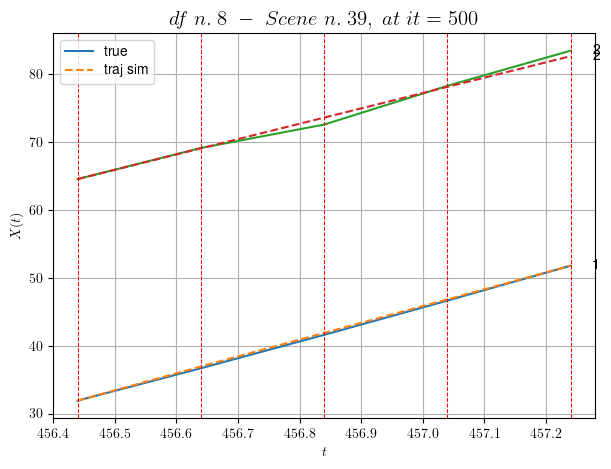

----------------------------------------------------------------------------------------------------
        For scene 17/52:
        * After LR finder: LR_NN=0.005 with mse=6.1888521440062165 at it=24
        * v0 = 22.637249688333306
        * MSE = 0.18419020845742284
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.18/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [116.04,116.44]


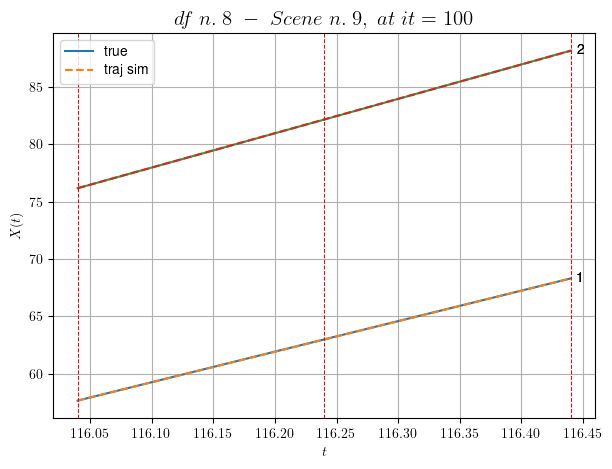

----------------------------------------------------------------------------------------------------
        For scene 18/52:
        * After LR finder: LR_NN=0.005 with mse=5.709254782937528e-05 at it=24
        * v0 = 29.990567491624347
        * MSE = 6.375158021453926e-05
        * iterations = 100
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.19/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [225.24,226.24]


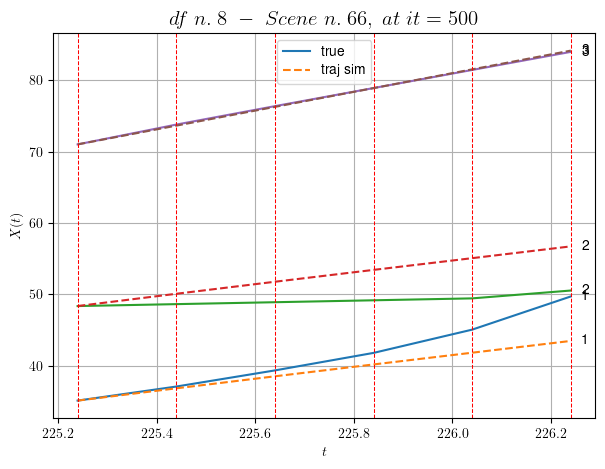

----------------------------------------------------------------------------------------------------
        For scene 19/52:
        * After LR finder: LR_NN=0.005 with mse=43.30009973953667 at it=24
        * v0 = 13.143683398703466
        * MSE = 8.397887260060566
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.20/52
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [101.04,103.04]


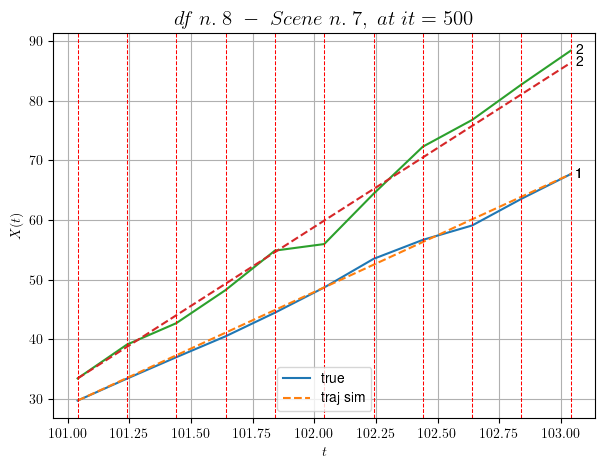

----------------------------------------------------------------------------------------------------
        For scene 20/52:
        * After LR finder: LR_NN=0.001 with mse=8.442097738331555 at it=24
        * v0 = 26.48969548240825
        * MSE = 1.4377177642520476
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.21/52
----------------------------------------------------------------------------------------------------
We have 14 time intervals inside [445.44,448.24]


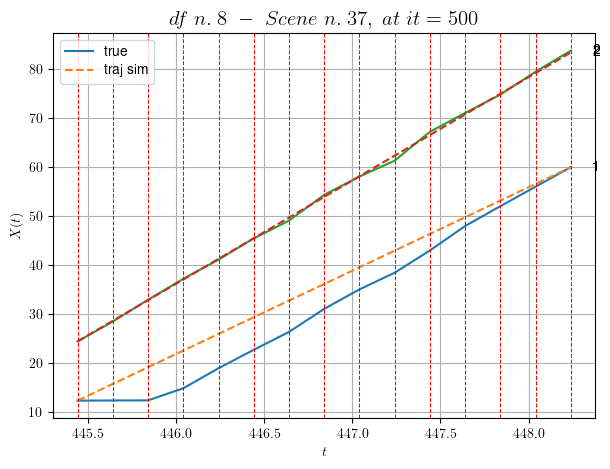

----------------------------------------------------------------------------------------------------
        For scene 21/52:
        * After LR finder: LR_NN=0.0005 with mse=109.20913757722961 at it=24
        * v0 = 21.040373735870276
        * MSE = 10.81091366466607
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.22/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [350.64,351.64]


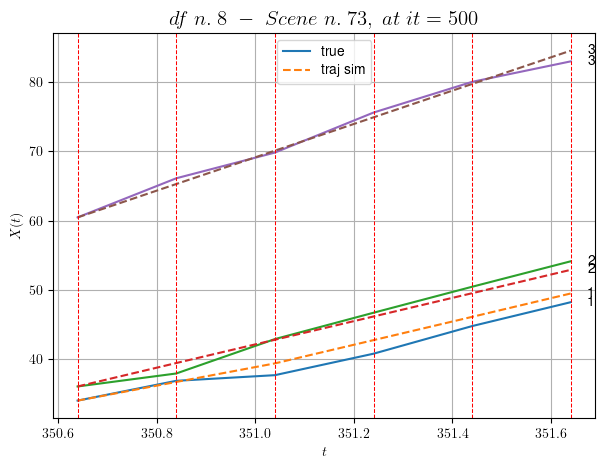

----------------------------------------------------------------------------------------------------
        For scene 22/52:
        * After LR finder: LR_NN=0.001 with mse=6.332869098531645 at it=24
        * v0 = 24.01755603165807
        * MSE = 1.0400246960915758
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.23/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [36.44,37.04]


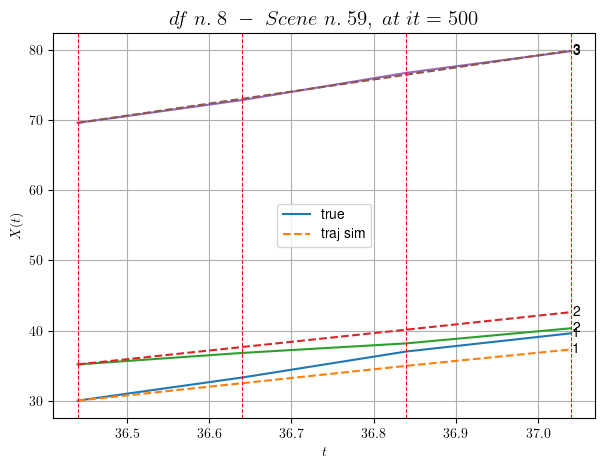

----------------------------------------------------------------------------------------------------
        For scene 23/52:
        * After LR finder: LR_NN=0.01 with mse=9.175707549619561 at it=24
        * v0 = 17.156795934620774
        * MSE = 1.6664224634126867
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.24/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [516.64,517.44]


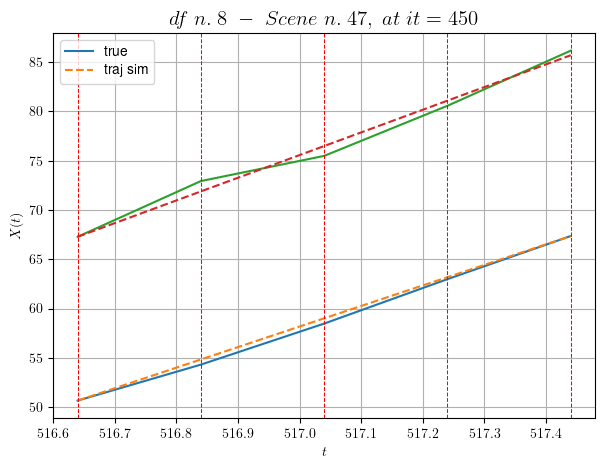

----------------------------------------------------------------------------------------------------
        For scene 24/52:
        * After LR finder: LR_NN=0.0001 with mse=6.343556321983376 at it=24
        * v0 = 23.019463892475212
        * MSE = 0.30410868398193336
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.25/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [593.04,594.44]


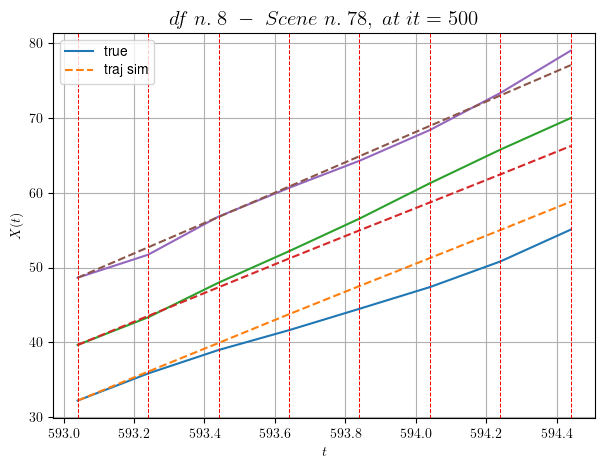

----------------------------------------------------------------------------------------------------
        For scene 25/52:
        * After LR finder: LR_NN=0.01 with mse=24.755431844412186 at it=24
        * v0 = 20.297836048726356
        * MSE = 4.263491240747519
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.26/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [190.84,191.84]


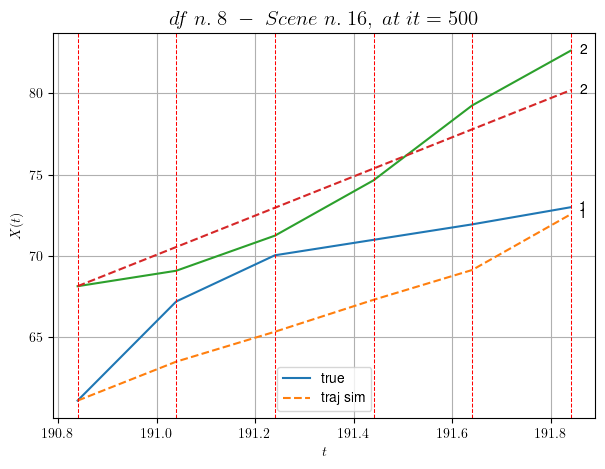

----------------------------------------------------------------------------------------------------
        For scene 26/52:
        * After LR finder: LR_NN=0.01 with mse=58.02535387695425 at it=24
        * v0 = 12.068548421445684
        * MSE = 5.912218970257092
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.27/52
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [327.84,329.64]


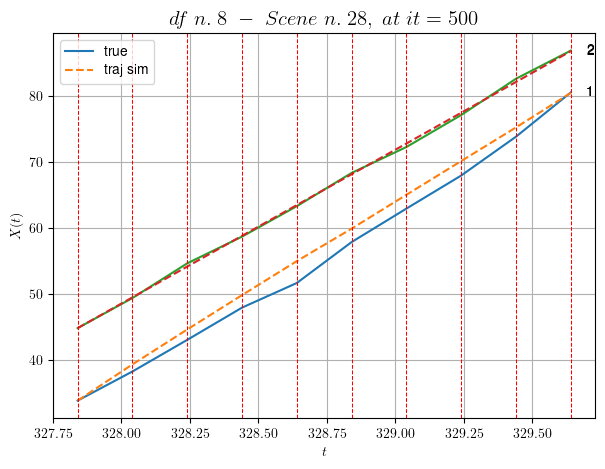

----------------------------------------------------------------------------------------------------
        For scene 27/52:
        * After LR finder: LR_NN=0.01 with mse=26.448479437656406 at it=24
        * v0 = 23.318084130195473
        * MSE = 1.2206664191305958
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.28/52
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [488.24,490.04]


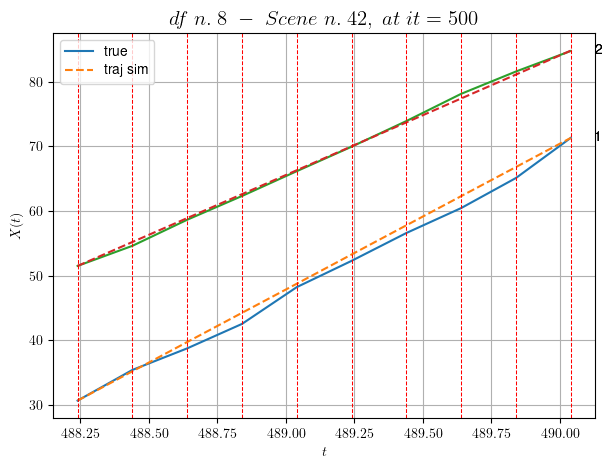

----------------------------------------------------------------------------------------------------
        For scene 28/52:
        * After LR finder: LR_NN=0.001 with mse=74.56405737906118 at it=24
        * v0 = 18.510799599163768
        * MSE = 0.7077832458828854
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.29/52
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [323.44,325.04]


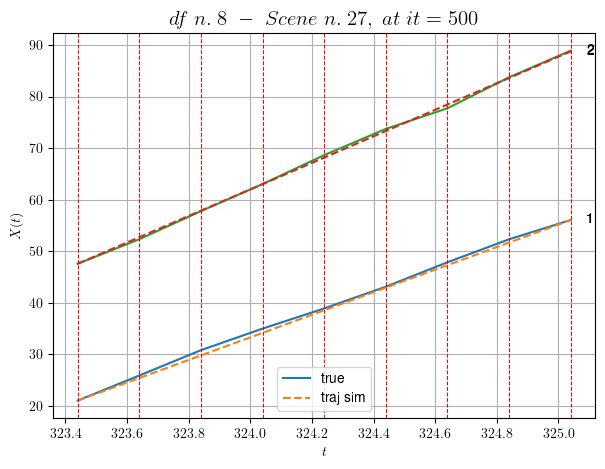

----------------------------------------------------------------------------------------------------
        For scene 29/52:
        * After LR finder: LR_NN=0.0005 with mse=8.271922895640508 at it=24
        * v0 = 25.75837440986028
        * MSE = 0.2229404905723168
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.30/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [521.04,522.44]


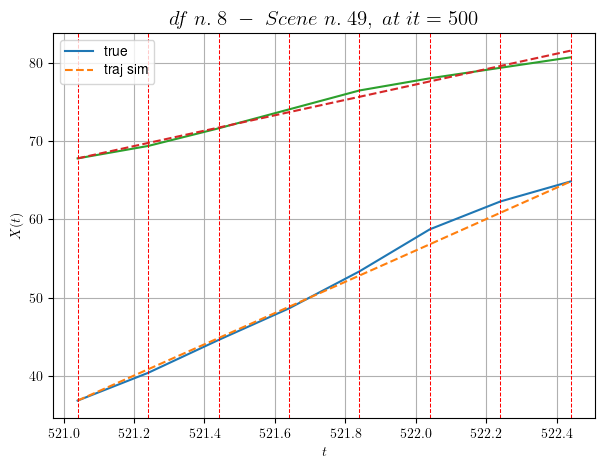

----------------------------------------------------------------------------------------------------
        For scene 30/52:
        * After LR finder: LR_NN=0.0005 with mse=143.54654216112408 at it=24
        * v0 = 9.856007983844846
        * MSE = 0.5137194019090938
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.31/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [313.24,313.64]


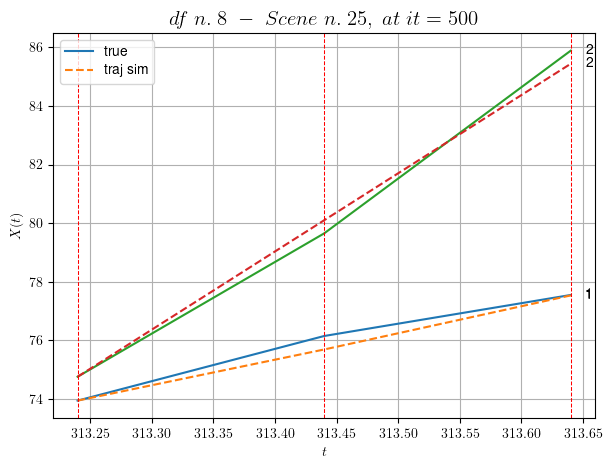

----------------------------------------------------------------------------------------------------
        For scene 31/52:
        * After LR finder: LR_NN=0.01 with mse=0.33247832984558173 at it=24
        * v0 = 26.698670162295386
        * MSE = 0.09960998757478931
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.32/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [494.44,495.84]


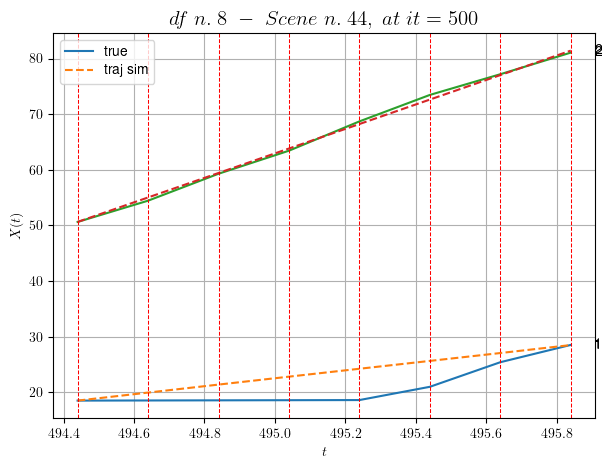

----------------------------------------------------------------------------------------------------
        For scene 32/52:
        * After LR finder: LR_NN=0.001 with mse=24.958249779824197 at it=24
        * v0 = 22.008439992316802
        * MSE = 5.300003828217102
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.33/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [522.64,523.04]


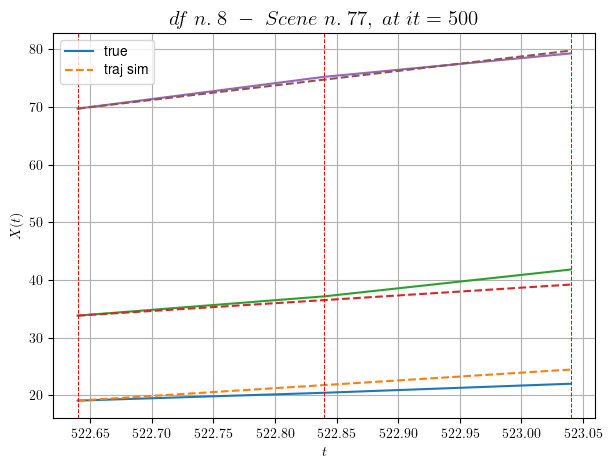

----------------------------------------------------------------------------------------------------
        For scene 33/52:
        * After LR finder: LR_NN=0.0001 with mse=0.889978464842096 at it=24
        * v0 = 25.155972882596156
        * MSE = 1.7264114510317725
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.34/52
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [592.84,594.44]


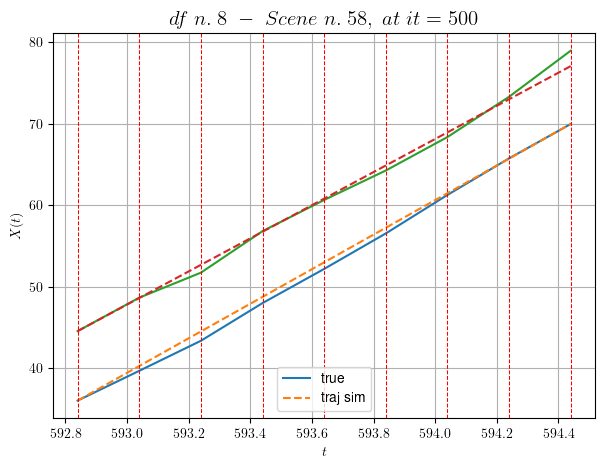

----------------------------------------------------------------------------------------------------
        For scene 34/52:
        * After LR finder: LR_NN=0.0005 with mse=40.803289011552465 at it=24
        * v0 = 20.354057423513243
        * MSE = 0.4681011306244717
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.35/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [154.24,154.84]


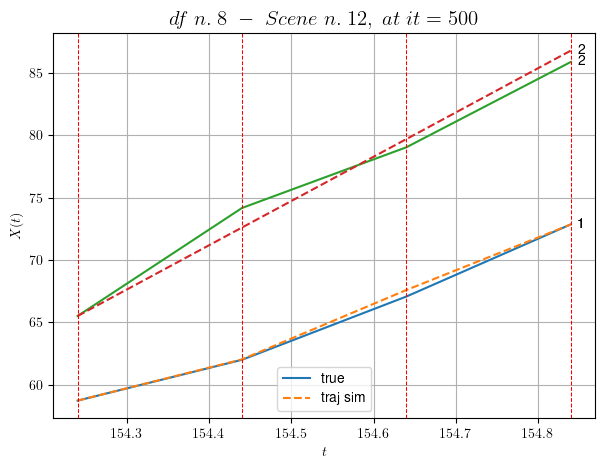

----------------------------------------------------------------------------------------------------
        For scene 35/52:
        * After LR finder: LR_NN=0.005 with mse=2.3871075987534383 at it=24
        * v0 = 35.440393347036846
        * MSE = 0.4985653193425101
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.36/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [404.84,405.44]


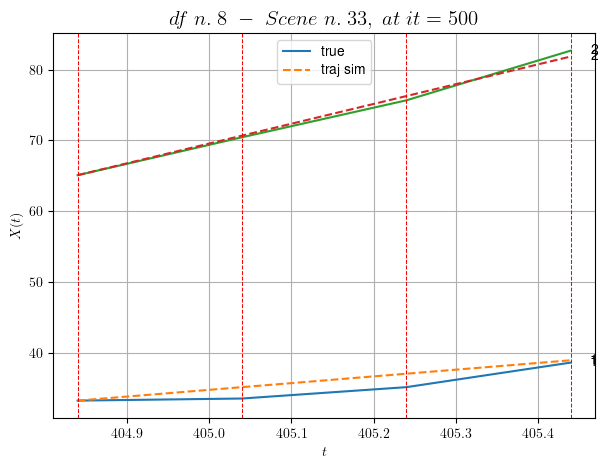

----------------------------------------------------------------------------------------------------
        For scene 36/52:
        * After LR finder: LR_NN=5e-05 with mse=1.0021852883169136 at it=24
        * v0 = 27.902766852719747
        * MSE = 0.9214911663165044
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.37/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [414.44,414.84]


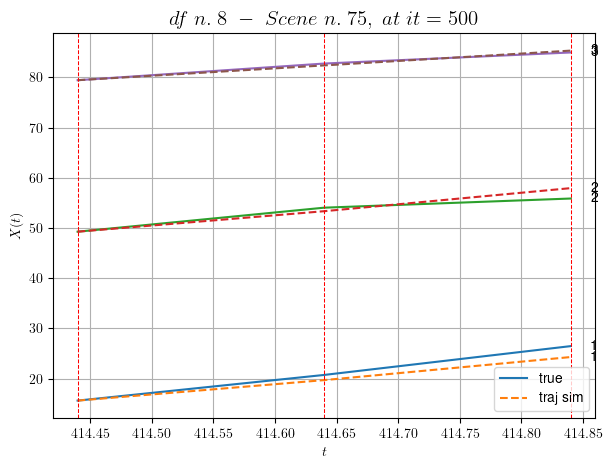

----------------------------------------------------------------------------------------------------
        For scene 37/52:
        * After LR finder: LR_NN=0.01 with mse=6.708704043637044 at it=24
        * v0 = 14.740228637605732
        * MSE = 1.202324289168647
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.38/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [50.24,51.04]


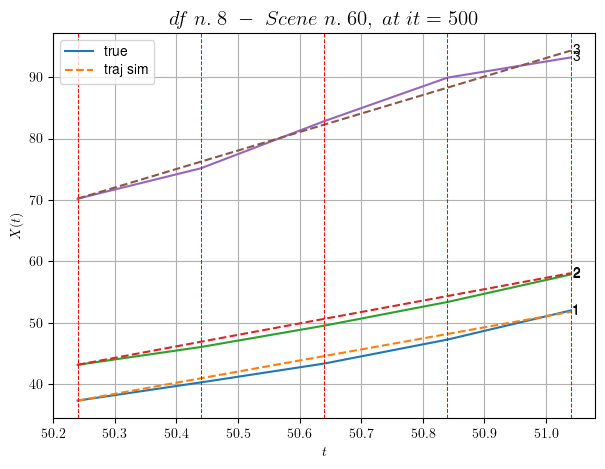

----------------------------------------------------------------------------------------------------
        For scene 38/52:
        * After LR finder: LR_NN=0.001 with mse=0.9819320414913587 at it=24
        * v0 = 30.157660974110765
        * MSE = 0.7406666273154506
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.39/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [215.24,216.24]


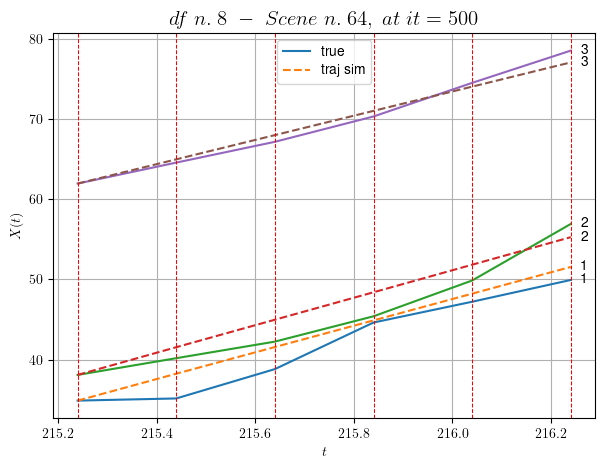

----------------------------------------------------------------------------------------------------
        For scene 39/52:
        * After LR finder: LR_NN=0.0005 with mse=28.005318214985284 at it=24
        * v0 = 15.100689610550168
        * MSE = 2.7124021279775463
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.40/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [243.44,244.24]


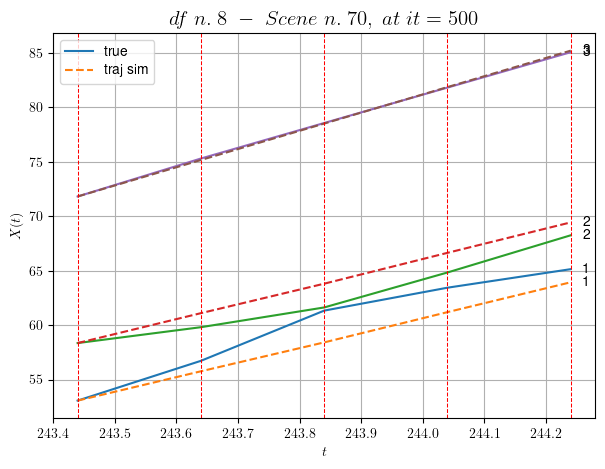

----------------------------------------------------------------------------------------------------
        For scene 40/52:
        * After LR finder: LR_NN=0.01 with mse=16.218019940735005 at it=24
        * v0 = 16.742914270050964
        * MSE = 1.802157738340332
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.41/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [453.64,454.24]


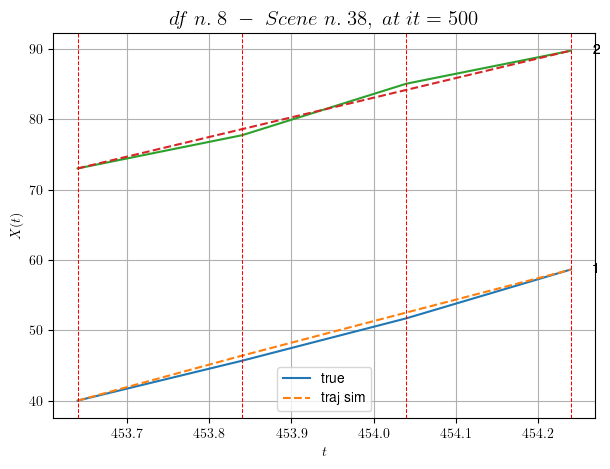

----------------------------------------------------------------------------------------------------
        For scene 41/52:
        * After LR finder: LR_NN=0.005 with mse=0.6444582954301024 at it=24
        * v0 = 27.920103284426535
        * MSE = 0.3379469872105596
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.42/52
----------------------------------------------------------------------------------------------------
We have 14 time intervals inside [366.64,369.44]


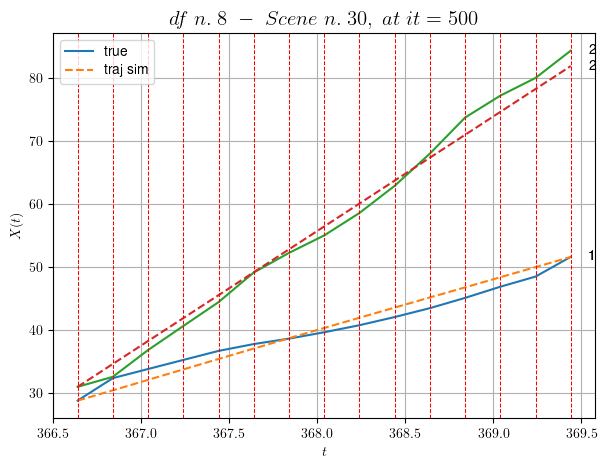

----------------------------------------------------------------------------------------------------
        For scene 42/52:
        * After LR finder: LR_NN=0.01 with mse=177.80636406583224 at it=24
        * v0 = 18.211190440756237
        * MSE = 1.6025669930253497
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.43/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [28.44,29.24]


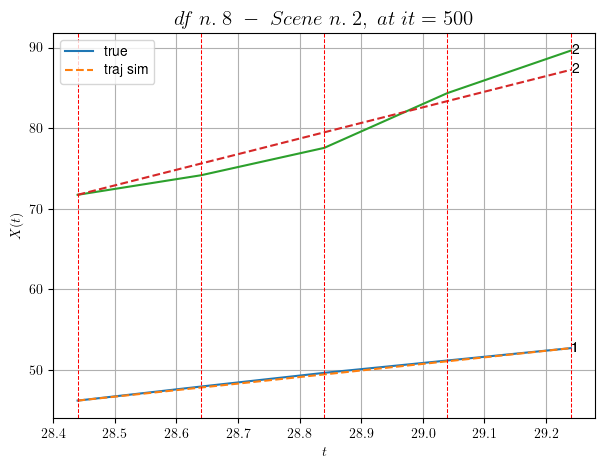

----------------------------------------------------------------------------------------------------
        For scene 43/52:
        * After LR finder: LR_NN=0.005 with mse=11.739488680143376 at it=24
        * v0 = 19.374312728051596
        * MSE = 1.084260942780391
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.44/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [545.44,545.84]


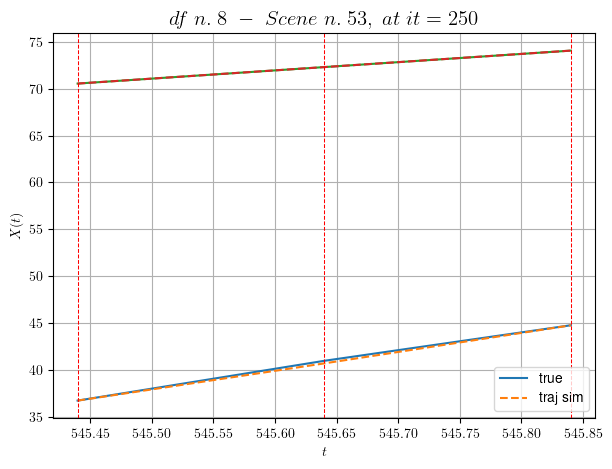

----------------------------------------------------------------------------------------------------
        For scene 44/52:
        * After LR finder: LR_NN=0.005 with mse=15.010269792671776 at it=24
        * v0 = 8.800949247288097
        * MSE = 0.012279401000686098
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.45/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [278.64,279.64]


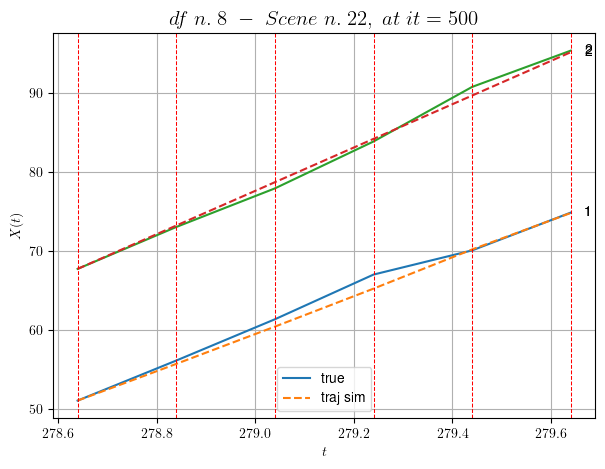

----------------------------------------------------------------------------------------------------
        For scene 45/52:
        * After LR finder: LR_NN=0.005 with mse=1.6614020644810414 at it=24
        * v0 = 27.407259315733175
        * MSE = 0.5085904270375055
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.46/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [48.04,48.84]


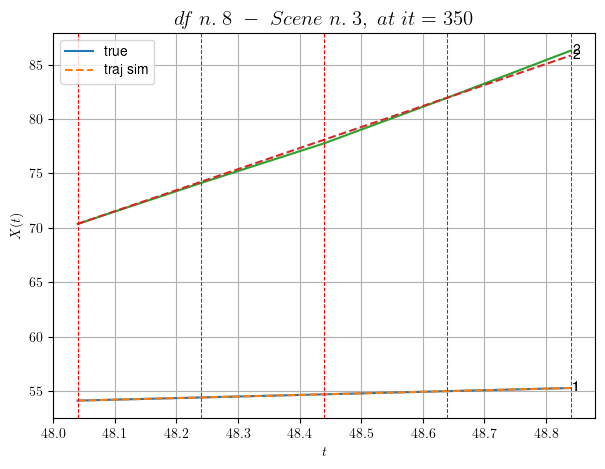

----------------------------------------------------------------------------------------------------
        For scene 46/52:
        * After LR finder: LR_NN=0.01 with mse=13.178570096679293 at it=24
        * v0 = 19.366199429857964
        * MSE = 0.02887728133290928
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.47/52
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [283.84,285.04]


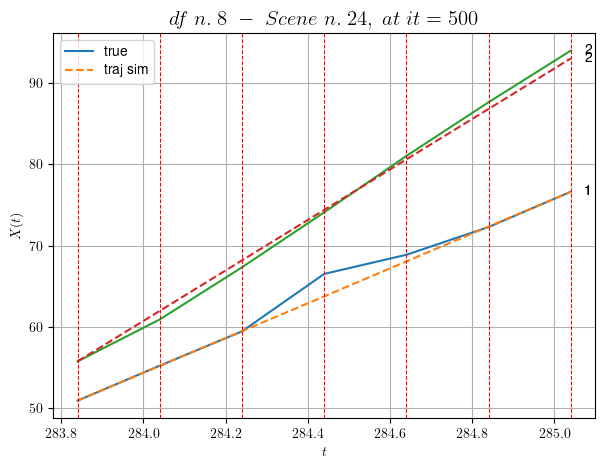

----------------------------------------------------------------------------------------------------
        For scene 47/52:
        * After LR finder: LR_NN=0.0005 with mse=1.4981453456533447 at it=24
        * v0 = 31.024373752742626
        * MSE = 0.8526205700628776
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.48/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [276.64,277.64]


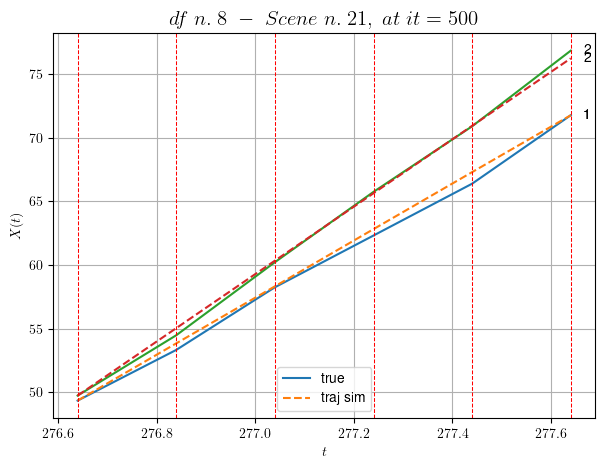

----------------------------------------------------------------------------------------------------
        For scene 48/52:
        * After LR finder: LR_NN=0.001 with mse=2.1881781526628945 at it=24
        * v0 = 26.49050884606435
        * MSE = 0.16883631146299066
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.49/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [102.24,103.04]


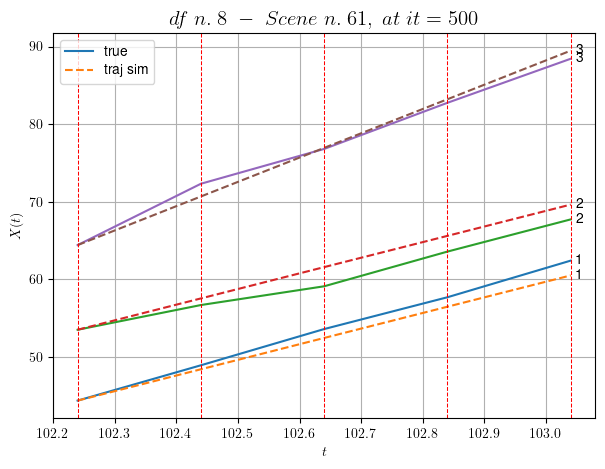

----------------------------------------------------------------------------------------------------
        For scene 49/52:
        * After LR finder: LR_NN=0.0005 with mse=1.6486295290201864 at it=24
        * v0 = 31.34829198332158
        * MSE = 1.6579761198614662
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.50/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [290.84,291.44]


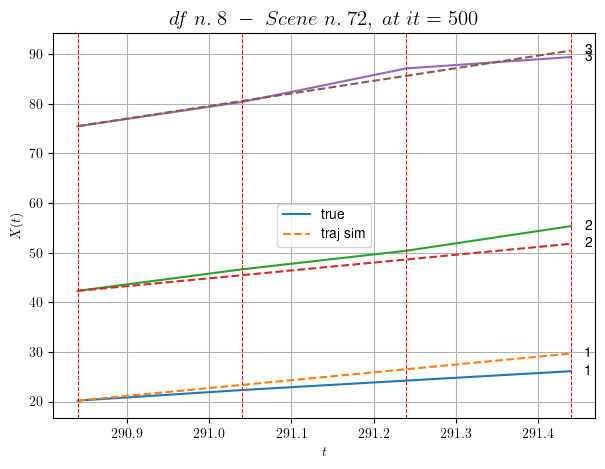

----------------------------------------------------------------------------------------------------
        For scene 50/52:
        * After LR finder: LR_NN=0.001 with mse=2.4308403069918194 at it=24
        * v0 = 25.37824427977406
        * MSE = 3.3361890901510716
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.51/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [178.44,179.24]


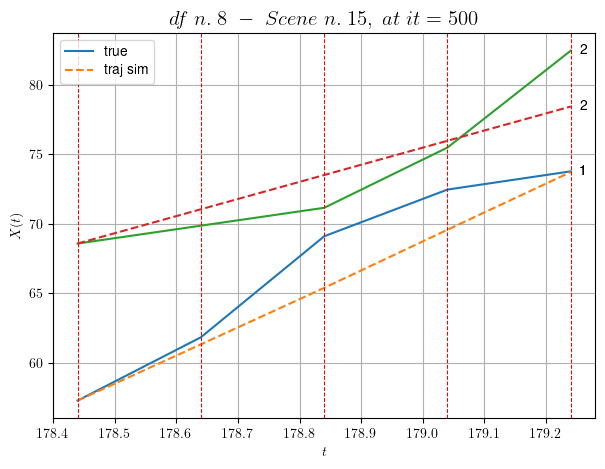

----------------------------------------------------------------------------------------------------
        For scene 51/52:
        * After LR finder: LR_NN=0.001 with mse=38.64328262041629 at it=24
        * v0 = 12.308982889931787
        * MSE = 4.487303264736131
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.52/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [536.64,537.24]


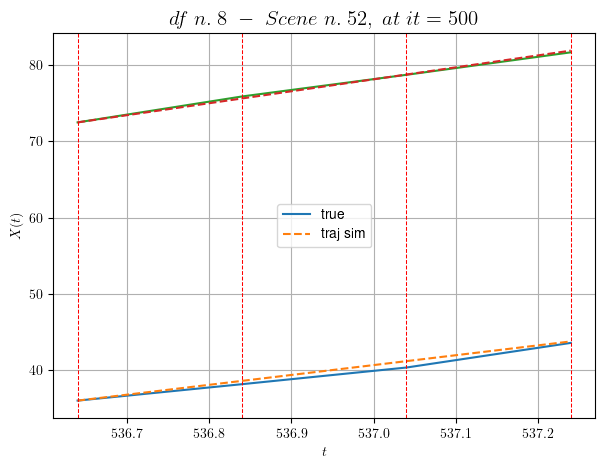

----------------------------------------------------------------------------------------------------
        For scene 52/52:
        * After LR finder: LR_NN=5e-05 with mse=14.784299124371659 at it=24
        * v0 = 15.683354883416595
        * MSE = 0.13074755289300338
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.7753436988495745
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (27 scenes)
DataFrame n.8. Scene n.1/27


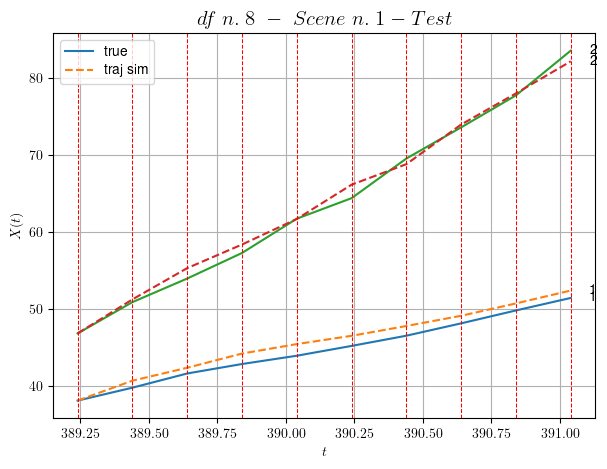

        For scene 1/27:
        * MSE = 1.0221595740725569
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/27


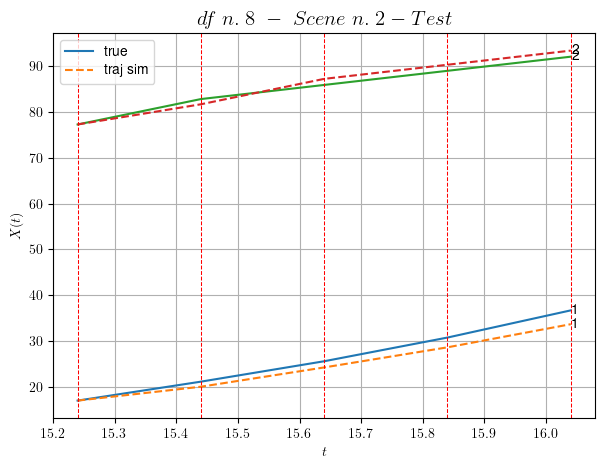

        For scene 2/27:
        * MSE = 2.3338502627473527
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/27


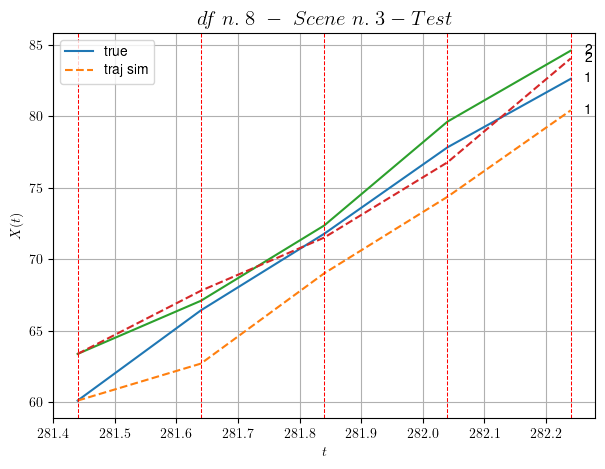

        For scene 3/27:
        * MSE = 4.786740178390719
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/27


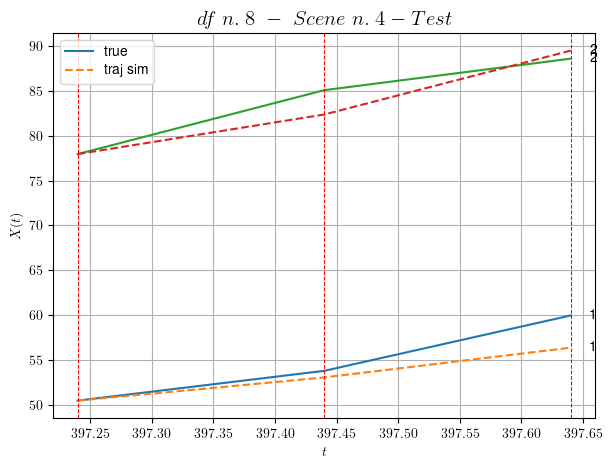

        For scene 4/27:
        * MSE = 3.606898786395817
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/27


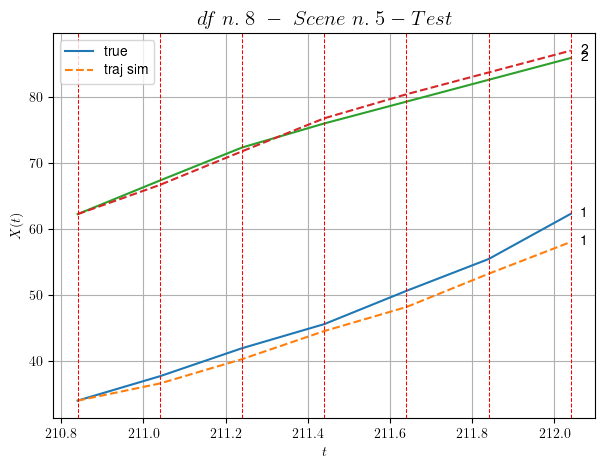

        For scene 5/27:
        * MSE = 2.79743357380901
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/27


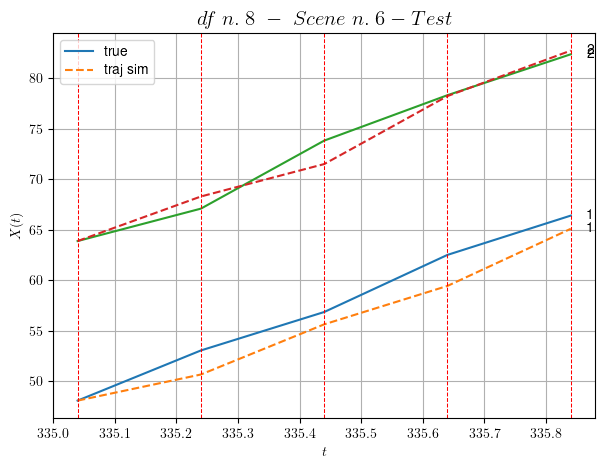

        For scene 6/27:
        * MSE = 2.5309711507533903
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/27


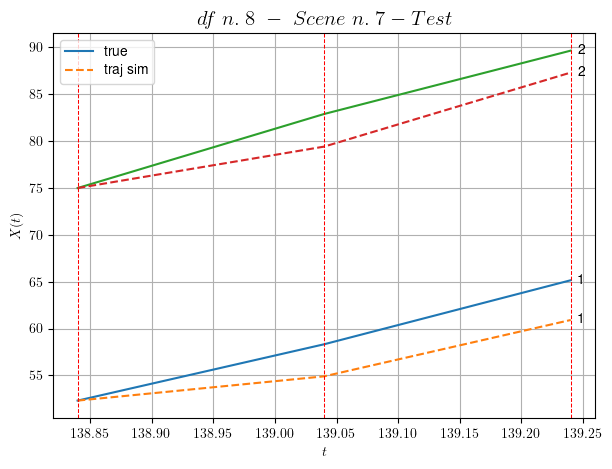

        For scene 7/27:
        * MSE = 7.856751389756056
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.8/27


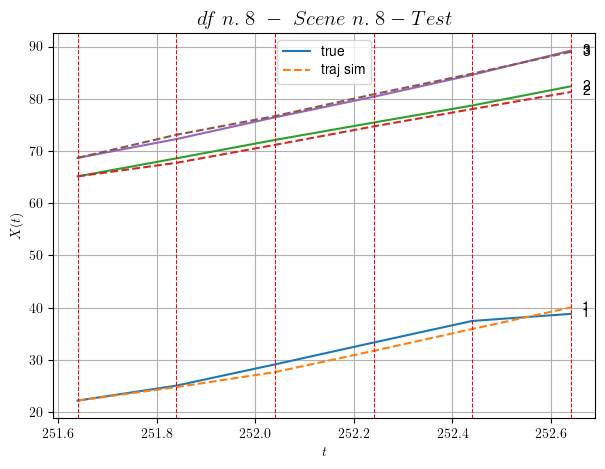

        For scene 8/27:
        * MSE = 0.7563737903837624
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.9/27


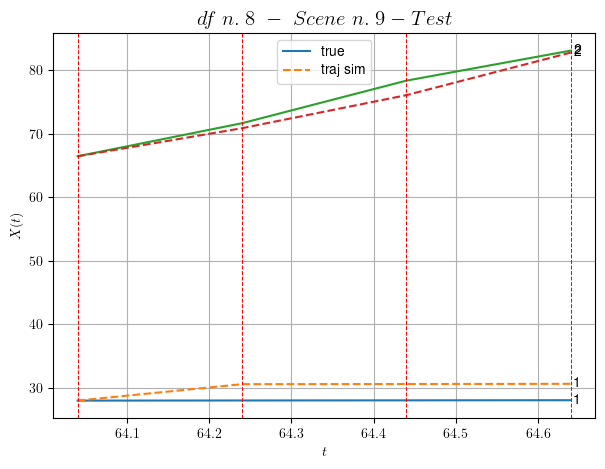

        For scene 9/27:
        * MSE = 3.2194184968744746
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.10/27


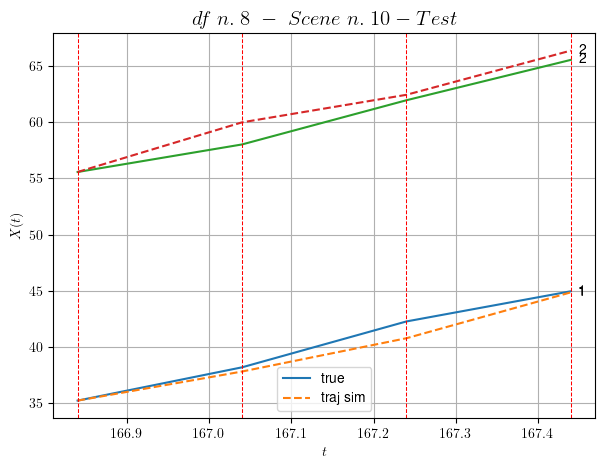

        For scene 10/27:
        * MSE = 0.8947997039643685
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.11/27


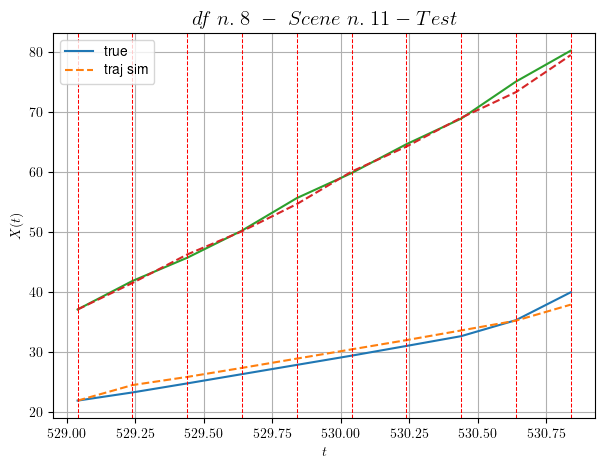

        For scene 11/27:
        * MSE = 0.8676898223000986
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.12/27


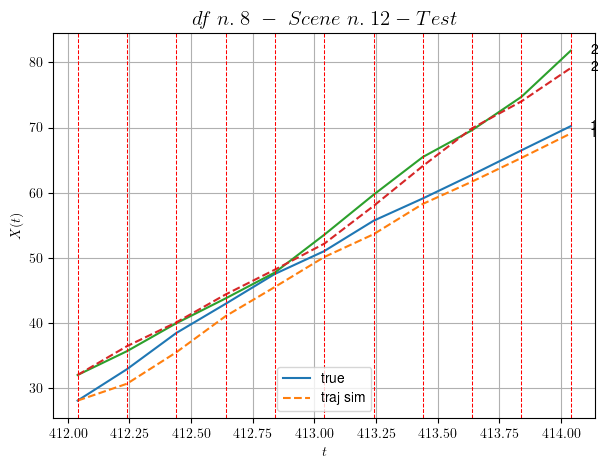

        For scene 12/27:
        * MSE = 2.1092993449213266
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.13/27


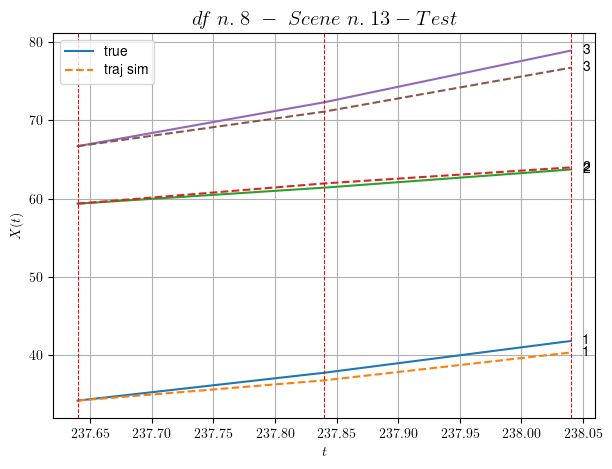

        For scene 13/27:
        * MSE = 1.0755680047701721
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.14/27


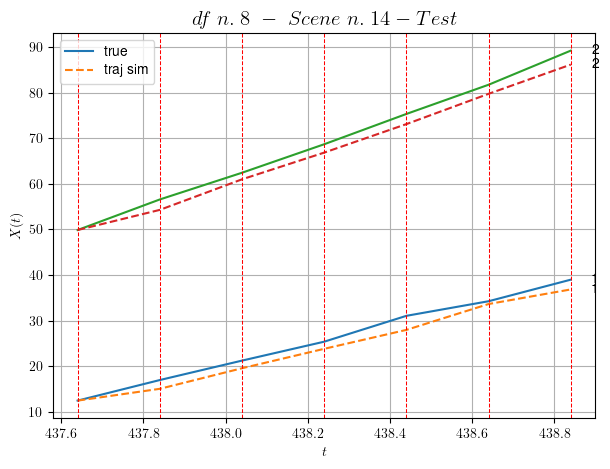

        For scene 14/27:
        * MSE = 3.7431591178362327
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.15/27


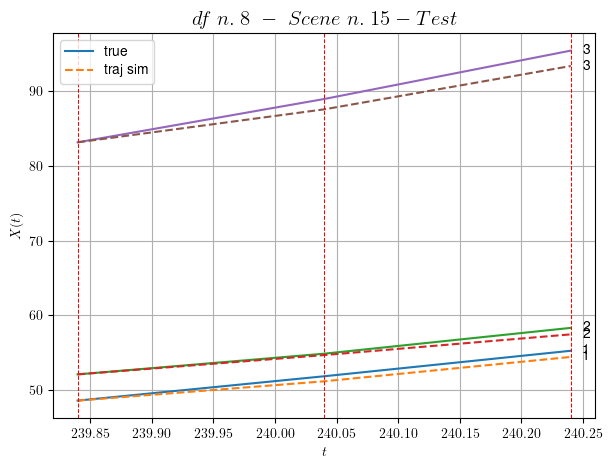

        For scene 15/27:
        * MSE = 0.8991554980243744
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.16/27


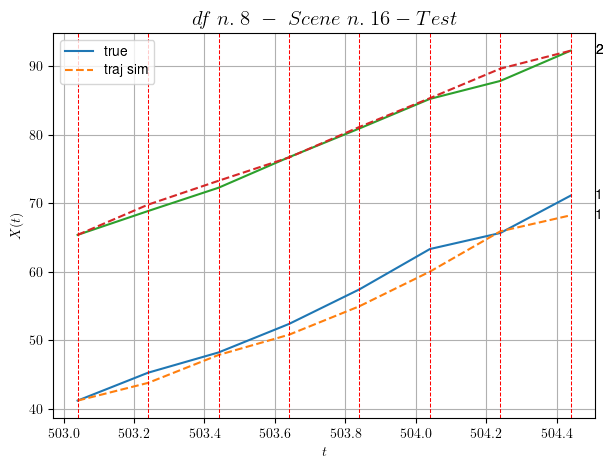

        For scene 16/27:
        * MSE = 2.2046441082108594
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.17/27


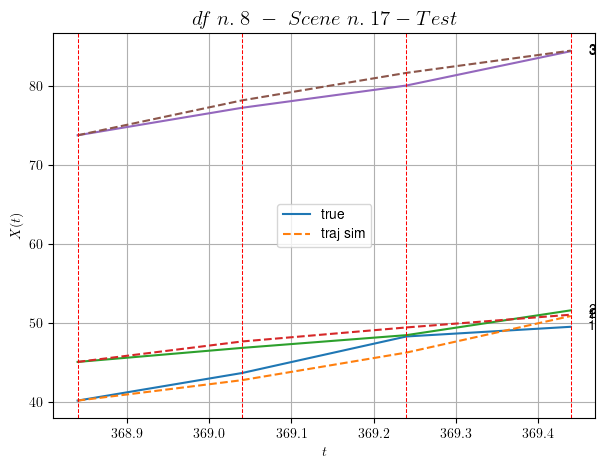

        For scene 17/27:
        * MSE = 1.0141808096709202
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.18/27


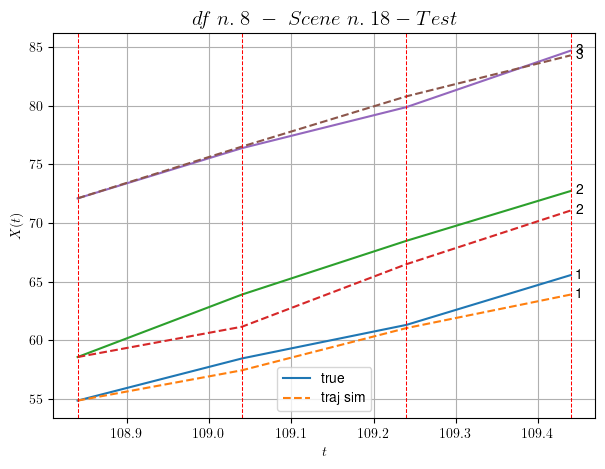

        For scene 18/27:
        * MSE = 1.595886573226353
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.19/27


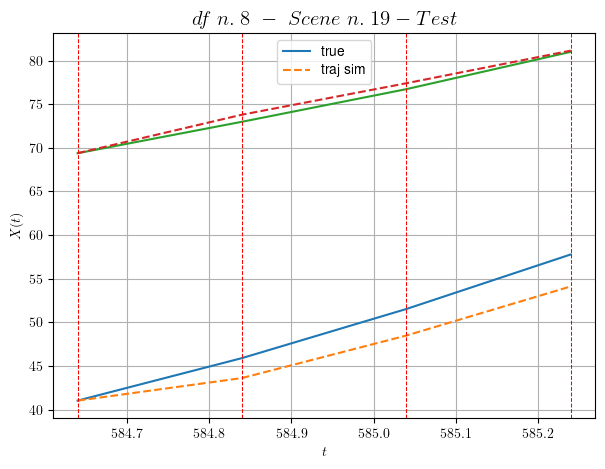

        For scene 19/27:
        * MSE = 3.6302893805693146
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.20/27


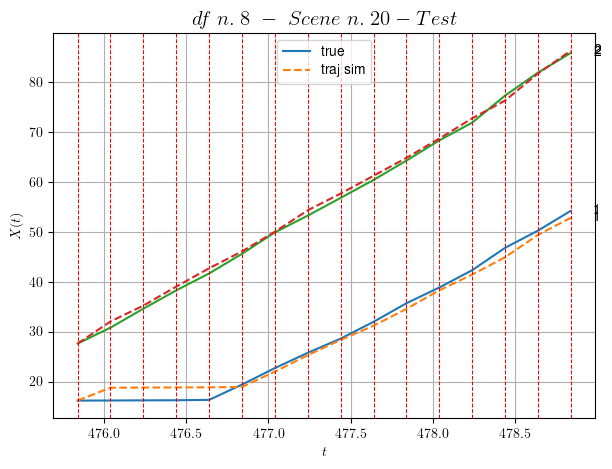

        For scene 20/27:
        * MSE = 1.4056823855592682
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.21/27


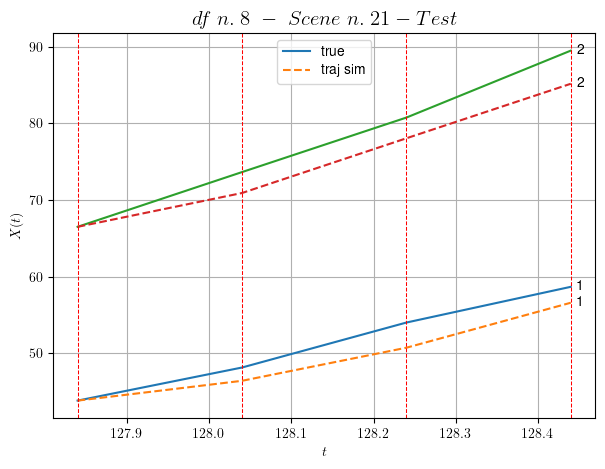

        For scene 21/27:
        * MSE = 6.459978204024562
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.22/27


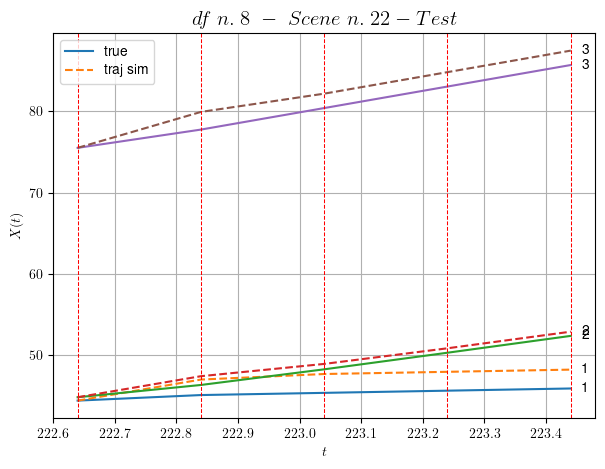

        For scene 22/27:
        * MSE = 2.4006858393154062
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.23/27


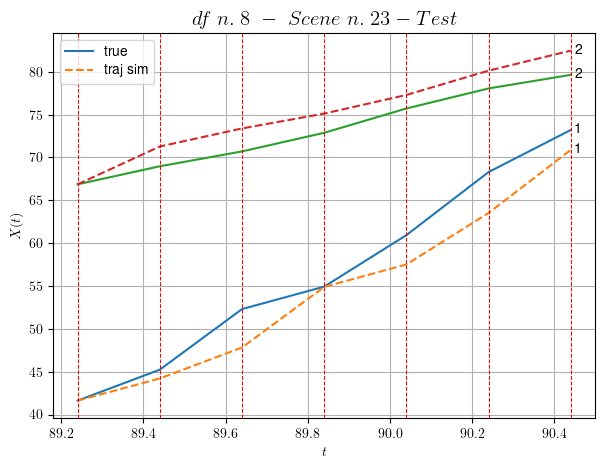

        For scene 23/27:
        * MSE = 6.67348511501527
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.24/27


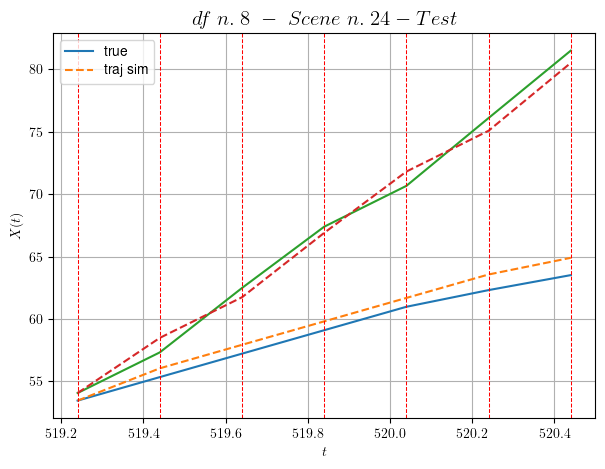

        For scene 24/27:
        * MSE = 0.7822627882513831
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.25/27


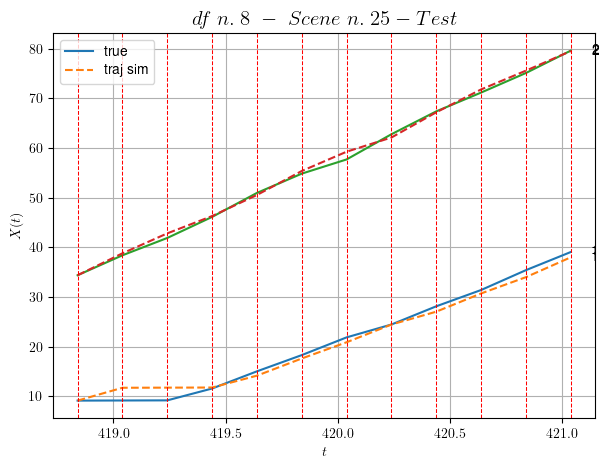

        For scene 25/27:
        * MSE = 1.048641414181155
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.26/27


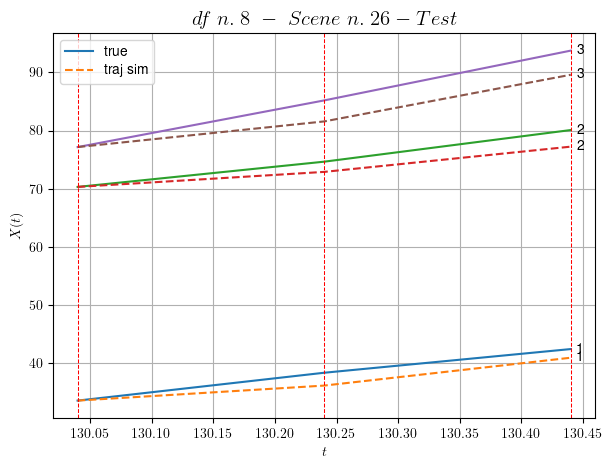

        For scene 26/27:
        * MSE = 5.411120680549395
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.27/27


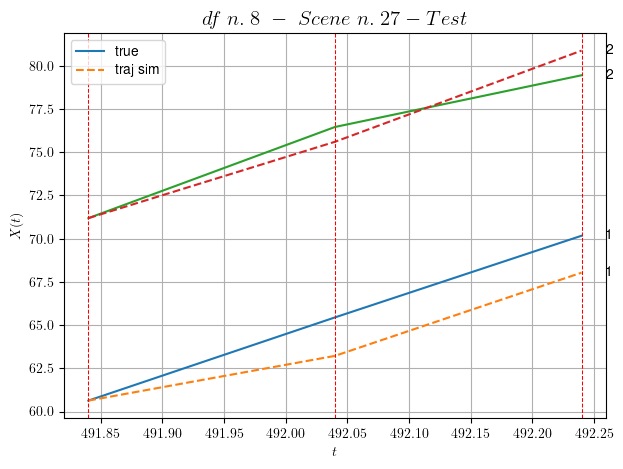

        For scene 27/27:
        * MSE = 2.043277065398506
----------------------------------------------------------------------------------------------------


MSE test: 2.7100149281100783

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.7753436988495745
          * MSE test: 2.7100149281100783
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 9/10 dfs.
In DataFrame n.9 we have 33 scenes.
    To train the model we use 22 scenes, the remaining 11 to test the model.

Training step. (22 scenes)
DataFrame n.9. Scene n.1/22
----------------------------------------------------------------------------------------------------
We have 18 time intervals inside [172.60,176.20]


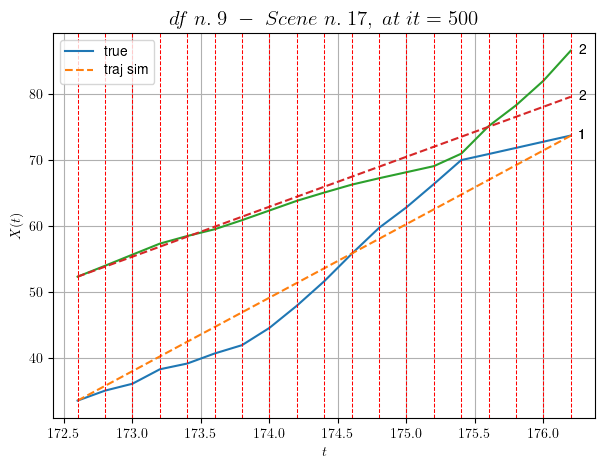

----------------------------------------------------------------------------------------------------
        For scene 1/22:
        * After LR finder: LR_NN=0.001 with mse=1106.7414352849428 at it=24
        * v0 = 7.579600948718947
        * MSE = 6.987879133568804
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [57.80,58.20]


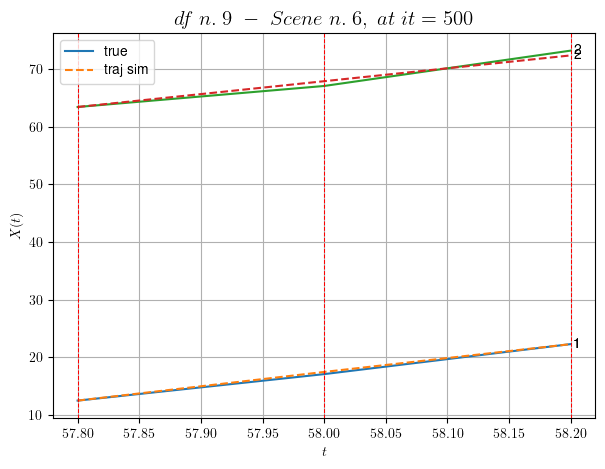

----------------------------------------------------------------------------------------------------
        For scene 2/22:
        * After LR finder: LR_NN=0.005 with mse=1.7685104882394946 at it=24
        * v0 = 22.383621655895368
        * MSE = 0.2379896782018429
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/22
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [155.40,156.40]


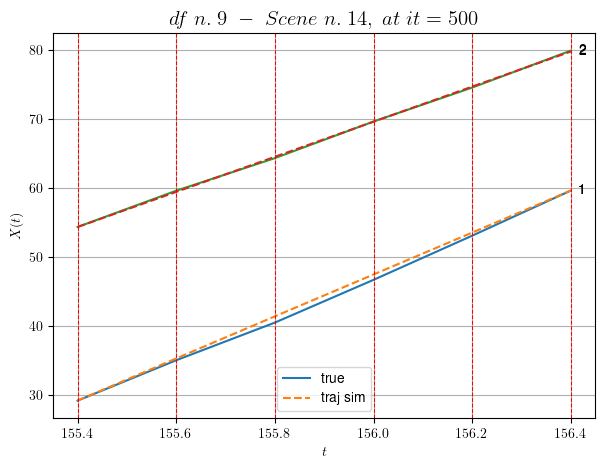

----------------------------------------------------------------------------------------------------
        For scene 3/22:
        * After LR finder: LR_NN=0.001 with mse=4.039941603885337 at it=24
        * v0 = 25.423521542134957
        * MSE = 0.1491991593825494
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.4/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [143.60,144.00]


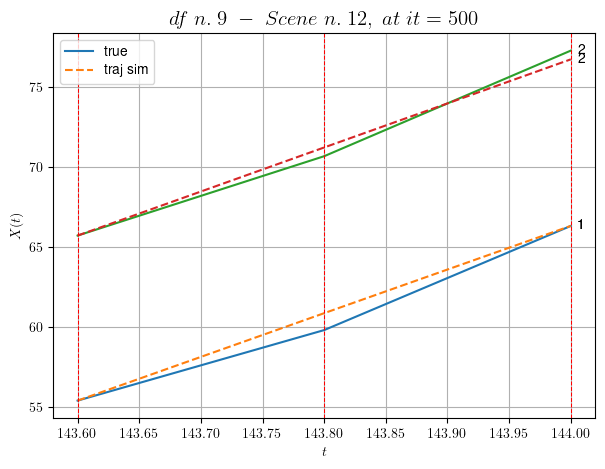

----------------------------------------------------------------------------------------------------
        For scene 4/22:
        * After LR finder: LR_NN=0.0005 with mse=0.8159605221104727 at it=24
        * v0 = 27.476067876170145
        * MSE = 0.277695405462983
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.5/22
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [5.40,6.00]


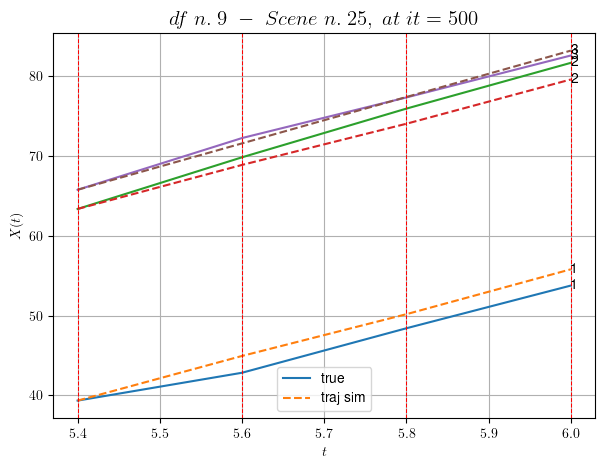

----------------------------------------------------------------------------------------------------
        For scene 5/22:
        * After LR finder: LR_NN=0.01 with mse=1.8495424697451757 at it=24
        * v0 = 29.081107080157114
        * MSE = 1.7831470466766965
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.6/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [19.80,20.20]


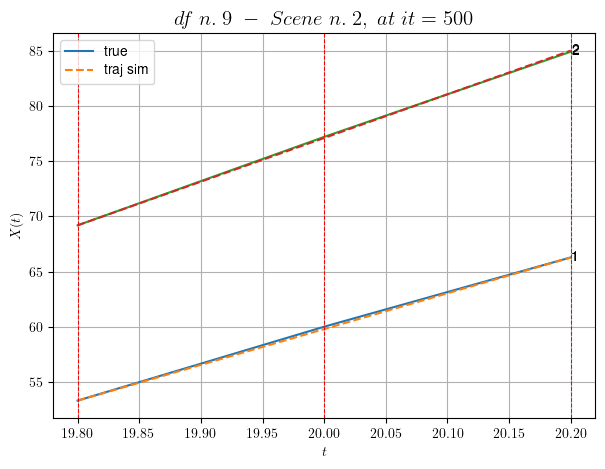

----------------------------------------------------------------------------------------------------
        For scene 6/22:
        * After LR finder: LR_NN=5e-05 with mse=3.100620352548183 at it=24
        * v0 = 39.64570602734414
        * MSE = 0.01102622809610345
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.7/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [30.80,31.20]


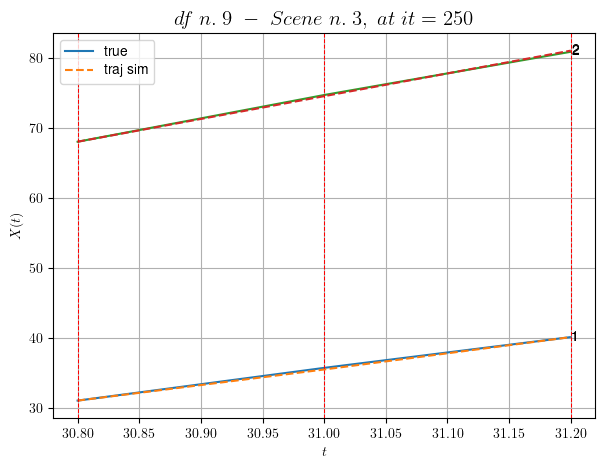

----------------------------------------------------------------------------------------------------
        For scene 7/22:
        * After LR finder: LR_NN=0.01 with mse=0.20573339381406006 at it=24
        * v0 = 32.5359156038889
        * MSE = 0.017960746470429098
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.8/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [119.20,119.60]


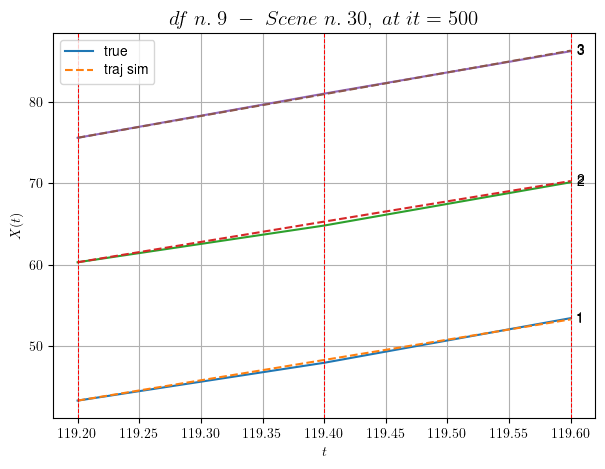

----------------------------------------------------------------------------------------------------
        For scene 8/22:
        * After LR finder: LR_NN=0.0001 with mse=0.3104398840175641 at it=24
        * v0 = 26.73458983053852
        * MSE = 0.03818193834895348
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.9/22
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [36.60,37.60]


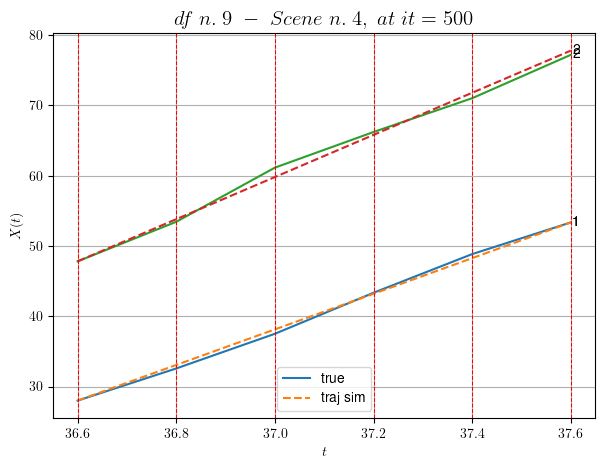

----------------------------------------------------------------------------------------------------
        For scene 9/22:
        * After LR finder: LR_NN=0.0005 with mse=0.27357249991625326 at it=24
        * v0 = 29.981948107113638
        * MSE = 0.3376841063700863
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.10/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [44.40,44.80]


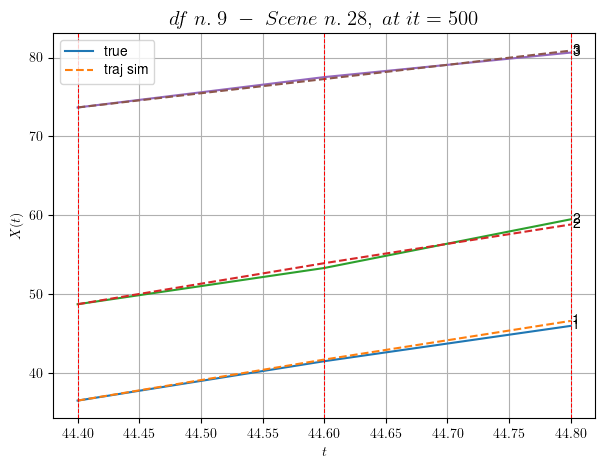

----------------------------------------------------------------------------------------------------
        For scene 10/22:
        * After LR finder: LR_NN=0.01 with mse=3.4987387644327375 at it=24
        * v0 = 18.016106720508247
        * MSE = 0.15021265688955024
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.11/22
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [225.20,226.00]


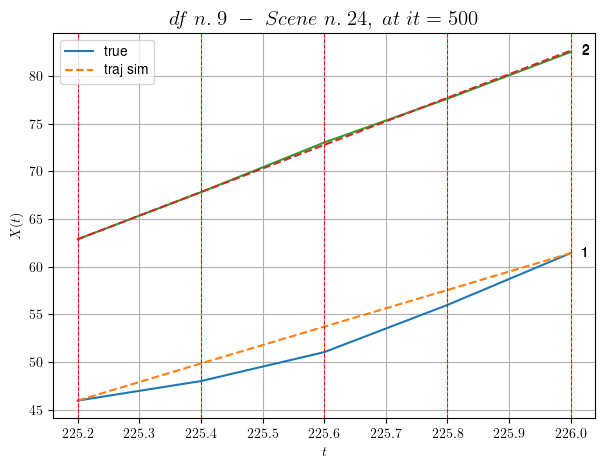

----------------------------------------------------------------------------------------------------
        For scene 11/22:
        * After LR finder: LR_NN=0.0005 with mse=3.7280172649385603 at it=24
        * v0 = 24.737876605772893
        * MSE = 1.3061290408783555
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.12/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [120.20,120.60]


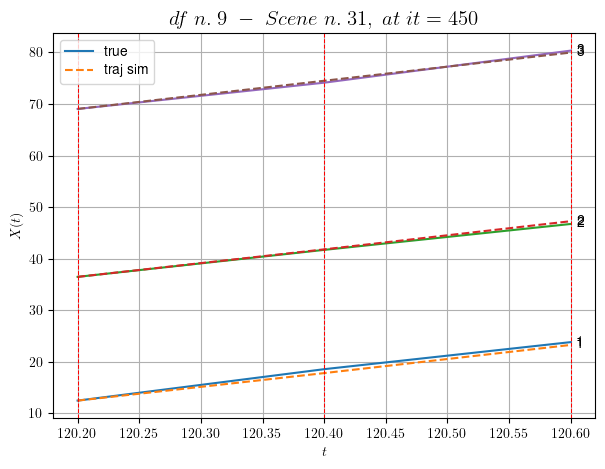

----------------------------------------------------------------------------------------------------
        For scene 12/22:
        * After LR finder: LR_NN=0.005 with mse=0.2967704690139382 at it=24
        * v0 = 27.348987837942822
        * MSE = 0.16115566363079453
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.13/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [219.80,220.20]


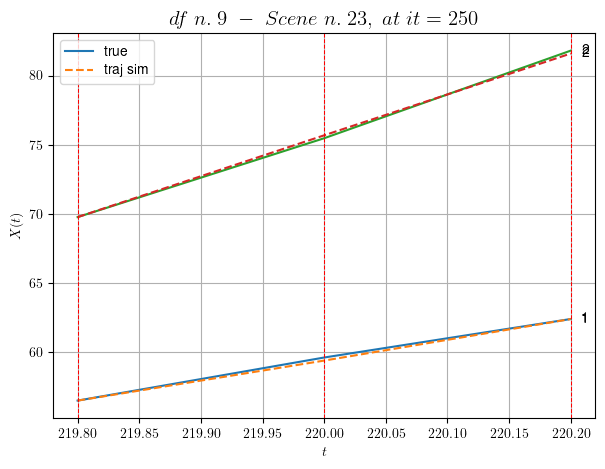

----------------------------------------------------------------------------------------------------
        For scene 13/22:
        * After LR finder: LR_NN=0.01 with mse=0.02365481868366234 at it=24
        * v0 = 29.5739937122531
        * MSE = 0.020916200426814267
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.14/22
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [191.20,192.20]


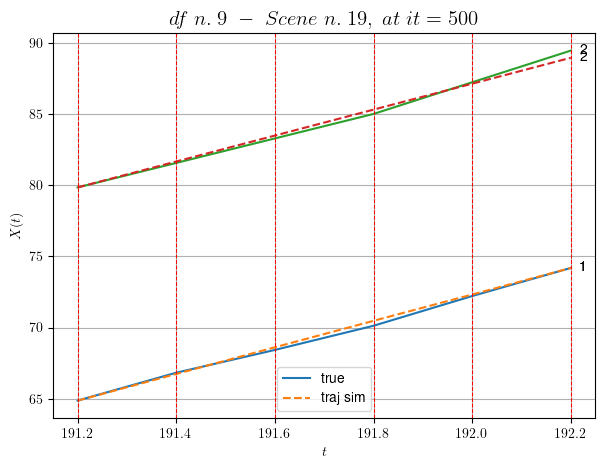

----------------------------------------------------------------------------------------------------
        For scene 14/22:
        * After LR finder: LR_NN=0.005 with mse=78.94943628434868 at it=24
        * v0 = 9.11709584878373
        * MSE = 0.046134244566279424
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.15/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [20.80,21.20]


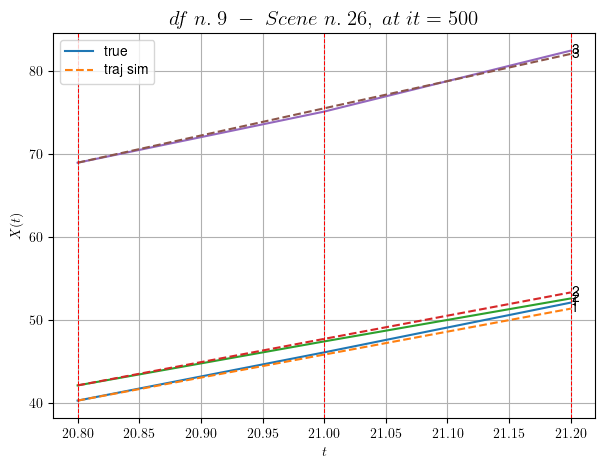

----------------------------------------------------------------------------------------------------
        For scene 15/22:
        * After LR finder: LR_NN=0.005 with mse=0.34284382154452236 at it=24
        * v0 = 32.73331157196291
        * MSE = 0.16955195342823828
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.16/22
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [82.40,84.00]


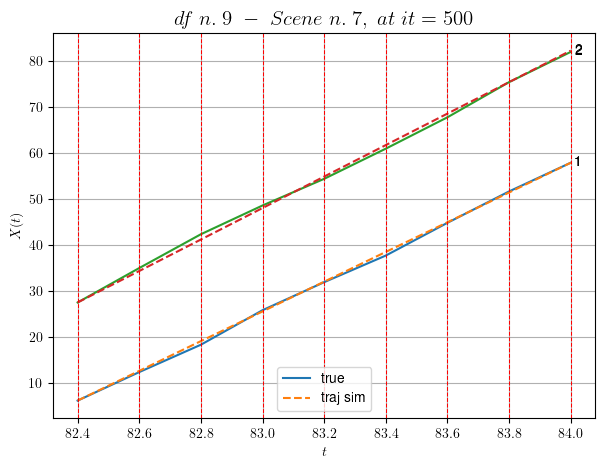

----------------------------------------------------------------------------------------------------
        For scene 16/22:
        * After LR finder: LR_NN=0.001 with mse=7.86137851777817 at it=24
        * v0 = 34.29480154475974
        * MSE = 0.26636466719245666
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.17/22
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [197.60,198.80]


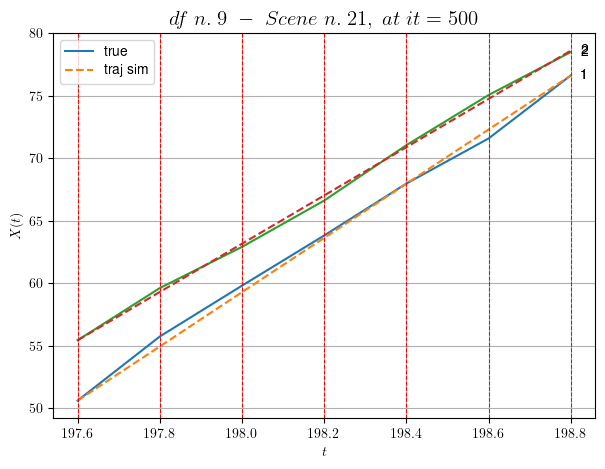

----------------------------------------------------------------------------------------------------
        For scene 17/22:
        * After LR finder: LR_NN=0.0005 with mse=29.811540365206852 at it=24
        * v0 = 19.31029551440923
        * MSE = 0.1369476659840363
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.18/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [205.80,206.20]


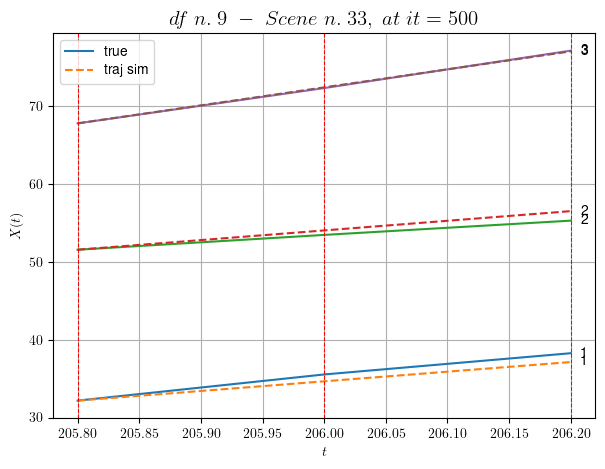

----------------------------------------------------------------------------------------------------
        For scene 18/22:
        * After LR finder: LR_NN=0.0001 with mse=1.3388189399225514 at it=24
        * v0 = 23.158651176007055
        * MSE = 0.4342902712276866
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.19/22
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [117.00,118.40]


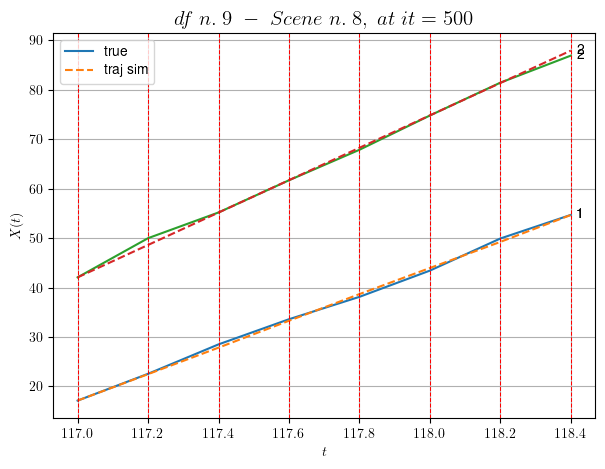

----------------------------------------------------------------------------------------------------
        For scene 19/22:
        * After LR finder: LR_NN=0.005 with mse=2.504822546508558 at it=24
        * v0 = 32.7467513113901
        * MSE = 0.29218019914974863
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.20/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [140.00,140.40]


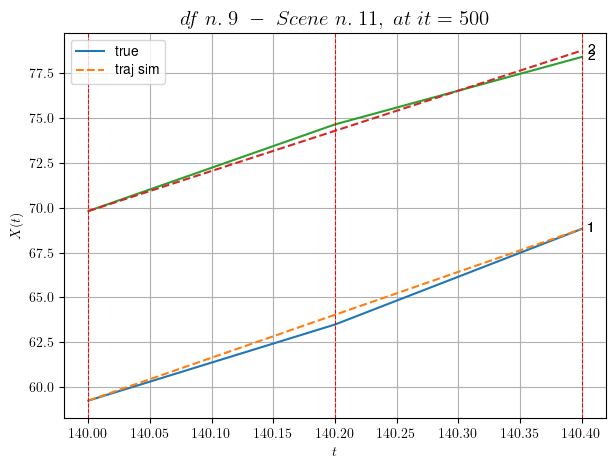

----------------------------------------------------------------------------------------------------
        For scene 20/22:
        * After LR finder: LR_NN=0.0001 with mse=2.2089683190185494 at it=24
        * v0 = 22.365188336411574
        * MSE = 0.09183068747281745
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.21/22
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [161.60,162.80]


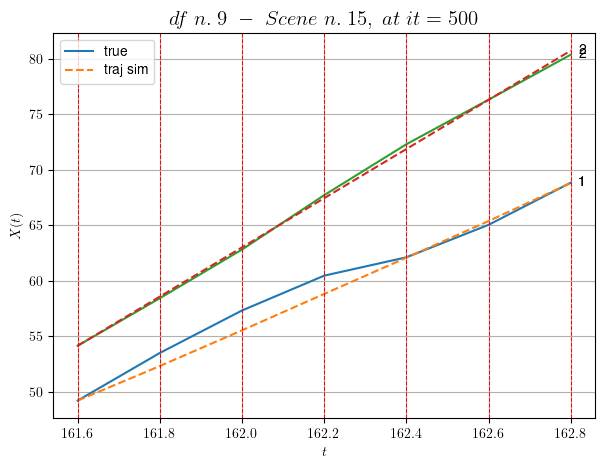

----------------------------------------------------------------------------------------------------
        For scene 21/22:
        * After LR finder: LR_NN=0.005 with mse=16.375630599653455 at it=24
        * v0 = 22.164023913692947
        * MSE = 0.46788930630468145
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.22/22
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [117.80,118.40]


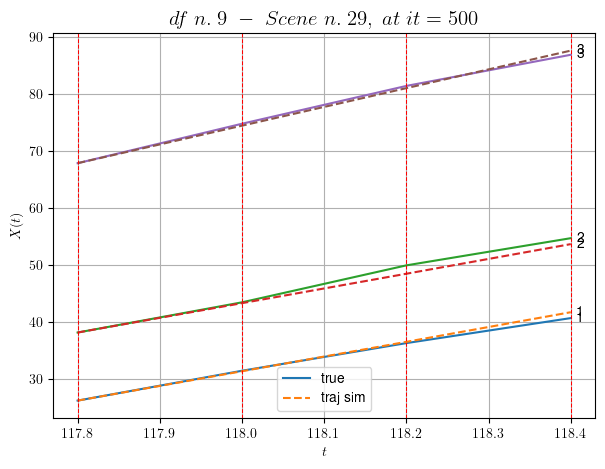

----------------------------------------------------------------------------------------------------
        For scene 22/22:
        * After LR finder: LR_NN=0.001 with mse=0.7701798606847773 at it=24
        * v0 = 32.947825633501125
        * MSE = 0.4284178270820607
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.627853810309635
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (11 scenes)
DataFrame n.9. Scene n.1/11


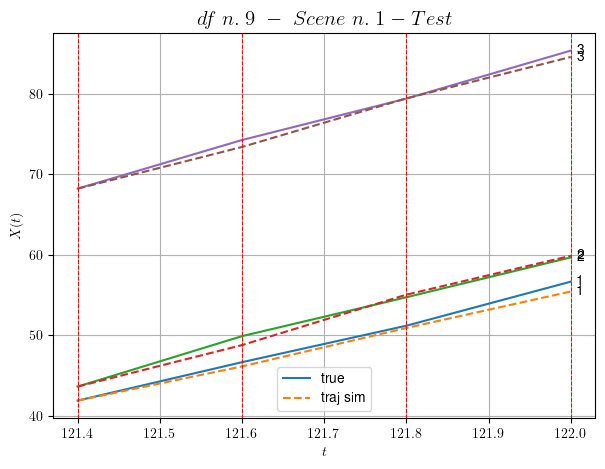

        For scene 1/11:
        * MSE = 0.3845985933057517
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/11


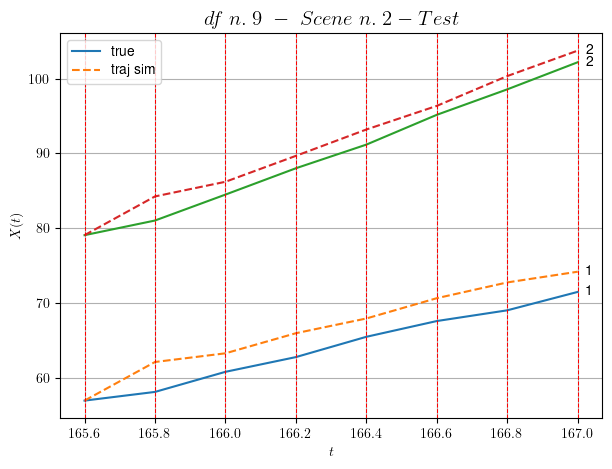

        For scene 2/11:
        * MSE = 5.990612847350123
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/11


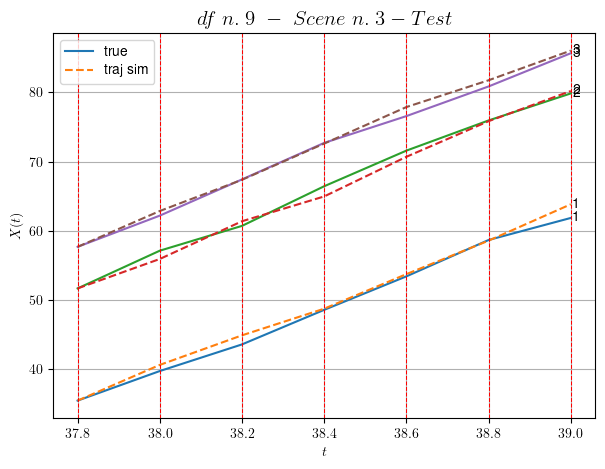

        For scene 3/11:
        * MSE = 0.6964016712815839
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.4/11


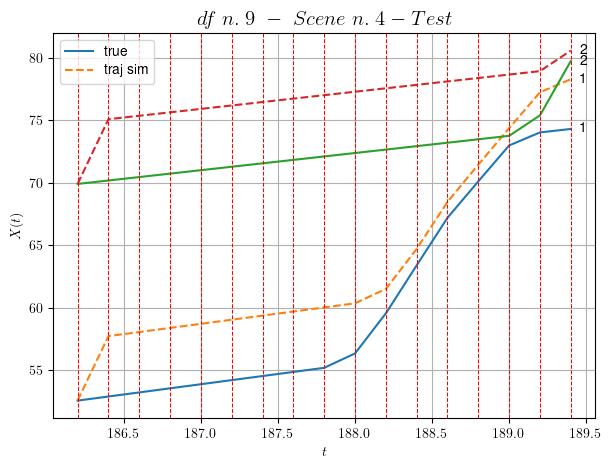

        For scene 4/11:
        * MSE = 17.32975797544465
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.5/11


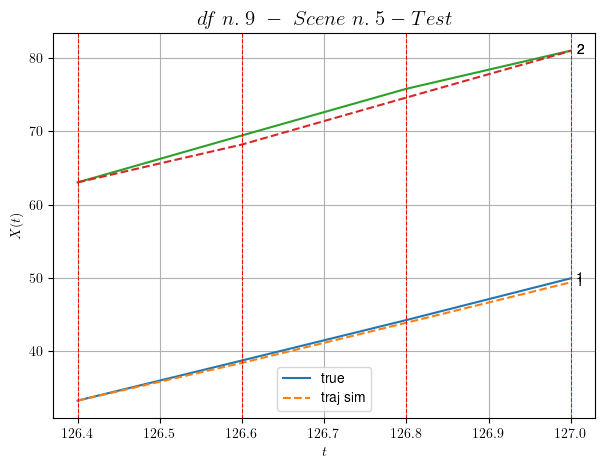

        For scene 5/11:
        * MSE = 0.43911225709548674
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.6/11


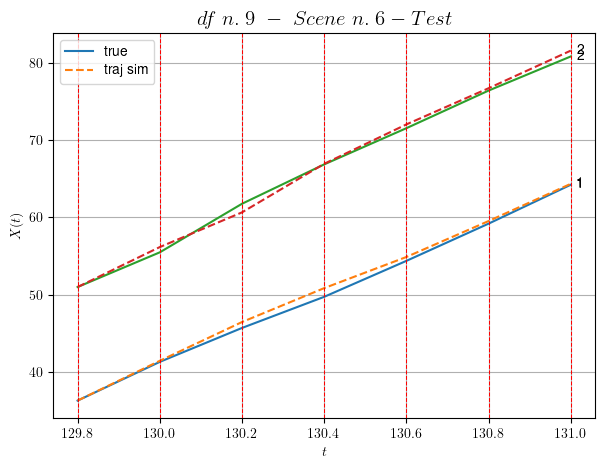

        For scene 6/11:
        * MSE = 0.34767084451566466
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.7/11


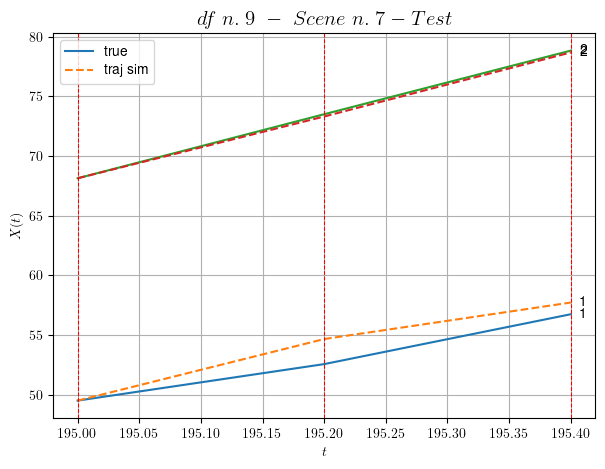

        For scene 7/11:
        * MSE = 0.9043855050060511
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.8/11


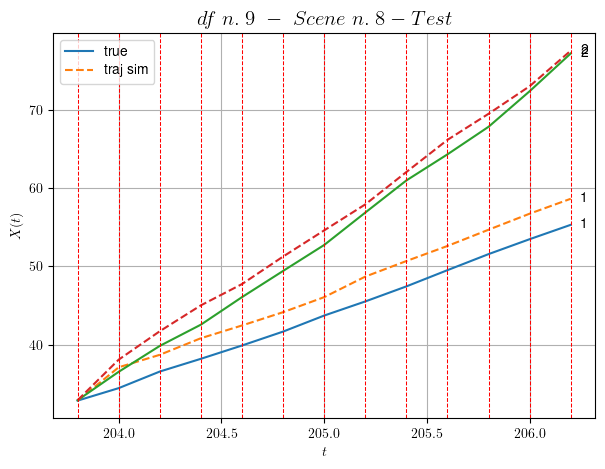

        For scene 8/11:
        * MSE = 4.945714196063561
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.9/11


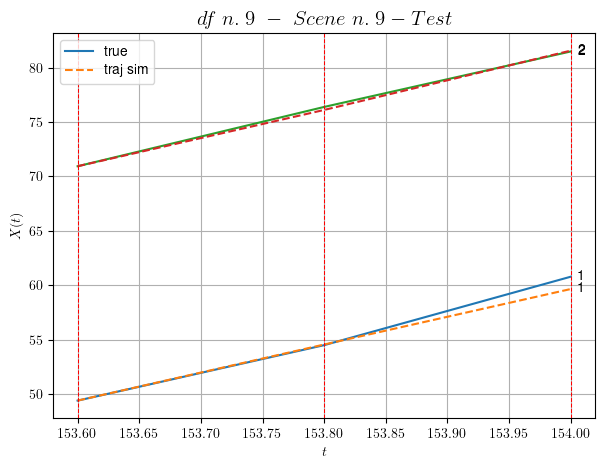

        For scene 9/11:
        * MSE = 0.22807381350048622
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.10/11


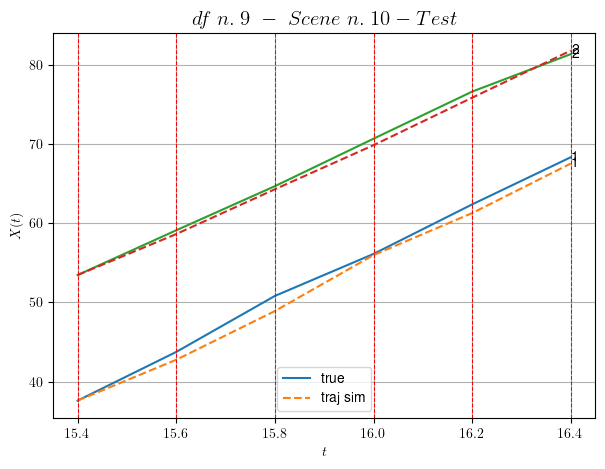

        For scene 10/11:
        * MSE = 0.6932857336662206
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.11/11


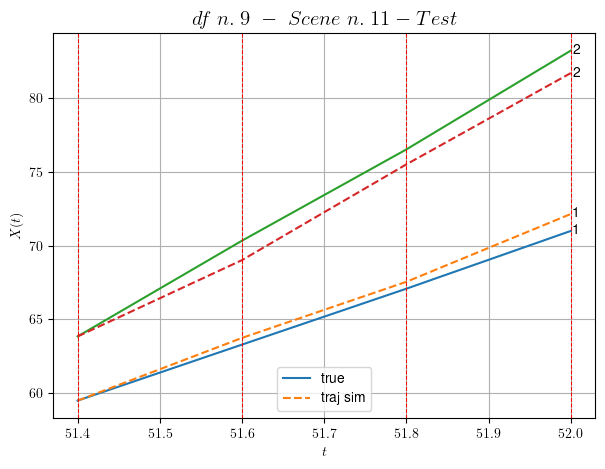

        For scene 11/11:
        * MSE = 0.8535307868945348
----------------------------------------------------------------------------------------------------


MSE test: 2.9830131112840106

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.627853810309635
          * MSE test: 2.9830131112840106
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 10/10 dfs.
In DataFrame n.10 we have 74 scenes.
    To train the model we use 49 scenes, the remaining 25 to test the model.

Training step. (49 scenes)
DataFrame n.10. Scene n.1/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [81.72,82.52]


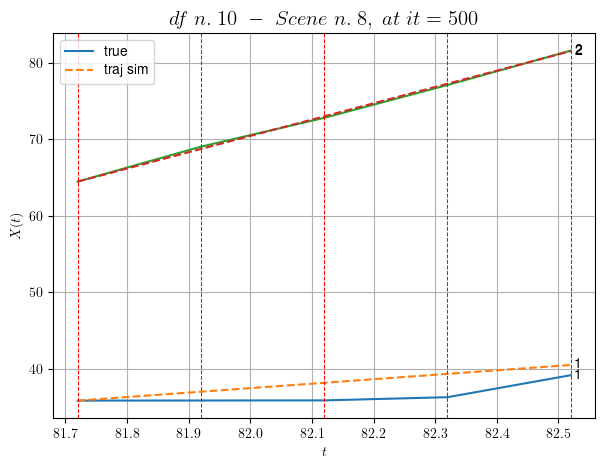

----------------------------------------------------------------------------------------------------
        For scene 1/49:
        * After LR finder: LR_NN=5e-05 with mse=9.460256288302547 at it=24
        * v0 = 21.36406302671324
        * MSE = 1.7887837698984734
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.2/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [194.52,195.12]


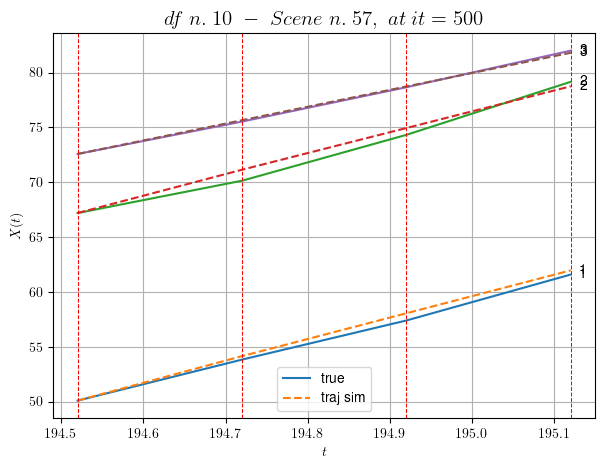

----------------------------------------------------------------------------------------------------
        For scene 2/49:
        * After LR finder: LR_NN=0.005 with mse=10.133171666794876 at it=24
        * v0 = 15.385046662986447
        * MSE = 0.1897267454978747
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.3/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [450.52,452.12]


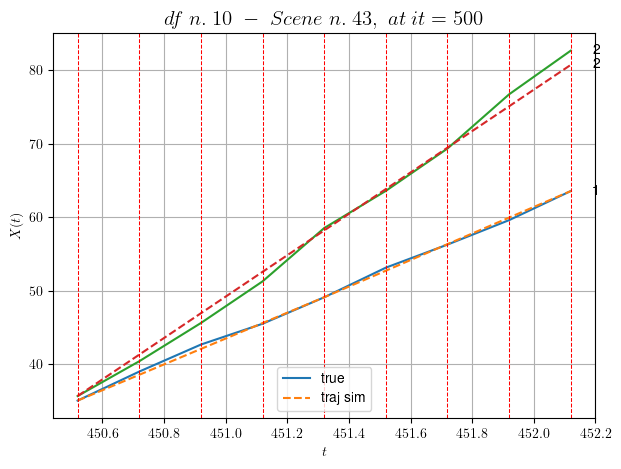

----------------------------------------------------------------------------------------------------
        For scene 3/49:
        * After LR finder: LR_NN=0.001 with mse=1.4642250308295812 at it=24
        * v0 = 28.147396988326644
        * MSE = 0.5532510171728721
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.4/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [305.72,306.12]


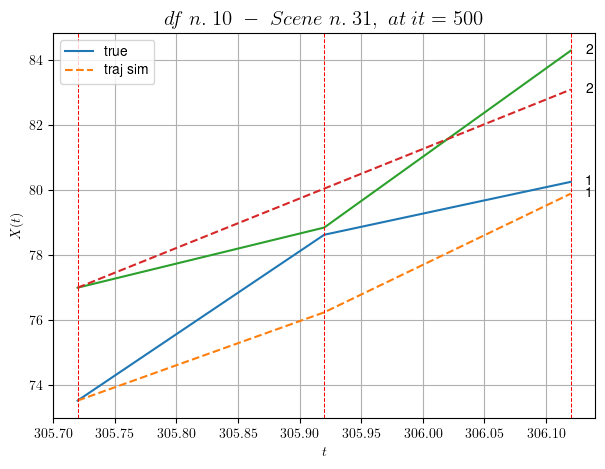

----------------------------------------------------------------------------------------------------
        For scene 4/49:
        * After LR finder: LR_NN=0.01 with mse=7.907361380065155 at it=24
        * v0 = 15.2286071835076
        * MSE = 1.439982915512731
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.5/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [502.92,504.52]


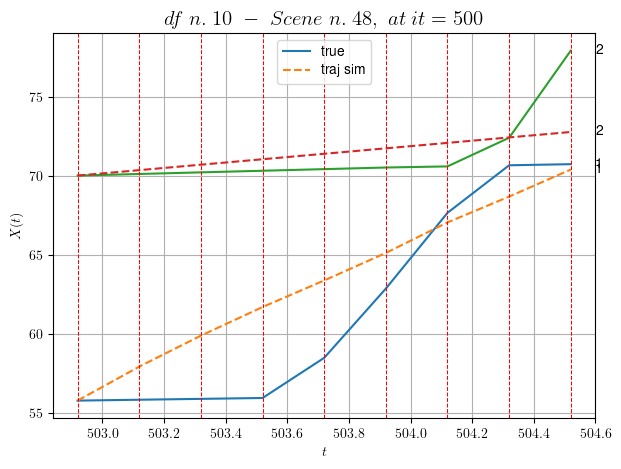

----------------------------------------------------------------------------------------------------
        For scene 5/49:
        * After LR finder: LR_NN=0.01 with mse=356.43001605850895 at it=24
        * v0 = 1.7269359387544043
        * MSE = 6.205604887405587
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.6/49
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [569.72,570.72]


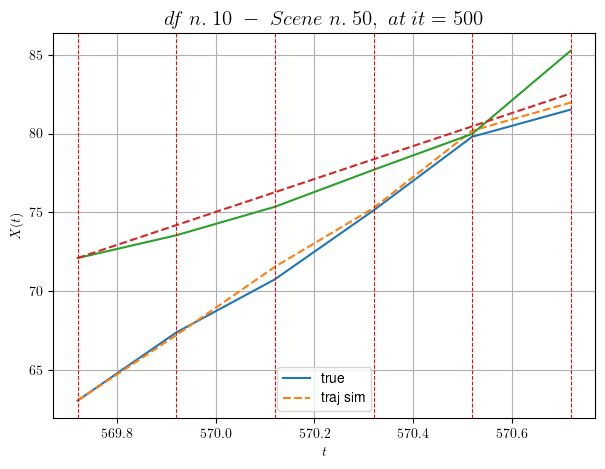

----------------------------------------------------------------------------------------------------
        For scene 6/49:
        * After LR finder: LR_NN=0.01 with mse=66.3444576405732 at it=24
        * v0 = 10.43973796346736
        * MSE = 0.8089104988502175
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.7/49
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [201.32,203.12]


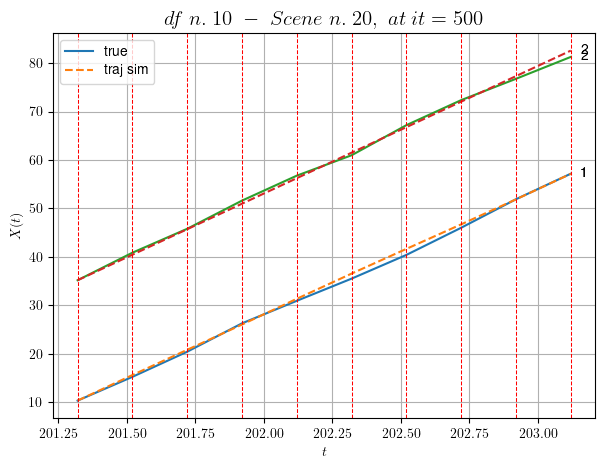

----------------------------------------------------------------------------------------------------
        For scene 7/49:
        * After LR finder: LR_NN=0.01 with mse=8.702800995527026 at it=24
        * v0 = 26.32009816116238
        * MSE = 0.29675379368661325
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.8/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [236.52,237.12]


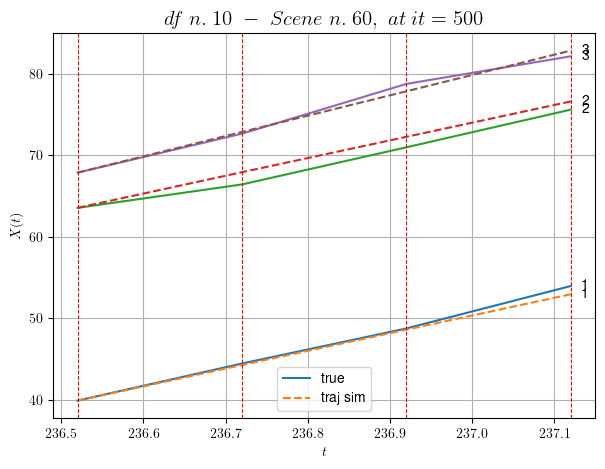

----------------------------------------------------------------------------------------------------
        For scene 8/49:
        * After LR finder: LR_NN=0.001 with mse=1.8796372611371701 at it=24
        * v0 = 24.944260756133655
        * MSE = 0.6100576390488797
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.9/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [275.92,277.12]


In [ ]:
info_nn, model_trained = solve_nn_dataset(dataset, DOE, v0, processed_flag, NUM_ITER, LEARNING_RATE_v0,
                                           test, plot_flag)

In [ ]:
get_stats(model_trained)

## Plot

### Leading velocity $v_{0}$

In [ ]:
# Initialize the fig
nrow, ncol = 1, 3
width, height = 7, 5 # single subplot
fig, axes = plt.subplots(nrow,ncol,figsize=(width*ncol*.75,height*.75))

ms2kmh = 3.6

info_train = info_nn[info_nn["type"] == "train"]
info_test = info_nn[info_nn["type"] == "test"]
info_grouped = info_nn.groupby(['N. file', 'type']).mean(numeric_only=True)
info_grouped2 = info_nn.groupby(['N. file']).mean(numeric_only=True)
info_avg = info_nn.groupby(['type']).mean(numeric_only=True)

# For each scene, plot v0 mean
for _, scn in info_train.iterrows():
    axes[0].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');
    
for _, scn in info_test.iterrows():
    axes[1].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# Avg value
for (nf,typef), infof in info_grouped.iterrows():
    
    if typef == "train":
        axes[0].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")
        
    if typef == "test":
        axes[1].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")

# For each scene, plot v0 mean
for _, scn in info_nn.iterrows():
    axes[2].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# For a dataset, plot v0 mean (averaging v0 mean in all the scenes)
for nf, p in info_grouped2.iterrows():
    axes[2].plot(nf, p['v0']*ms2kmh, color = 'r', marker="x")

# Plot v0 mean over all dfs
alldfs = [a for a, _ in info_nn.groupby('N. file')]
v0_mean = np.mean([ infof['v0']*ms2kmh for _, infof in info_grouped.iterrows()])
axes[0].plot(alldfs, [info_avg['v0']['train']*ms2kmh]*len(alldfs), color = 'r')  
axes[1].plot(alldfs, [info_avg['v0']['test']*ms2kmh]*len(alldfs), color = 'r')  
axes[2].plot(alldfs, [v0_mean]*len(alldfs), color = 'r')  

# labeling     
axes[0].set_title(fr"$Train$",fontsize=12)
axes[1].set_title(fr"$Test$",fontsize=12)
axes[2].set_title(fr"$All$",fontsize=12)
fig.supxlabel(r"$data set$",fontsize=14, y=0.0005)
fig.supylabel(r"$v_{0}\ [km/h]$",fontsize=14, x = 0.075)
plt.suptitle(fr"$Velocities\ v_{0}\ of\ the\ leading\ car\ -\ with\ NN\ structure\ {str(DOE)}$",
             fontsize=18, y=1)

# Setting the values for all axes.
custom_xlim = (0.75,10.25)
custom_xticks = range(1,11)
plt.setp(axes, xlim=custom_xlim, xticks=custom_xticks)

axes[0].grid(color='grey', linestyle='-', linewidth=0.5);
axes[1].grid(color='grey', linestyle='-', linewidth=0.5);
axes[2].grid(color='grey', linestyle='-', linewidth=0.5);

plt.show()

### Test 1: `cons_dis` vs `velocities`

In [ ]:
Nx = 10
Nt = 100
T = 0.5

In [ ]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

In [ ]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

In [ ]:
y_pred

In [ ]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

### Test 2: `cons_dis` vs `velocities`

In [ ]:
Nx = 100
Nt = 100
T = 0.5

In [ ]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

In [ ]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

In [ ]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

## Prepare the out dir

In [ ]:
# Create the directory..
if flag_save:
    
    df_seen = [df['N. file'][0] for df in dataset]
    df_seen_str = '-'.join(str(x) for x in df_seen)
    
    # Create directory where to save the image
    now = datetime.now() 
    d = now.strftime(f"%Y-%m-%d_%H-%M-%S_df{df_seen_str}_{NUM_ITER}it-PRE-nn{str(DOE)}")
    
    path = 'out/' + d
    os.mkdir(path)
    
    # Save the solution in a file
    namefile = '/info_nn.txt'

    with open(path + namefile, 'w') as output:
        info_nn.to_csv(path + namefile, sep=',', index=False)
        
    # Save model in a file
    namefile_model = '/model_nn.keras'
    model_trained.compile(optimizer='SGD', loss='MAE')
    model_trained.save(path + namefile_model)  # The file needs to end with the .keras extension